# CZ4046 Assignment 1 Part 1

## Value Iteration

### Import required libraries

In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

### Define grid

In [2]:
class Grid:
    def __init__(self, width, height, start):
        self.width = width
        self.height = height
        self.i = start[0]
        self.j = start[1]
        
    def set(self, rewards, actions):  
        self.rewards = rewards
        self.actions = actions 
    
    def set_state(self, s):
        self.i = s[0]
        self.j = s[1]
        
    def curr_state(self):
        return (self.i, self.j)

    def is_terminal(self, s):
        return s not in self.actions
    
    def make_move(self, action):
        if action in self.actions[(self.i, self.j)]:
            if action == 'U':
                self.i -= 1
            elif action == 'D':
                self.i += 1
            elif action == 'R':
                self.j += 1
            elif action == 'L':
                self.j -= 1
        
        else:
            pass
        
        return self.rewards.get((self.i, self.j), 0)
    
    def reverse_move(self, action):
        if action == 'U':
            self.i += 1
        elif action == 'D':
            self.i -= 1
        elif action == 'R':
            self.j -= 1
        elif action == 'L':
            self.j += 1
            
        assert(self.curr_state() in self.all_states())
    
    def end_explore(self):
        return (self.i, self.j) not in self.actions
    
    def all_states(self):
        return set(list(self.actions.keys()) + list(self.rewards.keys()))
    
def stand_maze():    
    grid = Grid(6, 6, (3, 2))
    rewards = {(0,0):1, (0,2):1, (0,5):1, (1,3):1, (2,4):1, (3,5):1, (1,1):-1, (1,5):-1, (2,2):-1, (3,3):-1, (4,4):-1}
    actions = {
        (0,0): ('D'),
        (0,2): ('R', 'D'),
        (0,3): ('R', 'D', 'L'),
        (0,4): ('R', 'L'),
        (0,5): ('D', 'L'),
        (1,0): ('U', 'R', 'D'),
        (1,1): ('R', 'D', 'L'),
        (1,2): ('U', 'R', 'D', 'L'),
        (1,3): ('U', 'D', 'L'),
        (1,5): ('U', 'D'),
        (2,0): ('U', 'R', 'D'),
        (2,1): ('U', 'R', 'D', 'L'),
        (2,2): ('U', 'R', 'D', 'L'),
        (2,3): ('U', 'R', 'D', 'L'),
        (2,4): ('R', 'D', 'L'),
        (2,5): ('U', 'D', 'L'),
        (3,0): ('U', 'R', 'D'),
        (3,1): ('U', 'R', 'L'),
        (3,2): ('U', 'R', 'L'),
        (3,3): ('U', 'R', 'L'),
        (3,4): ('U', 'R', 'D', 'L'),
        (3,5): ('U', 'D', 'L'),
        (4,0): ('U', 'D'),
        (4,4): ('U', 'R', 'D'),
        (4,5): ('U', 'D', 'L'),
        (5,0): ('U', 'R'),
        (5,1): ('R', 'L'),
        (5,2): ('R', 'L'),
        (5,3): ('R', 'L'),
        (5,4): ('U', 'R', 'L'),
        (5,5): ('U', 'L')           
    }
    grid.set(rewards, actions)
    return grid

def neg_maze(move_cost=-0.04):
    grid = stand_maze()
    grid.rewards.update({
        (0,3): move_cost,
        (0,4): move_cost,
        (1,0): move_cost,
        (1,2): move_cost,
        (2,0): move_cost,
        (2,1): move_cost,
        (2,3): move_cost,
        (2,5): move_cost,
        (3,0): move_cost,
        (3,1): move_cost,
        (3,2): move_cost,
        (3,4): move_cost,
        (4,0): move_cost,
        (4,5): move_cost,
        (5,0): move_cost,
        (5,1): move_cost,
        (5,2): move_cost,
        (5,3): move_cost,
        (5,4): move_cost,
        (5,5): move_cost,     
    })
    return grid

def start_explore(agent, env):
    pass

### Print utility values

In [3]:
val_hist = []

def display_utilities(f, V, g):
    for i in range(g.width):
        
        if f == True:
            print("+----------+------------+------------+------------+------------+------------+")
        
        for j in range(g.height):
            v = V.get((i,j), 0)
            
            if f == True:
                print(f' {v:^9.5f} |', end = ' ')
                    
            val_hist.append(v)
        
        if f == True:        
            print ("")
    if f == True:
        print("+----------+------------+------------+------------+------------+------------+")

### Print policy

In [4]:
def display_policy(P, g):
    for i in range(g.width):
        print("+------+--------+--------+--------+--------+--------+")
        
        for j in range(g.height):
            a = P.get((i,j), ' ')
            print('   {}   |'.format(a), end = ' ')

        print ("")
    print("+------+--------+--------+--------+--------+--------+")

### Value Iteration

In [5]:
CONV_VAL = 10e-4
DISC_VAL = 0.99
LEGAL_ACTIONS = ('U', 'D', 'L', 'R')

In [6]:
if __name__ == '__main__':
    grid = neg_maze()

    policy = {}
    for s in grid.actions.keys():
        policy[s] = np.random.choice(LEGAL_ACTIONS)
    
    val_hist = []
    
    V = {}
    states = grid.all_states()
    
    for s in states:
        
        if s in grid.actions:
            V[s] = 0
        
        else:
            V[s] = 0

    iter_no = 0
    
    while True:
        iter_no = iter_no + 1
        print("Iteration " + str(iter_no) + " :: ")
        max_change = 0
        
        for s in states: 
            old_v = V[s]
            
            if s in policy: 
                new_v = float('-inf')
                
                for a in LEGAL_ACTIONS:
                    grid.set_state(s)
                    r = grid.rewards.get(grid.curr_state(), 0)
                    _ = grid.make_move(a)
                    v_correct = V[grid.curr_state()]
                    grid.set_state(s)
                    
                    if a == 'U':
                        r_clockwise = grid.make_move('R')
                        v_clockwise = V[grid.curr_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.make_move('L')
                    
                    elif a == 'R':
                        r_clockwise = grid.make_move('D')
                        v_clockwise = V[grid.curr_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.make_move('U')
                    
                    elif a == 'D':
                        r_clockwise = grid.make_move('L')
                        v_clockwise = V[grid.curr_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.make_move('R')
                    
                    elif a == 'L':
                        r_clockwise = grid.make_move('U')
                        v_clockwise = V[grid.curr_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.make_move('D')
                        
                    v_anticlockwise = V[grid.curr_state()]  
                    v = r + DISC_VAL * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
                    
                    if v > new_v:
                        new_v = v
                
                V[s] = new_v
                max_change = max(max_change, np.abs(old_v - V[s]))
                
                print('Utilities:')
                display_utilities(True, V, grid)
                print('\n')
                                
        if max_change < CONV_VAL:
            break
               
    for s in policy.keys():
        best_a = None
        best_value = float('-inf')
        
        for a in ALL_POSSIBLE_ACTIONS:
            
            grid.set_state(s)
            r = grid.rewards.get(grid.curr_state(), 0)    
            _ = grid.make_move(a)
            v_correct = V[grid.curr_state()]      
            grid.set_state(s)
            
            if a == 'U':
                r_clockwise = grid.make_move('R')
                v_clockwise = V[grid.curr_state()]
                grid.set_state(s)
                r_anticlockwise = grid.make_move('L')
                
            elif a == 'R':
                r_clockwise = grid.make_move('D')
                v_clockwise = V[grid.curr_state()]
                grid.set_state(s)
                r_anticlockwise = grid.make_move('U')
                
            elif a == 'D':
                r_clockwise = grid.make_move('L')
                v_clockwise = V[grid.curr_state()]
                grid.set_state(s)
                r_anticlockwise = grid.make_move('R')
                
            elif a == 'L':
                r_clockwise = grid.make_move('U')
                v_clockwise = V[grid.curr_state()]
                grid.set_state(s)
                r_anticlockwise = grid.make_move('D')
                        
            v_anticlockwise = V[grid.curr_state()] 
            v = r + DISC_VAL * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
            
            if v > best_value:
                best_value = v
                best_a = a
        
        policy[s] = best_a
        
    print('Optimal Utilities:')
    display_utilities(True, V, grid)
    print('\n')
    print('Optimal Policy:')
    display_policy(policy, grid)
    print('\n')

Iteration 1 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   1.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------

 -0.04000  |  -0.05115  |  -0.07267  |  -1.00000  |   0.00000  |   0.99169  | 
+----------+------------+------------+------------+------------+------------+
 -0.04000  |   0.00000  |   0.00000  |   0.00000  |  -1.00000  |  -0.04396  | 
+----------+------------+------------+------------+------------+------------+
 -0.04396  |  -0.04000  |  -0.04000  |  -0.04831  |  -0.04396  |  -0.04000  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  1.00000  |   0.00000  |   1.00000  |   0.85100  |   0.63399  |   1.40312  | 
+----------+------------+------------+------------+------------+------------+
  0.71933  |  -0.32997  |   0.85100  |   1.00000  |   0.00000  |  -1.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.52575  |  -0.04000  |  -0.32997  |   0.71933  |   0.00000  |  -0.04000  | 
+----------+------------+------------+-------

  0.14025  |  -0.07960  |  -0.08434  |  -0.09528  |  -0.08752  |  -0.07999  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  1.99000  |   0.00000  |   1.97525  |   1.80145  |   1.51227  |   2.39990  | 
+----------+------------+------------+------------+------------+------------+
  1.64046  |   0.33501  |   1.68453  |   1.94746  |   0.00000  |  -0.08673  | 
+----------+------------+------------+------------+------------+------------+
  0.52575  |   0.33866  |   0.43889  |   1.70758  |   1.63371  |   1.25307  | 
+----------+------------+------------+------------+------------+------------+
  0.36737  |   0.29088  |   0.26556  |  -0.37349  |   0.64642  |   2.15461  | 
+----------+------------+------------+------------+------------+------------+
  0.24304  |   0.00000  |   0.00000  |   0.00000  |  -0.59139  |   0.68252  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
  1.34482  |   1.08706  |   1.34092  |   2.64823  |   2.69466  |   2.29889  | 
+----------+------------+------------+------------+------------+------------+
  1.09027  |   0.29088  |   1.10564  |   0.55389  |   1.76964  |   3.20922  | 
+----------+------------+------------+------------+------------+------------+
  0.87161  |   0.00000  |   0.00000  |   0.00000  |   0.41057  |   1.77466  | 
+----------+------------+------------+------------+------------+------------+
  0.66968  |   0.05532  |  -0.01289  |  -0.09528  |   0.37529  |   0.48397  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  2.97010  |   0.00000  |   2.93829  |   2.75156  |   2.43866  |   3.37974  | 
+----------+------------+------------+------------+------------+------------+
  2.59402  |   1.20504  |   2.60638  |   2.889

  1.68242  |   0.00000  |   0.00000  |   0.00000  |   1.44116  |   2.82007  | 
+----------+------------+------------+------------+------------+------------+
  1.40841  |   0.50134  |   0.35451  |   0.23836  |   1.28870  |   1.45060  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  3.94040  |   0.00000  |   3.89042  |   3.69212  |   3.36702  |   4.34468  | 
+----------+------------+------------+------------+------------+------------+
  3.54719  |   2.11706  |   3.53902  |   3.82329  |   0.00000  |   1.85169  | 
+----------+------------+------------+------------+------------+------------+
  2.25522  |   1.96823  |   2.25993  |   3.57952  |   3.71459  |   3.30714  | 
+----------+------------+------------+------------+------------+------------+
  1.95687  |   1.03835  |   2.00530  |   1.54183  |   2.80912  |   3.20922  | 
+----------+------------+------------+-------

  4.90100  |   0.00000  |   4.83188  |   4.62242  |   4.28762  |   5.29558  | 
+----------+------------+------------+------------+------------+------------+
  3.54719  |   3.03249  |   4.46649  |   4.74794  |   0.00000  |   2.80762  | 
+----------+------------+------------+------------+------------+------------+
  3.18750  |   2.88329  |   3.17728  |   3.57952  |   4.69831  |   4.28167  | 
+----------+------------+------------+------------+------------+------------+
  2.86743  |   1.91109  |   2.91543  |   2.52355  |   3.80875  |   4.21507  | 
+----------+------------+------------+------------+------------+------------+
  2.56412  |   0.00000  |   0.00000  |   0.00000  |   2.43839  |   3.81892  | 
+----------+------------+------------+------------+------------+------------+
  2.24651  |   1.17472  |   0.96057  |   1.02785  |   2.28101  |   2.46469  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

  4.11945  |   3.80161  |   4.08683  |   4.50005  |   5.64993  |   5.22606  | 
+----------+------------+------------+------------+------------+------------+
  3.78527  |   2.81607  |   3.81967  |   3.47587  |   4.77340  |   5.18544  | 
+----------+------------+------------+------------+------------+------------+
  3.46563  |   0.00000  |   0.00000  |   0.00000  |   3.40001  |   4.78155  | 
+----------+------------+------------+------------+------------+------------+
  3.12239  |   1.97183  |   0.96057  |   1.97008  |   3.25831  |   3.45441  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  5.85199  |   0.00000  |   5.76283  |   5.54247  |   5.19858  |   5.29558  | 
+----------+------------+------------+------------+------------+------------+
  4.49298  |   3.94155  |   5.38506  |   5.66349  |   0.00000  |   3.75001  | 
+----------+------------+------------+-------

  4.00774  |   2.82336  |   1.71189  |   2.93066  |   3.25831  |   4.41154  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  6.79347  |   0.00000  |   6.68338  |   6.45235  |   6.09958  |   6.23302  | 
+----------+------------+------------+------------+------------+------------+
  5.42979  |   4.84165  |   6.29386  |   6.56972  |   0.00000  |   4.67906  | 
+----------+------------+------------+------------+------------+------------+
  5.04458  |   4.71417  |   4.98697  |   5.40942  |   6.57279  |   6.14327  | 
+----------+------------+------------+------------+------------+------------+
  4.69870  |   3.72376  |   4.71389  |   4.39952  |   5.70691  |   6.12496  | 
+----------+------------+------------+------------+------------+------------+
  4.36756  |   0.00000  |   0.00000  |   0.00000  |   4.32985  |   4.78155  | 
+----------+------------+------------+-------

  6.35730  |   5.73216  |   7.19270  |   7.46646  |   0.00000  |   5.59518  | 
+----------+------------+------------+------------+------------+------------+
  5.96110  |   5.61843  |   5.87730  |   6.30764  |   7.46976  |   7.03592  | 
+----------+------------+------------+------------+------------+------------+
  5.60428  |   4.62547  |   5.59716  |   5.29713  |   6.61253  |   7.03683  | 
+----------+------------+------------+------------+------------+------------+
  5.26337  |   0.00000  |   0.00000  |   0.00000  |   5.23136  |   5.71300  | 
+----------+------------+------------+------------+------------+------------+
  4.89098  |   3.69316  |   2.62004  |   3.87077  |   4.20517  |   5.33775  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  7.72553  |   0.00000  |   7.59368  |   7.35215  |   6.99062  |   7.15748  | 
+----------+------------+------------+-------

  6.50107  |   5.51874  |   5.59716  |   6.17181  |   7.49383  |   7.92477  | 
+----------+------------+------------+------------+------------+------------+
  6.15100  |   0.00000  |   0.00000  |   0.00000  |   6.10807  |   6.61666  | 
+----------+------------+------------+------------+------------+------------+
  5.76772  |   4.56490  |   3.54441  |   4.78281  |   5.12171  |   6.23588  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  7.72553  |   0.00000  |   8.49383  |   8.24198  |   7.87179  |   8.06939  | 
+----------+------------+------------+------------+------------+------------+
  7.27548  |   6.61297  |   8.08160  |   8.35358  |   0.00000  |   6.49880  | 
+----------+------------+------------+------------+------------+------------+
  6.86855  |   6.51373  |   6.75777  |   7.19479  |   8.34395  |   7.90689  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
  8.64828  |   0.00000  |   9.38396  |   9.12192  |   7.87179  |   8.96913  | 
+----------+------------+------------+------------+------------+------------+
  8.18439  |   6.61297  |   8.96065  |   9.23103  |   0.00000  |   7.39032  | 
+----------+------------+------------+------------+------------+------------+
  7.76688  |   7.39995  |   7.62847  |   8.07111  |   9.20405  |   8.76432  | 
+----------+------------+------------+------------+------------+------------+
  7.38887  |   6.40296  |   6.46952  |   7.03228  |   8.36140  |   8.80132  | 
+----------+------------+------------+------------+------------+------------+
  7.02988  |   0.00000  |   0.00000  |   0.00000  |   6.96905  |   7.49617  | 
+----------+------------+------------+------------+------------+------------+
  6.63643  |   5.43188  |   4.44978  |   5.66736  |   6.01057  |   7.10936  | 
+----------+------------+------------+---------

  8.65614  |   8.27712  |   7.62847  |   8.93740  |  10.05216  |   9.60991  | 
+----------+------------+------------+------------+------------+------------+
  8.26769  |   7.27811  |   7.33184  |   7.03228  |   9.21678  |   9.66622  | 
+----------+------------+------------+------------+------------+------------+
  7.02988  |   0.00000  |   0.00000  |   0.00000  |   6.96905  |   8.36270  | 
+----------+------------+------------+------------+------------+------------+
  6.63643  |   6.29156  |   5.32961  |   6.52761  |   6.87560  |   7.10936  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  9.56179  |   0.00000  |  10.26418  |   9.99209  |   8.74318  |   9.85707  | 
+----------+------------+------------+------------+------------+------------+
  9.08412  |   7.48412  |   8.96065  |  10.09885  |   0.00000  |   7.39032  | 
+----------+------------+------------+-------

  9.97476  |   8.34568  |   9.82994  |  10.09885  |   0.00000  |   8.27008  | 
+----------+------------+------------+------------+------------+------------+
  8.65614  |   8.27712  |   8.48955  |   9.79392  |  10.05216  |   9.60991  | 
+----------+------------+------------+------------+------------+------------+
  8.26769  |   7.27811  |   8.18445  |   7.88069  |   9.21678  |   9.66622  | 
+----------+------------+------------+------------+------------+------------+
  7.89993  |   0.00000  |   0.00000  |   0.00000  |   7.81754  |   9.21749  | 
+----------+------------+------------+------------+------------+------------+
  7.49662  |   6.29156  |   6.18513  |   6.52761  |   7.72510  |   7.96777  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 10.46617  |   0.00000  |  10.26418  |   9.99209  |   9.60488  |  10.73353  | 
+----------+------------+------------+-------

  9.13761  |   8.14424  |   9.02752  |   8.71778  |  10.06059  |  10.51956  | 
+----------+------------+------------+------------+------------+------------+
  8.76118  |   0.00000  |   0.00000  |   0.00000  |   8.65446  |  10.06081  | 
+----------+------------+------------+------------+------------+------------+
  8.34818  |   7.14305  |   6.18513  |   7.37074  |   8.56214  |   8.81385  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 11.36151  |   0.00000  |  11.13460  |  10.85257  |  10.45700  |  10.73353  | 
+----------+------------+------------+------------+------------+------------+
  9.97476  |   9.19776  |  10.68958  |  10.95710  |   0.00000  |   9.13844  | 
+----------+------------+------------+------------+------------+------------+
  9.53640  |   9.14533  |   9.34113  |   9.79392  |  10.88897  |  10.44424  | 
+----------+------------+------------+-------

 10.40776  |  10.00467  |   9.34113  |  10.64081  |  11.71476  |  11.26758  | 
+----------+------------+------------+------------+------------+------------+
  9.99871  |   9.00145  |   9.02752  |   9.54384  |  10.89310  |  11.36149  | 
+----------+------------+------------+------------+------------+------------+
  9.61369  |   0.00000  |   0.00000  |   0.00000  |   9.48015  |  10.06081  | 
+----------+------------+------------+------------+------------+------------+
  9.19114  |   7.98608  |   7.02228  |   8.20062  |   8.56214  |   9.64839  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 11.36151  |   0.00000  |  11.99533  |  11.70349  |  10.45700  |  11.59882  | 
+----------+------------+------------+------------+------------+------------+
 10.85640  |   9.19776  |  11.53966  |  11.80587  |   0.00000  |   9.99568  | 
+----------+------------+------------+-------

 10.85108  |   9.84982  |   9.86117  |   9.54384  |  11.71451  |  12.19218  | 
+----------+------------+------------+------------+------------+------------+
 10.45757  |   0.00000  |   0.00000  |   0.00000  |   9.48015  |  10.89286  | 
+----------+------------+------------+------------+------------+------------+
  9.19114  |   8.82062  |   7.84531  |   9.01879  |   9.38771  |   9.64839  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 12.24790  |   0.00000  |  12.84649  |  12.54494  |  11.29965  |  12.45322  | 
+----------+------------+------------+------------+------------+------------+
 11.72912  |  10.04045  |  12.38030  |  12.64523  |   0.00000  |   9.99568  | 
+----------+------------+------------+------------+------------+------------+
 11.27030  |  10.85521  |  10.18331  |  11.47816  |  12.52991  |  12.08029  | 
+----------+------------+------------+-------

 10.02556  |   9.64672  |   8.65625  |   9.82584  |  10.20217  |  10.47172  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 13.12542  |   0.00000  |  13.68817  |  13.37703  |  12.13292  |  13.29698  | 
+----------+------------+------------+------------+------------+------------+
 12.59303  |  10.87387  |  12.38030  |  13.47528  |   0.00000  |  10.84209  | 
+----------+------------+------------+------------+------------+------------+
 12.12410  |  11.69706  |  11.01620  |  12.30609  |  13.33794  |  12.88519  | 
+----------+------------+------------+------------+------------+------------+
 11.69480  |  10.68945  |  10.68551  |  10.35907  |  12.52501  |  13.01182  | 
+----------+------------+------------+------------+------------+------------+
 10.45757  |   0.00000  |   0.00000  |   0.00000  |  10.29482  |  11.71379  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 13.44820  |  11.69811  |  13.21160  |  13.47528  |   0.00000  |  11.67794  | 
+----------+------------+------------+------------+------------+------------+
 12.96927  |  11.69706  |  11.83989  |  13.12503  |  14.13866  |  12.88519  | 
+----------+------------+------------+------------+------------+------------+
 11.69480  |  11.52042  |  11.50065  |  11.16366  |  13.32534  |  13.82085  | 
+----------+------------+------------+------------+------------+------------+
 11.29288  |   0.00000  |   0.00000  |   0.00000  |  11.09866  |  12.52380  | 
+----------+------------+------------+------------+------------+------------+
 10.85152  |   9.64672  |   9.45600  |  10.62206  |  11.00574  |  11.28404  | 
+----------+------------+------------+------------+------------+------------+


Iteration 16 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 13.99416  |   0.00000  |  13

 12.11973  |   0.00000  |   0.00000  |   0.00000  |  11.89229  |  12.52380  | 
+----------+------------+------------+------------+------------+------------+
 11.66910  |  10.46445  |   9.45600  |  10.62206  |  11.79865  |  12.08554  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 14.85422  |   0.00000  |  14.52048  |  14.19987  |  13.77177  |  14.13034  | 
+----------+------------+------------+------------+------------+------------+
 13.44820  |  12.51326  |  14.03365  |  14.29612  |   0.00000  |  12.50346  | 
+----------+------------+------------+------------+------------+------------+
 12.96927  |  12.53030  |  12.65453  |  13.12503  |  14.13866  |  13.68220  | 
+----------+------------+------------+------------+------------+------------+
 12.52997  |  11.52042  |  12.30678  |  11.95825  |  13.32534  |  13.82085  | 
+----------+------------+------------+-------

 13.80588  |  13.35501  |  12.65453  |  13.93506  |  14.93193  |  14.47128  | 
+----------+------------+------------+------------+------------+------------+
 13.35667  |  12.34283  |  12.30678  |  12.74318  |  14.11584  |  14.61966  | 
+----------+------------+------------+------------+------------+------------+
 12.93819  |   0.00000  |   0.00000  |   0.00000  |  12.67609  |  13.32331  | 
+----------+------------+------------+------------+------------+------------+
 11.66910  |  11.27389  |  10.24496  |  11.40770  |  11.79865  |  12.87660  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 14.85422  |   0.00000  |  15.34354  |  15.01355  |  13.77177  |  14.95354  | 
+----------+------------+------------+------------+------------+------------+
 14.29473  |  12.51326  |  14.84658  |  15.10789  |   0.00000  |  13.31889  | 
+----------+------------+------------+-------

 12.47840  |  12.07512  |  11.02340  |  12.18308  |  12.58126  |  13.65760  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 15.70568  |   0.00000  |  16.15743  |  15.81819  |  14.57754  |  15.76678  | 
+----------+------------+------------+------------+------------+------------+
 15.13270  |  13.31945  |  15.65047  |  15.91068  |   0.00000  |  13.31889  | 
+----------+------------+------------+------------+------------+------------+
 14.63403  |  14.17130  |  13.46021  |  14.73627  |  15.71763  |  15.25239  | 
+----------+------------+------------+------------+------------+------------+
 14.17498  |  13.15678  |  13.10400  |  13.51873  |  14.89680  |  15.40859  | 
+----------+------------+------------+------------+------------+------------+
 13.74835  |   0.00000  |   0.00000  |   0.00000  |  13.45035  |  14.11271  | 
+----------+------------+------------+-------

 14.98500  |  13.96234  |  13.89244  |  13.51873  |  15.66847  |  16.18793  | 
+----------+------------+------------+------------+------------+------------+
 14.55029  |   0.00000  |   0.00000  |   0.00000  |  13.45035  |  14.89234  | 
+----------+------------+------------+------------+------------+------------+
 13.27949  |  12.86823  |  11.79164  |  12.94858  |  13.35395  |  13.65760  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 16.54862  |   0.00000  |  16.96227  |  16.61388  |  15.37436  |  16.57026  | 
+----------+------------+------------+------------+------------+------------+
 15.96221  |  14.11676  |  16.44544  |  16.70460  |   0.00000  |  14.12443  | 
+----------+------------+------------+------------+------------+------------+
 15.45379  |  14.97924  |  14.25702  |  15.52875  |  16.49570  |  16.02552  | 
+----------+------------+------------+-------

 16.78333  |  14.90529  |  16.44544  |  16.70460  |   0.00000  |  14.92028  | 
+----------+------------+------------+------------+------------+------------+
 16.26527  |  14.97924  |  15.04508  |  16.31258  |  16.49570  |  16.02552  | 
+----------+------------+------------+------------+------------+------------+
 14.98500  |  14.75962  |  14.67220  |  14.28513  |  16.43109  |  16.95795  | 
+----------+------------+------------+------------+------------+------------+
 14.55029  |   0.00000  |   0.00000  |   0.00000  |  14.21536  |  15.66250  | 
+----------+------------+------------+------------+------------+------------+
 14.07246  |  12.86823  |  12.55002  |  13.70451  |  14.11703  |  14.42888  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 17.38314  |   0.00000  |  16.96227  |  16.61388  |  16.16231  |  17.36417  | 
+----------+------------+------------+-------

 18.20931  |   0.00000  |  17.75816  |  17.40072  |  16.94151  |  18.14869  | 
+----------+------------+------------+------------+------------+------------+
 17.59615  |  15.68514  |  17.23157  |  17.48977  |   0.00000  |  15.70664  | 
+----------+------------+------------+------------+------------+------------+
 16.26527  |  15.77892  |  15.82446  |  17.08786  |  17.26607  |  16.79067  | 
+----------+------------+------------+------------+------------+------------+
 15.78681  |  14.75962  |  15.44340  |  15.04260  |  16.43109  |  17.71890  | 
+----------+------------+------------+------------+------------+------------+
 15.34411  |   0.00000  |   0.00000  |   0.00000  |  14.97133  |  16.42345  | 
+----------+------------+------------+------------+------------+------------+
 14.85738  |  13.65329  |  13.29887  |  14.45118  |  14.87082  |  15.19075  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 19.02721  |   0.00000  |  18.54519  |  18.17882  |  17.71205  |  18.92397  | 
+----------+------------+------------+------------+------------+------------+
 17.59615  |  16.45641  |  18.00898  |  18.26626  |   0.00000  |  16.48368  | 
+----------+------------+------------+------------+------------+------------+
 17.06852  |  16.57042  |  16.59528  |  17.08786  |  18.02870  |  17.54786  | 
+----------+------------+------------+------------+------------+------------+
 16.58049  |  15.54869  |  16.20613  |  15.79133  |  17.18487  |  17.71890  | 
+----------+------------+------------+------------+------------+------------+
 16.12988  |   0.00000  |   0.00000  |   0.00000  |  15.71850  |  17.17542  | 
+----------+------------+------------+------------+------------+------------+
 15.63435  |  14.43040  |  14.03851  |  14.45118  |  15.61557  |  15.94347  | 
+----------+------------+------------+------------+-------

 17.86365  |  17.35383  |  17.35763  |  18.61306  |  18.78358  |  18.29710  | 
+----------+------------+------------+------------+------------+------------+
 17.36612  |  16.32965  |  16.96049  |  16.53150  |  17.92998  |  18.47097  | 
+----------+------------+------------+------------+------------+------------+
 16.90768  |   0.00000  |   0.00000  |   0.00000  |  16.45704  |  17.91862  | 
+----------+------------+------------+------------+------------+------------+
 16.40345  |  15.19963  |  14.77773  |  15.18886  |  16.35151  |  16.68728  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 19.83694  |   0.00000  |  19.32347  |  18.94828  |  18.47402  |  19.69019  | 
+----------+------------+------------+------------+------------+------------+
 19.19723  |  17.21920  |  18.77776  |  19.03420  |   0.00000  |  17.25155  | 
+----------+------------+------------+-------

 16.40345  |  15.96106  |  14.77773  |  15.91779  |  16.35151  |  17.42239  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 19.83694  |   0.00000  |  20.09309  |  19.70918  |  18.47402  |  19.69019  | 
+----------+------------+------------+------------+------------+------------+
 19.19723  |  17.21920  |  19.53800  |  19.79366  |   0.00000  |  17.25155  | 
+----------+------------+------------+------------+------------+------------+
 18.65074  |  18.12924  |  17.35763  |  18.61306  |  19.53070  |  19.03844  | 
+----------+------------+------------+------------+------------+------------+
 18.14379  |  17.10257  |  16.96049  |  17.26863  |  18.66660  |  19.21437  | 
+----------+------------+------------+------------+------------+------------+
 17.67760  |   0.00000  |   0.00000  |   0.00000  |  17.18714  |  17.91862  | 
+----------+------------+------------+-------

 18.43972  |   0.00000  |   0.00000  |   0.00000  |  17.90894  |  18.65325  | 
+----------+------------+------------+------------+------------+------------+
 17.16474  |  16.71477  |  15.52715  |  16.63818  |  17.07886  |  18.14900  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 20.63857  |   0.00000  |  20.85415  |  20.46163  |  19.22753  |  20.44748  | 
+----------+------------+------------+------------+------------+------------+
 19.98566  |  17.97359  |  20.28980  |  20.54474  |   0.00000  |  18.76047  | 
+----------+------------+------------+------------+------------+------------+
 19.42986  |  18.89673  |  18.11158  |  19.36316  |  20.27007  |  19.77191  | 
+----------+------------+------------+------------+------------+------------+
 18.91358  |  17.86760  |  17.70712  |  18.00872  |  19.39488  |  19.94926  | 
+----------+------------+------------+-------

 20.76612  |  18.71969  |  21.03326  |  21.28753  |   0.00000  |  18.76047  | 
+----------+------------+------------+------------+------------+------------+
 20.20110  |  19.65638  |  18.85725  |  20.10504  |  21.00172  |  20.49755  | 
+----------+------------+------------+------------+------------+------------+
 19.67558  |  18.62488  |  18.44670  |  18.74079  |  20.11495  |  20.67580  | 
+----------+------------+------------+------------+------------+------------+
 19.19412  |   0.00000  |   0.00000  |   0.00000  |  17.90894  |  19.37947  | 
+----------+------------+------------+------------+------------+------------+
 17.91833  |  17.46084  |  16.27247  |  17.35022  |  17.79780  |  18.14900  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 21.43219  |   0.00000  |  21.60675  |  21.20571  |  19.97266  |  21.19600  | 
+----------+------------+------------+-------

 19.67558  |  19.37438  |  19.17822  |  18.74079  |  20.82696  |  21.39413  | 
+----------+------------+------------+------------+------------+------------+
 19.19412  |   0.00000  |   0.00000  |   0.00000  |  18.62260  |  20.09743  | 
+----------+------------+------------+------------+------------+------------+
 18.66428  |  17.46084  |  17.01093  |  18.05407  |  18.50850  |  18.86727  | 
+----------+------------+------------+------------+------------+------------+


Iteration 26 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 22.21786  |   0.00000  |  21.60675  |  21.20571  |  20.70951  |  21.93588  | 
+----------+------------+------------+------------+------------+------------+
 21.53869  |  19.45757  |  21.03326  |  22.02213  |   0.00000  |  19.50181  | 
+----------+------------+------------+------------+------------+------------+
 20.96454  |  19.65638  |  19.59472  |  20.83877  |  21.72565  |  20.49755  | 
+----------+------------+---

 21.72025  |  20.40828  |  20.32408  |  21.56445  |  21.72565  |  21.21542  | 
+----------+------------+------------+------------+------------+------------+
 20.42986  |  20.11618  |  19.90176  |  19.46482  |  20.82696  |  22.10440  | 
+----------+------------+------------+------------+------------+------------+
 19.94088  |   0.00000  |   0.00000  |   0.00000  |  19.32824  |  20.80730  | 
+----------+------------+------------+------------+------------+------------+
 19.40268  |  18.19936  |  17.74206  |  18.74991  |  19.21111  |  19.57737  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 22.99569  |   0.00000  |  22.35098  |  21.94153  |  21.43818  |  22.66725  | 
+----------+------------+------------+------------+------------+------------+
 22.30346  |  20.18735  |  21.76847  |  22.02213  |   0.00000  |  20.23457  | 
+----------+------------+------------+-------

 20.68008  |   0.00000  |   0.00000  |   0.00000  |  20.02599  |  21.50918  | 
+----------+------------+------------+------------+------------+------------+
 20.13360  |  18.93040  |  17.74206  |  18.74991  |  19.90579  |  20.27944  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 23.76573  |   0.00000  |  23.08694  |  22.66918  |  22.15875  |  22.66725  | 
+----------+------------+------------+------------+------------+------------+
 22.30346  |  20.90909  |  22.49551  |  22.74862  |   0.00000  |  20.95890  | 
+----------+------------+------------+------------+------------+------------+
 21.72025  |  21.15249  |  21.04542  |  21.56445  |  22.44192  |  21.92556  | 
+----------+------------+------------+------------+------------+------------+
 21.17650  |  20.11618  |  20.61739  |  20.18089  |  21.53102  |  22.10440  | 
+----------+------------+------------+-------

 21.41178  |   0.00000  |   0.00000  |   0.00000  |  20.71596  |  21.50918  | 
+----------+------------+------------+------------+------------+------------+
 20.85711  |  19.65403  |  18.46580  |  19.43787  |  19.90579  |  20.97361  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 23.76573  |   0.00000  |  23.81471  |  23.38874  |  22.87250  |  23.39023  | 
+----------+------------+------------+------------+------------+------------+
 23.06050  |  21.62290  |  23.21449  |  23.46709  |   0.00000  |  21.67493  | 
+----------+------------+------------+------------+------------+------------+
 22.46832  |  21.88909  |  21.75883  |  22.28215  |  23.15057  |  22.62805  | 
+----------+------------+------------+------------+------------+------------+
 21.91557  |  20.85036  |  21.32520  |  20.88908  |  22.22725  |  22.80673  | 
+----------+------------+------------+-------

 22.64715  |  21.57700  |  21.32520  |  20.88908  |  22.91576  |  23.50122  | 
+----------+------------+------------+------------+------------+------------+
 22.13607  |   0.00000  |   0.00000  |   0.00000  |  20.71596  |  22.20322  | 
+----------+------------+------------+------------+------------+------------+
 20.85711  |  20.37033  |  19.18222  |  20.11808  |  20.59265  |  20.97361  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 24.52807  |   0.00000  |  24.53439  |  24.10031  |  22.87250  |  24.10507  | 
+----------+------------+------------+------------+------------+------------+
 23.80989  |  21.62290  |  23.92549  |  24.17762  |   0.00000  |  21.67493  | 
+----------+------------+------------+------------+------------+------------+
 23.20882  |  22.61817  |  21.75883  |  22.99196  |  23.85163  |  23.32293  | 
+----------+------------+------------+-------

 25.28279  |   0.00000  |  25.24607  |  24.80397  |  23.57997  |  24.81204  | 
+----------+------------+------------+------------+------------+------------+
 24.55171  |  22.32885  |  24.62860  |  24.88031  |   0.00000  |  22.38285  | 
+----------+------------+------------+------------+------------+------------+
 23.94182  |  23.33980  |  22.46439  |  23.69396  |  24.54516  |  24.01029  | 
+----------+------------+------------+------------+------------+------------+
 23.37131  |  22.29616  |  22.02528  |  21.58949  |  23.59664  |  24.18800  | 
+----------+------------+------------+------------+------------+------------+
 22.85302  |   0.00000  |   0.00000  |   0.00000  |  21.39828  |  22.88952  | 
+----------+------------+------------+------------+------------+------------+
 21.57329  |  21.07937  |  19.89138  |  20.79067  |  21.27183  |  21.66001  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 25.28603  |  23.71756  |  25.32390  |  25.57523  |   0.00000  |  23.77533  | 
+----------+------------+------------+------------+------------+------------+
 24.66741  |  24.05405  |  23.85232  |  24.38823  |  25.23122  |  24.69019  | 
+----------+------------+------------+------------+------------+------------+
 24.08814  |  23.00793  |  22.71771  |  22.96726  |  24.27000  |  24.86717  | 
+----------+------------+------------+------------+------------+------------+
 23.56270  |   0.00000  |   0.00000  |   0.00000  |  22.74032  |  23.56819  | 
+----------+------------+------------+------------+------------+------------+
 22.98394  |  21.78122  |  20.59335  |  21.45575  |  21.94343  |  23.00994  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 26.02996  |   0.00000  |  25.94984  |  25.49982  |  24.97234  |  25.51124  | 
+----------+------------+------------+-------

 24.26519  |   0.00000  |   0.00000  |   0.00000  |  22.74032  |  24.23934  | 
+----------+------------+------------+------------+------------+------------+
 22.98394  |  22.47596  |  21.28821  |  22.11343  |  22.60756  |  23.00994  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 26.76966  |   0.00000  |  26.64579  |  26.18794  |  24.97234  |  26.20278  | 
+----------+------------+------------+------------+------------+------------+
 26.01293  |  23.71756  |  26.01149  |  26.26248  |   0.00000  |  23.77533  | 
+----------+------------+------------+------------+------------+------------+
 25.38566  |  24.76101  |  23.85232  |  25.07486  |  25.90987  |  25.36272  | 
+----------+------------+------------+------------+------------+------------+
 24.79770  |  23.71239  |  23.40258  |  22.96726  |  24.93593  |  25.53882  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 26.73260  |  24.40162  |  26.01149  |  26.94213  |   0.00000  |  24.46012  | 
+----------+------------+------------+------------+------------+------------+
 26.09674  |  25.46093  |  24.53485  |  25.75391  |  26.58116  |  26.02793  | 
+----------+------------+------------+------------+------------+------------+
 25.50014  |  24.40961  |  24.07996  |  23.64480  |  25.59452  |  26.20306  | 
+----------+------------+------------+------------+------------+------------+
 24.26519  |   0.00000  |   0.00000  |   0.00000  |  23.40024  |  24.90306  | 
+----------+------------+------------+------------+------------+------------+
 23.67856  |  23.16366  |  21.97603  |  22.76381  |  23.26433  |  23.67369  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 27.50197  |   0.00000  |  27.33401  |  26.868

 26.19741  |  25.09982  |  24.75003  |  24.31487  |  26.24587  |  26.85997  | 
+----------+------------+------------+------------+------------+------------+
 24.96062  |   0.00000  |   0.00000  |   0.00000  |  24.05289  |  25.55946  | 
+----------+------------+------------+------------+------------+------------+
 24.36619  |  23.84443  |  22.65687  |  23.40699  |  23.91384  |  24.33009  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 28.22695  |   0.00000  |  28.01457  |  26.86841  |  26.33440  |  27.56318  | 
+----------+------------+------------+------------+------------+------------+
 27.44802  |  25.10861  |  26.69156  |  27.61426  |   0.00000  |  25.13739  | 
+----------+------------+------------+------------+------------+------------+
 26.80304  |  26.15864  |  25.20999  |  26.42549  |  27.24517  |  26.68591  | 
+----------+------------+------------+-------

 26.33521  |   0.00000  |   0.00000  |   0.00000  |  24.69835  |  26.20862  | 
+----------+------------+------------+------------+------------+------------+
 25.04808  |  24.51928  |  23.33085  |  24.04307  |  24.55616  |  25.62123  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 28.94468  |   0.00000  |  28.68758  |  28.20677  |  27.00425  |  28.23222  | 
+----------+------------+------------+------------+------------+------------+
 28.15715  |  25.81429  |  28.03579  |  28.27899  |   0.00000  |  25.80725  | 
+----------+------------+------------+------------+------------+------------+
 27.50367  |  26.85146  |  25.88058  |  27.08994  |  27.90198  |  27.33674  | 
+----------+------------+------------+------------+------------+------------+
 26.88939  |  25.78728  |  25.41508  |  25.63344  |  26.89006  |  27.50966  | 
+----------+------------+------------+-------

 26.88939  |  25.78728  |  26.07393  |  25.63344  |  26.89006  |  27.50966  | 
+----------+------------+------------+------------+------------+------------+
 26.33521  |   0.00000  |   0.00000  |   0.00000  |  25.33672  |  26.85064  | 
+----------+------------+------------+------------+------------+------------+
 25.72465  |  24.51928  |  23.99878  |  24.04307  |  25.19141  |  25.62123  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 29.65523  |   0.00000  |  28.68758  |  28.20677  |  27.66676  |  28.89392  | 
+----------+------------+------------+------------+------------+------------+
 28.15715  |  26.51438  |  28.03579  |  28.27899  |   0.00000  |  26.46975  | 
+----------+------------+------------+------------+------------+------------+
 27.50367  |  26.85146  |  26.54455  |  27.74717  |  27.90198  |  27.33674  | 
+----------+------------+------------+-------

 26.39548  |  25.18874  |  23.99878  |  24.67213  |  25.81966  |  26.25616  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 30.35868  |   0.00000  |  29.35310  |  28.86483  |  28.32200  |  28.89392  | 
+----------+------------+------------+------------+------------+------------+
 28.85942  |  27.20786  |  28.69728  |  28.93640  |   0.00000  |  27.12499  | 
+----------+------------+------------+------------+------------+------------+
 28.19782  |  27.53810  |  27.20149  |  27.74717  |  28.55168  |  27.98050  | 
+----------+------------+------------+------------+------------+------------+
 27.57523  |  26.46973  |  26.72603  |  26.28226  |  27.52717  |  28.15220  | 
+----------+------------+------------+------------+------------+------------+
 27.01395  |   0.00000  |   0.00000  |   0.00000  |  25.96807  |  27.48559  | 
+----------+------------+------------+-------

 29.55473  |  27.89452  |  29.35154  |  29.58657  |   0.00000  |  27.77305  | 
+----------+------------+------------+------------+------------+------------+
 28.88521  |  28.21815  |  27.85134  |  28.39719  |  29.19432  |  28.61726  | 
+----------+------------+------------+------------+------------+------------+
 28.25452  |  27.14636  |  27.37123  |  26.92402  |  28.15730  |  28.78769  | 
+----------+------------+------------+------------+------------+------------+
 27.68634  |   0.00000  |   0.00000  |   0.00000  |  26.59250  |  27.48559  | 
+----------+------------+------------+------------+------------+------------+
 27.06014  |  25.85259  |  24.66124  |  25.29425  |  26.44101  |  26.88410  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 31.05509  |   0.00000  |  30.01123  |  29.51558  |  28.97005  |  29.54836  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 28.92734  |  28.48478  |  28.00974  |  27.55877  |  28.78052  |  30.03782  | 
+----------+------------+------------+------------+------------+------------+
 28.35235  |   0.00000  |   0.00000  |   0.00000  |  27.21008  |  28.73467  | 
+----------+------------+------------+------------+------------+------------+
 27.71855  |  26.51044  |  25.96927  |  26.51807  |  27.05553  |  27.50514  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 31.74454  |   0.00000  |  30.66205  |  30.15911  |  29.61100  |  30.83579  | 
+----------+------------+------------+------------+------------+------------+
 30.92461  |  28.57438  |  29.99863  |  30.22957  |   0.00000  |  28.41400  | 
+----------+------------+------------+------------+------------+------------+
 30.23958  |  28.89170  |  28.49416  |  29.675

 28.37058  |  27.16216  |  26.61434  |  26.51807  |  27.66330  |  28.11937  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 32.42710  |   0.00000  |  31.30564  |  30.79550  |  30.24492  |  31.46893  | 
+----------+------------+------------+------------+------------+------------+
 31.59929  |  29.24745  |  30.63861  |  30.86549  |   0.00000  |  29.04791  | 
+----------+------------+------------+------------+------------+------------+
 30.23958  |  29.55860  |  29.13000  |  30.30475  |  30.45872  |  29.87004  | 
+----------+------------+------------+------------+------------+------------+
 29.59355  |  28.48478  |  28.64142  |  28.18658  |  29.39692  |  30.65264  | 
+----------+------------+------------+------------+------------+------------+
 29.01185  |   0.00000  |   0.00000  |   0.00000  |  27.82089  |  29.34896  | 
+----------+------------+------------+-------

 32.26723  |  29.91381  |  31.27157  |  31.49439  |   0.00000  |  29.67488  | 
+----------+------------+------------+------------+------------+------------+
 30.90666  |  30.21887  |  29.75892  |  30.92667  |  31.08061  |  30.48620  | 
+----------+------------+------------+------------+------------+------------+
 30.25313  |  29.14438  |  29.26630  |  28.80751  |  30.00657  |  30.65264  | 
+----------+------------+------------+------------+------------+------------+
 29.66483  |   0.00000  |   0.00000  |   0.00000  |  28.42502  |  29.95651  | 
+----------+------------+------------+------------+------------+------------+
 29.01618  |  27.80760  |  27.25326  |  27.11991  |  28.26442  |  28.72686  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 33.10282  |   0.00000  |  31.94208  |  31.42482  |  30.87189  |  32.09514  | 
+----------+------------+------------+-------

 32.22089  |  30.87254  |  30.38100  |  31.54175  |  32.30411  |  31.09563  | 
+----------+------------+------------+------------+------------+------------+
 31.55261  |  30.44398  |  29.88444  |  29.42163  |  31.20592  |  31.86214  | 
+----------+------------+------------+------------+------------+------------+
 30.31129  |   0.00000  |   0.00000  |   0.00000  |  29.02253  |  30.55741  | 
+----------+------------+------------+------------+------------+------------+
 29.65537  |  28.44672  |  27.88595  |  28.30388  |  28.85894  |  29.32769  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 33.77180  |   0.00000  |  33.19383  |  32.04716  |  31.49198  |  32.71447  | 
+----------+------------+------------+------------+------------+------------+
 32.92849  |  30.57350  |  31.89757  |  32.73146  |   0.00000  |  30.29498  | 
+----------+------------+------------+-------

 30.28818  |  29.07950  |  28.51239  |  28.88616  |  29.44695  |  29.92195  | 
+----------+------------+------------+------------+------------+------------+


Iteration 43 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 34.43408  |   0.00000  |  33.19383  |  32.66260  |  32.10528  |  33.32702  | 
+----------+------------+------------+------------+------------+------------+
 33.58314  |  31.22659  |  32.51670  |  33.33977  |   0.00000  |  30.90827  | 
+----------+------------+------------+------------+------------+------------+
 32.86817  |  31.51968  |  30.99631  |  32.15006  |  32.90585  |  31.69841  | 
+----------+------------+------------+------------+------------+------------+
 31.55261  |  31.08407  |  30.49590  |  30.02901  |  31.79577  |  32.45698  | 
+----------+------------+------------+------------+------------+------------+
 30.95130  |   0.00000  |   0.00000  |   0.00000  |  29.61350  |  31.15173  | 
+----------+------------+---

 34.23125  |  31.87316  |  33.12903  |  33.33977  |   0.00000  |  31.51484  | 
+----------+------------+------------+------------+------------+------------+
 33.50897  |  32.16034  |  31.60493  |  32.75166  |  32.90585  |  32.29459  | 
+----------+------------+------------+------------+------------+------------+
 32.19262  |  31.71775  |  31.10077  |  30.62972  |  32.37916  |  33.04531  | 
+----------+------------+------------+------------+------------+------------+
 31.58491  |   0.00000  |   0.00000  |   0.00000  |  30.19801  |  31.73955  | 
+----------+------------+------------+------------+------------+------------+
 30.91467  |  29.70598  |  29.13259  |  29.46205  |  30.02853  |  30.50969  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 35.08974  |   0.00000  |  33.80930  |  33.27120  |  32.71184  |  33.93285  | 
+----------+------------+------------+-------

 31.53490  |  30.32620  |  29.13259  |  29.46205  |  30.60374  |  31.09101  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 35.73884  |   0.00000  |  34.41793  |  33.87305  |  33.31176  |  33.93285  | 
+----------+------------+------------+------------+------------+------------+
 34.23125  |  32.51325  |  33.73464  |  33.94136  |   0.00000  |  32.11475  | 
+----------+------------+------------+------------+------------+------------+
 33.50897  |  32.79460  |  32.20692  |  32.75166  |  33.50101  |  32.88426  | 
+----------+------------+------------+------------+------------+------------+
 32.82623  |  31.71775  |  31.69909  |  31.22383  |  32.37916  |  33.04531  | 
+----------+------------+------------+------------+------------+------------+
 32.21219  |   0.00000  |   0.00000  |   0.00000  |  30.77612  |  32.32093  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 36.38145  |   0.00000  |  35.01981  |  34.46822  |  33.90510  |  34.53203  | 
+----------+------------+------------+------------+------------+------------+
 34.87287  |  33.14695  |  34.33360  |  34.53630  |   0.00000  |  32.70809  | 
+----------+------------+------------+------------+------------+------------+
 34.14336  |  33.42252  |  32.80236  |  33.34664  |  34.08966  |  33.46746  | 
+----------+------------+------------+------------+------------+------------+
 33.45351  |  32.34510  |  32.29096  |  31.81141  |  32.95618  |  33.62720  | 
+----------+------------+------------+------------+------------+------------+
 32.83319  |   0.00000  |   0.00000  |   0.00000  |  31.34790  |  32.89595  | 
+----------+------------+------------+------------+------------+------------+
 32.14892  |  30.94023  |  29.74661  |  30.03165  |  31.17265  |  31.66596  | 
+----------+------------+------------+-------

 34.07451  |  32.96617  |  32.29096  |  32.39254  |  33.52687  |  34.20272  | 
+----------+------------+------------+------------+------------+------------+
 33.44798  |   0.00000  |   0.00000  |   0.00000  |  31.91342  |  32.89595  | 
+----------+------------+------------+------------+------------+------------+
 32.75681  |  31.54811  |  30.35449  |  30.59501  |  31.17265  |  32.23462  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 36.38145  |   0.00000  |  35.61501  |  35.05678  |  34.49193  |  35.12464  | 
+----------+------------+------------+------------+------------+------------+
 35.50807  |  33.14695  |  34.92598  |  35.12468  |   0.00000  |  33.29492  | 
+----------+------------+------------+------------+------------+------------+
 34.77142  |  34.04416  |  33.39132  |  33.93506  |  34.67186  |  34.04428  | 
+----------+------------+------------+-------

 35.39319  |  34.65958  |  33.97387  |  34.51700  |  35.24768  |  34.61478  | 
+----------+------------+------------+------------+------------+------------+
 34.68930  |  33.58103  |  33.45558  |  32.96727  |  34.09132  |  34.77194  | 
+----------+------------+------------+------------+------------+------------+
 34.05663  |   0.00000  |   0.00000  |   0.00000  |  32.47276  |  34.02718  | 
+----------+------------+------------+------------+------------+------------+
 33.35862  |  32.14992  |  30.95629  |  31.15220  |  32.29187  |  32.79705  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 37.64746  |   0.00000  |  36.20359  |  35.63881  |  35.07232  |  35.71076  | 
+----------+------------+------------+------------+------------+------------+
 36.13692  |  34.39540  |  35.51185  |  35.70655  |   0.00000  |  33.87531  | 
+----------+------------+------------+-------

 37.64746  |   0.00000  |  36.78564  |  36.21439  |  35.07232  |  36.29045  | 
+----------+------------+------------+------------+------------+------------+
 36.75949  |  34.39540  |  36.09129  |  36.28199  |   0.00000  |  34.44934  | 
+----------+------------+------------+------------+------------+------------+
 36.00874  |  35.26885  |  34.55008  |  35.09252  |  35.81719  |  35.17903  | 
+----------+------------+------------+------------+------------+------------+
 35.29795  |  34.18975  |  33.45558  |  33.53569  |  34.64959  |  35.33493  | 
+----------+------------+------------+------------+------------+------------+
 34.65919  |   0.00000  |   0.00000  |   0.00000  |  33.02597  |  34.02718  | 
+----------+------------+------------+------------+------------+------------+
 33.95440  |  32.74571  |  31.55208  |  31.70329  |  32.29187  |  33.35333  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 35.25572  |   0.00000  |   0.00000  |   0.00000  |  33.02597  |  34.58353  | 
+----------+------------+------------+------------+------------+------------+
 33.95440  |  33.33554  |  32.14191  |  32.24836  |  32.84231  |  33.35333  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 38.27099  |   0.00000  |  37.36123  |  36.78358  |  35.64635  |  36.86378  | 
+----------+------------+------------+------------+------------+------------+
 37.37583  |  35.01028  |  36.66437  |  36.85107  |   0.00000  |  34.44934  | 
+----------+------------+------------+------------+------------+------------+
 36.61814  |  35.87203  |  34.55008  |  35.66169  |  36.38044  |  35.73708  | 
+----------+------------+------------+------------+------------+------------+
 35.90051  |  34.79238  |  34.02848  |  34.09785  |  35.20175  |  35.89176  | 
+----------+------------+------------+-------

 34.54423  |  33.91947  |  32.72584  |  32.78745  |  33.38672  |  33.90352  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 38.88828  |   0.00000  |  37.93043  |  37.34645  |  36.21409  |  37.43082  | 
+----------+------------+------------+------------+------------+------------+
 37.98600  |  35.61900  |  36.66437  |  37.41385  |   0.00000  |  35.01708  | 
+----------+------------+------------+------------+------------+------------+
 37.22144  |  36.46917  |  35.12002  |  36.22459  |  36.93752  |  36.28901  | 
+----------+------------+------------+------------+------------+------------+
 36.49704  |  35.38898  |  34.59519  |  34.09785  |  35.75681  |  36.44249  | 
+----------+------------+------------+------------+------------+------------+
 35.25572  |   0.00000  |   0.00000  |   0.00000  |  33.57312  |  35.13378  | 
+----------+------------+------------+-------

 35.12817  |  33.91947  |  33.30394  |  33.32121  |  33.92587  |  34.44769  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 39.49939  |   0.00000  |  37.93043  |  37.34645  |  36.77560  |  37.99164  | 
+----------+------------+------------+------------+------------+------------+
 38.59008  |  36.22164  |  37.23115  |  37.97042  |   0.00000  |  35.57859  | 
+----------+------------+------------+------------+------------+------------+
 37.81871  |  36.46917  |  35.68376  |  36.78128  |  37.48847  |  36.28901  | 
+----------+------------+------------+------------+------------+------------+
 37.08761  |  35.97961  |  35.15586  |  34.65472  |  36.30707  |  36.98726  | 
+----------+------------+------------+------------+------------+------------+
 35.84629  |   0.00000  |   0.00000  |   0.00000  |  34.12137  |  35.67871  | 
+----------+------------+------------+-------

 35.70626  |  34.49756  |  33.87625  |  33.32121  |  34.45986  |  34.98652  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 40.10440  |   0.00000  |  38.49331  |  37.90307  |  37.33095  |  38.54632  | 
+----------+------------+------------+------------+------------+------------+
 39.18811  |  36.81826  |  37.79172  |  37.97042  |   0.00000  |  36.13394  | 
+----------+------------+------------+------------+------------+------------+
 37.81871  |  37.06034  |  36.24136  |  37.33182  |  37.48847  |  36.83489  | 
+----------+------------+------------+------------+------------+------------+
 37.08761  |  35.97961  |  35.71049  |  35.20560  |  36.30707  |  37.52614  | 
+----------+------------+------------+------------+------------+------------+
 36.43095  |   0.00000  |   0.00000  |   0.00000  |  34.66541  |  36.21797  | 
+----------+------------+------------+-------

 37.00977  |   0.00000  |   0.00000  |   0.00000  |  35.20369  |  36.21797  | 
+----------+------------+------------+------------+------------+------------+
 36.27857  |  35.06988  |  33.87625  |  33.84981  |  34.45986  |  35.51983  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 40.70336  |   0.00000  |  39.04995  |  38.45352  |  37.88021  |  38.54632  | 
+----------+------------+------------+------------+------------+------------+
 39.18811  |  37.40890  |  38.34613  |  38.52083  |   0.00000  |  36.68320  | 
+----------+------------+------------+------------+------------+------------+
 38.41001  |  37.64560  |  36.79290  |  37.33182  |  38.03337  |  37.37478  | 
+----------+------------+------------+------------+------------+------------+
 37.67227  |  36.56434  |  36.25914  |  35.75042  |  36.85131  |  37.52614  | 
+----------+------------+------------+-------

 36.27857  |  35.63646  |  34.44284  |  34.37307  |  34.98840  |  36.04746  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 40.70336  |   0.00000  |  39.60040  |  38.99787  |  37.88021  |  39.09491  | 
+----------+------------+------------+------------+------------+------------+
 39.78016  |  37.40890  |  38.89445  |  39.06515  |   0.00000  |  37.22644  | 
+----------+------------+------------+------------+------------+------------+
 38.99539  |  38.22501  |  36.79290  |  37.87629  |  38.57229  |  37.90875  | 
+----------+------------+------------+------------+------------+------------+
 38.25109  |  37.14322  |  36.25914  |  36.28925  |  37.38959  |  38.05920  | 
+----------+------------+------------+------------+------------+------------+
 37.58279  |   0.00000  |   0.00000  |   0.00000  |  35.73611  |  36.75145  | 
+----------+------------+------------+-------

 36.84516  |  36.19739  |  35.00376  |  34.89083  |  35.51131  |  36.04746  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 41.29632  |   0.00000  |  40.14475  |  38.99787  |  38.42345  |  39.63749  | 
+----------+------------+------------+------------+------------+------------+
 40.36629  |  37.99365  |  38.89445  |  39.60431  |   0.00000  |  37.22644  | 
+----------+------------+------------+------------+------------+------------+
 39.57492  |  38.79863  |  37.33843  |  38.41476  |  39.10528  |  38.43686  | 
+----------+------------+------------+------------+------------+------------+
 38.82411  |  37.71632  |  36.80185  |  36.28925  |  37.92195  |  38.58649  | 
+----------+------------+------------+------------+------------+------------+
 37.58279  |   0.00000  |   0.00000  |   0.00000  |  35.73611  |  37.27915  | 
+----------+------------+------------+-------

Iteration 55 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 41.88336  |   0.00000  |  40.14475  |  39.53625  |  38.96073  |  40.17411  | 
+----------+------------+------------+------------+------------+------------+
 40.94656  |  38.57254  |  39.43684  |  40.13779  |   0.00000  |  37.76373  | 
+----------+------------+------------+------------+------------+------------+
 40.14866  |  38.79863  |  37.87810  |  38.94797  |  39.63248  |  38.43686  | 
+----------+------------+------------+------------+------------+------------+
 38.82411  |  38.28368  |  37.33876  |  36.82214  |  38.44847  |  39.10806  | 
+----------+------------+------------+------------+------------+------------+
 38.15009  |   0.00000  |   0.00000  |   0.00000  |  36.26270  |  37.80114  | 
+----------+------------+------------+------------+------------+------------+
 37.40608  |  36.19739  |  35.55908  |  35.40303  |  36.02860  |  36.56941  | 
+----------+------------+-----

 40.71666  |  39.36650  |  38.41199  |  39.47553  |  39.63248  |  38.95923  | 
+----------+------------+------------+------------+------------+------------+
 39.39141  |  38.84537  |  37.87000  |  37.34973  |  38.96932  |  39.62398  | 
+----------+------------+------------+------------+------------+------------+
 38.71172  |   0.00000  |   0.00000  |   0.00000  |  36.78351  |  38.31746  | 
+----------+------------+------------+------------+------------+------------+
 37.96140  |  36.75270  |  36.10884  |  35.90970  |  36.54028  |  37.08571  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 42.46453  |   0.00000  |  40.68306  |  40.06871  |  39.49212  |  40.70486  | 
+----------+------------+------------+------------+------------+------------+
 41.52103  |  39.14564  |  39.97330  |  40.13779  |   0.00000  |  38.29512  | 
+----------+------------+------------+-------

 39.26772  |   0.00000  |   0.00000  |   0.00000  |  37.29870  |  38.82819  | 
+----------+------------+------------+------------+------------+------------+
 38.51116  |  37.30246  |  36.65310  |  36.41088  |  37.04641  |  37.59640  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 43.03988  |   0.00000  |  41.21541  |  40.59528  |  40.01769  |  41.22978  | 
+----------+------------+------------+------------+------------+------------+
 42.08976  |  39.71302  |  40.50390  |  40.66542  |   0.00000  |  38.82068  | 
+----------+------------+------------+------------+------------+------------+
 41.27898  |  39.92870  |  38.94011  |  39.99732  |  40.15397  |  39.47593  | 
+----------+------------+------------+------------+------------+------------+
 39.95303  |  39.40144  |  38.39555  |  37.87171  |  38.96932  |  40.13430  | 
+----------+------------+------------+-------

 39.05542  |  37.84673  |  37.19192  |  36.90662  |  37.54706  |  38.10157  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 43.60948  |   0.00000  |  41.74186  |  41.11602  |  40.53749  |  41.74894  | 
+----------+------------+------------+------------+------------+------------+
 42.65279  |  40.27472  |  41.02868  |  41.70326  |   0.00000  |  39.34048  | 
+----------+------------+------------+------------+------------+------------+
 41.83567  |  40.48528  |  39.46249  |  40.51338  |  41.18002  |  39.98702  | 
+----------+------------+------------+------------+------------+------------+
 41.05949  |  39.95195  |  38.91545  |  38.38801  |  39.99416  |  40.63908  | 
+----------+------------+------------+------------+------------+------------+
 39.81817  |   0.00000  |   0.00000  |   0.00000  |  37.80831  |  39.33338  | 
+----------+------------+------------+-------

 43.21020  |  40.83080  |  41.54771  |  42.21360  |   0.00000  |  39.85458  | 
+----------+------------+------------+------------+------------+------------+
 42.38680  |  41.03629  |  39.97920  |  41.02375  |  41.68469  |  40.49255  | 
+----------+------------+------------+------------+------------+------------+
 41.60443  |  40.49695  |  39.42974  |  38.89865  |  40.49824  |  41.13839  | 
+----------+------------+------------+------------+------------+------------+
 40.36311  |   0.00000  |   0.00000  |   0.00000  |  38.31240  |  39.83309  | 
+----------+------------+------------+------------+------------+------------+
 39.59424  |  38.38555  |  37.72535  |  37.39699  |  38.04228  |  38.60125  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 44.17339  |   0.00000  |  42.77734  |  41.63100  |  41.05158  |  42.26241  | 
+----------+------------+------------+-------

 40.12767  |  38.91898  |  38.25345  |  37.88204  |  38.53212  |  39.09551  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 44.73165  |   0.00000  |  43.28650  |  42.14027  |  41.56005  |  42.77026  | 
+----------+------------+------------+------------+------------+------------+
 43.76203  |  41.38132  |  42.06105  |  42.71828  |   0.00000  |  40.36304  | 
+----------+------------+------------+------------+------------+------------+
 42.93242  |  42.12184  |  40.49030  |  41.52849  |  42.18386  |  40.99257  | 
+----------+------------+------------+------------+------------+------------+
 42.14393  |  41.03651  |  39.94567  |  39.40368  |  40.99683  |  41.63228  | 
+----------+------------+------------+------------+------------+------------+
 40.90261  |   0.00000  |   0.00000  |   0.00000  |  38.81101  |  40.32737  | 
+----------+------------+------------+-------

 45.28434  |   0.00000  |  43.28650  |  42.64390  |  42.06293  |  43.27253  | 
+----------+------------+------------+------------+------------+------------+
 44.30834  |  41.92634  |  42.56877  |  42.71828  |   0.00000  |  40.86592  | 
+----------+------------+------------+------------+------------+------------+
 43.47258  |  42.12184  |  40.99585  |  42.02767  |  42.67758  |  41.48715  | 
+----------+------------+------------+------------+------------+------------+
 42.14393  |  41.57067  |  40.47412  |  39.90387  |  41.49006  |  42.12081  | 
+----------+------------+------------+------------+------------+------------+
 41.43671  |   0.00000  |   0.00000  |   0.00000  |  39.30419  |  40.81629  | 
+----------+------------+------------+------------+------------+------------+
 40.65577  |  39.44708  |  38.77627  |  38.36183  |  39.01665  |  39.58441  | 
+----------+------------+------------+------------+------------+------------+


Iteration 61 :: 
Utilities:
+----------+------------+---

Iteration 62 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 45.83149  |   0.00000  |  43.79002  |  43.14196  |  42.56030  |  43.76929  | 
+----------+------------+------------+------------+------------+------------+
 44.84919  |  42.46591  |  43.07092  |  43.71098  |   0.00000  |  41.36330  | 
+----------+------------+------------+------------+------------+------------+
 44.00734  |  42.65649  |  41.49590  |  42.52135  |  43.16591  |  41.97633  | 
+----------+------------+------------+------------+------------+------------+
 42.67803  |  42.09949  |  40.99900  |  40.40037  |  41.97808  |  42.60403  | 
+----------+------------+------------+------------+------------+------------+
 41.96547  |   0.00000  |   0.00000  |   0.00000  |  39.79205  |  41.29991  | 
+----------+------------+------------+------------+------------+------------+
 41.17859  |  39.96989  |  39.29386  |  38.83641  |  39.49592  |  40.06801  | 
+----------+------------+-----

 42.48894  |   0.00000  |   0.00000  |   0.00000  |  40.27474  |  41.77828  | 
+----------+------------+------------+------------+------------+------------+
 41.69618  |  40.48748  |  39.80627  |  39.30586  |  39.97001  |  40.54635  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 46.37318  |   0.00000  |  44.28796  |  43.63450  |  43.05222  |  44.26061  | 
+----------+------------+------------+------------+------------+------------+
 45.38463  |  43.00008  |  43.56757  |  43.71098  |   0.00000  |  41.85521  | 
+----------+------------+------------+------------+------------+------------+
 44.53675  |  43.18579  |  41.99053  |  43.00958  |  43.64891  |  42.46017  | 
+----------+------------+------------+------------+------------+------------+
 43.20679  |  42.62302  |  41.51876  |  40.89164  |  42.46079  |  43.08200  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 46.90945  |   0.00000  |  44.78039  |  44.12159  |  43.53874  |  44.74654  | 
+----------+------------+------------+------------+------------+------------+
 45.38463  |  43.52891  |  44.05879  |  44.19910  |   0.00000  |  42.34173  | 
+----------+------------+------------+------------+------------+------------+
 44.53675  |  43.70979  |  42.47978  |  43.49243  |  43.64891  |  42.93872  | 
+----------+------------+------------+------------+------------+------------+
 43.73026  |  42.62302  |  42.03328  |  41.37756  |  42.46079  |  43.08200  | 
+----------+------------+------------+------------+------------+------------+
 43.00717  |   0.00000  |   0.00000  |   0.00000  |  40.75220  |  42.25146  | 
+----------+------------+------------+------------+------------+------------+
 42.20859  |  40.99990  |  40.31356  |  39.30586  |  40.43896  |  41.01952  | 
+----------+------------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 43.52023  |   0.00000  |   0.00000  |   0.00000  |  41.22445  |  42.25146  | 
+----------+------------+------------+------------+------------+------------+
 42.71588  |  41.50718  |  40.31356  |  39.77021  |  40.90281  |  41.48754  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 47.44035  |   0.00000  |  45.26736  |  44.60329  |  44.01993  |  44.74654  | 
+----------+------------+------------+------------+------------+------------+
 45.91472  |  44.05245  |  44.54461  |  44.68183  |   0.00000  |  42.82292  | 
+----------+------------+------------+------------+------------+------------+
 45.06087  |  44.22856  |  42.96371  |  43.49243  |  44.12662  |  43.41204  | 
+----------+------------+------------+------------+------------+------------+
 44.24849  |  43.14131  |  42.54262  |  41.858

 45.57974  |  44.74214  |  43.44239  |  44.44221  |  44.59910  |  43.88017  | 
+----------+------------+------------+------------+------------+------------+
 44.76155  |  43.65442  |  43.04682  |  42.33356  |  43.41046  |  44.48494  | 
+----------+------------+------------+------------+------------+------------+
 44.02815  |   0.00000  |   0.00000  |   0.00000  |  41.69153  |  43.18243  | 
+----------+------------+------------+------------+------------+------------+
 43.21810  |  42.00940  |  41.31297  |  40.22953  |  41.36162  |  41.95048  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 47.96595  |   0.00000  |  45.74895  |  45.07965  |  44.49584  |  45.70247  | 
+----------+------------+------------+------------+------------+------------+
 46.95905  |  44.57075  |  45.02512  |  45.15922  |   0.00000  |  43.29883  | 
+----------+------------+------------+-------

 46.09343  |  45.25058  |  43.91587  |  44.44221  |  45.06640  |  44.34319  | 
+----------+------------+------------+------------+------------+------------+
 45.26947  |  44.16240  |  43.54593  |  42.80374  |  43.87752  |  44.48494  | 
+----------+------------+------------+------------+------------+------------+
 44.53099  |   0.00000  |   0.00000  |   0.00000  |  42.15352  |  43.64033  | 
+----------+------------+------------+------------+------------+------------+
 43.71529  |  42.50659  |  41.80519  |  40.68385  |  41.81544  |  42.40838  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 48.48629  |   0.00000  |  46.22520  |  45.55074  |  44.96653  |  46.17259  | 
+----------+------------+------------+------------+------------+------------+
 46.95905  |  45.08388  |  45.50036  |  45.63134  |   0.00000  |  43.76952  | 
+----------+------------+------------+-------

 45.02881  |   0.00000  |   0.00000  |   0.00000  |  42.61045  |  43.64033  | 
+----------+------------+------------+------------+------------+------------+
 43.71529  |  42.99882  |  41.80519  |  41.13323  |  41.81544  |  42.86130  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 48.48629  |   0.00000  |  46.69617  |  46.01662  |  44.96653  |  46.17259  | 
+----------+------------+------------+------------+------------+------------+
 47.47339  |  45.08388  |  45.97040  |  46.09823  |   0.00000  |  44.23505  | 
+----------+------------+------------+------------+------------+------------+
 46.60198  |  45.75394  |  43.91587  |  44.90926  |  45.52858  |  44.80112  | 
+----------+------------+------------+------------+------------+------------+
 45.77231  |  44.66530  |  43.54593  |  43.26879  |  44.33946  |  44.94244  | 
+----------+------------+------------+-------

 47.10545  |  46.25226  |  44.38421  |  45.37116  |  45.98570  |  45.25404  | 
+----------+------------+------------+------------+------------+------------+
 46.27013  |  45.16318  |  44.04001  |  43.26879  |  44.79635  |  45.39495  | 
+----------+------------+------------+------------+------------+------------+
 45.52164  |   0.00000  |   0.00000  |   0.00000  |  42.61045  |  44.09324  | 
+----------+------------+------------+------------+------------+------------+
 44.20751  |  43.48612  |  42.29249  |  41.60003  |  42.26431  |  42.86130  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 49.00143  |   0.00000  |  47.16194  |  46.47733  |  45.43206  |  46.63755  | 
+----------+------------+------------+------------+------------+------------+
 47.98259  |  45.59187  |  46.43528  |  46.55995  |   0.00000  |  44.23505  | 
+----------+------------+------------+-------

 49.51141  |   0.00000  |  47.16194  |  46.47733  |  45.89249  |  47.09741  | 
+----------+------------+------------+------------+------------+------------+
 48.48670  |  46.09478  |  46.43528  |  46.55995  |   0.00000  |  44.69548  | 
+----------+------------+------------+------------+------------+------------+
 47.60388  |  46.25226  |  44.84746  |  45.82797  |  46.43779  |  45.25404  | 
+----------+------------+------------+------------+------------+------------+
 46.27013  |  45.65607  |  44.52909  |  43.72876  |  45.24823  |  45.84253  | 
+----------+------------+------------+------------+------------+------------+
 45.52164  |   0.00000  |   0.00000  |   0.00000  |  43.06237  |  44.54121  | 
+----------+------------+------------+------------+------------+------------+
 44.69481  |  43.48612  |  42.77492  |  42.07454  |  42.70829  |  43.30928  | 
+----------+------------+------------+------------+------------+------------+


Iteration 69 :: 
Utilities:
+----------+------------+---

 47.25087  |  46.14403  |  45.01325  |  44.18370  |  45.69515  |  46.28523  | 
+----------+------------+------------+------------+------------+------------+
 46.00955  |   0.00000  |   0.00000  |   0.00000  |  43.50935  |  44.98429  | 
+----------+------------+------------+------------+------------+------------+
 45.17724  |  43.96854  |  43.25252  |  42.54675  |  43.14743  |  43.75238  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 50.01630  |   0.00000  |  48.07805  |  46.93295  |  46.34786  |  47.55223  | 
+----------+------------+------------+------------+------------+------------+
 48.98576  |  46.59266  |  46.89508  |  47.46815  |   0.00000  |  45.15086  | 
+----------+------------+------------+------------+------------+------------+
 48.09732  |  47.23401  |  45.30568  |  46.27973  |  46.88492  |  45.70199  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 47.73390  |  46.62712  |  45.49252  |  44.63368  |  46.13718  |  46.72309  | 
+----------+------------+------------+------------+------------+------------+
 46.49258  |   0.00000  |   0.00000  |   0.00000  |  43.95143  |  45.42254  | 
+----------+------------+------------+------------+------------+------------+
 45.65484  |  44.44614  |  43.72534  |  43.01473  |  43.58177  |  44.19064  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 50.51613  |   0.00000  |  48.52851  |  47.38352  |  46.79825  |  48.00207  | 
+----------+------------+------------+------------+------------+------------+
 49.47984  |  47.08557  |  47.34983  |  47.91473  |   0.00000  |  45.60124  | 
+----------+------------+------------+------------+------------+------------+
 48.58584  |  47.71754  |  45.75893  |  46.726

 46.12767  |  44.91897  |  44.19344  |  43.47812  |  44.01137  |  44.62412  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 51.01097  |   0.00000  |  48.97398  |  47.82910  |  47.24369  |  48.44697  | 
+----------+------------+------------+------------+------------+------------+
 49.96898  |  47.57354  |  47.79961  |  48.35637  |   0.00000  |  46.04668  | 
+----------+------------+------------+------------+------------+------------+
 49.06946  |  47.71754  |  46.20725  |  47.16837  |  47.76450  |  46.58320  | 
+----------+------------+------------+------------+------------+------------+
 48.21210  |  47.10537  |  45.96695  |  45.07874  |  46.57435  |  47.15617  | 
+----------+------------+------------+------------+------------+------------+
 46.97078  |   0.00000  |   0.00000  |   0.00000  |  44.38867  |  45.85600  | 
+----------+------------+------------+-------

 50.45322  |  48.05664  |  48.24445  |  48.79313  |   0.00000  |  46.48724  | 
+----------+------------+------------+------------+------------+------------+
 49.54825  |  48.19623  |  46.65070  |  47.60535  |  48.19705  |  47.01657  | 
+----------+------------+------------+------------+------------+------------+
 48.21210  |  47.57884  |  46.43660  |  45.51894  |  47.00673  |  47.58451  | 
+----------+------------+------------+------------+------------+------------+
 47.44420  |   0.00000  |   0.00000  |   0.00000  |  44.82111  |  46.28472  | 
+----------+------------+------------+------------+------------+------------+
 46.59577  |  45.38707  |  44.65686  |  43.93690  |  44.43628  |  45.05286  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 51.50086  |   0.00000  |  48.97398  |  48.26976  |  47.68425  |  48.88699  | 
+----------+------------+------------+-------

 48.68552  |  47.57884  |  46.90151  |  45.95433  |  47.00673  |  47.58451  | 
+----------+------------+------------+------------+------------+------------+
 47.91288  |   0.00000  |   0.00000  |   0.00000  |  45.24880  |  46.70875  | 
+----------+------------+------------+------------+------------+------------+
 47.05918  |  45.85049  |  45.11564  |  43.93690  |  44.85655  |  45.47692  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 51.98585  |   0.00000  |  49.41452  |  48.70553  |  48.11997  |  49.32218  | 
+----------+------------+------------+------------+------------+------------+
 50.45322  |  48.53490  |  48.68443  |  48.79313  |   0.00000  |  46.92297  | 
+----------+------------+------------+------------+------------+------------+
 49.54825  |  48.67013  |  47.08934  |  47.60535  |  48.19705  |  47.44517  | 
+----------+------------+------------+-------

 50.93262  |  49.00838  |  49.11958  |  49.22506  |   0.00000  |  47.35392  | 
+----------+------------+------------+------------+------------+------------+
 50.02225  |  49.13929  |  47.52321  |  48.03751  |  48.62485  |  47.86907  | 
+----------+------------+------------+------------+------------+------------+
 49.15420  |  48.04758  |  47.36173  |  46.38496  |  47.43435  |  48.00817  | 
+----------+------------+------------+------------+------------+------------+
 48.37688  |   0.00000  |   0.00000  |   0.00000  |  45.67181  |  46.70875  | 
+----------+------------+------------+------------+------------+------------+
 47.51797  |  46.30927  |  45.11564  |  44.39110  |  44.85655  |  45.89634  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 52.46600  |   0.00000  |  49.85019  |  49.13648  |  48.55092  |  49.32218  | 
+----------+------------+------------+-------

 49.61820  |  48.51163  |  47.81731  |  46.81089  |  47.85729  |  48.42720  | 
+----------+------------+------------+------------+------------+------------+
 48.83624  |   0.00000  |   0.00000  |   0.00000  |  46.09017  |  47.12815  | 
+----------+------------+------------+------------+------------+------------+
 47.97216  |  46.76346  |  45.56984  |  44.84075  |  45.27221  |  46.31118  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 52.94134  |   0.00000  |  50.28103  |  49.56265  |  48.97715  |  49.75261  | 
+----------+------------+------------+------------+------------+------------+
 51.40723  |  49.47713  |  49.54997  |  49.65221  |   0.00000  |  47.78014  | 
+----------+------------+------------+------------+------------+------------+
 50.49152  |  49.60376  |  47.95238  |  48.46490  |  49.04795  |  48.28830  | 
+----------+------------+------------+-------

 49.29100  |   0.00000  |   0.00000  |   0.00000  |  46.50393  |  47.54295  | 
+----------+------------+------------+------------+------------+------------+
 48.42181  |  47.21312  |  46.01949  |  45.28591  |  45.68333  |  46.72147  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 52.94134  |   0.00000  |  50.70710  |  49.98411  |  49.39870  |  50.17831  | 
+----------+------------+------------+------------+------------+------------+
 51.87709  |  49.94119  |  49.97565  |  50.07464  |   0.00000  |  48.20169  | 
+----------+------------+------------+------------+------------+------------+
 50.95609  |  50.06359  |  48.37688  |  48.88758  |  49.46639  |  48.70293  | 
+----------+------------+------------+------------+------------+------------+
 50.07756  |  48.97104  |  47.81731  |  47.23216  |  48.27557  |  48.84163  | 
+----------+------------+------------+-------

 52.34225  |  50.40060  |  50.39666  |  50.49240  |   0.00000  |  48.61862  | 
+----------+------------+------------+------------+------------+------------+
 51.41601  |  50.51882  |  48.79677  |  49.71900  |  49.88022  |  49.11300  | 
+----------+------------+------------+------------+------------+------------+
 50.53232  |  49.42585  |  48.71472  |  47.64883  |  48.68926  |  49.25153  | 
+----------+------------+------------+------------+------------+------------+
 49.74121  |   0.00000  |   0.00000  |   0.00000  |  46.91315  |  48.35898  | 
+----------+------------+------------+------------+------------+------------+
 48.86697  |  47.65827  |  46.90535  |  45.72661  |  46.49211  |  47.12728  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 53.87780  |   0.00000  |  51.12845  |  50.40091  |  49.81562  |  51.01576  | 
+----------+------------+------------+-------

 50.98253  |  49.87612  |  49.15753  |  48.06095  |  49.09841  |  49.65694  | 
+----------+------------+------------+------------+------------+------------+
 50.18693  |   0.00000  |   0.00000  |   0.00000  |  47.31788  |  48.76031  | 
+----------+------------+------------+------------+------------+------------+
 49.30768  |  48.09898  |  47.34165  |  46.16291  |  46.88987  |  47.52863  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 54.33903  |   0.00000  |  51.54514  |  50.81309  |  50.22798  |  51.42761  | 
+----------+------------+------------+------------+------------+------------+
 52.80276  |  50.85543  |  50.81306  |  50.90554  |   0.00000  |  49.03097  | 
+----------+------------+------------+------------+------------+------------+
 51.87134  |  50.96949  |  49.22109  |  49.71900  |  50.28950  |  49.51857  | 
+----------+------------+------------+-------

 54.33903  |   0.00000  |  51.95722  |  51.22071  |  50.22798  |  51.42761  | 
+----------+------------+------------+------------+------------+------------+
 53.25867  |  50.85543  |  51.22490  |  51.31411  |   0.00000  |  49.43880  | 
+----------+------------+------------+------------+------------+------------+
 52.32211  |  51.41566  |  49.22109  |  50.12873  |  50.69437  |  49.91974  | 
+----------+------------+------------+------------+------------+------------+
 51.42825  |  50.32188  |  49.15753  |  48.46935  |  49.50305  |  50.05791  | 
+----------+------------+------------+------------+------------+------------+
 50.62818  |   0.00000  |   0.00000  |   0.00000  |  47.71816  |  48.76031  | 
+----------+------------+------------+------------+------------+------------+
 49.74397  |  48.53528  |  47.34165  |  46.59484  |  46.88987  |  47.92559  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 51.86950  |  50.76319  |  49.59777  |  48.46935  |  49.90340  |  50.45448  | 
+----------+------------+------------+------------+------------+------------+
 51.06503  |   0.00000  |   0.00000  |   0.00000  |  47.71816  |  49.15723  | 
+----------+------------+------------+------------+------------+------------+
 49.74397  |  48.96721  |  47.77359  |  47.02246  |  47.28327  |  47.92559  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 54.79563  |   0.00000  |  52.36515  |  51.62414  |  50.63581  |  51.83495  | 
+----------+------------+------------+------------+------------+------------+
 53.71002  |  51.30570  |  51.63256  |  51.71816  |   0.00000  |  49.43880  | 
+----------+------------+------------+------------+------------+------------+
 52.76837  |  51.85737  |  49.65907  |  50.53576  |  51.09504  |  50.31670  | 
+----------+------------+------------+-------

 54.15685  |  51.75148  |  52.03610  |  52.11804  |   0.00000  |  49.84216  | 
+----------+------------+------------+------------+------------+------------+
 53.21017  |  52.29466  |  50.09284  |  50.93838  |  51.49152  |  50.70949  | 
+----------+------------+------------+------------+------------+------------+
 52.30635  |  51.20008  |  50.03382  |  49.27622  |  50.29971  |  50.84673  | 
+----------+------------+------------+------------+------------+------------+
 51.49750  |   0.00000  |   0.00000  |   0.00000  |  48.11416  |  49.54982  | 
+----------+------------+------------+------------+------------+------------+
 50.17591  |  49.39483  |  48.20120  |  47.44580  |  47.67236  |  48.31820  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 55.24768  |   0.00000  |  52.76897  |  52.02350  |  51.03917  |  52.23782  | 
+----------+------------+------------+-------

 54.59921  |  52.19279  |  52.43559  |  52.51387  |   0.00000  |  50.24110  | 
+----------+------------+------------+------------+------------+------------+
 53.64756  |  52.72758  |  50.52229  |  51.33686  |  51.88387  |  51.09814  | 
+----------+------------+------------+------------+------------+------------+
 52.73882  |  51.63261  |  50.46552  |  49.27622  |  50.69187  |  51.23473  | 
+----------+------------+------------+------------+------------+------------+
 51.92565  |   0.00000  |   0.00000  |   0.00000  |  48.50611  |  49.93815  | 
+----------+------------+------------+------------+------------+------------+
 50.60352  |  49.81817  |  48.62454  |  47.86490  |  48.05723  |  48.70652  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 55.69520  |   0.00000  |  53.16872  |  52.41883  |  51.43811  |  52.63627  | 
+----------+------------+------------+-------

 51.92565  |   0.00000  |   0.00000  |   0.00000  |  48.89394  |  50.32228  | 
+----------+------------+------------+------------+------------+------------+
 51.02686  |  49.81817  |  49.04365  |  48.27982  |  48.43794  |  49.09063  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 56.13825  |   0.00000  |  53.56446  |  52.41883  |  51.83267  |  53.03035  | 
+----------+------------+------------+------------+------------+------------+
 55.03716  |  52.62969  |  52.43559  |  52.90571  |   0.00000  |  50.63566  | 
+----------+------------+------------+------------+------------+------------+
 54.08057  |  53.15617  |  50.94745  |  51.73129  |  52.27214  |  51.09814  | 
+----------+------------+------------+------------+------------+------------+
 53.16697  |  52.06080  |  50.89291  |  49.67337  |  51.07993  |  51.61853  | 
+----------+------------+------------+-------

 52.34952  |   0.00000  |   0.00000  |   0.00000  |  49.27771  |  50.70227  | 
+----------+------------+------------+------------+------------+------------+
 51.44597  |  50.65219  |  49.45856  |  48.69059  |  48.81455  |  49.47058  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 56.57687  |   0.00000  |  53.95621  |  53.19759  |  52.22291  |  53.42011  | 
+----------+------------+------------+------------+------------+------------+
 55.47072  |  53.06223  |  52.83105  |  53.29360  |   0.00000  |  51.02590  | 
+----------+------------+------------+------------+------------+------------+
 54.50925  |  53.58047  |  51.36836  |  52.12173  |  52.65637  |  51.86323  | 
+----------+------------+------------+------------+------------+------------+
 53.59084  |  52.48472  |  51.31602  |  50.06649  |  51.46394  |  51.99819  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 57.01110  |   0.00000  |  54.34401  |  53.58110  |  52.60886  |  53.80559  | 
+----------+------------+------------+------------+------------+------------+
 55.89994  |  53.49044  |  53.22254  |  53.67759  |   0.00000  |  51.41185  | 
+----------+------------+------------+------------+------------+------------+
 54.93364  |  54.00053  |  51.78505  |  52.50823  |  53.03662  |  52.23978  | 
+----------+------------+------------+------------+------------+------------+
 54.01047  |  52.90440  |  51.73491  |  50.45563  |  51.84396  |  52.37376  | 
+----------+------------+------------+------------+------------+------------+
 53.18458  |   0.00000  |   0.00000  |   0.00000  |  49.65746  |  51.07818  | 
+----------+------------+------------+------------+------------+------------+
 51.86088  |  51.06295  |  49.86933  |  49.09724  |  49.18710  |  49.84643  | 
+----------+------------+------------+---------

Utilities:
+----------+------------+------------+------------+------------+------------+
 57.44099  |   0.00000  |  54.72791  |  53.58110  |  52.99059  |  54.18685  | 
+----------+------------+------------+------------+------------+------------+
 56.32488  |  53.91436  |  53.61009  |  54.05771  |   0.00000  |  51.79358  | 
+----------+------------+------------+------------+------------+------------+
 55.35379  |  54.41639  |  52.19757  |  52.89084  |  53.41294  |  52.61240  | 
+----------+------------+------------+------------+------------+------------+
 54.42590  |  53.31988  |  52.14960  |  50.84083  |  52.22003  |  52.74531  | 
+----------+------------+------------+------------+------------+------------+
 53.18458  |   0.00000  |   0.00000  |   0.00000  |  50.03324  |  51.45005  | 
+----------+------------+------------+------------+------------+------------+
 52.27165  |  51.46961  |  50.27599  |  49.49984  |  49.55566  |  50.21823  | 
+----------+------------+------------+---------

+----------+------------+------------+------------+------------+------------+
 57.86658  |   0.00000  |  55.10795  |  54.33658  |  53.36812  |  54.56393  | 
+----------+------------+------------+------------+------------+------------+
 56.74556  |  54.33405  |  53.99374  |  54.43401  |   0.00000  |  52.17112  | 
+----------+------------+------------+------------+------------+------------+
 55.76973  |  54.82809  |  52.60597  |  53.26958  |  53.78536  |  52.98112  | 
+----------+------------+------------+------------+------------+------------+
 54.83718  |  53.73121  |  52.56015  |  51.22214  |  52.59221  |  53.11289  | 
+----------+------------+------------+------------+------------+------------+
 54.00303  |   0.00000  |   0.00000  |   0.00000  |  50.40511  |  51.81795  | 
+----------+------------+------------+------------+------------+------------+
 52.67831  |  51.87220  |  50.67858  |  49.89840  |  49.92027  |  50.58606  | 
+----------+------------+------------+------------+-------

 56.18152  |  55.23567  |  53.01028  |  53.64450  |  54.15394  |  53.34601  | 
+----------+------------+------------+------------+------------+------------+
 55.24435  |  54.13842  |  52.96659  |  51.59959  |  52.96054  |  53.47655  | 
+----------+------------+------------+------------+------------+------------+
 54.00303  |   0.00000  |   0.00000  |   0.00000  |  50.77312  |  52.18193  | 
+----------+------------+------------+------------+------------+------------+
 53.08090  |  52.27077  |  51.07714  |  50.29298  |  50.28100  |  50.94994  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 58.28791  |   0.00000  |  55.48416  |  54.70862  |  53.74152  |  54.93687  | 
+----------+------------+------------+------------+------------+------------+
 57.16204  |  54.74954  |  54.37353  |  54.80652  |   0.00000  |  52.54451  | 
+----------+------------+------------+-------

 56.58919  |  55.63918  |  53.41055  |  54.01565  |  54.51873  |  53.70710  | 
+----------+------------+------------+------------+------------+------------+
 55.64744  |  54.54156  |  53.36896  |  51.97323  |  53.32507  |  53.83635  | 
+----------+------------+------------+------------+------------+------------+
 54.80519  |   0.00000  |   0.00000  |   0.00000  |  51.13730  |  52.54203  | 
+----------+------------+------------+------------+------------+------------+
 53.47947  |  52.66535  |  51.47172  |  50.68362  |  50.63789  |  51.30995  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 58.70503  |   0.00000  |  55.85659  |  55.07693  |  54.11082  |  55.30572  | 
+----------+------------+------------+------------+------------+------------+
 57.57435  |  55.16087  |  55.12170  |  55.17528  |   0.00000  |  52.91382  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 59.11798  |   0.00000  |  56.22527  |  55.44152  |  54.47608  |  55.67053  | 
+----------+------------+------------+------------+------------+------------+
 57.98254  |  55.56809  |  55.49015  |  55.54033  |   0.00000  |  53.64032  | 
+----------+------------+------------+------------+------------+------------+
 56.99278  |  56.03865  |  53.80681  |  54.38305  |  54.87976  |  54.06443  | 
+----------+------------+------------+------------+------------+------------+
 56.04651  |  54.94067  |  53.76732  |  52.70924  |  53.68584  |  54.19232  | 
+----------+------------+------------+------------+------------+------------+
 55.20026  |   0.00000  |   0.00000  |   0.00000  |  51.85439  |  52.89832  | 
+----------+------------+------------+------------+------------+------------+
 53.87405  |  53.05598  |  51.86236  |  51.070

 59.52680  |   0.00000  |  56.59024  |  55.80245  |  54.83732  |  56.03134  | 
+----------+------------+------------+------------+------------+------------+
 58.38665  |  55.97124  |  55.85489  |  55.90170  |   0.00000  |  53.64032  | 
+----------+------------+------------+------------+------------+------------+
 57.39234  |  56.43413  |  54.19910  |  54.74675  |  55.23707  |  54.41806  | 
+----------+------------+------------+------------+------------+------------+
 56.44158  |  55.33579  |  54.16169  |  53.07168  |  54.04289  |  54.54453  | 
+----------+------------+------------+------------+------------+------------+
 55.59138  |   0.00000  |   0.00000  |   0.00000  |  52.20739  |  53.25084  | 
+----------+------------+------------+------------+------------+------------+
 54.26468  |  53.44271  |  52.24909  |  51.45320  |  51.34037  |  52.36719  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 57.78790  |  56.82565  |  54.58747  |  55.10678  |  55.59072  |  54.76802  | 
+----------+------------+------------+------------+------------+------------+
 56.83270  |  55.72695  |  54.55211  |  53.07168  |  54.39627  |  54.89302  | 
+----------+------------+------------+------------+------------+------------+
 55.59138  |   0.00000  |   0.00000  |   0.00000  |  52.20739  |  53.59963  | 
+----------+------------+------------+------------+------------+------------+
 54.65141  |  53.82557  |  52.63195  |  51.83224  |  51.68604  |  52.36719  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 59.93153  |   0.00000  |  56.95154  |  56.15975  |  55.19461  |  56.38819  | 
+----------+------------+------------+------------+------------+------------+
 58.78672  |  56.37036  |  55.85489  |  56.25944  |   0.00000  |  53.99760  | 
+----------+------------+------------+-------

 55.03427  |  53.82557  |  53.01098  |  52.20748  |  52.02808  |  52.71218  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 60.33222  |   0.00000  |  56.95154  |  56.15975  |  55.54798  |  56.74113  | 
+----------+------------+------------+------------+------------+------------+
 59.18279  |  56.76549  |  56.21597  |  56.25944  |   0.00000  |  54.35097  | 
+----------+------------+------------+------------+------------+------------+
 57.78790  |  56.82565  |  54.97196  |  55.46318  |  55.59072  |  54.76802  | 
+----------+------------+------------+------------+------------+------------+
 56.83270  |  56.11421  |  54.93863  |  53.43046  |  54.39627  |  55.23784  | 
+----------+------------+------------+------------+------------+------------+
 55.97860  |   0.00000  |   0.00000  |   0.00000  |  52.55674  |  53.94475  | 
+----------+------------+------------+-------

 58.17951  |  57.21326  |  55.35260  |  55.46318  |  55.94074  |  55.11436  | 
+----------+------------+------------+------------+------------+------------+
 57.21992  |  56.11421  |  55.32129  |  53.78562  |  54.74601  |  55.23784  | 
+----------+------------+------------+------------+------------+------------+
 56.36193  |   0.00000  |   0.00000  |   0.00000  |  52.90249  |  54.28624  | 
+----------+------------+------------+------------+------------+------------+
 55.41330  |  54.20460  |  53.01098  |  52.20748  |  52.36652  |  53.05353  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 60.72890  |   0.00000  |  57.30920  |  56.51345  |  55.89747  |  56.74113  | 
+----------+------------+------------+------------+------------+------------+
 59.18279  |  57.15666  |  56.57342  |  56.61359  |   0.00000  |  54.70047  | 
+----------+------------+------------+-------

 58.56720  |  57.59699  |  55.72943  |  55.81600  |  56.28717  |  55.45711  | 
+----------+------------+------------+------------+------------+------------+
 57.60325  |  56.49759  |  55.70011  |  54.13720  |  55.09217  |  55.57903  | 
+----------+------------+------------+------------+------------+------------+
 56.74144  |   0.00000  |   0.00000  |   0.00000  |  53.24468  |  54.28624  | 
+----------+------------+------------+------------+------------+------------+
 55.78854  |  54.57985  |  53.38622  |  52.57897  |  52.70141  |  53.39129  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 61.12161  |   0.00000  |  57.66327  |  56.86359  |  56.24313  |  57.09019  | 
+----------+------------+------------+------------+------------+------------+
 59.57489  |  57.54393  |  56.92727  |  56.96416  |   0.00000  |  55.04613  | 
+----------+------------+------------+-------

 61.51039  |   0.00000  |  58.01377  |  57.21021  |  56.58500  |  57.43543  | 
+----------+------------+------------+------------+------------+------------+
 59.96308  |  57.92732  |  57.27757  |  57.31122  |   0.00000  |  55.38800  | 
+----------+------------+------------+------------+------------+------------+
 58.95101  |  57.97689  |  56.10248  |  56.16526  |  56.63006  |  55.79632  | 
+----------+------------+------------+------------+------------+------------+
 57.98276  |  56.87714  |  56.07515  |  54.48524  |  55.43477  |  55.91663  | 
+----------+------------+------------+------------+------------+------------+
 57.11715  |   0.00000  |   0.00000  |   0.00000  |  53.58335  |  54.62415  | 
+----------+------------+------------+------------+------------+------------+
 56.16003  |  54.95134  |  53.75771  |  52.94674  |  53.03279  |  53.72550  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 61.51039  |   0.00000  |  58.36075  |  57.55335  |  56.92312  |  57.77689  | 
+----------+------------+------------+------------+------------+------------+
 60.34738  |  58.30687  |  57.62434  |  57.65478  |   0.00000  |  55.72612  | 
+----------+------------+------------+------------+------------+------------+
 59.33099  |  58.35298  |  56.47181  |  56.51100  |  56.96943  |  56.13202  | 
+----------+------------+------------+------------+------------+------------+
 58.35847  |  57.25290  |  56.44644  |  54.82977  |  55.77386  |  56.25070  | 
+----------+------------+------------+------------+------------+------------+
 57.48911  |   0.00000  |   0.00000  |   0.00000  |  53.91854  |  54.95852  | 
+----------+------------+------------+------------+------------+------------+
 56.52781  |  55.31911  |  54.12548  |  53.310

 58.73042  |  57.62489  |  56.44644  |  55.17082  |  56.10948  |  56.58128  | 
+----------+------------+------------+------------+------------+------------+
 57.85734  |   0.00000  |   0.00000  |   0.00000  |  54.25029  |  55.28939  | 
+----------+------------+------------+------------+------------+------------+
 56.89190  |  55.68321  |  54.48958  |  53.67129  |  53.36071  |  54.38347  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 61.89529  |   0.00000  |  58.70424  |  57.89303  |  57.25754  |  58.11460  | 
+----------+------------+------------+------------+------------+------------+
 60.72784  |  58.30687  |  57.96763  |  57.99488  |   0.00000  |  56.06053  | 
+----------+------------+------------+------------+------------+------------+
 59.70716  |  58.72532  |  56.83744  |  56.85327  |  57.30533  |  56.46425  | 
+----------+------------+------------+-------

 59.09866  |  57.99317  |  56.81402  |  55.50844  |  56.44166  |  56.90839  | 
+----------+------------+------------+------------+------------+------------+
 58.22189  |   0.00000  |   0.00000  |   0.00000  |  54.57864  |  55.61680  | 
+----------+------------+------------+------------+------------+------------+
 57.25236  |  56.04366  |  54.85004  |  54.02815  |  53.68520  |  54.70730  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 62.27634  |   0.00000  |  59.04427  |  58.22930  |  57.25754  |  58.44860  | 
+----------+------------+------------+------------+------------+------------+
 61.10449  |  58.68264  |  58.30747  |  58.33157  |   0.00000  |  56.39128  | 
+----------+------------+------------+------------+------------+------------+
 60.07958  |  59.09393  |  57.19942  |  57.19208  |  57.63780  |  56.79306  | 
+----------+------------+------------+-------

 59.46321  |  58.35776  |  57.17792  |  55.50844  |  56.77045  |  57.23210  | 
+----------+------------+------------+------------+------------+------------+
 58.22189  |   0.00000  |   0.00000  |   0.00000  |  54.57864  |  55.94080  | 
+----------+------------+------------+------------+------------+------------+
 57.25236  |  56.40051  |  55.20689  |  54.38143  |  54.00630  |  54.70730  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 62.65357  |   0.00000  |  59.38088  |  58.56218  |  57.58828  |  58.77894  | 
+----------+------------+------------+------------+------------+------------+
 61.47738  |  59.05464  |  58.30747  |  58.66487  |   0.00000  |  56.39128  | 
+----------+------------+------------+------------+------------+------------+
 60.44826  |  59.45885  |  57.19942  |  57.52749  |  57.96687  |  57.11848  | 
+----------+------------+------------+-------

 58.58280  |   0.00000  |   0.00000  |   0.00000  |  54.90362  |  56.26142  | 
+----------+------------+------------+------------+------------+------------+
 57.60921  |  56.40051  |  55.56017  |  54.73118  |  54.32407  |  55.02776  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 63.02704  |   0.00000  |  59.38088  |  58.56218  |  57.91540  |  59.10566  | 
+----------+------------+------------+------------+------------+------------+
 61.84654  |  59.42292  |  58.64389  |  58.66487  |   0.00000  |  56.71840  | 
+----------+------------+------------+------------+------------+------------+
 60.81327  |  59.45885  |  57.55777  |  57.85952  |  58.29258  |  57.11848  | 
+----------+------------+------------+------------+------------+------------+
 59.46321  |  58.71871  |  57.53818  |  55.84266  |  57.09588  |  57.55243  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 62.21201  |  59.78752  |  58.97693  |  58.99482  |   0.00000  |  57.04193  | 
+----------+------------+------------+------------+------------+------------+
 60.81327  |  59.82013  |  57.91254  |  58.18820  |  58.29258  |  57.44054  | 
+----------+------------+------------+------------+------------+------------+
 59.82412  |  58.71871  |  57.89484  |  56.17351  |  57.09588  |  57.86943  | 
+----------+------------+------------+------------+------------+------------+
 58.94009  |   0.00000  |   0.00000  |   0.00000  |  55.22527  |  56.57871  | 
+----------+------------+------------+------------+------------+------------+
 57.96249  |  56.75380  |  55.90992  |  54.73118  |  54.63853  |  55.34488  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 63.39677  |   0.00000  |  59.71411  |  58.891

 63.76280  |   0.00000  |  60.04399  |  59.21794  |  58.55892  |  59.74839  | 
+----------+------------+------------+------------+------------+------------+
 62.21201  |  60.14848  |  59.30663  |  59.32145  |   0.00000  |  57.36191  | 
+----------+------------+------------+------------+------------+------------+
 61.17462  |  60.17779  |  58.26376  |  58.51358  |  58.61497  |  57.75928  | 
+----------+------------+------------+------------+------------+------------+
 60.18141  |  59.07605  |  58.24793  |  56.50102  |  57.41798  |  57.86943  | 
+----------+------------+------------+------------+------------+------------+
 59.29382  |   0.00000  |   0.00000  |   0.00000  |  55.54363  |  56.89270  | 
+----------+------------+------------+------------+------------+------------+
 58.31224  |  57.10355  |  56.25617  |  55.07743  |  54.94972  |  55.65869  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 58.31224  |  57.44980  |  56.25617  |  55.42022  |  54.94972  |  55.96925  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 63.76280  |   0.00000  |  60.37055  |  59.54089  |  58.55892  |  59.74839  | 
+----------+------------+------------+------------+------------+------------+
 62.57382  |  60.14848  |  59.63301  |  59.64479  |   0.00000  |  57.67839  | 
+----------+------------+------------+------------+------------+------------+
 61.53236  |  60.53188  |  58.26376  |  58.51358  |  58.93407  |  58.07474  | 
+----------+------------+------------+------------+------------+------------+
 60.53514  |  59.42981  |  58.24793  |  56.82524  |  57.73679  |  58.18314  | 
+----------+------------+------------+------------+------------+------------+
 59.64401  |   0.00000  |   0.00000  |   0.000

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 64.12517  |   0.00000  |  60.69383  |  59.86059  |  58.87539  |  60.06448  | 
+----------+------------+------------+------------+------------+------------+
 62.93202  |  60.50582  |  59.95611  |  59.96489  |   0.00000  |  57.67839  | 
+----------+------------+------------+------------+------------+------------+
 61.88652  |  60.88242  |  58.61146  |  58.83568  |  59.24992  |  58.38696  | 
+----------+------------+------------+------------+------------+------------+
 60.88533  |  59.78004  |  58.59749  |  56.82524  |  58.05235  |  58.49358  | 
+----------+------------+------------+------------+------------+------------+
 59.99069  |   0.00000  |   0.00000  |   0.00000  |  55.85873  |  57.20344  | 
+----------+------------+------------+------------+------------+------------+
 58.65849  |  57.79259  |  56.59896  |  55.759

 61.23201  |  60.12676  |  58.94355  |  57.14619  |  58.36469  |  58.80081  | 
+----------+------------+------------+------------+------------+------------+
 60.33391  |   0.00000  |   0.00000  |   0.00000  |  56.17061  |  57.51095  | 
+----------+------------+------------+------------+------------+------------+
 59.00128  |  58.13195  |  56.93832  |  56.09555  |  55.56246  |  56.27659  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 64.48392  |   0.00000  |  61.01386  |  60.17707  |  59.18840  |  60.37711  | 
+----------+------------+------------+------------+------------+------------+
 63.28663  |  60.85960  |  60.27597  |  60.28176  |   0.00000  |  57.99139  | 
+----------+------------+------------+------------+------------+------------+
 62.23714  |  61.22946  |  58.95569  |  59.15454  |  59.56254  |  58.69596  | 
+----------+------------+------------+-------

 61.57523  |  60.47002  |  59.28616  |  57.46392  |  58.67384  |  59.10486  | 
+----------+------------+------------+------------+------------+------------+
 60.67370  |   0.00000  |   0.00000  |   0.00000  |  56.47931  |  57.81528  | 
+----------+------------+------------+------------+------------+------------+
 59.34065  |  58.46792  |  57.27429  |  56.42816  |  55.86408  |  56.58074  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 64.83908  |   0.00000  |  61.33067  |  60.49037  |  59.49797  |  60.68630  | 
+----------+------------+------------+------------+------------+------------+
 63.63770  |  61.20983  |  60.59261  |  60.59545  |   0.00000  |  58.30096  | 
+----------+------------+------------+------------+------------+------------+
 62.58425  |  61.57303  |  59.29647  |  59.47020  |  59.87198  |  59.00179  | 
+----------+------------+------------+-------

 60.67370  |   0.00000  |   0.00000  |   0.00000  |  56.78485  |  58.11646  | 
+----------+------------+------------+------------+------------+------------+
 59.67661  |  58.80053  |  57.60690  |  56.75744  |  56.16258  |  56.88174  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 65.19069  |   0.00000  |  61.64429  |  60.49037  |  59.80415  |  60.99210  | 
+----------+------------+------------+------------+------------+------------+
 63.98526  |  61.55656  |  60.59261  |  60.90599  |   0.00000  |  58.60714  | 
+----------+------------+------------+------------+------------+------------+
 62.92790  |  61.91317  |  59.63384  |  59.78268  |  60.17827  |  59.30447  | 
+----------+------------+------------+------------+------------+------------+
 61.91502  |  60.80984  |  59.62533  |  57.77844  |  58.97985  |  59.40575  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 65.53878  |   0.00000  |  61.64429  |  60.80052  |  60.10697  |  61.29456  | 
+----------+------------+------------+------------+------------+------------+
 64.32934  |  61.89983  |  60.90607  |  60.90599  |   0.00000  |  58.90996  | 
+----------+------------+------------+------------+------------+------------+
 63.26810  |  61.91317  |  59.96784  |  60.09201  |  60.48144  |  59.30447  | 
+----------+------------+------------+------------+------------+------------+
 61.91502  |  61.14627  |  59.96112  |  58.08979  |  59.28273  |  59.70354  | 
+----------+------------+------------+------------+------------+------------+
 61.01008  |   0.00000  |   0.00000  |   0.00000  |  57.08727  |  58.41452  | 
+----------+------------+------------+------------+------------+------------+
 60.00922  |  58.80053  |  57.93618  |  57.08343  |  56.45800  |  57.17962  | 
+----------+------------+------------+---------

 62.25140  |  61.47933  |  60.29355  |  58.39801  |  59.58253  |  59.99824  | 
+----------+------------+------------+------------+------------+------------+
 61.34311  |   0.00000  |   0.00000  |   0.00000  |  57.38660  |  58.70951  | 
+----------+------------+------------+------------+------------+------------+
 60.33851  |  59.12981  |  58.26217  |  57.40616  |  56.75142  |  57.47443  | 
+----------+------------+------------+------------+------------+------------+


Iteration 108 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 65.88339  |   0.00000  |  61.95477  |  61.10756  |  60.40647  |  61.59369  | 
+----------+------------+------------+------------+------------+------------+
 64.66998  |  62.23966  |  61.21639  |  61.51773  |   0.00000  |  59.20946  | 
+----------+------------+------------+------------+------------+------------+
 63.60491  |  62.24990  |  60.29849  |  60.39823  |  60.78153  |  59.60404  | 
+----------+------------+--

 64.66998  |  62.57609  |  61.52358  |  61.51773  |   0.00000  |  59.50567  | 
+----------+------------+------------+------------+------------+------------+
 63.60491  |  62.58327  |  60.62584  |  60.39823  |  60.78153  |  59.90053  | 
+----------+------------+------------+------------+------------+------------+
 62.58443  |  61.47933  |  60.62265  |  58.70313  |  59.58253  |  59.99824  | 
+----------+------------+------------+------------+------------+------------+
 61.67280  |   0.00000  |   0.00000  |   0.00000  |  57.68288  |  59.00145  | 
+----------+------------+------------+------------+------------+------------+
 60.66450  |  59.45580  |  58.58490  |  57.40616  |  57.04691  |  57.76629  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 66.22456  |   0.00000  |  62.26212  |  61.41150  |  60.70268  |  61.88954  | 
+----------+------------+------------+-------

 65.00721  |  62.90916  |  61.82769  |  61.81900  |   0.00000  |  59.79864  | 
+----------+------------+------------+------------+------------+------------+
 63.93834  |  62.91330  |  60.94991  |  60.70137  |  61.07856  |  60.19398  | 
+----------+------------+------------+------------+------------+------------+
 62.91412  |  61.80906  |  60.94846  |  59.00518  |  59.87928  |  60.28990  | 
+----------+------------+------------+------------+------------+------------+
 61.99920  |   0.00000  |   0.00000  |   0.00000  |  57.97614  |  59.00145  | 
+----------+------------+------------+------------+------------+------------+
 60.98723  |  59.77853  |  58.58490  |  57.72566  |  57.33945  |  58.05566  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 66.56231  |   0.00000  |  62.56638  |  61.71240  |  60.99565  |  61.88954  | 
+----------+------------+------------+-------

 65.34107  |  62.90916  |  61.82769  |  62.11724  |   0.00000  |  59.79864  | 
+----------+------------+------------+------------+------------+------------+
 64.26844  |  63.24003  |  60.94991  |  61.00147  |  61.37257  |  60.19398  | 
+----------+------------+------------+------------+------------+------------+
 63.24052  |  62.13550  |  60.94846  |  59.00518  |  60.17301  |  60.57856  | 
+----------+------------+------------+------------+------------+------------+
 61.99920  |   0.00000  |   0.00000  |   0.00000  |  57.97614  |  59.29039  | 
+----------+------------+------------+------------+------------+------------+
 60.98723  |  60.09803  |  58.90441  |  58.04197  |  57.33945  |  58.05566  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 66.56231  |   0.00000  |  62.86759  |  61.71240  |  60.99565  |  62.18215  | 
+----------+------------+------------+-------

 64.59524  |  63.56349  |  61.27075  |  61.29854  |  61.66359  |  60.77187  | 
+----------+------------+------------+------------+------------+------------+
 63.56365  |  62.45867  |  61.27102  |  59.30419  |  60.46375  |  60.86423  | 
+----------+------------+------------+------------+------------+------------+
 62.64223  |   0.00000  |   0.00000  |   0.00000  |  58.26641  |  59.57634  | 
+----------+------------+------------+------------+------------+------------+
 61.30673  |  60.41434  |  59.22071  |  58.35511  |  57.62902  |  58.34210  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 66.89669  |   0.00000  |  63.16577  |  62.30524  |  61.28540  |  62.47155  | 
+----------+------------+------------+------------+------------+------------+
 65.67160  |  63.23890  |  62.42688  |  62.41354  |   0.00000  |  60.08839  | 
+----------+------------+------------+-------

 62.64223  |   0.00000  |   0.00000  |   0.00000  |  58.55372  |  59.85935  | 
+----------+------------+------------+------------+------------+------------+
 61.62304  |  60.72748  |  59.53386  |  58.66513  |  57.91564  |  58.62560  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 67.22772  |   0.00000  |  63.46096  |  62.59740  |  61.57198  |  62.75778  | 
+----------+------------+------------+------------+------------+------------+
 65.99881  |  63.56534  |  62.42688  |  62.70806  |   0.00000  |  60.37497  | 
+----------+------------+------------+------------+------------+------------+
 64.91878  |  63.88372  |  61.58838  |  61.59347  |  61.95173  |  61.05644  | 
+----------+------------+------------+------------+------------+------------+
 63.88355  |  62.77861  |  61.59035  |  59.60019  |  60.75153  |  61.14696  | 
+----------+------------+------------+-------

 64.20026  |  63.09535  |  61.90648  |  60.18538  |  61.03651  |  61.42679  | 
+----------+------------+------------+------------+------------+------------+
 63.27247  |   0.00000  |   0.00000  |   0.00000  |  59.11970  |  60.13944  | 
+----------+------------+------------+------------+------------+------------+
 61.93618  |  61.03750  |  59.84387  |  58.97204  |  58.19934  |  59.18388  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 67.55545  |   0.00000  |  63.75321  |  62.88667  |  61.85541  |  63.04087  | 
+----------+------------+------------+------------+------------+------------+
 66.32276  |  63.88852  |  63.01449  |  62.99984  |   0.00000  |  60.93873  | 
+----------+------------+------------+------------+------------+------------+
 65.23907  |  64.20075  |  61.90284  |  61.88639  |  62.23711  |  61.33822  | 
+----------+------------+------------+-------

 62.24619  |  61.34441  |  60.15078  |  59.27588  |  58.48024  |  59.45875  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 67.87989  |   0.00000  |  64.04254  |  63.17306  |  62.13574  |  63.32085  | 
+----------+------------+------------+------------+------------+------------+
 66.64347  |  64.20846  |  63.31252  |  63.28873  |   0.00000  |  61.21598  | 
+----------+------------+------------+------------+------------+------------+
 65.55617  |  64.51461  |  62.21417  |  62.17655  |  62.51975  |  61.61725  | 
+----------+------------+------------+------------+------------+------------+
 64.51379  |  63.40892  |  62.21946  |  60.47411  |  61.31881  |  61.70375  | 
+----------+------------+------------+------------+------------+------------+
 63.58287  |   0.00000  |   0.00000  |   0.00000  |  59.39860  |  60.41667  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 68.20109  |   0.00000  |  64.32984  |  63.17306  |  62.41299  |  63.59776  | 
+----------+------------+------------+------------+------------+------------+
 66.96096  |  64.52521  |  63.31252  |  63.58158  |   0.00000  |  61.21598  | 
+----------+------------+------------+------------+------------+------------+
 65.87009  |  64.82532  |  62.52323  |  62.46393  |  62.79968  |  61.61725  | 
+----------+------------+------------+------------+------------+------------+
 64.82419  |  63.71935  |  62.52939  |  60.47411  |  61.59861  |  61.98010  | 
+----------+------------+------------+------------+------------+------------+
 63.58287  |   0.00000  |   0.00000  |   0.00000  |  59.39860  |  60.69108  | 
+----------+------------+------------+------------+------------+------------+
 62.55311  |  61.64825  |  60.45463  |  59.57669  |  58.75842  |  59.45875  | 
+----------+------------+------------+---------

 67.27529  |  64.83879  |  63.62242  |  63.58158  |   0.00000  |  61.49019  | 
+----------+------------+------------+------------+------------+------------+
 66.18087  |  64.82532  |  62.83069  |  62.75401  |  63.07748  |  61.89376  | 
+----------+------------+------------+------------+------------+------------+
 64.82419  |  64.02668  |  62.83637  |  60.76011  |  61.87576  |  62.25415  | 
+----------+------------+------------+------------+------------+------------+
 63.89017  |   0.00000  |   0.00000  |   0.00000  |  59.67498  |  60.96448  | 
+----------+------------+------------+------------+------------+------------+
 62.85695  |  61.64825  |  60.75543  |  59.87449  |  59.03403  |  59.73084  | 
+----------+------------+------------+------------+------------+------------+


Iteration 116 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 68.51908  |   0.00000  |  64.32984  |  63.45795  |  62.68720  |  63.87164  | 
+----------+------------+--

 64.19439  |   0.00000  |   0.00000  |   0.00000  |  59.94891  |  61.23571  | 
+----------+------------+------------+------------+------------+------------+
 63.15775  |  61.94906  |  61.05323  |  60.16931  |  59.30727  |  60.00159  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 68.83389  |   0.00000  |  64.61651  |  63.74312  |  62.95840  |  64.14251  | 
+----------+------------+------------+------------+------------+------------+
 67.58647  |  65.14923  |  63.92959  |  63.88394  |   0.00000  |  61.76140  | 
+----------+------------+------------+------------+------------+------------+
 66.48855  |  65.13293  |  63.13511  |  63.05113  |  63.07748  |  62.16805  | 
+----------+------------+------------+------------+------------+------------+
 65.13149  |  64.33094  |  63.14031  |  61.04768  |  62.15115  |  62.52596  | 
+----------+------------+------------+-------

 69.14555  |   0.00000  |  64.90234  |  64.02753  |  63.22663  |  64.41042  | 
+----------+------------+------------+------------+------------+------------+
 67.89454  |  65.45657  |  64.23390  |  64.18487  |   0.00000  |  62.02963  | 
+----------+------------+------------+------------+------------+------------+
 66.48855  |  65.43747  |  63.43652  |  63.34668  |  63.35406  |  62.44086  | 
+----------+------------+------------+------------+------------+------------+
 65.43571  |  64.63216  |  63.44121  |  61.34035  |  62.15115  |  62.79620  | 
+----------+------------+------------+------------+------------+------------+
 64.49557  |   0.00000  |   0.00000  |   0.00000  |  60.22099  |  61.50477  | 
+----------+------------+------------+------------+------------+------------+
 63.45555  |  62.24685  |  61.34805  |  60.46118  |  59.57854  |  60.27026  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 63.75037  |  62.54167  |  61.63992  |  60.75013  |  59.84862  |  60.53681  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 69.45410  |   0.00000  |  65.18714  |  64.31079  |  63.49192  |  64.67538  | 
+----------+------------+------------+------------+------------+------------+
 68.19953  |  65.76083  |  64.53534  |  64.48329  |   0.00000  |  62.29492  | 
+----------+------------+------------+------------+------------+------------+
 67.09470  |  65.73896  |  63.73493  |  63.63984  |  63.62938  |  62.71223  | 
+----------+------------+------------+------------+------------+------------+
 65.73689  |  64.93036  |  63.73911  |  61.63142  |  62.69942  |  63.06508  | 
+----------+------------+------------+------------+------------+------------+
 64.79374  |   0.00000  |   0.00000  |   0.00000  |  60.49219  |  61.77229  | 
+----------+------------+------------+-------

 66.33025  |  65.22558  |  64.03403  |  61.92016  |  62.97655  |  63.33624  | 
+----------+------------+------------+------------+------------+------------+
 65.08893  |   0.00000  |   0.00000  |   0.00000  |  60.76213  |  62.03845  | 
+----------+------------+------------+------------+------------+------------+
 64.04224  |  62.83355  |  61.92887  |  61.03619  |  60.11725  |  60.80181  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 69.75956  |   0.00000  |  65.75299  |  64.59273  |  63.75430  |  64.93744  | 
+----------+------------+------------+------------+------------+------------+
 68.50147  |  66.06205  |  64.83394  |  65.07234  |   0.00000  |  62.55730  | 
+----------+------------+------------+------------+------------+------------+
 67.39324  |  66.33292  |  64.03038  |  63.93108  |  64.19511  |  62.98681  | 
+----------+------------+------------+-------

 70.06196  |   0.00000  |  66.03376  |  64.87321  |  64.01380  |  65.19663  | 
+----------+------------+------------+------------+------------+------------+
 68.80038  |  66.36026  |  65.12970  |  65.36301  |   0.00000  |  62.81680  | 
+----------+------------+------------+------------+------------+------------+
 67.68879  |  66.62546  |  64.32288  |  64.22057  |  64.48061  |  63.54506  | 
+----------+------------+------------+------------+------------+------------+
 66.62249  |  65.51785  |  64.32600  |  62.20746  |  63.25862  |  63.61163  | 
+----------+------------+------------+------------+------------+------------+
 65.38117  |   0.00000  |   0.00000  |   0.00000  |  61.03469  |  62.30654  | 
+----------+------------+------------+------------+------------+------------+
 64.33119  |  63.40856  |  62.21493  |  61.31939  |  60.38753  |  61.06544  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 69.09631  |  66.65549  |  65.71276  |  65.65105  |   0.00000  |  63.07345  | 
+----------+------------+------------+------------+------------+------------+
 67.98139  |  66.91507  |  64.61248  |  64.50772  |  64.76419  |  63.82241  | 
+----------+------------+------------+------------+------------+------------+
 66.91180  |  65.80720  |  64.61505  |  62.77750  |  63.54041  |  63.88784  | 
+----------+------------+------------+------------+------------+------------+
 65.95690  |   0.00000  |   0.00000  |   0.00000  |  61.31161  |  62.57861  | 
+----------+------------+------------+------------+------------+------------+
 64.61726  |  63.69176  |  62.49814  |  61.59976  |  60.66115  |  61.33062  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 70.36134  |   0.00000  |  66.31292  |  65.42934  |  64.27046  |  65.45297  | 
+----------+------------+------------+-------

 67.19822  |  66.09365  |  64.90121  |  62.77750  |  63.82033  |  64.16274  | 
+----------+------------+------------+------------+------------+------------+
 66.24046  |   0.00000  |   0.00000  |   0.00000  |  61.58913  |  62.85178  | 
+----------+------------+------------+------------+------------+------------+
 64.90046  |  63.97213  |  62.77851  |  61.87733  |  60.93531  |  61.59944  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 70.65773  |   0.00000  |  66.59037  |  65.70479  |  64.52430  |  65.70650  | 
+----------+------------+------------+------------+------------+------------+
 69.38928  |  66.94777  |  66.00010  |  65.93645  |   0.00000  |  63.32730  | 
+----------+------------+------------+------------+------------+------------+
 68.27106  |  67.20178  |  64.89919  |  64.79231  |  65.04537  |  64.09745  | 
+----------+------------+------------+-------

 65.18083  |  64.24970  |  63.05607  |  62.15212  |  61.20830  |  61.86955  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 70.95115  |   0.00000  |  66.86603  |  65.97837  |  64.77536  |  65.95725  | 
+----------+------------+------------+------------+------------+------------+
 69.67933  |  67.23712  |  66.28466  |  66.21921  |   0.00000  |  63.57835  | 
+----------+------------+------------+------------+------------+------------+
 68.55784  |  67.48563  |  65.18304  |  65.07428  |  65.32401  |  64.36999  | 
+----------+------------+------------+------------+------------+------------+
 67.48178  |  66.37724  |  65.18451  |  63.33779  |  64.09789  |  64.43551  | 
+----------+------------+------------+------------+------------+------------+
 66.52118  |   0.00000  |   0.00000  |   0.00000  |  61.86535  |  63.12389  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 68.84174  |  67.76664  |  65.46407  |  65.35363  |  65.60007  |  64.36999  | 
+----------+------------+------------+------------+------------+------------+
 67.76250  |  66.65799  |  65.46498  |  63.33779  |  64.37294  |  64.70584  | 
+----------+------------+------------+------------+------------+------------+
 66.52118  |   0.00000  |   0.00000  |   0.00000  |  62.13946  |  63.39399  | 
+----------+------------+------------+------------+------------+------------+
 65.45840  |  64.52449  |  63.33086  |  62.42416  |  61.47926  |  62.13883  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 71.24164  |   0.00000  |  67.13982  |  65.97837  |  65.04039  |  66.20691  | 
+----------+------------+------------+------------+------------+------------+
 69.96647  |  67.52358  |  66.28466  |  66.499

 66.79909  |   0.00000  |   0.00000  |   0.00000  |  62.41118  |  63.66174  | 
+----------+------------+------------+------------+------------+------------+
 65.73319  |  64.52449  |  63.60291  |  62.69349  |  61.74786  |  62.40623  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 71.52922  |   0.00000  |  67.41165  |  66.25002  |  65.30802  |  66.45585  | 
+----------+------------+------------+------------+------------+------------+
 70.25073  |  67.80717  |  66.56646  |  66.77679  |   0.00000  |  64.07355  | 
+----------+------------+------------+------------+------------+------------+
 69.12281  |  68.04483  |  65.74229  |  65.63035  |  65.87354  |  64.63998  | 
+----------+------------+------------+------------+------------+------------+
 68.04041  |  66.93594  |  65.74265  |  63.61403  |  64.64544  |  64.97366  | 
+----------+------------+------------+-------

 71.81393  |   0.00000  |  67.41165  |  66.51969  |  65.57458  |  66.70405  | 
+----------+------------+------------+------------+------------+------------+
 70.53216  |  68.08793  |  66.84552  |  67.05164  |   0.00000  |  64.31960  | 
+----------+------------+------------+------------+------------+------------+
 69.40107  |  68.04483  |  66.01774  |  65.90446  |  66.14443  |  64.90752  | 
+----------+------------+------------+------------+------------+------------+
 68.31555  |  67.21110  |  66.01754  |  63.88766  |  64.91539  |  65.23905  | 
+----------+------------+------------+------------+------------+------------+
 67.07423  |   0.00000  |   0.00000  |   0.00000  |  62.68041  |  63.92701  | 
+----------+------------+------------+------------+------------+------------+
 66.00523  |  64.79653  |  63.87223  |  62.96012  |  62.01400  |  62.67135  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 67.34661  |   0.00000  |   0.00000  |   0.00000  |  62.94712  |  64.18987  | 
+----------+------------+------------+------------+------------+------------+
 66.27455  |  65.06586  |  64.13886  |  63.22408  |  62.27764  |  62.93404  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 72.09579  |   0.00000  |  67.68149  |  66.78730  |  65.83931  |  66.95140  | 
+----------+------------+------------+------------+------------+------------+
 70.81077  |  68.36588  |  67.12186  |  67.05164  |   0.00000  |  64.56489  | 
+----------+------------+------------+------------+------------+------------+
 69.67654  |  68.32025  |  66.29044  |  66.17595  |  66.41275  |  65.17270  | 
+----------+------------+------------+------------+------------+------------+
 68.31555  |  67.48352  |  66.28968  |  64.15869  |  65.18281  |  65.50207  | 
+----------+------------+------------+-------

 72.37483  |   0.00000  |  67.94927  |  67.05283  |  66.10203  |  67.19780  | 
+----------+------------+------------+------------+------------+------------+
 71.08660  |  68.64105  |  67.39551  |  67.32388  |   0.00000  |  64.80936  | 
+----------+------------+------------+------------+------------+------------+
 69.67654  |  68.59291  |  66.56042  |  66.44486  |  66.41275  |  65.43553  | 
+----------+------------+------------+------------+------------+------------+
 68.58793  |  67.48352  |  66.55911  |  64.42713  |  65.18281  |  65.76274  | 
+----------+------------+------------+------------+------------+------------+
 67.61627  |   0.00000  |   0.00000  |   0.00000  |  63.21134  |  64.45036  | 
+----------+------------+------------+------------+------------+------------+
 66.54118  |  65.33248  |  64.40282  |  63.22408  |  62.53881  |  63.19433  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 71.35967  |  68.91347  |  67.66648  |  67.59351  |   0.00000  |  65.05291  | 
+----------+------------+------------+------------+------------+------------+
 69.94926  |  68.86285  |  66.82771  |  66.71118  |  66.67851  |  65.69602  | 
+----------+------------+------------+------------+------------+------------+
 68.85759  |  67.75321  |  66.82583  |  64.69300  |  65.44770  |  66.02108  | 
+----------+------------+------------+------------+------------+------------+
 67.88323  |   0.00000  |   0.00000  |   0.00000  |  63.47308  |  64.70851  | 
+----------+------------+------------+------------+------------+------------+
 66.80514  |  65.59645  |  64.66414  |  63.74411  |  62.79751  |  63.45226  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 72.65108  |   0.00000  |  68.21496  |  67.31623  |  66.36266  |  67.44314  | 
+----------+------------+------------+-------

 71.63000  |  69.18317  |  67.93479  |  67.86056  |   0.00000  |  65.29544  | 
+----------+------------+------------+------------+------------+------------+
 70.21925  |  69.13008  |  67.09233  |  66.97494  |  66.94172  |  65.95417  | 
+----------+------------+------------+------------+------------+------------+
 69.12455  |  68.02020  |  67.08990  |  64.95631  |  65.71007  |  66.27709  | 
+----------+------------+------------+------------+------------+------------+
 68.14752  |   0.00000  |   0.00000  |   0.00000  |  63.73236  |  64.96434  | 
+----------+------------+------------+------------+------------+------------+
 67.06647  |  65.85777  |  64.92285  |  63.74411  |  63.05377  |  63.70787  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 72.92457  |   0.00000  |  68.47851  |  67.57748  |  66.62117  |  67.68733  | 
+----------+------------+------------+-------

 67.32518  |  66.11648  |  65.17898  |  64.25380  |  63.30760  |  63.96116  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 73.19533  |   0.00000  |  68.73989  |  67.83655  |  66.87754  |  67.93029  | 
+----------+------------+------------+------------+------------+------------+
 71.89764  |  69.45017  |  68.20046  |  68.12504  |   0.00000  |  65.53687  | 
+----------+------------+------------+------------+------------+------------+
 70.48655  |  69.39465  |  67.35431  |  67.23615  |  67.20241  |  66.20999  | 
+----------+------------+------------+------------+------------+------------+
 69.38884  |  68.54620  |  67.35132  |  65.21707  |  65.96995  |  66.53077  | 
+----------+------------+------------+------------+------------+------------+
 68.40917  |   0.00000  |   0.00000  |   0.00000  |  63.98917  |  65.21785  | 
+----------+------------+------------+-------

 71.01314  |  69.65656  |  67.61367  |  67.49482  |  67.71624  |  66.46347  | 
+----------+------------+------------+------------+------------+------------+
 69.65049  |  68.80526  |  67.61013  |  65.47531  |  66.48226  |  66.78212  | 
+----------+------------+------------+------------+------------+------------+
 68.66821  |   0.00000  |   0.00000  |   0.00000  |  64.24355  |  65.46904  | 
+----------+------------+------------+------------+------------+------------+
 67.58130  |  66.37260  |  65.43254  |  64.50482  |  63.55902  |  64.21215  | 
+----------+------------+------------+------------+------------+------------+


Iteration 133 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 73.46338  |   0.00000  |  68.99909  |  68.09341  |  67.13173  |  68.17193  | 
+----------+------------+------------+------------+------------+------------+
 72.16259  |  69.71449  |  68.46352  |  68.64634  |   0.00000  |  65.77709  | 
+----------+------------+--

 69.90953  |  69.06174  |  67.86635  |  65.73105  |  66.73472  |  67.03116  | 
+----------+------------+------------+------------+------------+------------+
 68.92465  |   0.00000  |   0.00000  |   0.00000  |  64.49550  |  65.71793  | 
+----------+------------+------------+------------+------------+------------+
 67.83486  |  66.62617  |  65.68357  |  64.75334  |  63.80803  |  64.46083  | 
+----------+------------+------------+------------+------------+------------+


Iteration 134 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 73.72874  |   0.00000  |  69.25608  |  68.34805  |  67.38374  |  68.41218  | 
+----------+------------+------------+------------+------------+------------+
 72.42490  |  69.97618  |  68.72398  |  68.90320  |   0.00000  |  66.01603  | 
+----------+------------+------------+------------+------------+------------+
 71.27249  |  69.91586  |  67.87044  |  67.75098  |  67.96942  |  66.71462  | 
+----------+------------+--

 70.16597  |  69.31564  |  68.12000  |  65.98428  |  66.98474  |  67.27788  | 
+----------+------------+------------+------------+------------+------------+
 69.17853  |   0.00000  |   0.00000  |   0.00000  |  64.74503  |  65.96451  | 
+----------+------------+------------+------------+------------+------------+
 68.08589  |  66.87719  |  65.93208  |  64.99937  |  64.05466  |  64.70722  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 73.99145  |   0.00000  |  69.51084  |  68.60046  |  67.63354  |  68.65097  | 
+----------+------------+------------+------------+------------+------------+
 72.68459  |  70.23525  |  68.98188  |  68.90320  |   0.00000  |  66.25362  | 
+----------+------------+------------+------------+------------+------------+
 71.52925  |  70.17257  |  68.12465  |  68.00465  |  68.22014  |  66.96346  | 
+----------+------------+------------+-------

 72.94167  |  70.49173  |  69.23723  |  69.15756  |   0.00000  |  66.48979  | 
+----------+------------+------------+------------+------------+------------+
 71.78345  |  70.42671  |  68.37632  |  68.25583  |  68.22014  |  67.20997  | 
+----------+------------+------------+------------+------------+------------+
 70.41985  |  69.56701  |  68.37113  |  66.23505  |  67.23233  |  67.52230  | 
+----------+------------+------------+------------+------------+------------+
 69.42987  |   0.00000  |   0.00000  |   0.00000  |  64.99216  |  66.20879  | 
+----------+------------+------------+------------+------------+------------+
 68.33440  |  67.12571  |  66.17811  |  65.24294  |  64.29891  |  64.95132  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 74.25154  |   0.00000  |  69.76337  |  68.85063  |  67.88114  |  68.88825  | 
+----------+------------+------------+-------

 69.67870  |   0.00000  |   0.00000  |   0.00000  |  65.23690  |  66.45078  | 
+----------+------------+------------+------------+------------+------------+
 68.58043  |  67.37174  |  66.42168  |  65.48407  |  64.54080  |  65.19313  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 74.50902  |   0.00000  |  70.01364  |  69.09855  |  68.12652  |  69.12396  | 
+----------+------------+------------+------------+------------+------------+
 73.19619  |  70.74564  |  69.49005  |  69.40943  |   0.00000  |  66.72447  | 
+----------+------------+------------+------------+------------+------------+
 72.03510  |  70.67830  |  68.62547  |  68.50456  |  68.46842  |  67.45418  | 
+----------+------------+------------+------------+------------+------------+
 70.67119  |  69.81587  |  68.61974  |  66.48336  |  67.47752  |  67.76442  | 
+----------+------------+------------+-------

 69.92503  |   0.00000  |   0.00000  |   0.00000  |  65.47927  |  66.69050  | 
+----------+------------+------------+------------+------------+------------+
 68.82401  |  67.61531  |  66.66282  |  65.48407  |  64.78034  |  65.43268  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 74.76393  |   0.00000  |  70.26167  |  69.34423  |  68.36968  |  69.35804  | 
+----------+------------+------------+------------+------------+------------+
 73.19619  |  70.99701  |  69.74037  |  69.65883  |   0.00000  |  66.95762  | 
+----------+------------+------------+------------+------------+------------+
 72.03510  |  70.92739  |  68.87214  |  68.50456  |  68.71426  |  67.69609  | 
+----------+------------+------------+------------+------------+------------+
 70.92001  |  69.81587  |  68.86586  |  66.72924  |  67.47752  |  67.76442  | 
+----------+------------+------------+-------

 68.82401  |  67.85644  |  66.66282  |  65.72280  |  64.78034  |  65.66996  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 74.76393  |   0.00000  |  70.50745  |  69.58765  |  68.36968  |  69.35804  | 
+----------+------------+------------+------------+------------+------------+
 73.44816  |  70.99701  |  69.98821  |  69.90579  |   0.00000  |  67.18918  | 
+----------+------------+------------+------------+------------+------------+
 72.28423  |  71.17398  |  68.87214  |  68.75085  |  68.95769  |  67.93572  | 
+----------+------------+------------+------------+------------+------------+
 71.16635  |  70.06223  |  68.86586  |  66.97270  |  67.72031  |  68.00426  | 
+----------+------------+------------+------------+------------+------------+
 70.16891  |   0.00000  |   0.00000  |   0.00000  |  65.71929  |  66.69050  | 
+----------+------------+------------+-------

 75.01629  |   0.00000  |  70.50745  |  69.58765  |  68.61061  |  69.59047  | 
+----------+------------+------------+------------+------------+------------+
 73.69761  |  71.24587  |  69.98821  |  70.15032  |   0.00000  |  67.18918  | 
+----------+------------+------------+------------+------------+------------+
 72.53087  |  71.17398  |  69.11634  |  68.99471  |  69.19874  |  67.93572  | 
+----------+------------+------------+------------+------------+------------+
 71.41023  |  70.30614  |  69.10953  |  66.97270  |  67.96073  |  68.24182  | 
+----------+------------+------------+------------+------------+------------+
 70.16891  |   0.00000  |   0.00000  |   0.00000  |  65.71929  |  66.92794  | 
+----------+------------+------------+------------+------------+------------+
 69.06514  |  67.85644  |  66.90154  |  65.95913  |  65.01756  |  65.66996  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 73.94457  |  71.49224  |  70.23359  |  70.15032  |   0.00000  |  67.41911  | 
+----------+------------+------------+------------+------------+------------+
 72.77505  |  71.41810  |  69.35810  |  69.23618  |  69.43741  |  68.17307  | 
+----------+------------+------------+------------+------------+------------+
 71.41023  |  70.54760  |  69.35076  |  67.21377  |  68.19880  |  68.47712  | 
+----------+------------+------------+------------+------------+------------+
 70.41034  |   0.00000  |   0.00000  |   0.00000  |  65.95697  |  67.16313  | 
+----------+------------+------------+------------+------------+------------+
 69.30386  |  68.09517  |  67.13788  |  66.19311  |  65.25247  |  65.90499  | 
+----------+------------+------------+------------+------------+------------+


Iteration 140 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 75.26613  |   0.00000  |  70.75097  |  69.82883  |  68.84933  |  69.82119  | 
+----------+------------+--

Utilities:
+----------+------------+------------+------------+------------+------------+
 75.51347  |   0.00000  |  71.23126  |  70.06776  |  69.08583  |  70.05018  | 
+----------+------------+------------+------------+------------+------------+
 74.18906  |  71.73615  |  70.47654  |  70.63218  |   0.00000  |  67.64737  | 
+----------+------------+------------+------------+------------+------------+
 73.01678  |  71.89905  |  69.59745  |  69.47527  |  69.67373  |  68.40816  | 
+----------+------------+------------+------------+------------+------------+
 71.89069  |  70.78665  |  69.58957  |  67.45246  |  68.43453  |  68.71018  | 
+----------+------------+------------+------------+------------+------------+
 70.64937  |   0.00000  |   0.00000  |   0.00000  |  66.19234  |  67.39607  | 
+----------+------------+------------+------------+------------+------------+
 69.54020  |  68.56548  |  67.37185  |  66.42474  |  65.48509  |  66.13779  | 
+----------+------------+------------+---------

 73.25610  |  72.13592  |  69.83441  |  69.71199  |  69.90772  |  68.87159  | 
+----------+------------+------------+------------+------------+------------+
 72.12732  |  71.02331  |  69.82600  |  67.68880  |  68.66795  |  68.94099  | 
+----------+------------+------------+------------+------------+------------+
 70.88600  |   0.00000  |   0.00000  |   0.00000  |  66.42540  |  67.62678  | 
+----------+------------+------------+------------+------------+------------+
 69.77417  |  68.79711  |  67.60348  |  66.65406  |  65.71543  |  66.36835  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 75.75834  |   0.00000  |  71.46805  |  70.53892  |  69.32012  |  70.27740  | 
+----------+------------+------------+------------+------------+------------+
 74.43110  |  71.97762  |  70.71707  |  70.86955  |   0.00000  |  67.87392  | 
+----------+------------+------------+-------

 70.00581  |  69.02643  |  67.83280  |  66.88108  |  65.94352  |  66.59671  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 76.00075  |   0.00000  |  71.70259  |  70.77116  |  69.55221  |  70.50283  | 
+----------+------------+------------+------------+------------+------------+
 74.67073  |  72.21667  |  71.19099  |  71.10458  |   0.00000  |  68.09874  | 
+----------+------------+------------+------------+------------+------------+
 73.49303  |  72.37043  |  70.06899  |  69.94638  |  70.13940  |  69.09997  | 
+----------+------------+------------+------------+------------+------------+
 72.36158  |  71.25760  |  70.06006  |  68.15449  |  68.89906  |  69.16959  | 
+----------+------------+------------+------------+------------+------------+
 71.35219  |   0.00000  |   0.00000  |   0.00000  |  66.65618  |  67.85528  | 
+----------+------------+------------+-------

 74.90795  |  72.45334  |  71.42442  |  71.33728  |   0.00000  |  68.54306  | 
+----------+------------+------------+------------+------------+------------+
 73.72758  |  72.60259  |  70.30123  |  70.17845  |  70.36879  |  69.32614  | 
+----------+------------+------------+------------+------------+------------+
 72.59351  |  71.48955  |  70.29179  |  68.38388  |  69.12790  |  69.39597  | 
+----------+------------+------------+------------+------------+------------+
 71.58179  |   0.00000  |   0.00000  |   0.00000  |  67.11096  |  68.08157  | 
+----------+------------+------------+------------+------------+------------+
 70.23512  |  69.25345  |  68.05982  |  67.10583  |  66.16937  |  67.04683  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 76.24074  |   0.00000  |  71.93492  |  71.00119  |  69.78210  |  70.72645  | 
+----------+------------+------------+-------

 71.80910  |   0.00000  |   0.00000  |   0.00000  |  67.33500  |  68.30567  | 
+----------+------------+------------+------------+------------+------------+
 70.68690  |  69.47820  |  68.28458  |  67.32834  |  66.39299  |  67.26864  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 76.47834  |   0.00000  |  72.16503  |  71.22902  |  70.23533  |  70.94824  | 
+----------+------------+------------+------------+------------+------------+
 75.14281  |  72.91959  |  71.65553  |  71.56767  |   0.00000  |  68.76253  | 
+----------+------------+------------+------------+------------+------------+
 73.95979  |  72.83243  |  70.75878  |  70.40822  |  70.59591  |  69.55012  | 
+----------+------------+------------+------------+------------+------------+
 72.82311  |  71.71918  |  70.52119  |  68.61100  |  69.35449  |  69.62017  | 
+----------+------------+------------+-------

 72.03413  |   0.00000  |   0.00000  |   0.00000  |  67.55683  |  68.52760  | 
+----------+------------+------------+------------+------------+------------+
 70.68690  |  69.70071  |  68.50708  |  67.54862  |  66.61442  |  67.48828  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 76.71355  |   0.00000  |  72.39294  |  71.45467  |  70.23533  |  71.16818  | 
+----------+------------+------------+------------+------------+------------+
 75.37531  |  72.91959  |  71.88433  |  71.79579  |   0.00000  |  68.98018  | 
+----------+------------+------------+------------+------------+------------+
 74.18968  |  73.05997  |  70.75878  |  70.63571  |  70.82078  |  69.77193  | 
+----------+------------+------------+------------+------------+------------+
 73.05042  |  71.94651  |  70.74831  |  68.83587  |  69.57883  |  69.84219  | 
+----------+------------+------------+-------

 74.41726  |  73.28523  |  71.20722  |  70.86095  |  71.04342  |  69.99157  | 
+----------+------------+------------+------------+------------+------------+
 73.27545  |  72.17157  |  70.97315  |  69.05851  |  69.80096  |  70.06205  | 
+----------+------------+------------+------------+------------+------------+
 72.25691  |   0.00000  |   0.00000  |   0.00000  |  67.77647  |  68.74737  | 
+----------+------------+------------+------------+------------+------------+
 71.12969  |  69.92099  |  68.72736  |  67.76670  |  66.83366  |  67.70579  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 76.94642  |   0.00000  |  72.61866  |  71.67813  |  70.67990  |  71.38626  | 
+----------+------------+------------+------------+------------+------------+
 75.60549  |  73.37656  |  72.11086  |  72.02164  |   0.00000  |  69.19599  | 
+----------+------------+------------+-------

 75.83337  |  73.60163  |  72.33513  |  72.24525  |   0.00000  |  69.40996  | 
+----------+------------+------------+------------+------------+------------+
 74.64258  |  73.50824  |  71.42809  |  71.08395  |  71.26386  |  70.20907  | 
+----------+------------+------------+------------+------------+------------+
 73.49823  |  72.39438  |  71.41611  |  69.27894  |  70.02088  |  70.27976  | 
+----------+------------+------------+------------+------------+------------+
 72.47747  |   0.00000  |   0.00000  |   0.00000  |  67.99394  |  69.18051  | 
+----------+------------+------------+------------+------------+------------+
 71.34776  |  70.13907  |  68.94544  |  67.98260  |  67.26568  |  67.92118  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 77.40518  |   0.00000  |  72.84220  |  71.89944  |  70.89897  |  71.60246  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 74.86564  |  73.72903  |  71.64674  |  71.52333  |  71.48210  |  70.42445  | 
+----------+------------+------------+------------+------------+------------+
 73.71879  |  72.61496  |  71.63427  |  69.49717  |  70.23863  |  70.49535  | 
+----------+------------+------------+------------+------------+------------+
 72.69582  |   0.00000  |   0.00000  |   0.00000  |  68.20926  |  69.39390  | 
+----------+------------+------------+------------+------------+------------+
 71.56366  |  70.35496  |  69.37508  |  68.19633  |  67.47849  |  68.13446  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 77.63113  |   0.00000  |  73.06358  |  72.11860  |  71.11592  |  72.02924  | 
+----------+------------+------------+------------+------------+------------+
 76.28231  |  73.82444  |  72.55716  |  72.466

 72.91199  |   0.00000  |   0.00000  |   0.00000  |  68.42245  |  69.60521  | 
+----------+------------+------------+------------+------------+------------+
 71.77740  |  70.56870  |  69.58668  |  68.40793  |  67.68919  |  68.34565  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 77.85482  |   0.00000  |  73.28281  |  72.33562  |  71.33076  |  72.23980  | 
+----------+------------+------------+------------+------------+------------+
 76.28231  |  74.04503  |  72.77698  |  72.68582  |   0.00000  |  69.83233  | 
+----------+------------+------------+------------+------------+------------+
 75.08646  |  73.94760  |  71.86321  |  71.73975  |  71.69817  |  70.63771  | 
+----------+------------+------------+------------+------------+------------+
 73.93714  |  72.83334  |  71.85025  |  69.71324  |  70.45422  |  70.70883  | 
+----------+------------+------------+-------

 76.72232  |  74.26340  |  72.99461  |  72.90283  |   0.00000  |  70.04072  | 
+----------+------------+------------+------------+------------+------------+
 75.30509  |  74.16399  |  72.07752  |  71.95401  |  71.91210  |  70.84888  | 
+----------+------------+------------+------------+------------+------------+
 74.15331  |  73.04953  |  72.06408  |  69.92716  |  70.66766  |  70.92021  | 
+----------+------------+------------+------------+------------+------------+
 73.12599  |   0.00000  |   0.00000  |   0.00000  |  68.63353  |  69.81444  | 
+----------+------------+------------+------------+------------+------------+
 71.98900  |  70.78030  |  69.79616  |  68.61742  |  67.89780  |  68.55478  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.07627  |   0.00000  |  73.49990  |  72.55053  |  71.54351  |  72.44847  | 
+----------+------------+------------+-------

 74.36731  |  73.26356  |  72.27576  |  70.13894  |  70.87899  |  71.33676  | 
+----------+------------+------------+------------+------------+------------+
 73.33786  |   0.00000  |   0.00000  |   0.00000  |  68.84251  |  70.02161  | 
+----------+------------+------------+------------+------------+------------+
 72.19848  |  70.98979  |  70.00355  |  68.82481  |  68.10435  |  68.76184  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.29551  |   0.00000  |  73.71488  |  72.76334  |  71.75418  |  72.65525  | 
+----------+------------+------------+------------+------------+------------+
 76.93903  |  74.47960  |  73.21006  |  73.11768  |   0.00000  |  70.24725  | 
+----------+------------+------------+------------+------------+------------+
 75.52152  |  74.37821  |  72.28968  |  72.16615  |  72.12390  |  71.05798  | 
+----------+------------+------------+-------

 73.54761  |   0.00000  |   0.00000  |   0.00000  |  69.04942  |  70.22675  | 
+----------+------------+------------+------------+------------+------------+
 72.40587  |  71.19718  |  70.20887  |  69.23339  |  68.30884  |  68.96687  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.51256  |   0.00000  |  73.92775  |  72.97406  |  71.96278  |  72.86014  | 
+----------+------------+------------+------------+------------+------------+
 77.15358  |  74.69364  |  73.42337  |  73.33039  |   0.00000  |  70.45191  | 
+----------+------------+------------+------------+------------+------------+
 75.94792  |  74.59029  |  72.49973  |  72.37617  |  72.33359  |  71.26502  | 
+----------+------------+------------+------------+------------+------------+
 74.57918  |  73.68522  |  72.48533  |  70.34862  |  71.08822  |  71.54197  | 
+----------+------------+------------+-------

 78.72743  |   0.00000  |  74.34726  |  73.18271  |  72.16934  |  73.06315  | 
+----------+------------+------------+------------+------------+------------+
 77.36598  |  74.90553  |  73.63455  |  73.74948  |   0.00000  |  70.65471  | 
+----------+------------+------------+------------+------------+------------+
 76.15792  |  75.00812  |  72.70767  |  72.58409  |  72.74673  |  71.47002  | 
+----------+------------+------------+------------+------------+------------+
 74.99657  |  73.89289  |  72.69280  |  70.55621  |  71.50046  |  71.74515  | 
+----------+------------+------------+------------+------------+------------+
 73.75525  |   0.00000  |   0.00000  |   0.00000  |  69.25427  |  70.42986  | 
+----------+------------+------------+------------+------------+------------+
 72.61119  |  71.40249  |  70.41213  |  69.43462  |  68.51131  |  69.16988  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 77.57625  |  75.11530  |  73.84362  |  73.95589  |   0.00000  |  70.85565  | 
+----------+------------+------------+------------+------------+------------+
 76.36583  |  75.21390  |  72.91353  |  72.78995  |  72.95021  |  71.67299  | 
+----------+------------+------------+------------+------------+------------+
 75.20215  |  74.09849  |  72.89820  |  70.76174  |  71.70351  |  71.94633  | 
+----------+------------+------------+------------+------------+------------+
 73.96083  |   0.00000  |   0.00000  |   0.00000  |  69.45709  |  70.63097  | 
+----------+------------+------------+------------+------------+------------+
 72.81445  |  71.60576  |  70.61336  |  69.63384  |  68.71176  |  69.37089  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.94016  |   0.00000  |  74.55393  |  73.38932  |  72.37387  |  73.26428  | 
+----------+------------+------------+-------

 76.57165  |  75.41763  |  73.11734  |  72.99375  |  73.15167  |  72.07295  | 
+----------+------------+------------+------------+------------+------------+
 75.40566  |  74.30203  |  73.10154  |  71.16665  |  71.90453  |  72.14551  | 
+----------+------------+------------+------------+------------+------------+
 74.36583  |   0.00000  |   0.00000  |   0.00000  |  69.85670  |  70.83009  | 
+----------+------------+------------+------------+------------+------------+
 73.01568  |  72.00620  |  70.81258  |  69.83106  |  68.91022  |  69.76696  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 79.15075  |   0.00000  |  74.75856  |  73.79644  |  72.57638  |  73.46354  | 
+----------+------------+------------+------------+------------+------------+
 77.78442  |  75.32298  |  74.25552  |  74.16025  |   0.00000  |  71.25196  | 
+----------+------------+------------+-------

 75.60715  |  74.50353  |  73.50215  |  71.36609  |  72.10355  |  72.34273  | 
+----------+------------+------------+------------+------------+------------+
 74.56529  |   0.00000  |   0.00000  |   0.00000  |  70.05353  |  71.02724  | 
+----------+------------+------------+------------+------------+------------+
 73.41213  |  72.20343  |  71.00980  |  70.02631  |  69.30124  |  69.96207  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 79.56565  |   0.00000  |  74.96117  |  73.99699  |  72.97544  |  73.66092  | 
+----------+------------+------------+------------+------------+------------+
 77.99051  |  75.73213  |  74.45838  |  74.36257  |   0.00000  |  71.44734  | 
+----------+------------+------------+------------+------------+------------+
 76.77542  |  75.61931  |  73.51886  |  73.19553  |  73.35112  |  72.26996  | 
+----------+------------+------------+-------

 74.76276  |   0.00000  |   0.00000  |   0.00000  |  70.24839  |  71.41570  | 
+----------+------------+------------+------------+------------+------------+
 73.60738  |  72.39868  |  71.39836  |  70.41098  |  69.49384  |  70.15524  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 79.77000  |   0.00000  |  75.16178  |  74.19556  |  73.17202  |  74.05013  | 
+----------+------------+------------+------------+------------+------------+
 78.39653  |  75.93363  |  74.65923  |  74.56288  |   0.00000  |  71.64088  | 
+----------+------------+------------+------------+------------+------------+
 77.17687  |  75.81899  |  73.71661  |  73.59305  |  73.54859  |  72.46503  | 
+----------+------------+------------+------------+------------+------------+
 75.80661  |  74.90052  |  73.69945  |  71.56354  |  72.30060  |  72.73132  | 
+----------+------------+------------+-------

 79.97230  |   0.00000  |  75.36041  |  74.39216  |  73.36665  |  74.24196  | 
+----------+------------+------------+------------+------------+------------+
 78.59650  |  76.13313  |  74.85806  |  74.76118  |   0.00000  |  71.83260  | 
+----------+------------+------------+------------+------------+------------+
 77.17687  |  76.01666  |  73.91239  |  73.78885  |  73.74408  |  72.65816  | 
+----------+------------+------------+------------+------------+------------+
 76.00408  |  74.90052  |  73.89478  |  71.75901  |  72.49567  |  72.92273  | 
+----------+------------+------------+------------+------------+------------+
 74.95826  |   0.00000  |   0.00000  |   0.00000  |  70.44132  |  71.60705  | 
+----------+------------+------------+------------+------------+------------+
 73.80068  |  72.59198  |  71.58973  |  70.60044  |  69.68451  |  70.34650  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 75.15180  |   0.00000  |   0.00000  |   0.00000  |  70.63232  |  71.60705  | 
+----------+------------+------------+------------+------------+------------+
 73.99205  |  72.78335  |  71.58973  |  70.60044  |  69.68451  |  70.53586  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 79.97230  |   0.00000  |  75.55708  |  74.58682  |  73.55936  |  74.24196  | 
+----------+------------+------------+------------+------------+------------+
 78.59650  |  76.13313  |  75.05491  |  74.95751  |   0.00000  |  72.02249  | 
+----------+------------+------------+------------+------------+------------+
 77.37458  |  76.21236  |  74.10621  |  73.78885  |  73.93762  |  72.84937  | 
+----------+------------+------------+------------+------------+------------+
 76.19958  |  75.09604  |  73.89478  |  71.95254  |  72.68880  |  72.92273  | 
+----------+------------+------------+-------

 78.79446  |  76.33063  |  75.05491  |  75.15187  |   0.00000  |  72.02249  | 
+----------+------------+------------+------------+------------+------------+
 77.57032  |  76.40610  |  74.10621  |  73.98268  |  74.12923  |  72.84937  | 
+----------+------------+------------+------------+------------+------------+
 76.39312  |  75.28960  |  74.08816  |  71.95254  |  72.88001  |  73.11225  | 
+----------+------------+------------+------------+------------+------------+
 75.15180  |   0.00000  |   0.00000  |   0.00000  |  70.63232  |  71.79650  | 
+----------+------------+------------+------------+------------+------------+
 73.99205  |  72.78335  |  71.77918  |  70.78800  |  69.87329  |  70.53586  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 80.17257  |   0.00000  |  75.75179  |  74.58682  |  73.55936  |  74.43197  | 
+----------+------------+------------+-------

 75.34341  |   0.00000  |   0.00000  |   0.00000  |  70.82142  |  71.98407  | 
+----------+------------+------------+------------+------------+------------+
 74.18150  |  72.97281  |  71.96674  |  70.97368  |  70.06019  |  70.72334  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 80.37085  |   0.00000  |  75.94458  |  74.77955  |  73.75016  |  74.62015  | 
+----------+------------+------------+------------+------------+------------+
 78.99045  |  76.52615  |  75.24980  |  75.34430  |   0.00000  |  72.21057  | 
+----------+------------+------------+------------+------------+------------+
 77.76410  |  76.40610  |  74.29809  |  74.17459  |  74.31893  |  73.03869  | 
+----------+------------+------------+------------+------------+------------+
 76.58473  |  75.48123  |  74.27960  |  72.14413  |  73.06931  |  73.29988  | 
+----------+------------+------------+-------

 80.56714  |   0.00000  |  75.94458  |  74.97037  |  73.93906  |  74.80652  | 
+----------+------------+------------+------------+------------+------------+
 79.18448  |  76.71972  |  75.44274  |  75.53481  |   0.00000  |  72.39685  | 
+----------+------------+------------+------------+------------+------------+
 77.95595  |  76.59790  |  74.48805  |  74.36458  |  74.50673  |  73.22613  | 
+----------+------------+------------+------------+------------+------------+
 76.58473  |  75.67094  |  74.46913  |  72.33382  |  73.25672  |  73.48564  | 
+----------+------------+------------+------------+------------+------------+
 75.53310  |   0.00000  |   0.00000  |   0.00000  |  71.00864  |  72.16978  | 
+----------+------------+------------+------------+------------+------------+
 74.36906  |  73.16037  |  72.15242  |  71.15751  |  70.24522  |  70.90896  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 78.14587  |  76.78779  |  74.67611  |  74.55267  |  74.50673  |  73.41170  | 
+----------+------------+------------+------------+------------+------------+
 76.77442  |  75.85876  |  74.65676  |  72.52160  |  73.44226  |  73.66956  | 
+----------+------------+------------+------------+------------+------------+
 75.72090  |   0.00000  |   0.00000  |   0.00000  |  71.19398  |  72.35364  | 
+----------+------------+------------+------------+------------+------------+
 74.55475  |  73.34605  |  72.33625  |  71.33950  |  70.42841  |  71.09273  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 80.76147  |   0.00000  |  76.13545  |  75.15929  |  74.12609  |  74.99109  | 
+----------+------------+------------+------------+------------+------------+
 79.37657  |  76.91135  |  75.63374  |  75.53481  |   0.00000  |  72.58134  | 
+----------+------------+------------+-------

 74.73857  |  73.52988  |  72.51824  |  71.51967  |  70.60977  |  71.27468  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 80.95385  |   0.00000  |  76.32443  |  75.34633  |  74.31126  |  75.17388  | 
+----------+------------+------------+------------+------------+------------+
 79.56674  |  77.10107  |  75.82284  |  75.72341  |   0.00000  |  72.76405  | 
+----------+------------+------------+------------+------------+------------+
 78.33390  |  76.97577  |  74.86229  |  74.73888  |  74.69266  |  73.59543  | 
+----------+------------+------------+------------+------------+------------+
 76.96222  |  76.04469  |  74.84252  |  72.70752  |  73.44226  |  73.85165  | 
+----------+------------+------------+------------+------------+------------+
 75.90681  |   0.00000  |   0.00000  |   0.00000  |  71.37748  |  72.53567  | 
+----------+------------+------------+-------

 79.75501  |  77.28889  |  76.01006  |  75.91013  |   0.00000  |  72.94499  | 
+----------+------------+------------+------------+------------+------------+
 78.33390  |  77.16188  |  75.04661  |  74.92323  |  74.87674  |  73.77733  | 
+----------+------------+------------+------------+------------+------------+
 77.14813  |  76.04469  |  75.02642  |  72.89157  |  73.62595  |  74.03193  | 
+----------+------------+------------+------------+------------+------------+
 76.09087  |   0.00000  |   0.00000  |   0.00000  |  71.55915  |  72.71589  | 
+----------+------------+------------+------------+------------+------------+
 74.92056  |  73.71187  |  72.69841  |  71.69803  |  70.78932  |  71.45481  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 81.14432  |   0.00000  |  76.51152  |  75.53152  |  74.49459  |  75.35489  | 
+----------+------------+------------+-------

 78.70433  |  77.34613  |  75.22909  |  75.10575  |  75.05897  |  73.95742  | 
+----------+------------+------------+------------+------------+------------+
 77.33219  |  76.41101  |  75.20848  |  73.07379  |  73.98784  |  74.21041  | 
+----------+------------+------------+------------+------------+------------+
 76.27309  |   0.00000  |   0.00000  |   0.00000  |  71.73901  |  72.89432  | 
+----------+------------+------------+------------+------------+------------+
 75.10073  |  73.89204  |  72.87678  |  71.87462  |  70.96708  |  71.63316  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 81.33287  |   0.00000  |  76.69676  |  75.71486  |  74.67610  |  75.53414  | 
+----------+------------+------------+------------+------------+------------+
 79.94139  |  77.47483  |  76.19539  |  76.09498  |   0.00000  |  73.12418  | 
+----------+------------+------------+-------

 78.70433  |  77.52853  |  75.40974  |  75.28643  |  75.23938  |  74.13572  | 
+----------+------------+------------+------------+------------+------------+
 77.51441  |  76.41101  |  75.38872  |  73.25419  |  73.98784  |  74.38711  | 
+----------+------------+------------+------------+------------+------------+
 76.45348  |   0.00000  |   0.00000  |   0.00000  |  71.91707  |  73.07097  | 
+----------+------------+------------+------------+------------+------------+
 75.27910  |  74.07040  |  73.05336  |  71.87462  |  71.14307  |  71.80973  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 81.51954  |   0.00000  |  76.88016  |  75.89638  |  74.85580  |  75.71164  | 
+----------+------------+------------+------------+------------+------------+
 80.12591  |  77.65891  |  76.37888  |  76.27799  |   0.00000  |  73.30163  | 
+----------+------------+------------+-------

 78.88677  |  77.70911  |  75.58859  |  75.28643  |  75.41800  |  74.31224  | 
+----------+------------+------------+------------+------------+------------+
 77.69480  |  76.59142  |  75.56716  |  73.43278  |  74.16608  |  74.38711  | 
+----------+------------+------------+------------+------------+------------+
 76.63207  |   0.00000  |   0.00000  |   0.00000  |  72.09335  |  73.24586  | 
+----------+------------+------------+------------+------------+------------+
 75.45568  |  74.24699  |  73.22818  |  72.04944  |  71.31730  |  71.98454  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 81.70435  |   0.00000  |  77.06173  |  76.07609  |  75.03371  |  75.88741  | 
+----------+------------+------------+------------+------------+------------+
 80.12591  |  77.84115  |  76.56053  |  76.45917  |   0.00000  |  73.47734  | 
+----------+------------+------------+-------

 81.70435  |   0.00000  |  77.24150  |  76.25401  |  75.03371  |  75.88741  | 
+----------+------------+------------+------------+------------+------------+
 80.30858  |  77.84115  |  76.74037  |  76.63854  |   0.00000  |  73.47734  | 
+----------+------------+------------+------------+------------+------------+
 79.06739  |  77.88788  |  75.58859  |  75.46532  |  75.59482  |  74.48700  | 
+----------+------------+------------+------------+------------+------------+
 77.87339  |  76.77004  |  75.56716  |  73.60959  |  74.34254  |  74.56206  | 
+----------+------------+------------+------------+------------+------------+
 76.80888  |   0.00000  |   0.00000  |   0.00000  |  72.26788  |  73.24586  | 
+----------+------------+------------+------------+------------+------------+
 75.45568  |  74.42180  |  73.22818  |  72.22251  |  71.31730  |  72.15761  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 81.88730  |   0.00000  |  77.41947  |  76.43016  |  75.20985  |  76.06146  | 
+----------+------------+------------+------------+------------+------------+
 80.48943  |  78.02157  |  76.91841  |  76.81612  |   0.00000  |  73.65134  | 
+----------+------------+------------+------------+------------+------------+
 79.24620  |  78.06487  |  75.76565  |  75.64241  |  75.76989  |  74.66002  | 
+----------+------------+------------+------------+------------+------------+
 78.05020  |  76.94686  |  75.74382  |  73.78464  |  74.51724  |  74.73526  | 
+----------+------------+------------+------------+------------+------------+
 76.98391  |   0.00000  |   0.00000  |   0.00000  |  72.26788  |  73.41901  | 
+----------+------------+------------+------------+------------+------------+
 75.63050  |  74.59487  |  73.40125  |  72.39385  |  71.48979  |  72.15761  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 75.80357  |  74.76621  |  73.57259  |  72.56347  |  71.66056  |  72.32895  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.06843  |   0.00000  |  77.59567  |  76.60456  |  75.38424  |  76.23380  | 
+----------+------------+------------+------------+------------+------------+
 80.66847  |  78.20019  |  77.09467  |  76.99192  |   0.00000  |  73.82364  | 
+----------+------------+------------+------------+------------+------------+
 79.42322  |  78.24008  |  75.94093  |  75.81774  |  75.94320  |  74.83132  | 
+----------+------------+------------+------------+------------+------------+
 78.22523  |  77.12192  |  75.91870  |  73.95793  |  74.69019  |  74.90674  | 
+----------+------------+------------+------------+------------+------------+
 77.15720  |   0.00000  |   0.00000  |   0.000

 79.59848  |  78.41354  |  76.11447  |  75.99131  |  76.11478  |  75.00091  | 
+----------+------------+------------+------------+------------+------------+
 78.39852  |  77.29522  |  76.09184  |  74.12949  |  74.86142  |  75.07650  | 
+----------+------------+------------+------------+------------+------------+
 77.32875  |   0.00000  |   0.00000  |   0.00000  |  72.61171  |  73.76015  | 
+----------+------------+------------+------------+------------+------------+
 75.97491  |  74.93584  |  73.74221  |  72.73140  |  71.82962  |  72.49858  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.24775  |   0.00000  |  77.77012  |  76.77721  |  75.55689  |  76.40445  | 
+----------+------------+------------+------------+------------+------------+
 80.84572  |  78.37701  |  77.26917  |  77.16597  |   0.00000  |  73.99425  | 
+----------+------------+------------+-------

 82.42527  |   0.00000  |  77.94282  |  76.94815  |  75.72782  |  76.57342  | 
+----------+------------+------------+------------+------------+------------+
 81.02120  |  78.55207  |  77.44192  |  77.33828  |   0.00000  |  74.33046  | 
+----------+------------+------------+------------+------------+------------+
 79.77198  |  78.58527  |  76.28627  |  76.16315  |  76.28464  |  75.16880  | 
+----------+------------+------------+------------+------------+------------+
 78.57007  |  77.46679  |  76.26325  |  74.29934  |  75.03094  |  75.24457  | 
+----------+------------+------------+------------+------------+------------+
 77.49859  |   0.00000  |   0.00000  |   0.00000  |  72.94871  |  73.92817  | 
+----------+------------+------------+------------+------------+------------+
 76.14454  |  75.10377  |  73.91014  |  72.89765  |  71.99699  |  72.83280  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 77.66673  |   0.00000  |   0.00000  |   0.00000  |  73.11470  |  74.09451  | 
+----------+------------+------------+------------+------------+------------+
 76.31247  |  75.27002  |  74.07639  |  73.06224  |  72.16270  |  72.99741  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.60102  |   0.00000  |  78.11380  |  77.11738  |  75.89704  |  76.74072  | 
+----------+------------+------------+------------+------------+------------+
 81.19492  |  78.72538  |  77.61295  |  77.50886  |   0.00000  |  74.49608  | 
+----------+------------+------------+------------+------------+------------+
 79.94374  |  78.75529  |  76.45635  |  76.33327  |  76.45281  |  75.33503  | 
+----------+------------+------------+------------+------------+------------+
 78.73991  |  77.63665  |  76.43294  |  74.46749  |  75.19876  |  75.41097  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 82.77501  |   0.00000  |  78.28308  |  77.28492  |  76.06458  |  76.90638  | 
+----------+------------+------------+------------+------------+------------+
 81.36690  |  78.89696  |  77.78227  |  77.67774  |   0.00000  |  74.49608  | 
+----------+------------+------------+------------+------------+------------+
 80.11379  |  78.92360  |  76.62473  |  76.50170  |  76.61930  |  75.49959  | 
+----------+------------+------------+------------+------------+------------+
 78.90805  |  77.80481  |  76.60094  |  74.63396  |  75.36490  |  75.57570  | 
+----------+------------+------------+------------+------------+------------+
 77.83319  |   0.00000  |   0.00000  |   0.00000  |  73.11470  |  74.25920  | 
+----------+------------+------------+------------+------------+------------+
 76.47872  |  75.43461  |  74.24098  |  73.22518  |  72.32674  |  72.99741  | 
+----------+------------+------------+---------

 78.90805  |  77.80481  |  76.76725  |  74.63396  |  75.36490  |  75.73880  | 
+----------+------------+------------+------------+------------+------------+
 77.83319  |   0.00000  |   0.00000  |   0.00000  |  73.27902  |  74.42224  | 
+----------+------------+------------+------------+------------+------------+
 76.64330  |  75.43461  |  74.40392  |  73.22518  |  72.48915  |  73.16038  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.94726  |   0.00000  |  78.28308  |  77.28492  |  76.23044  |  77.07039  | 
+----------+------------+------------+------------+------------+------------+
 81.53717  |  79.06682  |  77.78227  |  77.67774  |   0.00000  |  74.66007  | 
+----------+------------+------------+------------+------------+------------+
 80.11379  |  78.92360  |  76.79143  |  76.66843  |  76.61930  |  75.49959  | 
+----------+------------+------------+-------

 77.99798  |   0.00000  |   0.00000  |   0.00000  |  73.44170  |  74.42224  | 
+----------+------------+------------+------------+------------+------------+
 76.64330  |  75.59755  |  74.40392  |  73.38649  |  72.48915  |  73.32172  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.94726  |   0.00000  |  78.45067  |  77.45079  |  76.23044  |  77.07039  | 
+----------+------------+------------+------------+------------+------------+
 81.53717  |  79.06682  |  77.94989  |  77.84494  |   0.00000  |  74.82245  | 
+----------+------------+------------+------------+------------+------------+
 80.28214  |  79.09022  |  76.79143  |  76.66843  |  76.78412  |  75.66251  | 
+----------+------------+------------+------------+------------+------------+
 79.07451  |  77.97129  |  76.76725  |  74.79877  |  75.52939  |  75.73880  | 
+----------+------------+------------+-------

 81.70573  |  79.23498  |  78.11584  |  78.01046  |   0.00000  |  74.82245  | 
+----------+------------+------------+------------+------------+------------+
 80.44880  |  79.25519  |  76.95646  |  76.83351  |  76.94730  |  75.82381  | 
+----------+------------+------------+------------+------------+------------+
 79.23930  |  78.13610  |  76.93191  |  74.96193  |  75.69223  |  75.90026  | 
+----------+------------+------------+------------+------------+------------+
 78.16113  |   0.00000  |   0.00000  |   0.00000  |  73.60275  |  74.58366  | 
+----------+------------+------------+------------+------------+------------+
 76.80624  |  75.75886  |  74.56523  |  73.54619  |  72.64994  |  73.48145  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.11778  |   0.00000  |  78.61659  |  77.61500  |  76.39465  |  77.23279  | 
+----------+------------+------------+-------

 81.87260  |  79.40146  |  78.28013  |  78.17432  |   0.00000  |  75.14239  | 
+----------+------------+------------+------------+------------+------------+
 80.61380  |  79.41850  |  77.11983  |  76.99693  |  77.10884  |  75.98349  | 
+----------+------------+------------+------------+------------+------------+
 79.40245  |  78.29926  |  77.09491  |  75.12345  |  75.85344  |  76.06011  | 
+----------+------------+------------+------------+------------+------------+
 78.32264  |   0.00000  |   0.00000  |   0.00000  |  73.76220  |  74.74346  | 
+----------+------------+------------+------------+------------+------------+
 77.12726  |  75.91856  |  74.72493  |  73.70429  |  72.80912  |  73.63959  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.28661  |   0.00000  |  78.78085  |  77.77757  |  76.55722  |  77.39358  | 
+----------+------------+------------+-------

 79.56396  |  78.46080  |  77.25629  |  75.12345  |  76.01304  |  76.21837  | 
+----------+------------+------------+------------+------------+------------+
 78.32264  |   0.00000  |   0.00000  |   0.00000  |  73.76220  |  74.90167  | 
+----------+------------+------------+------------+------------+------------+
 77.12726  |  76.07666  |  74.88304  |  73.86081  |  72.96671  |  73.63959  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.45374  |   0.00000  |  78.94347  |  77.93852  |  76.71817  |  77.55278  | 
+----------+------------+------------+------------+------------+------------+
 82.03781  |  79.56628  |  78.28013  |  78.33655  |   0.00000  |  75.14239  | 
+----------+------------+------------+------------+------------+------------+
 80.77714  |  79.58018  |  77.28158  |  77.15872  |  77.26877  |  76.14158  | 
+----------+------------+------------+-------

 78.64084  |   0.00000  |   0.00000  |   0.00000  |  73.92005  |  75.05830  | 
+----------+------------+------------+------------+------------+------------+
 77.28536  |  76.23318  |  75.03956  |  74.01577  |  73.12272  |  73.95114  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.61920  |   0.00000  |  79.10446  |  78.09787  |  76.87751  |  77.71040  | 
+----------+------------+------------+------------+------------+------------+
 82.20137  |  79.72945  |  78.60379  |  78.49716  |   0.00000  |  75.30000  | 
+----------+------------+------------+------------+------------+------------+
 80.93886  |  79.74024  |  77.44171  |  77.31889  |  77.42710  |  76.29809  | 
+----------+------------+------------+------------+------------+------------+
 79.72386  |  78.62071  |  77.41605  |  75.44168  |  76.17105  |  76.37504  | 
+----------+------------+------------+-------

 78.79755  |   0.00000  |   0.00000  |   0.00000  |  74.07633  |  75.21336  | 
+----------+------------+------------+------------+------------+------------+
 77.44188  |  76.38814  |  75.19451  |  74.16918  |  73.27717  |  73.95114  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.78301  |   0.00000  |  79.26385  |  78.25562  |  77.03526  |  77.86646  | 
+----------+------------+------------+------------+------------+------------+
 82.36329  |  79.89098  |  78.76320  |  78.65616  |   0.00000  |  75.45604  | 
+----------+------------+------------+------------+------------+------------+
 81.09895  |  79.89870  |  77.60024  |  77.47746  |  77.58385  |  76.45304  | 
+----------+------------+------------+------------+------------+------------+
 79.88216  |  78.77903  |  77.57422  |  75.44168  |  76.32748  |  76.53015  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 83.94518  |   0.00000  |  79.42165  |  78.41180  |  77.19143  |  78.02097  | 
+----------+------------+------------+------------+------------+------------+
 82.52359  |  80.05090  |  78.76320  |  78.81357  |   0.00000  |  75.61053  | 
+----------+------------+------------+------------+------------+------------+
 81.25745  |  80.05558  |  77.75718  |  77.63444  |  77.73903  |  76.60644  | 
+----------+------------+------------+------------+------------+------------+
 80.03887  |  78.93576  |  77.73080  |  75.59841  |  76.48234  |  76.68371  | 
+----------+------------+------------+------------+------------+------------+
 78.95270  |   0.00000  |   0.00000  |   0.00000  |  74.23104  |  75.36688  | 
+----------+------------+------------+------------+------------+------------+
 77.59684  |  76.54154  |  75.34792  |  74.32105  |  73.43009  |  74.10458  | 
+----------+------------+------------+---------

 82.68229  |  80.20922  |  79.07726  |  78.96941  |   0.00000  |  75.76349  | 
+----------+------------+------------+------------+------------+------------+
 81.41436  |  80.21089  |  77.91255  |  77.78986  |  77.89266  |  76.75831  | 
+----------+------------+------------+------------+------------+------------+
 80.19402  |  79.09093  |  77.88582  |  75.90719  |  76.63565  |  76.83574  | 
+----------+------------+------------+------------+------------+------------+
 79.10630  |   0.00000  |   0.00000  |   0.00000  |  74.38421  |  75.51886  | 
+----------+------------+------------+------------+------------+------------+
 77.75024  |  76.69342  |  75.49979  |  74.47140  |  73.58147  |  74.25650  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.10573  |   0.00000  |  79.57787  |  78.56641  |  77.34605  |  78.17394  | 
+----------+------------+------------+-------

 82.83940  |  80.36596  |  79.07726  |  78.96941  |   0.00000  |  75.91493  | 
+----------+------------+------------+------------+------------+------------+
 81.41436  |  80.21089  |  78.06637  |  77.94372  |  77.89266  |  76.75831  | 
+----------+------------+------------+------------+------------+------------+
 80.19402  |  79.09093  |  78.03928  |  75.90719  |  76.63565  |  76.98625  | 
+----------+------------+------------+------------+------------+------------+
 79.10630  |   0.00000  |   0.00000  |   0.00000  |  74.53584  |  75.66932  | 
+----------+------------+------------+------------+------------+------------+
 77.90211  |  76.69342  |  75.65015  |  74.47140  |  73.73134  |  74.40689  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.26467  |   0.00000  |  79.57787  |  78.56641  |  77.49912  |  78.32539  | 
+----------+------------+------------+-------

 84.26467  |   0.00000  |  79.73253  |  78.71948  |  77.65066  |  78.32539  | 
+----------+------------+------------+------------+------------+------------+
 82.83940  |  80.36596  |  79.23193  |  79.12369  |   0.00000  |  76.06487  | 
+----------+------------+------------+------------+------------+------------+
 81.56970  |  80.36464  |  78.21865  |  77.94372  |  78.04475  |  76.90866  | 
+----------+------------+------------+------------+------------+------------+
 80.34762  |  79.24455  |  78.03928  |  76.05927  |  76.78744  |  76.98625  | 
+----------+------------+------------+------------+------------+------------+
 79.25836  |   0.00000  |   0.00000  |   0.00000  |  74.68596  |  75.66932  | 
+----------+------------+------------+------------+------------+------------+
 78.05247  |  76.84377  |  75.65015  |  74.62025  |  73.73134  |  74.55579  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 80.49968  |  79.39663  |  78.19122  |  76.20983  |  76.93770  |  77.13525  | 
+----------+------------+------------+------------+------------+------------+
 79.40891  |   0.00000  |   0.00000  |   0.00000  |  74.83458  |  75.81828  | 
+----------+------------+------------+------------+------------+------------+
 78.20132  |  76.99262  |  75.79900  |  74.76761  |  73.87971  |  74.70319  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.42203  |   0.00000  |  79.88565  |  78.87103  |  77.65066  |  78.47534  | 
+----------+------------+------------+------------+------------+------------+
 82.99494  |  80.52113  |  79.38506  |  79.27643  |   0.00000  |  76.21331  | 
+----------+------------+------------+------------+------------+------------+
 81.72349  |  80.51686  |  78.36941  |  78.096

 84.73203  |   0.00000  |  80.03723  |  79.02106  |  77.94921  |  78.62379  | 
+----------+------------+------------+------------+------------+------------+
 83.14892  |  80.82683  |  79.53666  |  79.42764  |   0.00000  |  76.36028  | 
+----------+------------+------------+------------+------------+------------+
 81.87574  |  80.66756  |  78.51866  |  78.24684  |  78.34439  |  77.20487  | 
+----------+------------+------------+------------+------------+------------+
 80.65023  |  79.54719  |  78.49054  |  76.35888  |  77.08647  |  77.28277  | 
+----------+------------+------------+------------+------------+------------+
 79.55794  |   0.00000  |   0.00000  |   0.00000  |  74.98171  |  75.96576  | 
+----------+------------+------------+------------+------------+------------+
 78.34868  |  77.13998  |  75.94636  |  74.91350  |  74.02660  |  74.84913  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 79.55794  |   0.00000  |   0.00000  |   0.00000  |  74.98171  |  76.11175  | 
+----------+------------+------------+------------+------------+------------+
 78.34868  |  77.13998  |  76.09224  |  75.05793  |  74.17202  |  74.84913  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.73203  |   0.00000  |  80.18730  |  79.02106  |  77.94921  |  78.77077  | 
+----------+------------+------------+------------+------------+------------+
 83.30136  |  80.82683  |  79.53666  |  79.57734  |   0.00000  |  76.36028  | 
+----------+------------+------------+------------+------------+------------+
 82.02647  |  80.81675  |  78.51866  |  78.39613  |  78.49197  |  77.20487  | 
+----------+------------+------------+------------+------------+------------+
 80.79926  |  79.69624  |  78.49054  |  76.35888  |  77.23374  |  77.42881  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 79.70549  |   0.00000  |   0.00000  |   0.00000  |  75.12738  |  76.25629  | 
+----------+------------+------------+------------+------------+------------+
 78.49457  |  77.28587  |  76.23667  |  75.20092  |  74.31598  |  74.99360  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.88471  |   0.00000  |  80.18730  |  79.16958  |  78.09625  |  78.91629  | 
+----------+------------+------------+------------+------------+------------+
 83.45228  |  80.97740  |  79.68674  |  79.57734  |   0.00000  |  76.50579  | 
+----------+------------+------------+------------+------------+------------+
 82.17569  |  80.81675  |  78.66641  |  78.54393  |  78.49197  |  77.35076  | 
+----------+------------+------------+------------+------------+------------+
 80.79926  |  79.84380  |  78.63796  |  76.506

 82.32342  |  80.96444  |  78.81269  |  78.69025  |  78.78271  |  77.49519  | 
+----------+------------+------------+------------+------------+------------+
 80.94681  |  79.98989  |  78.78391  |  76.65253  |  77.52389  |  77.71653  | 
+----------+------------+------------+------------+------------+------------+
 79.85156  |   0.00000  |   0.00000  |   0.00000  |  75.27158  |  76.39939  | 
+----------+------------+------------+------------+------------+------------+
 78.63900  |  77.43030  |  76.37966  |  75.34247  |  74.45851  |  75.13663  | 
+----------+------------+------------+------------+------------+------------+


Iteration 190 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 85.03586  |   0.00000  |  80.33587  |  79.31663  |  78.24183  |  79.06035  | 
+----------+------------+------------+------------+------------+------------+
 83.60170  |  81.12645  |  79.83532  |  79.87226  |   0.00000  |  76.64985  | 
+----------+------------+--

 82.46967  |  81.25542  |  78.95751  |  78.83511  |  78.92591  |  77.77974  | 
+----------+------------+------------+------------+------------+------------+
 81.23749  |  80.13451  |  78.92839  |  76.79715  |  77.66679  |  77.85824  | 
+----------+------------+------------+------------+------------+------------+
 79.99617  |   0.00000  |   0.00000  |   0.00000  |  75.41435  |  76.54105  | 
+----------+------------+------------+------------+------------+------------+
 78.78198  |  77.71484  |  76.52121  |  75.48261  |  74.59961  |  75.27824  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.18550  |   0.00000  |  80.62858  |  79.60633  |  78.38595  |  79.20298  | 
+----------+------------+------------+------------+------------+------------+
 83.74961  |  81.27402  |  79.98242  |  80.01751  |   0.00000  |  76.79247  | 
+----------+------------+------------+-------

 78.92354  |  77.71484  |  76.66135  |  75.62135  |  74.73930  |  75.41842  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.33365  |   0.00000  |  80.77274  |  79.60633  |  78.52863  |  79.34419  | 
+----------+------------+------------+------------+------------+------------+
 83.89605  |  81.42011  |  80.12804  |  80.16131  |   0.00000  |  76.93367  | 
+----------+------------+------------+------------+------------+------------+
 82.61446  |  81.39873  |  79.10088  |  78.97852  |  79.06767  |  77.77974  | 
+----------+------------+------------+------------+------------+------------+
 81.38065  |  80.27769  |  79.07143  |  76.94033  |  77.80827  |  77.99853  | 
+----------+------------+------------+------------+------------+------------+
 80.13933  |   0.00000  |   0.00000  |   0.00000  |  75.55569  |  76.68130  | 
+----------+------------+------------+-------

 82.61446  |  81.39873  |  79.24282  |  79.12050  |  79.06767  |  77.91988  | 
+----------+------------+------------+------------+------------+------------+
 81.38065  |  80.27769  |  79.21304  |  77.08208  |  77.80827  |  77.99853  | 
+----------+------------+------------+------------+------------+------------+
 80.28106  |   0.00000  |   0.00000  |   0.00000  |  75.69561  |  76.82015  | 
+----------+------------+------------+------------+------------+------------+
 79.06368  |  77.85498  |  76.80009  |  75.62135  |  74.87760  |  75.55721  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.48031  |   0.00000  |  80.77274  |  79.74901  |  78.66988  |  79.48399  | 
+----------+------------+------------+------------+------------+------------+
 84.04102  |  81.56474  |  80.27221  |  80.16131  |   0.00000  |  77.07347  | 
+----------+------------+------------+-------

 80.42138  |   0.00000  |   0.00000  |   0.00000  |  75.83413  |  76.95761  | 
+----------+------------+------------+------------+------------+------------+
 79.20241  |  77.99372  |  76.93744  |  75.89468  |  75.01451  |  75.69461  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.62551  |   0.00000  |  80.91546  |  79.89026  |  78.80972  |  79.62240  | 
+----------+------------+------------+------------+------------+------------+
 84.18455  |  81.70792  |  80.41494  |  80.30367  |   0.00000  |  77.21187  | 
+----------+------------+------------+------------+------------+------------+
 82.75780  |  81.54061  |  79.38333  |  79.26105  |  79.20802  |  78.05863  | 
+----------+------------+------------+------------+------------+------------+
 81.52238  |  80.55977  |  79.35324  |  77.22241  |  77.94833  |  78.27492  | 
+----------+------------+------------+-------

 79.33976  |  78.13107  |  77.07342  |  76.02929  |  75.15006  |  75.83063  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.76925  |   0.00000  |  81.05675  |  80.03010  |  78.94817  |  79.75943  | 
+----------+------------+------------+------------+------------+------------+
 84.32663  |  81.84967  |  80.55624  |  80.44461  |   0.00000  |  77.34889  | 
+----------+------------+------------+------------+------------+------------+
 83.04019  |  81.68107  |  79.52244  |  79.40020  |  79.48451  |  78.19598  | 
+----------+------------+------------+------------+------------+------------+
 81.66270  |  80.69870  |  79.49203  |  77.36134  |  78.22426  |  78.41105  | 
+----------+------------+------------+------------+------------+------------+
 80.56029  |   0.00000  |   0.00000  |   0.00000  |  75.97128  |  77.09370  | 
+----------+------------+------------+-------

 84.46730  |  81.99000  |  80.69613  |  80.58414  |   0.00000  |  77.48455  | 
+----------+------------+------------+------------+------------+------------+
 83.17927  |  81.82012  |  79.66016  |  79.53796  |  79.48451  |  78.33197  | 
+----------+------------+------------+------------+------------+------------+
 81.80161  |  80.83624  |  79.62944  |  77.49887  |  78.22426  |  78.54581  | 
+----------+------------+------------+------------+------------+------------+
 80.69781  |   0.00000  |   0.00000  |   0.00000  |  76.10704  |  77.22842  | 
+----------+------------+------------+------------+------------+------------+
 79.47574  |  78.26704  |  77.20804  |  76.16256  |  75.28424  |  75.96530  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.91156  |   0.00000  |  81.19664  |  80.16855  |  79.08522  |  79.89509  | 
+----------+------------+------------+-------

 79.61036  |  78.40166  |  77.34131  |  76.29450  |  75.41709  |  76.09862  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.05244  |   0.00000  |  81.33512  |  80.30561  |  79.22091  |  80.02939  | 
+----------+------------+------------+------------+------------+------------+
 84.60656  |  82.12893  |  80.83462  |  80.72228  |   0.00000  |  77.61885  | 
+----------+------------+------------+------------+------------+------------+
 83.31697  |  81.95778  |  79.79651  |  79.67435  |  79.62069  |  78.46659  | 
+----------+------------+------------+------------+------------+------------+
 81.93913  |  80.97240  |  79.76547  |  77.63504  |  78.36016  |  78.67923  | 
+----------+------------+------------+------------+------------+------------+
 80.83396  |   0.00000  |   0.00000  |   0.00000  |  76.24146  |  77.36180  | 
+----------+------------+------------+-------

 86.19192  |   0.00000  |  81.47222  |  80.44130  |  79.35525  |  80.02939  | 
+----------+------------+------------+------------+------------+------------+
 84.60656  |  82.26647  |  80.97172  |  80.85903  |   0.00000  |  77.75181  | 
+----------+------------+------------+------------+------------+------------+
 83.31697  |  82.09407  |  79.93148  |  79.67435  |  79.75551  |  78.59987  | 
+----------+------------+------------+------------+------------+------------+
 82.07528  |  80.97240  |  79.90014  |  77.76984  |  78.49470  |  78.67923  | 
+----------+------------+------------+------------+------------+------------+
 80.96874  |   0.00000  |   0.00000  |   0.00000  |  76.37452  |  77.36180  | 
+----------+------------+------------+------------+------------+------------+
 79.74363  |  78.53493  |  77.34131  |  76.29450  |  75.54861  |  76.23060  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 81.10218  |   0.00000  |   0.00000  |   0.00000  |  76.50626  |  77.49385  | 
+----------+------------+------------+------------+------------+------------+
 79.87557  |  78.66687  |  77.47325  |  76.42512  |  75.54861  |  76.36127  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.19192  |   0.00000  |  81.60795  |  80.57563  |  79.35525  |  80.16236  | 
+----------+------------+------------+------------+------------+------------+
 84.74443  |  82.26647  |  81.10745  |  80.99442  |   0.00000  |  77.88345  | 
+----------+------------+------------+------------+------------+------------+
 83.45328  |  82.22899  |  80.06511  |  79.80936  |  79.88897  |  78.73182  | 
+----------+------------+------------+------------+------------+------------+
 82.21006  |  81.10720  |  79.90014  |  77.903

 86.33000  |   0.00000  |  81.74232  |  80.70862  |  79.48824  |  80.29400  | 
+----------+------------+------------+------------+------------+------------+
 84.88092  |  82.40264  |  81.24183  |  81.12845  |   0.00000  |  78.01377  | 
+----------+------------+------------+------------+------------+------------+
 83.58823  |  82.36257  |  80.06511  |  79.94303  |  80.02111  |  78.86244  | 
+----------+------------+------------+------------+------------+------------+
 82.34350  |  81.24065  |  80.03346  |  78.03541  |  78.75976  |  78.94208  | 
+----------+------------+------------+------------+------------+------------+
 81.23429  |   0.00000  |   0.00000  |   0.00000  |  76.63668  |  77.62457  | 
+----------+------------+------------+------------+------------+------------+
 79.87557  |  78.79749  |  77.60386  |  76.55443  |  75.67881  |  76.49063  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 86.46670  |   0.00000  |  81.87535  |  80.84028  |  79.61990  |  80.42432  | 
+----------+------------+------------+------------+------------+------------+
 85.01604  |  82.53744  |  81.37486  |  81.26114  |   0.00000  |  78.14279  | 
+----------+------------+------------+------------+------------+------------+
 83.72184  |  82.49481  |  80.19741  |  80.07536  |  80.15192  |  78.99176  | 
+----------+------------+------------+------------+------------+------------+
 82.47561  |  81.37277  |  80.16545  |  78.16621  |  78.89030  |  79.07154  | 
+----------+------------+------------+------------+------------+------------+
 81.36507  |   0.00000  |   0.00000  |   0.00000  |  76.76580  |  77.75399  | 
+----------+------------+------------+------------+------------+------------+
 80.00619  |  78.92680  |  77.73318  |  76.68245  |  75.80771  |  76.61870  | 
+----------+------------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 80.13550  |  79.05482  |  77.86120  |  76.80919  |  75.93533  |  76.61870  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.60203  |   0.00000  |  82.00704  |  80.97062  |  79.75024  |  80.55334  | 
+----------+------------+------------+------------+------------+------------+
 85.14982  |  82.67090  |  81.50656  |  81.39251  |   0.00000  |  78.14279  | 
+----------+------------+------------+------------+------------+------------+
 83.85410  |  82.62572  |  80.32838  |  80.20637  |  80.28142  |  79.11979  | 
+----------+------------+------------+------------+------------+------------+
 82.60639  |  81.50357  |  80.29613  |  78.29570  |  79.01954  |  79.19970  | 
+----------+------------+------------+------------+------------+------------+
 81.49454  |   0.00000  |   0.00000  |   0.000


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.73601  |   0.00000  |  82.13743  |  81.09967  |  80.00703  |  80.68108  | 
+----------+------------+------------+------------+------------+------------+
 85.28225  |  82.93382  |  81.63694  |  81.52256  |   0.00000  |  78.39698  | 
+----------+------------+------------+------------+------------+------------+
 83.98505  |  82.75533  |  80.58640  |  80.33607  |  80.40963  |  79.24654  | 
+----------+------------+------------+------------+------------+------------+
 82.73586  |  81.63306  |  80.55356  |  78.42389  |  79.14749  |  79.32658  | 
+----------+------------+------------+------------+------------+------------+
 81.62272  |   0.00000  |   0.00000  |   0.00000  |  77.02017  |  78.00896  | 
+----------+------------+------------+------------+------------+------------+
 80.39026  |  79.18156  |  77.98794  |  76.93467  |  76.06166  |  76.87100  | 
+----------+------------+------------+--------

 80.51573  |  79.30703  |  78.11341  |  77.05888  |  76.18674  |  76.99527  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.86865  |   0.00000  |  82.26650  |  81.22742  |  80.13351  |  80.80754  | 
+----------+------------+------------+------------+------------+------------+
 85.41336  |  83.06331  |  81.76602  |  81.65131  |   0.00000  |  78.52217  | 
+----------+------------+------------+------------+------------+------------+
 84.11468  |  82.88364  |  80.71348  |  80.46447  |  80.53656  |  79.37202  | 
+----------+------------+------------+------------+------------+------------+
 82.86404  |  81.76125  |  80.68035  |  78.55081  |  79.27416  |  79.45219  | 
+----------+------------+------------+------------+------------+------------+
 81.74962  |   0.00000  |   0.00000  |   0.00000  |  77.14545  |  78.13454  | 
+----------+------------+------------+-------

 81.87525  |   0.00000  |   0.00000  |   0.00000  |  77.26948  |  78.25886  | 
+----------+------------+------------+------------+------------+------------+
 80.63995  |  79.43125  |  78.23763  |  77.18186  |  76.31056  |  77.11829  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.99997  |   0.00000  |  82.39429  |  81.35389  |  80.13351  |  80.93273  | 
+----------+------------+------------+------------+------------+------------+
 85.54316  |  83.06331  |  81.89381  |  81.77877  |   0.00000  |  78.64611  | 
+----------+------------+------------+------------+------------+------------+
 84.24302  |  83.01067  |  80.83929  |  80.59159  |  80.66222  |  79.49625  | 
+----------+------------+------------+------------+------------+------------+
 82.99094  |  81.88817  |  80.68035  |  78.67645  |  79.39956  |  79.57655  | 
+----------+------------+------------+-------

 87.12997  |   0.00000  |  82.52080  |  81.47910  |  80.25872  |  81.05668  | 
+----------+------------+------------+------------+------------+------------+
 85.67167  |  83.19151  |  82.02032  |  81.90496  |   0.00000  |  78.76882  | 
+----------+------------+------------+------------+------------+------------+
 84.37007  |  83.13643  |  80.83929  |  80.71744  |  80.78662  |  79.61923  | 
+----------+------------+------------+------------+------------+------------+
 83.11657  |  82.01381  |  80.80587  |  78.80084  |  79.52371  |  79.69966  | 
+----------+------------+------------+------------+------------+------------+
 81.99962  |   0.00000  |   0.00000  |   0.00000  |  77.39227  |  78.38193  | 
+----------+------------+------------+------------+------------+------------+
 80.63995  |  79.55423  |  78.36060  |  77.30360  |  76.43314  |  77.24008  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 87.25867  |   0.00000  |  82.64605  |  81.60306  |  80.38267  |  81.17938  | 
+----------+------------+------------+------------+------------+------------+
 85.79888  |  83.31842  |  82.14557  |  82.02989  |   0.00000  |  78.89030  | 
+----------+------------+------------+------------+------------+------------+
 84.49586  |  83.26093  |  80.96384  |  80.84202  |  80.90977  |  79.74099  | 
+----------+------------+------------+------------+------------+------------+
 83.24094  |  82.13820  |  80.93014  |  78.92398  |  79.64662  |  79.82155  | 
+----------+------------+------------+------------+------------+------------+
 82.12275  |   0.00000  |   0.00000  |   0.00000  |  77.51383  |  78.50378  | 
+----------+------------+------------+------------+------------+------------+
 80.88467  |  79.67597  |  78.48235  |  77.42413  |  76.55450  |  77.36066  | 
+----------+------------+------------+---------

 82.24465  |   0.00000  |   0.00000  |   0.00000  |  77.63417  |  78.62441  | 
+----------+------------+------------+------------+------------+------------+
 81.00520  |  79.79650  |  78.60288  |  77.54346  |  76.67465  |  77.48003  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.51222  |   0.00000  |  82.77004  |  81.72578  |  80.62688  |  81.30087  | 
+----------+------------+------------+------------+------------+------------+
 85.92483  |  83.56846  |  82.26957  |  82.15357  |   0.00000  |  79.01056  | 
+----------+------------+------------+------------+------------+------------+
 84.62038  |  83.38418  |  81.20922  |  80.96537  |  81.03170  |  79.86152  | 
+----------+------------+------------+------------+------------+------------+
 83.36407  |  82.26134  |  81.17496  |  79.04589  |  79.76829  |  79.94221  | 
+----------+------------+------------+-------

 86.17295  |  83.69161  |  82.39232  |  82.27601  |   0.00000  |  79.12963  | 
+----------+------------+------------+------------+------------+------------+
 84.74367  |  83.50620  |  81.33007  |  81.20836  |  81.15241  |  79.98086  | 
+----------+------------+------------+------------+------------+------------+
 83.48597  |  82.38325  |  81.29553  |  79.16659  |  79.88875  |  80.06167  | 
+----------+------------+------------+------------+------------+------------+
 82.36533  |   0.00000  |   0.00000  |   0.00000  |  77.75332  |  78.86206  | 
+----------+------------+------------+------------+------------+------------+
 81.12452  |  79.91582  |  78.84033  |  77.66158  |  76.91135  |  77.59820  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.63710  |   0.00000  |  82.89279  |  81.84727  |  80.74716  |  81.54020  | 
+----------+------------+------------+-------

 86.29516  |  83.81352  |  82.51385  |  82.39722  |   0.00000  |  79.24750  | 
+----------+------------+------------+------------+------------+------------+
 84.86571  |  83.62701  |  81.44972  |  81.32804  |  81.27191  |  80.09900  | 
+----------+------------+------------+------------+------------+------------+
 83.60665  |  82.50394  |  81.41490  |  79.28607  |  80.00801  |  80.29701  | 
+----------+------------+------------+------------+------------+------------+
 82.48480  |   0.00000  |   0.00000  |   0.00000  |  77.87127  |  78.97910  | 
+----------+------------+------------+------------+------------+------------+
 81.24265  |  80.03395  |  78.95728  |  77.77853  |  77.02792  |  77.71519  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.76073  |   0.00000  |  83.01432  |  81.96754  |  80.86623  |  81.65807  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 82.60308  |   0.00000  |   0.00000  |   0.00000  |  77.98804  |  79.09498  | 
+----------+------------+------------+------------+------------+------------+
 81.35960  |  80.15090  |  79.07305  |  77.89431  |  77.14333  |  77.83102  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.88312  |   0.00000  |  83.13463  |  82.08662  |  80.98411  |  81.77477  | 
+----------+------------+------------+------------+------------+------------+
 86.41614  |  83.93421  |  82.63416  |  82.51723  |   0.00000  |  79.36420  | 
+----------+------------+------------+------------+------------+------------+
 84.98654  |  83.74660  |  81.56816  |  81.44652  |  81.39021  |  80.21595  | 
+----------+------------+------------+------------+------------+------------+
 83.72612  |  82.62343  |  81.53308  |  79.404

Utilities:
+----------+------------+------------+------------+------------+------------+
 88.00429  |   0.00000  |  83.25373  |  82.20450  |  81.10082  |  81.77477  | 
+----------+------------+------------+------------+------------+------------+
 86.41614  |  84.05370  |  82.75327  |  82.63603  |   0.00000  |  79.47973  | 
+----------+------------+------------+------------+------------+------------+
 85.10616  |  83.86500  |  81.68543  |  81.44652  |  81.50733  |  80.33174  | 
+----------+------------+------------+------------+------------+------------+
 83.84440  |  82.74172  |  81.65007  |  79.52147  |  80.24296  |  80.41292  | 
+----------+------------+------------+------------+------------+------------+
 82.72017  |   0.00000  |   0.00000  |   0.00000  |  78.10364  |  79.20970  | 
+----------+------------+------------+------------+------------+------------+
 81.47538  |  80.26668  |  79.18768  |  78.00893  |  77.25759  |  77.94568  | 
+----------+------------+------------+---------

 81.47538  |  80.38130  |  79.18768  |  78.12241  |  77.25759  |  78.05920  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.00429  |   0.00000  |  83.37165  |  82.32120  |  81.10082  |  81.89030  | 
+----------+------------+------------+------------+------------+------------+
 86.53591  |  84.05370  |  82.87118  |  82.75365  |   0.00000  |  79.59411  | 
+----------+------------+------------+------------+------------+------------+
 85.22459  |  83.98221  |  81.68543  |  81.56382  |  81.62328  |  80.44637  | 
+----------+------------+------------+------------+------------+------------+
 83.96149  |  82.85883  |  81.65007  |  79.63741  |  80.35867  |  80.52767  | 
+----------+------------+------------+------------+------------+------------+
 82.83609  |   0.00000  |   0.00000  |   0.00000  |  78.21809  |  79.20970  | 
+----------+------------+------------+-------

 86.65448  |  84.17200  |  82.87118  |  82.87009  |   0.00000  |  79.59411  | 
+----------+------------+------------+------------+------------+------------+
 85.34182  |  83.98221  |  81.80152  |  81.67995  |  81.73807  |  80.44637  | 
+----------+------------+------------+------------+------------+------------+
 84.07741  |  82.97476  |  81.76590  |  79.63741  |  80.47323  |  80.64127  | 
+----------+------------+------------+------------+------------+------------+
 82.83609  |   0.00000  |   0.00000  |   0.00000  |  78.21809  |  79.32327  | 
+----------+------------+------------+------------+------------+------------+
 81.59000  |  80.38130  |  79.30115  |  78.23475  |  77.37071  |  78.05920  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.12424  |   0.00000  |  83.48839  |  82.32120  |  81.21636  |  82.00468  | 
+----------+------------+------------+-------

 86.77187  |  84.28911  |  82.98792  |  82.87009  |   0.00000  |  79.70734  | 
+----------+------------+------------+------------+------------+------------+
 85.34182  |  84.09825  |  81.91645  |  81.79491  |  81.73807  |  80.55986  | 
+----------+------------+------------+------------+------------+------------+
 84.07741  |  82.97476  |  81.88056  |  79.75219  |  80.47323  |  80.75374  | 
+----------+------------+------------+------------+------------+------------+
 82.95086  |   0.00000  |   0.00000  |   0.00000  |  78.33139  |  79.43570  | 
+----------+------------+------------+------------+------------+------------+
 81.70347  |  80.49478  |  79.41349  |  78.23475  |  77.48269  |  78.17159  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.24300  |   0.00000  |  83.48839  |  82.43674  |  81.33074  |  82.11791  | 
+----------+------------+------------+-------

 81.81581  |  80.60712  |  79.52471  |  78.34596  |  77.59355  |  78.28285  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.36057  |   0.00000  |  83.60396  |  82.55112  |  81.44398  |  82.23001  | 
+----------+------------+------------+------------+------------+------------+
 86.77187  |  84.40505  |  83.10349  |  82.98537  |   0.00000  |  79.81944  | 
+----------+------------+------------+------------+------------+------------+
 85.45789  |  84.21314  |  82.03023  |  81.79491  |  81.85171  |  80.67220  | 
+----------+------------+------------+------------+------------+------------+
 84.19218  |  83.08954  |  81.99408  |  79.86582  |  80.58664  |  80.75374  | 
+----------+------------+------------+------------+------------+------------+
 83.06448  |   0.00000  |   0.00000  |   0.00000  |  78.44356  |  79.54701  | 
+----------+------------+------------+-------

 88.36057  |   0.00000  |  83.71837  |  82.66436  |  81.44398  |  82.23001  | 
+----------+------------+------------+------------+------------+------------+
 86.88809  |  84.40505  |  83.21791  |  83.09949  |   0.00000  |  79.93042  | 
+----------+------------+------------+------------+------------+------------+
 85.57280  |  84.32687  |  82.03023  |  81.90872  |  81.96422  |  80.78343  | 
+----------+------------+------------+------------+------------+------------+
 84.30579  |  83.20317  |  81.99408  |  79.97832  |  80.69892  |  80.86508  | 
+----------+------------+------------+------------+------------+------------+
 83.17696  |   0.00000  |   0.00000  |   0.00000  |  78.55461  |  79.54701  | 
+----------+------------+------------+------------+------------+------------+
 81.81581  |  80.71833  |  79.52471  |  78.45607  |  77.59355  |  78.39300  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 82.03713  |  80.82844  |  79.63481  |  78.56507  |  77.70331  |  78.50204  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.47697  |   0.00000  |  83.83164  |  82.77647  |  81.55608  |  82.34099  | 
+----------+------------+------------+------------+------------+------------+
 87.00314  |  84.51983  |  83.33118  |  83.21247  |   0.00000  |  80.04029  | 
+----------+------------+------------+------------+------------+------------+
 85.68655  |  84.43946  |  82.25438  |  82.02140  |  82.07560  |  80.89354  | 
+----------+------------+------------+------------+------------+------------+
 84.41828  |  83.31566  |  82.10647  |  80.08968  |  80.81007  |  80.97531  | 
+----------+------------+------------+------------+------------+------------+
 83.28831  |   0.00000  |   0.00000  |   0.00000  |  78.66455  |  79.65721  | 
+----------+------------+------------+-------

 83.39855  |   0.00000  |   0.00000  |   0.00000  |  78.77339  |  79.76630  | 
+----------+------------+------------+------------+------------+------------+
 82.14614  |  80.93744  |  79.74381  |  78.67299  |  77.81197  |  78.61000  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.59220  |   0.00000  |  83.94378  |  82.88745  |  81.66707  |  82.45086  | 
+----------+------------+------------+------------+------------+------------+
 87.11704  |  84.63346  |  83.44332  |  83.32432  |   0.00000  |  80.14906  | 
+----------+------------+------------+------------+------------+------------+
 85.79917  |  84.55093  |  82.36478  |  82.13295  |  82.18587  |  81.00256  | 
+----------+------------+------------+------------+------------+------------+
 84.52963  |  83.42703  |  82.21773  |  80.19994  |  80.92012  |  81.08444  | 
+----------+------------+------------+-------

 84.63987  |  83.53729  |  82.43692  |  80.30909  |  81.02906  |  81.19248  | 
+----------+------------+------------+------------+------------+------------+
 83.50769  |   0.00000  |   0.00000  |   0.00000  |  78.88114  |  79.98123  | 
+----------+------------+------------+------------+------------+------------+
 82.25405  |  81.04535  |  79.85173  |  78.77982  |  78.02603  |  78.71687  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.81921  |   0.00000  |  84.05480  |  82.99733  |  81.88572  |  82.55964  | 
+----------+------------+------------+------------+------------+------------+
 87.22981  |  84.85732  |  83.55433  |  83.43506  |   0.00000  |  80.25675  | 
+----------+------------+------------+------------+------------+------------+
 85.91067  |  84.66129  |  82.47408  |  82.24338  |  82.29503  |  81.11048  | 
+----------+------------+------------+-------

 87.34144  |  84.85732  |  83.66424  |  83.54469  |   0.00000  |  80.36336  | 
+----------+------------+------------+------------+------------+------------+
 86.02105  |  84.77054  |  82.47408  |  82.35271  |  82.40311  |  81.21732  | 
+----------+------------+------------+------------+------------+------------+
 84.74901  |  83.64644  |  82.43692  |  80.41716  |  81.13691  |  81.29943  | 
+----------+------------+------------+------------+------------+------------+
 83.61574  |   0.00000  |   0.00000  |   0.00000  |  78.98781  |  79.98123  | 
+----------+------------+------------+------------+------------+------------+
 82.36088  |  81.15219  |  79.95856  |  78.88559  |  78.02603  |  78.82268  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.81921  |   0.00000  |  84.16470  |  83.10610  |  81.88572  |  82.66732  | 
+----------+------------+------------+-------

 88.93102  |   0.00000  |  84.16470  |  83.10610  |  81.99341  |  82.77393  | 
+----------+------------+------------+------------+------------+------------+
 87.45196  |  84.96758  |  83.66424  |  83.65322  |   0.00000  |  80.36336  | 
+----------+------------+------------+------------+------------+------------+
 86.13032  |  84.77054  |  82.58228  |  82.46094  |  82.51010  |  81.21732  | 
+----------+------------+------------+------------+------------+------------+
 84.74901  |  83.75450  |  82.54488  |  80.41716  |  81.24369  |  81.40532  | 
+----------+------------+------------+------------+------------+------------+
 83.61574  |   0.00000  |   0.00000  |   0.00000  |  78.98781  |  80.08708  | 
+----------+------------+------------+------------+------------+------------+
 82.36088  |  81.15219  |  80.06433  |  78.99029  |  78.13146  |  78.82268  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 82.46665  |  81.25795  |  80.16904  |  79.09396  |  78.23584  |  78.92743  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.04171  |   0.00000  |  84.38123  |  83.21379  |  82.10002  |  82.87948  | 
+----------+------------+------------+------------+------------+------------+
 87.56137  |  85.07673  |  83.77305  |  83.76066  |   0.00000  |  80.46890  | 
+----------+------------+------------+------------+------------+------------+
 86.23850  |  84.87870  |  82.68940  |  82.56810  |  82.61602  |  81.32310  | 
+----------+------------+------------+------------+------------+------------+
 84.96403  |  83.86148  |  82.65176  |  80.52414  |  81.34939  |  81.51015  | 
+----------+------------+------------+------------+------------+------------+
 83.72271  |   0.00000  |   0.00000  |   0.00000  |  79.09341  |  80.19188  | 
+----------+------------+------------+-------

 87.66969  |  85.18480  |  83.88077  |  83.86703  |   0.00000  |  80.57339  | 
+----------+------------+------------+------------+------------+------------+
 86.34560  |  84.98578  |  82.79545  |  82.67418  |  82.72089  |  81.42782  | 
+----------+------------+------------+------------+------------+------------+
 85.06993  |  83.96739  |  82.75757  |  80.63005  |  81.45404  |  81.61392  | 
+----------+------------+------------+------------+------------+------------+
 83.82861  |   0.00000  |   0.00000  |   0.00000  |  79.19796  |  80.29563  | 
+----------+------------+------------+------------+------------+------------+
 82.57136  |  81.36266  |  80.27270  |  79.19658  |  78.33917  |  79.03113  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.15129  |   0.00000  |  84.48787  |  83.32040  |  82.20556  |  82.98396  | 
+----------+------------+------------+-------

 87.66969  |  85.29178  |  83.98741  |  83.86703  |   0.00000  |  80.67683  | 
+----------+------------+------------+------------+------------+------------+
 86.34560  |  85.09178  |  82.90044  |  82.77920  |  82.72089  |  81.53149  | 
+----------+------------+------------+------------+------------+------------+
 85.06993  |  83.96739  |  82.86232  |  80.73490  |  81.45404  |  81.61392  | 
+----------+------------+------------+------------+------------+------------+
 83.93345  |   0.00000  |   0.00000  |   0.00000  |  79.30147  |  80.39834  | 
+----------+------------+------------+------------+------------+------------+
 82.67502  |  81.46632  |  80.37532  |  79.19658  |  78.44147  |  79.13380  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.25978  |   0.00000  |  84.48787  |  83.42595  |  82.31005  |  83.08741  | 
+----------+------------+------------+-------

 84.03724  |   0.00000  |   0.00000  |   0.00000  |  79.40394  |  80.50002  | 
+----------+------------+------------+------------+------------+------------+
 82.77764  |  81.56895  |  80.47692  |  79.29818  |  78.54275  |  79.23544  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.36718  |   0.00000  |  84.59345  |  83.53044  |  82.41350  |  83.18982  | 
+----------+------------+------------+------------+------------+------------+
 87.77693  |  85.39769  |  84.09298  |  83.97234  |   0.00000  |  80.77924  | 
+----------+------------+------------+------------+------------+------------+
 86.45163  |  85.19673  |  83.00438  |  82.77920  |  82.82470  |  81.63412  | 
+----------+------------+------------+------------+------------+------------+
 85.17477  |  84.07224  |  82.96602  |  80.83870  |  81.55765  |  81.71667  | 
+----------+------------+------------+-------

 87.88310  |  85.39769  |  84.09298  |  84.07659  |   0.00000  |  80.77924  | 
+----------+------------+------------+------------+------------+------------+
 86.55660  |  85.30063  |  83.00438  |  82.88317  |  82.92748  |  81.63412  | 
+----------+------------+------------+------------+------------+------------+
 85.27856  |  84.17604  |  82.96602  |  80.83870  |  81.66021  |  81.81838  | 
+----------+------------+------------+------------+------------+------------+
 84.03724  |   0.00000  |   0.00000  |   0.00000  |  79.40394  |  80.50002  | 
+----------+------------+------------+------------+------------+------------+
 82.77764  |  81.67055  |  80.47692  |  79.39876  |  78.54275  |  79.23544  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.36718  |   0.00000  |  84.69797  |  83.53044  |  82.41350  |  83.18982  | 
+----------+------------+------------+-------

 85.38131  |  84.27881  |  83.06868  |  80.94147  |  81.76176  |  81.91908  | 
+----------+------------+------------+------------+------------+------------+
 84.13999  |   0.00000  |   0.00000  |   0.00000  |  79.50538  |  80.60069  | 
+----------+------------+------------+------------+------------+------------+
 82.87924  |  81.77113  |  80.57750  |  79.49834  |  78.64301  |  79.33606  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.47351  |   0.00000  |  84.80144  |  83.73630  |  82.51591  |  83.29120  | 
+----------+------------+------------+------------+------------+------------+
 87.98820  |  85.50255  |  84.19750  |  84.17980  |   0.00000  |  80.88062  | 
+----------+------------+------------+------------+------------+------------+
 86.66052  |  85.40348  |  83.10728  |  82.98610  |  83.02923  |  81.83632  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 89.57877  |   0.00000  |  84.90388  |  83.73630  |  82.61730  |  83.39157  | 
+----------+------------+------------+------------+------------+------------+
 88.09225  |  85.60635  |  84.30098  |  84.28198  |   0.00000  |  80.98099  | 
+----------+------------+------------+------------+------------+------------+
 86.76340  |  85.50531  |  83.20916  |  83.08800  |  83.12996  |  81.93590  | 
+----------+------------+------------+------------+------------+------------+
 85.48303  |  84.38054  |  83.17032  |  81.04321  |  81.86228  |  82.01877  | 
+----------+------------+------------+------------+------------+------------+
 84.24172  |   0.00000  |   0.00000  |   0.00000  |  79.60581  |  80.70035  | 
+----------+------------+------------+------------+------------+------------+
 82.97983  |  81.87070  |  80.67708  |  79.59692  |  78.74227  |  79.43568  | 
+----------+------------+------------+---------

 88.19526  |  85.70912  |  84.40342  |  84.38314  |   0.00000  |  81.08036  | 
+----------+------------+------------+------------+------------+------------+
 86.86525  |  85.60612  |  83.31001  |  83.18889  |  83.22968  |  81.93590  | 
+----------+------------+------------+------------+------------+------------+
 85.58374  |  84.48126  |  83.27094  |  81.14393  |  81.96180  |  82.11746  | 
+----------+------------+------------+------------+------------+------------+
 84.34242  |   0.00000  |   0.00000  |   0.00000  |  79.70524  |  80.79902  | 
+----------+------------+------------+------------+------------+------------+
 83.07940  |  81.96929  |  80.77566  |  79.69451  |  78.84054  |  79.53430  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.68299  |   0.00000  |  85.00530  |  83.83768  |  82.71767  |  83.49094  | 
+----------+------------+------------+-------

 88.29724  |  85.81086  |  84.50484  |  84.38314  |   0.00000  |  81.17874  | 
+----------+------------+------------+------------+------------+------------+
 86.86525  |  85.60612  |  83.40985  |  83.28876  |  83.22968  |  82.03449  | 
+----------+------------+------------+------------+------------+------------+
 85.58374  |  84.58098  |  83.37056  |  81.24364  |  81.96180  |  82.21517  | 
+----------+------------+------------+------------+------------+------------+
 84.44212  |   0.00000  |   0.00000  |   0.00000  |  79.80367  |  80.89669  | 
+----------+------------+------------+------------+------------+------------+
 83.17798  |  81.96929  |  80.87325  |  79.79113  |  78.93782  |  79.63193  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.78616  |   0.00000  |  85.00530  |  83.93806  |  82.81704  |  83.58931  | 
+----------+------------+------------+-------

 83.27558  |  82.06688  |  80.87325  |  79.79113  |  79.03414  |  79.72859  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.88830  |   0.00000  |  85.10570  |  84.03743  |  82.91541  |  83.58931  | 
+----------+------------+------------+------------+------------+------------+
 88.29724  |  85.91158  |  84.60524  |  84.48328  |   0.00000  |  81.27613  | 
+----------+------------+------------+------------+------------+------------+
 86.96608  |  85.70593  |  83.50870  |  83.28876  |  83.32841  |  82.13210  | 
+----------+------------+------------+------------+------------+------------+
 85.68344  |  84.58098  |  83.46918  |  81.34236  |  82.06033  |  82.21517  | 
+----------+------------+------------+------------+------------+------------+
 84.54083  |   0.00000  |   0.00000  |   0.00000  |  79.90112  |  80.99339  | 
+----------+------------+------------+-------

 85.78215  |  84.77742  |  83.56681  |  81.44008  |  82.25444  |  82.40766  | 
+----------+------------+------------+------------+------------+------------+
 84.63855  |   0.00000  |   0.00000  |   0.00000  |  79.99759  |  81.08913  | 
+----------+------------+------------+------------+------------+------------+
 83.37220  |  82.16350  |  81.06553  |  79.98148  |  79.12949  |  79.82428  | 
+----------+------------+------------+------------+------------+------------+


Iteration 230 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 89.98941  |   0.00000  |  85.20510  |  84.13580  |  83.01281  |  83.78312  | 
+----------+------------+------------+------------+------------+------------+
 88.49815  |  86.01129  |  84.70463  |  84.68058  |   0.00000  |  81.37254  | 
+----------+------------+------------+------------+------------+------------+
 87.16473  |  85.80473  |  83.60656  |  83.48552  |  83.52291  |  82.22872  | 
+----------+------------+--

 83.46785  |  82.25915  |  81.16022  |  79.98148  |  79.22388  |  79.91901  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.08952  |   0.00000  |  85.30350  |  84.23319  |  83.10922  |  83.87858  | 
+----------+------------+------------+------------+------------+------------+
 88.59711  |  86.11001  |  84.80304  |  84.68058  |   0.00000  |  81.46800  | 
+----------+------------+------------+------------+------------+------------+
 87.16473  |  85.90255  |  83.70343  |  83.58243  |  83.52291  |  82.32439  | 
+----------+------------+------------+------------+------------+------------+
 85.87986  |  84.77742  |  83.66347  |  81.53684  |  82.25444  |  82.50246  | 
+----------+------------+------------+------------+------------+------------+
 84.73528  |   0.00000  |   0.00000  |   0.00000  |  80.09310  |  81.18390  | 
+----------+------------+------------+-------

 84.83106  |   0.00000  |   0.00000  |   0.00000  |  80.18765  |  81.27773  | 
+----------+------------+------------+------------+------------+------------+
 83.56255  |  82.35385  |  81.16022  |  80.07523  |  79.31733  |  80.01280  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.18862  |   0.00000  |  85.40092  |  84.32961  |  83.20468  |  83.87858  | 
+----------+------------+------------+------------+------------+------------+
 88.59711  |  86.20774  |  84.90046  |  84.77775  |   0.00000  |  81.56249  | 
+----------+------------+------------+------------+------------+------------+
 87.26257  |  85.99939  |  83.79934  |  83.58243  |  83.61871  |  82.41909  | 
+----------+------------+------------+------------+------------+------------+
 85.97660  |  84.87417  |  83.75916  |  81.63262  |  82.35004  |  82.50246  | 
+----------+------------+------------+-------

 88.79205  |  86.30449  |  84.99690  |  84.87395  |   0.00000  |  81.65605  | 
+----------+------------+------------+------------+------------+------------+
 87.35943  |  86.09526  |  83.89430  |  83.77335  |  83.71354  |  82.51285  | 
+----------+------------+------------+------------+------------+------------+
 86.07238  |  85.06478  |  83.85390  |  81.72745  |  82.44468  |  82.68923  | 
+----------+------------+------------+------------+------------+------------+
 84.92587  |   0.00000  |   0.00000  |   0.00000  |  80.28126  |  81.37062  | 
+----------+------------+------------+------------+------------+------------+
 83.65629  |  82.44760  |  81.34678  |  80.25993  |  79.40985  |  80.10565  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.28674  |   0.00000  |  85.49736  |  84.42506  |  83.29918  |  84.06663  | 
+----------+------------+------------+-------

 90.38387  |   0.00000  |  85.59284  |  84.51956  |  83.39273  |  84.06663  | 
+----------+------------+------------+------------+------------+------------+
 88.79205  |  86.40028  |  85.09238  |  84.96919  |   0.00000  |  81.74867  | 
+----------+------------+------------+------------+------------+------------+
 87.45532  |  86.19017  |  83.98830  |  83.77335  |  83.80743  |  82.60567  | 
+----------+------------+------------+------------+------------+------------+
 86.16719  |  85.06478  |  83.94768  |  81.82133  |  82.53838  |  82.68923  | 
+----------+------------+------------+------------+------------+------------+
 85.01974  |   0.00000  |   0.00000  |   0.00000  |  80.37393  |  81.46258  | 
+----------+------------+------------+------------+------------+------------+
 83.74911  |  82.54041  |  81.34678  |  80.25993  |  79.50144  |  80.19757  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 83.84099  |  82.63229  |  81.52963  |  80.44095  |  79.59212  |  80.28857  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.48003  |   0.00000  |  85.78095  |  84.61312  |  83.48535  |  84.25094  | 
+----------+------------+------------+------------+------------+------------+
 88.98312  |  86.49510  |  85.18691  |  85.15682  |   0.00000  |  81.84036  | 
+----------+------------+------------+------------+------------+------------+
 87.64423  |  86.37716  |  84.08136  |  83.96046  |  83.99240  |  82.69756  | 
+----------+------------+------------+------------+------------+------------+
 86.35399  |  85.25159  |  84.04053  |  81.91426  |  82.72297  |  82.87229  | 
+----------+------------+------------+------------+------------+------------+
 85.11267  |   0.00000  |   0.00000  |   0.000

+----------+------------+------------+------------+------------+------------+
 89.07722  |  86.58898  |  85.28049  |  85.24923  |   0.00000  |  81.93113  | 
+----------+------------+------------+------------+------------+------------+
 87.73728  |  86.37716  |  84.17349  |  84.05262  |  84.08350  |  82.78853  | 
+----------+------------+------------+------------+------------+------------+
 86.44598  |  85.34360  |  84.13245  |  82.00627  |  82.81388  |  82.96245  | 
+----------+------------+------------+------------+------------+------------+
 85.20466  |   0.00000  |   0.00000  |   0.00000  |  80.55650  |  81.64376  | 
+----------+------------+------------+------------+------------+------------+
 83.93195  |  82.72326  |  81.61969  |  80.53010  |  79.68189  |  80.37866  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.57523  |   0.00000  |  85.87360  |  84.705

 87.82939  |  86.46925  |  84.26470  |  84.14386  |  84.17369  |  82.87860  | 
+----------+------------+------------+------------+------------+------------+
 86.53706  |  85.43469  |  84.22345  |  82.09736  |  82.90389  |  83.05170  | 
+----------+------------+------------+------------+------------+------------+
 85.29574  |   0.00000  |   0.00000  |   0.00000  |  80.64642  |  81.73299  | 
+----------+------------+------------+------------+------------+------------+
 84.02201  |  82.81331  |  81.70884  |  80.61836  |  79.77076  |  80.46785  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.66948  |   0.00000  |  85.96531  |  84.79743  |  83.66782  |  84.43158  | 
+----------+------------+------------+------------+------------+------------+
 89.17038  |  86.68192  |  85.37314  |  85.34071  |   0.00000  |  82.02100  | 
+----------+------------+------------+-------

 84.11116  |  82.90247  |  81.79711  |  80.70574  |  79.85875  |  80.55615  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.76278  |   0.00000  |  86.05612  |  84.88820  |  83.75769  |  84.52055  | 
+----------+------------+------------+------------+------------+------------+
 89.26261  |  86.77393  |  85.46485  |  85.43128  |   0.00000  |  82.10997  | 
+----------+------------+------------+------------+------------+------------+
 87.92058  |  86.65068  |  84.35500  |  84.23418  |  84.26297  |  82.96776  | 
+----------+------------+------------+------------+------------+------------+
 86.62723  |  85.52487  |  84.31354  |  82.18754  |  82.99299  |  83.14007  | 
+----------+------------+------------+------------+------------+------------+
 85.38591  |   0.00000  |   0.00000  |   0.00000  |  80.73544  |  81.82132  | 
+----------+------------+------------+-------

 90.85516  |   0.00000  |  86.14601  |  85.06704  |  83.84666  |  84.60863  | 
+----------+------------+------------+------------+------------+------------+
 89.35392  |  86.86503  |  85.55566  |  85.52095  |   0.00000  |  82.19805  | 
+----------+------------+------------+------------+------------+------------+
 88.01086  |  86.74004  |  84.44439  |  84.32360  |  84.35137  |  83.14342  | 
+----------+------------+------------+------------+------------+------------+
 86.71650  |  85.61415  |  84.40273  |  82.27682  |  83.08121  |  83.22755  | 
+----------+------------+------------+------------+------------+------------+
 85.47518  |   0.00000  |   0.00000  |   0.00000  |  80.82357  |  81.90878  | 
+----------+------------+------------+------------+------------+------------+
 84.19943  |  83.07811  |  81.88449  |  80.79225  |  79.94585  |  80.64356  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 90.94660  |   0.00000  |  86.23500  |  85.15512  |  83.93474  |  84.69583  | 
+----------+------------+------------+------------+------------+------------+
 89.44431  |  86.95521  |  85.73454  |  85.60971  |   0.00000  |  82.37157  | 
+----------+------------+------------+------------+------------+------------+
 88.10024  |  86.82850  |  84.53289  |  84.41213  |  84.43888  |  83.22993  | 
+----------+------------+------------+------------+------------+------------+
 86.80487  |  85.70253  |  84.49103  |  82.45271  |  83.16854  |  83.31415  | 
+----------+------------+------------+------------+------------+------------+
 85.65104  |   0.00000  |   0.00000  |   0.00000  |  80.99720  |  81.99536  | 
+----------+------------+------------+------------+------------+------------+
 84.28681  |  83.16462  |  81.97099  |  80.87789  |  80.03208  |  80.81578  | 
+----------+------------+------------+---------

 85.73765  |   0.00000  |   0.00000  |   0.00000  |  81.08271  |  82.08107  | 
+----------+------------+------------+------------+------------+------------+
 84.37331  |  83.25026  |  82.05663  |  80.96268  |  80.11745  |  80.90060  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.03714  |   0.00000  |  86.32311  |  85.24232  |  84.02193  |  84.78215  | 
+----------+------------+------------+------------+------------+------------+
 89.53380  |  87.04448  |  85.82265  |  85.69759  |   0.00000  |  82.45704  | 
+----------+------------+------------+------------+------------+------------+
 88.18872  |  86.91608  |  84.62051  |  84.49977  |  84.52551  |  83.31558  | 
+----------+------------+------------+------------+------------+------------+
 86.89236  |  85.79003  |  84.57845  |  82.53933  |  83.25500  |  83.39989  | 
+----------+------------+------------+-------

 85.82340  |   0.00000  |   0.00000  |   0.00000  |  81.16736  |  82.16593  | 
+----------+------------+------------+------------+------------+------------+
 84.54374  |  83.33505  |  82.14142  |  81.04661  |  80.20197  |  80.98457  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.12677  |   0.00000  |  86.41033  |  85.32865  |  84.10826  |  84.86762  | 
+----------+------------+------------+------------+------------+------------+
 89.62240  |  87.13287  |  85.90987  |  85.78459  |   0.00000  |  82.54164  | 
+----------+------------+------------+------------+------------+------------+
 88.27632  |  87.00278  |  84.79312  |  84.58654  |  84.61128  |  83.40037  | 
+----------+------------+------------+------------+------------+------------+
 86.97897  |  85.87665  |  84.66499  |  82.62509  |  83.34059  |  83.48478  | 
+----------+------------+------------+-------

 88.36304  |  87.08862  |  84.79312  |  84.67243  |  84.69619  |  83.48432  | 
+----------+------------+------------+------------+------------+------------+
 87.06472  |  85.96241  |  84.75066  |  82.70999  |  83.42533  |  83.56881  | 
+----------+------------+------------+------------+------------+------------+
 85.90829  |   0.00000  |   0.00000  |   0.00000  |  81.16736  |  82.24994  | 
+----------+------------+------------+------------+------------+------------+
 84.54374  |  83.41898  |  82.22536  |  81.12971  |  80.28564  |  80.98457  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.21550  |   0.00000  |  86.49668  |  85.41411  |  84.19372  |  84.95222  | 
+----------+------------+------------+------------+------------+------------+
 89.71011  |  87.22037  |  85.99622  |  85.87073  |   0.00000  |  82.54164  | 
+----------+------------+------------+-------

 84.62768  |  83.50208  |  82.30845  |  81.21198  |  80.36847  |  81.06770  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.30334  |   0.00000  |  86.58217  |  85.49872  |  84.27833  |  85.03599  | 
+----------+------------+------------+------------+------------+------------+
 89.79694  |  87.30700  |  86.08171  |  85.95600  |   0.00000  |  82.62541  | 
+----------+------------+------------+------------+------------+------------+
 88.44889  |  87.17360  |  84.87813  |  84.75747  |  84.78025  |  83.56743  | 
+----------+------------+------------+------------+------------+------------+
 87.14961  |  86.04731  |  84.83548  |  82.70999  |  83.50922  |  83.65200  | 
+----------+------------+------------+------------+------------+------------+
 85.99234  |   0.00000  |   0.00000  |   0.00000  |  81.25118  |  82.33311  | 
+----------+------------+------------+-------

 88.53389  |  87.25773  |  85.04561  |  84.84166  |  84.86348  |  83.64970  | 
+----------+------------+------------+------------+------------+------------+
 87.23366  |  86.13136  |  84.91945  |  82.87726  |  83.59227  |  83.73436  | 
+----------+------------+------------+------------+------------+------------+
 86.07554  |   0.00000  |   0.00000  |   0.00000  |  81.41629  |  82.41544  | 
+----------+------------+------------+------------+------------+------------+
 84.79304  |  83.58435  |  82.39072  |  81.29342  |  80.45048  |  81.23148  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.39031  |   0.00000  |  86.66680  |  85.58248  |  84.44502  |  85.11891  | 
+----------+------------+------------+------------+------------+------------+
 89.88291  |  87.39276  |  86.16634  |  86.04041  |   0.00000  |  82.79043  | 
+----------+------------+------------+-------

 88.61803  |  87.34101  |  85.12810  |  84.92501  |  84.94586  |  83.73115  | 
+----------+------------+------------+------------+------------+------------+
 87.31686  |  86.21458  |  85.00258  |  82.95964  |  83.67450  |  83.81590  | 
+----------+------------+------------+------------+------------+------------+
 86.15791  |   0.00000  |   0.00000  |   0.00000  |  81.49761  |  82.49696  | 
+----------+------------+------------+------------+------------+------------+
 84.87449  |  83.66579  |  82.47217  |  81.37405  |  80.53167  |  81.31214  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.47641  |   0.00000  |  86.75059  |  85.66541  |  84.52712  |  85.20101  | 
+----------+------------+------------+------------+------------+------------+
 89.96801  |  87.47766  |  86.25013  |  86.12399  |   0.00000  |  82.87170  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 84.87449  |  83.74642  |  82.55280  |  81.45388  |  80.61204  |  81.39200  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.56164  |   0.00000  |  86.83354  |  85.74750  |  84.52712  |  85.28228  | 
+----------+------------+------------+------------+------------+------------+
 90.05226  |  87.56171  |  86.33308  |  86.20672  |   0.00000  |  82.95216  | 
+----------+------------+------------+------------+------------+------------+
 88.70134  |  87.42347  |  85.12810  |  85.00752  |  85.02743  |  83.81179  | 
+----------+------------+------------+------------+------------+------------+
 87.39923  |  86.29696  |  85.08488  |  83.04119  |  83.75589  |  83.89662  | 
+----------+------------+------------+------------+------------+------------+
 86.23945  |   0.00000  |   0.00000  |   0.000

+----------+------------+------------+------------+------------+------------+
 90.13568  |  87.64493  |  86.41520  |  86.28863  |   0.00000  |  82.95216  | 
+----------+------------+------------+------------+------------+------------+
 88.78381  |  87.50510  |  85.20977  |  85.08921  |  85.10818  |  83.89162  | 
+----------+------------+------------+------------+------------+------------+
 87.48077  |  86.37851  |  85.16636  |  83.12193  |  83.83648  |  83.97654  | 
+----------+------------+------------+------------+------------+------------+
 86.32019  |   0.00000  |   0.00000  |   0.00000  |  81.65782  |  82.65755  | 
+----------+------------+------------+------------+------------+------------+
 84.95512  |  83.82625  |  82.63262  |  81.53290  |  80.69161  |  81.47105  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.64603  |   0.00000  |  86.91566  |  85.828

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.72957  |   0.00000  |  86.99696  |  85.90924  |  84.68885  |  85.44240  | 
+----------+------------+------------+------------+------------+------------+
 90.21825  |  87.72731  |  86.49650  |  86.36972  |   0.00000  |  83.11068  | 
+----------+------------+------------+------------+------------+------------+
 88.86546  |  87.58591  |  85.37065  |  85.17008  |  85.18812  |  83.97065  | 
+----------+------------+------------+------------+------------+------------+
 87.56150  |  86.45925  |  85.24702  |  83.20187  |  83.91626  |  84.05565  | 
+----------+------------+------------+------------+------------+------------+
 86.40011  |   0.00000  |   0.00000  |   0.00000  |  81.73673  |  82.73664  | 
+----------+------------+------------+------------+------------+------------+
 85.11397  |  83.90527  |  82.71164  |  81.611

 86.47923  |   0.00000  |   0.00000  |   0.00000  |  81.81485  |  82.81494  | 
+----------+------------+------------+------------+------------+------------+
 85.19220  |  83.98351  |  82.78988  |  81.68859  |  80.84837  |  81.62680  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.89415  |   0.00000  |  87.07744  |  85.98890  |  84.84737  |  85.52126  | 
+----------+------------+------------+------------+------------+------------+
 90.30000  |  87.88961  |  86.57698  |  86.45000  |   0.00000  |  83.18876  | 
+----------+------------+------------+------------+------------+------------+
 88.94629  |  87.66592  |  85.44989  |  85.25014  |  85.26726  |  84.04889  | 
+----------+------------+------------+------------+------------+------------+
 87.64143  |  86.53918  |  85.40593  |  83.28100  |  83.99524  |  84.13398  | 
+----------+------------+------------+-------

 87.72055  |  86.61832  |  85.48420  |  83.35934  |  84.07343  |  84.21152  | 
+----------+------------+------------+------------+------------+------------+
 86.55757  |   0.00000  |   0.00000  |   0.00000  |  81.89218  |  82.96920  | 
+----------+------------+------------+------------+------------+------------+
 85.26965  |  84.06096  |  82.94401  |  81.76527  |  81.00202  |  81.70351  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.97521  |   0.00000  |  87.15712  |  86.06776  |  84.92545  |  85.67663  | 
+----------+------------+------------+------------+------------+------------+
 90.46106  |  87.96954  |  86.65666  |  86.52948  |   0.00000  |  83.26605  | 
+----------+------------+------------+------------+------------+------------+
 89.02631  |  87.74512  |  85.52833  |  85.40787  |  85.34561  |  84.12635  | 
+----------+------------+------------+-------

 89.10553  |  87.82354  |  85.52833  |  85.40787  |  85.42318  |  84.20304  | 
+----------+------------+------------+------------+------------+------------+
 87.79889  |  86.69666  |  85.48420  |  83.43690  |  84.15084  |  84.28828  | 
+----------+------------+------------+------------+------------+------------+
 86.63512  |   0.00000  |   0.00000  |   0.00000  |  81.89218  |  82.96920  | 
+----------+------------+------------+------------+------------+------------+
 85.26965  |  84.13764  |  82.94401  |  81.84118  |  81.00202  |  81.77945  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.97521  |   0.00000  |  87.23600  |  86.14583  |  84.92545  |  85.67663  | 
+----------+------------+------------+------------+------------+------------+
 90.46106  |  87.96954  |  86.73555  |  86.60816  |   0.00000  |  83.26605  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.05545  |   0.00000  |  87.31410  |  86.22312  |  85.00274  |  85.75314  | 
+----------+------------+------------+------------+------------+------------+
 90.54038  |  88.04867  |  86.81364  |  86.68606  |   0.00000  |  83.41832  | 
+----------+------------+------------+------------+------------+------------+
 89.18396  |  87.90116  |  85.60599  |  85.48555  |  85.49997  |  84.27896  | 
+----------+------------+------------+------------+------------+------------+
 87.87643  |  86.77422  |  85.56168  |  83.51369  |  84.22748  |  84.36428  | 
+----------+------------+------------+------------+------------+------------+
 86.71189  |   0.00000  |   0.00000  |   0.00000  |  82.04454  |  83.04518  | 
+----------+------------+------------+------------+------------+------------+
 85.34633  |  84.21355  |  83.01992  |  81.91633  |  81.07769  |  81.85464  | 
+----------+------------+------------+------------+-------

 87.95321  |  86.85100  |  85.63839  |  83.58970  |  84.30335  |  84.43952  | 
+----------+------------+------------+------------+------------+------------+
 86.78790  |   0.00000  |   0.00000  |   0.00000  |  82.04454  |  83.12039  | 
+----------+------------+------------+------------+------------+------------+
 85.42224  |  84.28870  |  83.09507  |  81.99073  |  81.15260  |  81.92907  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.13490  |   0.00000  |  87.39141  |  86.29964  |  85.07926  |  85.82890  | 
+----------+------------+------------+------------+------------+------------+
 90.61891  |  88.12702  |  86.89095  |  86.76318  |   0.00000  |  83.41832  | 
+----------+------------+------------+------------+------------+------------+
 89.26161  |  87.97802  |  85.68288  |  85.56246  |  85.57600  |  84.35412  | 
+----------+------------+------------+-------

 89.33848  |  88.05410  |  85.75899  |  85.63860  |  85.65126  |  84.42852  | 
+----------+------------+------------+------------+------------+------------+
 88.02922  |  86.92701  |  85.71433  |  83.58970  |  84.37846  |  84.51400  | 
+----------+------------+------------+------------+------------+------------+
 86.78790  |   0.00000  |   0.00000  |   0.00000  |  82.11958  |  83.19486  | 
+----------+------------+------------+------------+------------+------------+
 85.49740  |  84.36310  |  83.16948  |  82.06439  |  81.22677  |  81.92907  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.21355  |   0.00000  |  87.46795  |  86.37540  |  85.15501  |  85.90389  | 
+----------+------------+------------+------------+------------+------------+
 90.69666  |  88.20458  |  86.89095  |  86.83952  |   0.00000  |  83.49331  | 
+----------+------------+------------+-------

 88.10446  |  87.00227  |  85.78951  |  83.66496  |  84.45282  |  84.58774  | 
+----------+------------+------------+------------+------------+------------+
 86.86314  |   0.00000  |   0.00000  |   0.00000  |  82.19387  |  83.26857  | 
+----------+------------+------------+------------+------------+------------+
 85.57180  |  84.43676  |  83.24313  |  82.13731  |  81.30019  |  82.00275  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.29142  |   0.00000  |  87.54373  |  86.45039  |  85.23001  |  85.97814  | 
+----------+------------+------------+------------+------------+------------+
 90.77363  |  88.28136  |  86.96749  |  86.91510  |   0.00000  |  83.56756  | 
+----------+------------+------------+------------+------------+------------+
 89.41458  |  88.12942  |  85.83435  |  85.71398  |  85.72577  |  84.50219  | 
+----------+------------+------------+-------

 89.48992  |  88.20399  |  85.90895  |  85.78860  |  85.79954  |  84.57511  | 
+----------+------------+------------+------------+------------+------------+
 88.17896  |  87.07677  |  85.86394  |  83.73946  |  84.52643  |  84.66075  | 
+----------+------------+------------+------------+------------+------------+
 86.93764  |   0.00000  |   0.00000  |   0.00000  |  82.26741  |  83.34156  | 
+----------+------------+------------+------------+------------+------------+
 85.64545  |  84.50968  |  83.31605  |  82.20950  |  81.37288  |  82.07570  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.36850  |   0.00000  |  87.61874  |  86.52464  |  85.30425  |  86.05164  | 
+----------+------------+------------+------------+------------+------------+
 90.84982  |  88.35738  |  87.04327  |  86.98993  |   0.00000  |  83.64106  | 
+----------+------------+------------+-------

 92.44482  |   0.00000  |  87.69301  |  86.59814  |  85.37775  |  86.12441  | 
+----------+------------+------------+------------+------------+------------+
 90.92526  |  88.43264  |  87.19255  |  87.06401  |   0.00000  |  83.71383  | 
+----------+------------+------------+------------+------------+------------+
 89.56450  |  88.27782  |  85.98280  |  85.86248  |  85.87257  |  84.64731  | 
+----------+------------+------------+------------+------------+------------+
 88.25270  |  87.15053  |  85.93763  |  83.81322  |  84.59931  |  84.73302  | 
+----------+------------+------------+------------+------------+------------+
 87.08440  |   0.00000  |   0.00000  |   0.00000  |  82.34022  |  83.41381  | 
+----------+------------+------------+------------+------------+------------+
 85.71837  |  84.58187  |  83.38824  |  82.28097  |  81.44484  |  82.14792  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 89.63834  |  88.35090  |  86.05592  |  85.93561  |  85.94486  |  84.71879  | 
+----------+------------+------------+------------+------------+------------+
 88.32572  |  87.22355  |  86.01058  |  83.88624  |  84.67146  |  84.80457  | 
+----------+------------+------------+------------+------------+------------+
 87.15668  |   0.00000  |   0.00000  |   0.00000  |  82.41230  |  83.48534  | 
+----------+------------+------------+------------+------------+------------+
 85.79057  |  84.65334  |  83.45971  |  82.35172  |  81.51608  |  82.21942  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.52037  |   0.00000  |  87.76654  |  86.67091  |  85.45052  |  86.19645  | 
+----------+------------+------------+------------+------------+------------+
 90.99994  |  88.50714  |  87.26608  |  87.13734  |   0.00000  |  83.78587  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.59516  |   0.00000  |  87.83933  |  86.74295  |  85.52256  |  86.26777  | 
+----------+------------+------------+------------+------------+------------+
 91.07387  |  88.58090  |  87.33887  |  87.20995  |   0.00000  |  83.85719  | 
+----------+------------+------------+------------+------------+------------+
 89.71144  |  88.42326  |  86.12831  |  86.00802  |  86.01644  |  84.78955  | 
+----------+------------+------------+------------+------------+------------+
 88.39800  |  87.29584  |  86.08280  |  84.03010  |  84.74289  |  84.87541  | 
+----------+------------+------------+------------+------------+------------+
 87.22824  |   0.00000  |   0.00000  |   0.00000  |  82.55431  |  83.55615  | 
+----------+------------+------------+------------+------------+------------+
 85.86203  |  84.72409  |  83.53047  |  82.421

 92.66921  |   0.00000  |  87.91139  |  86.81427  |  85.59388  |  86.33838  | 
+----------+------------+------------+------------+------------+------------+
 91.14707  |  88.65392  |  87.41093  |  87.28183  |   0.00000  |  83.99770  | 
+----------+------------+------------+------------+------------+------------+
 89.78381  |  88.49489  |  86.19997  |  86.07970  |  86.08730  |  84.85960  | 
+----------+------------+------------+------------+------------+------------+
 88.46956  |  87.36740  |  86.15430  |  84.10095  |  84.81361  |  84.94553  | 
+----------+------------+------------+------------+------------+------------+
 87.29908  |   0.00000  |   0.00000  |   0.00000  |  82.62425  |  83.62626  | 
+----------+------------+------------+------------+------------+------------+
 85.93279  |  84.79414  |  83.60051  |  82.49112  |  81.65644  |  82.42965  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 89.85546  |  88.56581  |  86.27091  |  86.15067  |  86.15745  |  84.92895  | 
+----------+------------+------------+------------+------------+------------+
 88.54040  |  87.43825  |  86.22508  |  84.17109  |  84.88362  |  85.01496  | 
+----------+------------+------------+------------+------------+------------+
 87.36921  |   0.00000  |   0.00000  |   0.00000  |  82.69350  |  83.69566  | 
+----------+------------+------------+------------+------------+------------+
 86.00284  |  84.86349  |  83.66986  |  82.55977  |  81.72557  |  82.49833  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.74252  |   0.00000  |  87.98273  |  86.88488  |  85.66449  |  86.40828  | 
+----------+------------+------------+------------+------------+------------+
 91.21953  |  88.72621  |  87.48227  |  87.35298  |   0.00000  |  84.06690  | 
+----------+------------+------------+-------

 86.14084  |  84.93214  |  83.73851  |  82.62774  |  81.79400  |  82.56633  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.81510  |   0.00000  |  88.05336  |  86.95478  |  85.80360  |  86.47748  | 
+----------+------------+------------+------------+------------+------------+
 91.29127  |  88.86863  |  87.55290  |  87.42343  |   0.00000  |  84.13541  | 
+----------+------------+------------+------------+------------+------------+
 89.92639  |  88.63601  |  86.41068  |  86.22092  |  86.22690  |  84.99761  | 
+----------+------------+------------+------------+------------+------------+
 88.61053  |  87.50840  |  86.29515  |  84.24053  |  84.95292  |  85.08369  | 
+----------+------------+------------+------------+------------+------------+
 87.43865  |   0.00000  |   0.00000  |   0.00000  |  82.76204  |  83.76437  | 
+----------+------------+------------+-------

 86.20880  |  85.00010  |  83.80648  |  82.69502  |  81.86175  |  82.63364  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.88694  |   0.00000  |  88.12328  |  87.02398  |  85.87211  |  86.54599  | 
+----------+------------+------------+------------+------------+------------+
 91.36229  |  88.86863  |  87.62282  |  87.49317  |   0.00000  |  84.20324  | 
+----------+------------+------------+------------+------------+------------+
 89.99661  |  88.70552  |  86.47952  |  86.29048  |  86.29565  |  85.06559  | 
+----------+------------+------------+------------+------------+------------+
 88.67997  |  87.57784  |  86.36453  |  84.30928  |  85.02154  |  85.15173  | 
+----------+------------+------------+------------+------------+------------+
 87.50738  |   0.00000  |   0.00000  |   0.00000  |  82.82991  |  83.83240  | 
+----------+------------+------------+-------

 91.43260  |  89.00822  |  87.69204  |  87.56222  |   0.00000  |  84.27039  | 
+----------+------------+------------+------------+------------+------------+
 90.06613  |  88.77433  |  86.54767  |  86.35934  |  86.36372  |  85.13288  | 
+----------+------------+------------+------------+------------+------------+
 88.74870  |  87.64658  |  86.50120  |  84.37734  |  85.08947  |  85.21910  | 
+----------+------------+------------+------------+------------+------------+
 87.57544  |   0.00000  |   0.00000  |   0.00000  |  82.89709  |  83.89974  | 
+----------+------------+------------+------------+------------+------------+
 86.27609  |  85.06739  |  83.87377  |  82.76164  |  81.92882  |  82.70028  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.02849  |   0.00000  |  88.19250  |  87.09249  |  85.93993  |  86.61382  | 
+----------+------------+------------+-------

 86.34270  |  85.13401  |  83.94038  |  82.82758  |  81.99523  |  82.76625  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.09821  |   0.00000  |  88.26103  |  87.16032  |  86.00708  |  86.68097  | 
+----------+------------+------------+------------+------------+------------+
 91.50221  |  89.07697  |  87.76057  |  87.63057  |   0.00000  |  84.33686  | 
+----------+------------+------------+------------+------------+------------+
 90.13495  |  88.84245  |  86.61513  |  86.42751  |  86.43111  |  85.19950  | 
+----------+------------+------------+------------+------------+------------+
 88.81676  |  87.71464  |  86.56852  |  84.44472  |  85.15672  |  85.28579  | 
+----------+------------+------------+------------+------------+------------+
 87.64281  |   0.00000  |   0.00000  |   0.00000  |  82.96361  |  83.96641  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 93.09821  |   0.00000  |  88.32887  |  87.22746  |  86.00708  |  86.74744  | 
+----------+------------+------------+------------+------------+------------+
 91.57112  |  89.07697  |  87.82841  |  87.69825  |   0.00000  |  84.33686  | 
+----------+------------+------------+------------+------------+------------+
 90.20309  |  88.90989  |  86.61513  |  86.49499  |  86.49782  |  85.26545  | 
+----------+------------+------------+------------+------------+------------+
 88.88413  |  87.78202  |  86.56852  |  84.51142  |  85.22329  |  85.35181  | 
+----------+------------+------------+------------+------------+------------+
 87.70950  |   0.00000  |   0.00000  |   0.00000  |  82.96361  |  84.03242  | 
+----------+------------+------------+------------+------------+------------+
 86.34270  |  85.19995  |  84.00633  |  82.89287  |  82.06097  |  82.83157  | 
+----------+------------+------------+------------+-------

 93.16723  |   0.00000  |  88.39604  |  87.29394  |  86.07355  |  86.81325  | 
+----------+------------+------------+------------+------------+------------+
 91.63934  |  89.14503  |  87.89558  |  87.76524  |   0.00000  |  84.40267  | 
+----------+------------+------------+------------+------------+------------+
 90.27054  |  88.97665  |  86.68193  |  86.56181  |  86.56387  |  85.33075  | 
+----------+------------+------------+------------+------------+------------+
 88.95082  |  87.84873  |  86.63516  |  84.57746  |  85.28920  |  85.41717  | 
+----------+------------+------------+------------+------------+------------+
 87.77553  |   0.00000  |   0.00000  |   0.00000  |  83.09464  |  84.09776  | 
+----------+------------+------------+------------+------------+------------+
 86.40865  |  85.26524  |  84.07162  |  82.95751  |  82.12605  |  82.89623  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 87.84090  |   0.00000  |   0.00000  |   0.00000  |  83.15918  |  84.16245  | 
+----------+------------+------------+------------+------------+------------+
 86.53857  |  85.32988  |  84.13625  |  83.02150  |  82.19048  |  82.96024  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.23556  |   0.00000  |  88.46253  |  87.35975  |  86.20452  |  86.87840  | 
+----------+------------+------------+------------+------------+------------+
 91.70688  |  89.27911  |  87.96207  |  87.83157  |   0.00000  |  84.53233  | 
+----------+------------+------------+------------+------------+------------+
 90.33732  |  89.04275  |  86.81352  |  86.62795  |  86.62925  |  85.39539  | 
+----------+------------+------------+------------+------------+------------+
 89.01685  |  87.91476  |  86.76644  |  84.64284  |  85.35446  |  85.48188  | 
+----------+------------+------------+-------

 89.08222  |  87.98014  |  86.76644  |  84.70756  |  85.41906  |  85.54594  | 
+----------+------------+------------+------------+------------+------------+
 87.90562  |   0.00000  |   0.00000  |   0.00000  |  83.22307  |  84.22649  | 
+----------+------------+------------+------------+------------+------------+
 86.60256  |  85.39387  |  84.20024  |  83.08485  |  82.25426  |  83.02362  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.30320  |   0.00000  |  88.52836  |  87.42490  |  86.26902  |  86.94291  | 
+----------+------------+------------+------------+------------+------------+
 91.77375  |  89.34515  |  88.02790  |  87.89723  |   0.00000  |  84.59618  | 
+----------+------------+------------+------------+------------+------------+
 90.40344  |  89.10819  |  86.87832  |  86.69343  |  86.69398  |  85.45938  | 
+----------+------------+------------+-------

 87.96969  |   0.00000  |   0.00000  |   0.00000  |  83.28633  |  84.28990  | 
+----------+------------+------------+------------+------------+------------+
 86.66591  |  85.45721  |  84.26359  |  83.14756  |  82.31741  |  83.08636  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.37017  |   0.00000  |  88.59353  |  87.48940  |  86.26902  |  87.00676  | 
+----------+------------+------------+------------+------------+------------+
 91.83994  |  89.34515  |  88.09307  |  87.96223  |   0.00000  |  84.65940  | 
+----------+------------+------------+------------+------------+------------+
 90.46889  |  89.17297  |  86.94249  |  86.75826  |  86.75807  |  85.52274  | 
+----------+------------+------------+------------+------------+------------+
 89.14694  |  88.04487  |  86.83110  |  84.77164  |  85.48301  |  85.60937  | 
+----------+------------+------------+-------

 86.66591  |  85.51993  |  84.32630  |  83.20965  |  82.37993  |  83.08636  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.43647  |   0.00000  |  88.65805  |  87.55326  |  86.33287  |  87.06998  | 
+----------+------------+------------+------------+------------+------------+
 91.90548  |  89.41053  |  88.15759  |  88.02659  |   0.00000  |  84.65940  | 
+----------+------------+------------+------------+------------+------------+
 90.53368  |  89.23710  |  86.94249  |  86.82244  |  86.82151  |  85.58546  | 
+----------+------------+------------+------------+------------+------------+
 89.21101  |  88.10894  |  86.89512  |  84.77164  |  85.54632  |  85.67215  | 
+----------+------------+------------+------------+------------+------------+
 88.03312  |   0.00000  |   0.00000  |   0.00000  |  83.28633  |  84.35266  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 90.59783  |  89.30060  |  87.00600  |  86.88598  |  86.88432  |  85.64755  | 
+----------+------------+------------+------------+------------+------------+
 89.27444  |  88.17238  |  86.95849  |  84.83508  |  85.60900  |  85.73431  | 
+----------+------------+------------+------------+------------+------------+
 88.09591  |   0.00000  |   0.00000  |   0.00000  |  83.34895  |  84.41480  | 
+----------+------------+------------+------------+------------+------------+
 86.72863  |  85.58202  |  84.38839  |  83.27112  |  82.44182  |  83.14847  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.50210  |   0.00000  |  88.72193  |  87.61648  |  86.39609  |  87.13256  | 
+----------+------------+------------+------------+------------+------------+
 91.97036  |  89.47525  |  88.22147  |  88.090

 92.03459  |  89.53933  |  88.28470  |  88.15337  |   0.00000  |  84.78394  | 
+----------+------------+------------+------------+------------+------------+
 90.66134  |  89.36346  |  87.06889  |  86.94888  |  86.94650  |  85.70903  | 
+----------+------------+------------+------------+------------+------------+
 89.33723  |  88.23518  |  87.02123  |  84.89788  |  85.67106  |  85.79585  | 
+----------+------------+------------+------------+------------+------------+
 88.15808  |   0.00000  |   0.00000  |   0.00000  |  83.41094  |  84.47632  | 
+----------+------------+------------+------------+------------+------------+
 86.79072  |  85.64349  |  84.44986  |  83.33197  |  82.50309  |  83.20996  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.56708  |   0.00000  |  88.78516  |  87.67906  |  86.45868  |  87.19452  | 
+----------+------------+------------+-------

 86.85218  |  85.64349  |  84.51071  |  83.39222  |  82.56375  |  83.27084  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.63141  |   0.00000  |  88.78516  |  87.67906  |  86.52064  |  87.25586  | 
+----------+------------+------------+------------+------------+------------+
 92.09817  |  89.60277  |  88.28470  |  88.15337  |   0.00000  |  84.84528  | 
+----------+------------+------------+------------+------------+------------+
 90.72421  |  89.36346  |  87.13114  |  87.01116  |  86.94650  |  85.70903  | 
+----------+------------+------------+------------+------------+------------+
 89.33723  |  88.29735  |  87.08335  |  84.96005  |  85.73249  |  85.85677  | 
+----------+------------+------------+------------+------------+------------+
 88.15808  |   0.00000  |   0.00000  |   0.00000  |  83.47232  |  84.53723  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 89.39940  |  88.35890  |  87.14484  |  85.02160  |  85.73249  |  85.91709  | 
+----------+------------+------------+------------+------------+------------+
 88.21962  |   0.00000  |   0.00000  |   0.00000  |  83.53308  |  84.59752  | 
+----------+------------+------------+------------+------------+------------+
 86.91304  |  85.70434  |  84.57096  |  83.45186  |  82.62381  |  83.33111  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.69510  |   0.00000  |  88.84776  |  87.74102  |  86.58197  |  87.31659  | 
+----------+------------+------------+------------+------------+------------+
 92.16113  |  89.66557  |  88.34730  |  88.21582  |   0.00000  |  84.90601  | 
+----------+------------+------------+------------+------------+------------+
 90.78645  |  89.42569  |  87.19278  |  87.072

 88.28055  |   0.00000  |   0.00000  |   0.00000  |  83.59323  |  84.65722  | 
+----------+------------+------------+------------+------------+------------+
 86.97328  |  85.76458  |  84.63060  |  83.45186  |  82.68326  |  83.39078  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.75814  |   0.00000  |  88.90974  |  87.80236  |  86.64270  |  87.37671  | 
+----------+------------+------------+------------+------------+------------+
 92.22345  |  89.72775  |  88.40928  |  88.27763  |   0.00000  |  84.96613  | 
+----------+------------+------------+------------+------------+------------+
 90.78645  |  89.48729  |  87.25379  |  87.13384  |  87.06900  |  85.83013  | 
+----------+------------+------------+------------+------------+------------+
 89.46094  |  88.35890  |  87.20572  |  85.08254  |  85.79331  |  85.97680  | 
+----------+------------+------------+-------

 93.82056  |   0.00000  |  88.97110  |  87.86309  |  86.70282  |  87.43623  | 
+----------+------------+------------+------------+------------+------------+
 92.22345  |  89.78930  |  88.47064  |  88.33884  |   0.00000  |  85.02565  | 
+----------+------------+------------+------------+------------+------------+
 90.84807  |  89.54828  |  87.31420  |  87.19427  |  87.12933  |  85.88978  | 
+----------+------------+------------+------------+------------+------------+
 89.52187  |  88.41984  |  87.26598  |  85.14287  |  85.85352  |  85.97680  | 
+----------+------------+------------+------------+------------+------------+
 88.34087  |   0.00000  |   0.00000  |   0.00000  |  83.65278  |  84.71631  | 
+----------+------------+------------+------------+------------+------------+
 87.03292  |  85.82423  |  84.68965  |  83.51090  |  82.74212  |  83.44985  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 90.90908  |  89.60867  |  87.37400  |  87.19427  |  87.18906  |  85.94883  | 
+----------+------------+------------+------------+------------+------------+
 89.58219  |  88.48017  |  87.32565  |  85.20259  |  85.91313  |  86.03591  | 
+----------+------------+------------+------------+------------+------------+
 88.40059  |   0.00000  |   0.00000  |   0.00000  |  83.71174  |  84.77482  | 
+----------+------------+------------+------------+------------+------------+
 87.09197  |  85.88327  |  84.74810  |  83.56936  |  82.80039  |  83.50832  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.88236  |   0.00000  |  89.03184  |  87.92321  |  86.76234  |  87.49515  | 
+----------+------------+------------+------------+------------+------------+
 92.28515  |  89.85024  |  88.53138  |  88.39942  |   0.00000  |  85.08457  | 
+----------+------------+------------+-------

 87.15042  |  85.94173  |  84.74810  |  83.62723  |  82.85808  |  83.56622  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.94353  |   0.00000  |  89.09198  |  87.98272  |  86.82126  |  87.49515  | 
+----------+------------+------------+------------+------------+------------+
 92.34623  |  89.91056  |  88.59152  |  88.45941  |   0.00000  |  85.14290  | 
+----------+------------+------------+------------+------------+------------+
 90.96947  |  89.66844  |  87.43321  |  87.25409  |  87.24820  |  86.00729  | 
+----------+------------+------------+------------+------------+------------+
 89.64191  |  88.53989  |  87.38472  |  85.26172  |  85.97214  |  86.09443  | 
+----------+------------+------------+------------+------------+------------+
 88.45971  |   0.00000  |   0.00000  |   0.00000  |  83.77011  |  84.83274  | 
+----------+------------+------------+-------

 94.00410  |   0.00000  |  89.15151  |  88.04165  |  86.87959  |  87.55348  | 
+----------+------------+------------+------------+------------+------------+
 92.40670  |  89.97029  |  88.65105  |  88.51879  |   0.00000  |  85.20065  | 
+----------+------------+------------+------------+------------+------------+
 91.02926  |  89.72762  |  87.49182  |  87.31331  |  87.30674  |  86.06517  | 
+----------+------------+------------+------------+------------+------------+
 89.70103  |  88.59901  |  87.44320  |  85.32025  |  86.03057  |  86.15237  | 
+----------+------------+------------+------------+------------+------------+
 88.51823  |   0.00000  |   0.00000  |   0.00000  |  83.82789  |  84.89008  | 
+----------+------------+------------+------------+------------+------------+
 87.20829  |  85.99960  |  84.86326  |  83.68452  |  82.91519  |  83.62353  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 89.75955  |  88.65755  |  87.44320  |  85.37820  |  86.08840  |  86.20972  | 
+----------+------------+------------+------------+------------+------------+
 88.57618  |   0.00000  |   0.00000  |   0.00000  |  83.88510  |  84.89008  | 
+----------+------------+------------+------------+------------+------------+
 87.26559  |  86.05689  |  84.86326  |  83.74124  |  82.91519  |  83.68027  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.00410  |   0.00000  |  89.21045  |  88.09998  |  86.93734  |  87.61123  | 
+----------+------------+------------+------------+------------+------------+
 92.46657  |  90.02942  |  88.70999  |  88.57758  |   0.00000  |  85.25783  | 
+----------+------------+------------+------------+------------+------------+
 91.08845  |  89.78621  |  87.54984  |  87.37194  |  87.36469  |  86.12247  | 
+----------+------------+------------+-------

 88.63354  |   0.00000  |   0.00000  |   0.00000  |  83.94173  |  85.00304  | 
+----------+------------+------------+------------+------------+------------+
 87.32230  |  86.11361  |  84.97613  |  83.79739  |  83.02770  |  83.73645  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.12342  |   0.00000  |  89.26880  |  88.15773  |  86.99452  |  87.72501  | 
+----------+------------+------------+------------+------------+------------+
 92.58451  |  90.08795  |  88.76834  |  88.63578  |   0.00000  |  85.31443  | 
+----------+------------+------------+------------+------------+------------+
 91.14705  |  89.84421  |  87.60729  |  87.48745  |  87.42207  |  86.17919  | 
+----------+------------+------------+------------+------------+------------+
 89.81750  |  88.71550  |  87.55841  |  85.43557  |  86.14566  |  86.32272  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.18218  |   0.00000  |  89.38376  |  88.21490  |  87.05112  |  87.78104  | 
+----------+------------+------------+------------+------------+------------+
 92.64260  |  90.14590  |  88.82611  |  88.75044  |   0.00000  |  85.37046  | 
+----------+------------+------------+------------+------------+------------+
 91.26250  |  89.90164  |  87.66416  |  87.54433  |  87.53511  |  86.23535  | 
+----------+------------+------------+------------+------------+------------+
 89.93165  |  88.82967  |  87.61515  |  85.49237  |  86.25847  |  86.37838  | 
+----------+------------+------------+------------+------------+------------+
 88.69033  |   0.00000  |   0.00000  |   0.00000  |  83.99780  |  85.05868  | 
+----------+------------+------------+------------+------------+------------+
 87.37846  |  86.16976  |  85.03172  |  83.908

 94.24036  |   0.00000  |  89.44037  |  88.32754  |  87.10715  |  87.83652  | 
+----------+------------+------------+------------+------------+------------+
 92.70011  |  90.20327  |  88.93992  |  88.80692  |   0.00000  |  85.42594  | 
+----------+------------+------------+------------+------------+------------+
 91.31936  |  90.01476  |  87.72046  |  87.60065  |  87.59078  |  86.34598  | 
+----------+------------+------------+------------+------------+------------+
 89.98787  |  88.88589  |  87.67132  |  85.60427  |  86.31403  |  86.43347  | 
+----------+------------+------------+------------+------------+------------+
 88.80221  |   0.00000  |   0.00000  |   0.00000  |  84.05330  |  85.11376  | 
+----------+------------+------------+------------+------------+------------+
 87.43405  |  86.28038  |  85.08676  |  83.96250  |  83.13797  |  83.90162  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 91.37565  |  90.07048  |  87.83139  |  87.65641  |  87.64590  |  86.40047  | 
+----------+------------+------------+------------+------------+------------+
 90.04353  |  88.94156  |  87.78199  |  85.65938  |  86.36904  |  86.48802  | 
+----------+------------+------------+------------+------------+------------+
 88.85732  |   0.00000  |   0.00000  |   0.00000  |  84.16265  |  85.16829  | 
+----------+------------+------------+------------+------------+------------+
 87.54356  |  86.33487  |  85.14124  |  84.01644  |  83.19228  |  83.95558  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.35498  |   0.00000  |  89.49643  |  88.38301  |  87.21755  |  87.89144  | 
+----------+------------+------------+------------+------------+------------+
 92.75704  |  90.31630  |  88.99597  |  88.862

 88.91187  |   0.00000  |   0.00000  |   0.00000  |  84.21651  |  85.22228  | 
+----------+------------+------------+------------+------------+------------+
 87.59750  |  86.38881  |  85.19518  |  84.06984  |  83.24605  |  84.00900  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.35498  |   0.00000  |  89.55192  |  88.43793  |  87.27192  |  87.94581  | 
+----------+------------+------------+------------+------------+------------+
 92.81340  |  90.37197  |  89.05146  |  88.91817  |   0.00000  |  85.58905  | 
+----------+------------+------------+------------+------------+------------+
 91.43138  |  90.12564  |  87.88602  |  87.71161  |  87.70046  |  86.45441  | 
+----------+------------+------------+------------+------------+------------+
 90.09863  |  88.99667  |  87.83649  |  85.71394  |  86.42349  |  86.54202  | 
+----------+------------+------------+-------

 94.41143  |   0.00000  |  89.60685  |  88.49231  |  87.32575  |  87.99963  | 
+----------+------------+------------+------------+------------+------------+
 92.86920  |  90.37197  |  89.10639  |  88.97297  |   0.00000  |  85.64234  | 
+----------+------------+------------+------------+------------+------------+
 91.48655  |  90.18025  |  87.94010  |  87.76625  |  87.75448  |  86.50782  | 
+----------+------------+------------+------------+------------+------------+
 90.15319  |  89.05123  |  87.83649  |  85.76795  |  86.47740  |  86.59548  | 
+----------+------------+------------+------------+------------+------------+
 88.96587  |   0.00000  |   0.00000  |   0.00000  |  84.26983  |  85.27572  | 
+----------+------------+------------+------------+------------+------------+
 87.65090  |  86.44221  |  85.24858  |  84.12270  |  83.29928  |  84.06189  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.46731  |   0.00000  |  89.66124  |  88.54613  |  87.37903  |  88.05292  | 
+----------+------------+------------+------------+------------+------------+
 92.92444  |  90.48164  |  89.16078  |  89.02722  |   0.00000  |  85.69510  | 
+----------+------------+------------+------------+------------+------------+
 91.54117  |  90.23431  |  87.99364  |  87.82035  |  87.80796  |  86.56069  | 
+----------+------------+------------+------------+------------+------------+
 90.20719  |  89.10524  |  87.89045  |  85.82142  |  86.53077  |  86.64841  | 
+----------+------------+------------+------------+------------+------------+
 89.01934  |   0.00000  |   0.00000  |   0.00000  |  84.32262  |  85.32863  | 
+----------+------------+------------+------------+------------+------------+
 87.70377  |  86.49507  |  85.30145  |  84.17504  |  83.35198  |  84.11425  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.97913  |  90.53565  |  89.21462  |  89.08092  |   0.00000  |  85.74733  | 
+----------+------------+------------+------------+------------+------------+
 91.59525  |  90.28783  |  88.04665  |  87.87391  |  87.86090  |  86.61303  | 
+----------+------------+------------+------------+------------+------------+
 90.26066  |  89.15871  |  87.99676  |  85.87436  |  86.58361  |  86.70080  | 
+----------+------------+------------+------------+------------+------------+
 89.07227  |   0.00000  |   0.00000  |   0.00000  |  84.37487  |  85.43287  | 
+----------+------------+------------+------------+------------+------------+
 87.75611  |  86.54741  |  85.40560  |  84.22685  |  83.45580  |  84.16608  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.57741  |   0.00000  |  89.71508  |  88.59942  |  87.43179  |  88.15791  | 
+----------+------------+------------+-------

 94.63164  |   0.00000  |  89.76838  |  88.65218  |  87.48402  |  88.15791  | 
+----------+------------+------------+------------+------------+------------+
 93.03328  |  90.58912  |  89.26792  |  89.13409  |   0.00000  |  85.79903  | 
+----------+------------+------------+------------+------------+------------+
 91.64878  |  90.34082  |  88.09913  |  87.92694  |  87.91332  |  86.66485  | 
+----------+------------+------------+------------+------------+------------+
 90.31359  |  89.21165  |  88.04912  |  85.92677  |  86.63591  |  86.75268  | 
+----------+------------+------------+------------+------------+------------+
 89.12467  |   0.00000  |   0.00000  |   0.00000  |  84.42661  |  85.48421  | 
+----------+------------+------------+------------+------------+------------+
 87.80792  |  86.59922  |  85.40560  |  84.27815  |  83.50693  |  84.21740  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.13994  |  90.64206  |  89.32069  |  89.18672  |   0.00000  |  85.85022  | 
+----------+------------+------------+------------+------------+------------+
 91.70178  |  90.39327  |  88.15108  |  88.03140  |  87.96521  |  86.71615  | 
+----------+------------+------------+------------+------------+------------+
 90.36599  |  89.31594  |  88.10095  |  85.97865  |  86.68770  |  86.85487  | 
+----------+------------+------------+------------+------------+------------+
 89.17655  |   0.00000  |   0.00000  |   0.00000  |  84.47783  |  85.53503  | 
+----------+------------+------------+------------+------------+------------+
 87.85922  |  86.65052  |  85.50768  |  84.37921  |  83.55756  |  84.26820  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.68532  |   0.00000  |  89.82115  |  88.70440  |  87.53572  |  88.26080  | 
+----------+------------+------------+-------

 90.41787  |  89.31594  |  88.15227  |  86.03002  |  86.73897  |  86.90520  | 
+----------+------------+------------+------------+------------+------------+
 89.22791  |   0.00000  |   0.00000  |   0.00000  |  84.52853  |  85.58535  | 
+----------+------------+------------+------------+------------+------------+
 87.91000  |  86.70130  |  85.55795  |  84.42898  |  83.60767  |  84.31850  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.73847  |   0.00000  |  89.87340  |  88.75611  |  87.58691  |  88.31148  | 
+----------+------------+------------+------------+------------+------------+
 93.19248  |  90.69447  |  89.37294  |  89.23883  |   0.00000  |  85.90090  | 
+----------+------------+------------+------------+------------+------------+
 91.75424  |  90.44520  |  88.20252  |  88.08285  |  88.01658  |  86.76694  | 
+----------+------------+------------+-------

 89.27876  |   0.00000  |   0.00000  |   0.00000  |  84.57873  |  85.63517  | 
+----------+------------+------------+------------+------------+------------+
 87.96027  |  86.75158  |  85.60772  |  84.47825  |  83.65729  |  84.36829  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.79109  |   0.00000  |  89.97632  |  88.80730  |  87.63759  |  88.36165  | 
+----------+------------+------------+------------+------------+------------+
 93.24448  |  90.74636  |  89.42466  |  89.34150  |   0.00000  |  85.95107  | 
+----------+------------+------------+------------+------------+------------+
 91.85761  |  90.54751  |  88.25344  |  88.13378  |  88.11779  |  86.81722  | 
+----------+------------+------------+------------+------------+------------+
 90.52008  |  89.41816  |  88.20307  |  86.08087  |  86.83997  |  86.95503  | 
+----------+------------+------------+-------

 93.29597  |  90.79773  |  89.52655  |  89.39206  |   0.00000  |  86.00074  | 
+----------+------------+------------+------------+------------+------------+
 91.90852  |  90.59790  |  88.30385  |  88.18421  |  88.16763  |  86.91627  | 
+----------+------------+------------+------------+------------+------------+
 90.57042  |  89.46850  |  88.25337  |  86.18106  |  86.88971  |  87.00436  | 
+----------+------------+------------+------------+------------+------------+
 89.37893  |   0.00000  |   0.00000  |   0.00000  |  84.67763  |  85.68448  | 
+----------+------------+------------+------------+------------+------------+
 88.01004  |  86.85062  |  85.65700  |  84.52704  |  83.70640  |  84.46638  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.84317  |   0.00000  |  90.02701  |  88.90815  |  87.68776  |  88.41132  | 
+----------+------------+------------+-------

 91.95892  |  90.64779  |  88.35375  |  88.23413  |  88.21698  |  86.96506  | 
+----------+------------+------------+------------+------------+------------+
 90.62025  |  89.51834  |  88.30316  |  86.23040  |  86.93896  |  87.05320  | 
+----------+------------+------------+------------+------------+------------+
 89.42827  |   0.00000  |   0.00000  |   0.00000  |  84.67763  |  85.73330  | 
+----------+------------+------------+------------+------------+------------+
 88.05932  |  86.89940  |  85.70578  |  84.57533  |  83.75503  |  84.51470  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.89474  |   0.00000  |  90.07720  |  88.95782  |  87.73743  |  88.46049  | 
+----------+------------+------------+------------+------------+------------+
 93.34695  |  90.84858  |  89.57674  |  89.44212  |   0.00000  |  86.04991  | 
+----------+------------+------------+-------

 94.94580  |   0.00000  |  90.12688  |  89.00699  |  87.78660  |  88.50917  | 
+----------+------------+------------+------------+------------+------------+
 93.39741  |  90.89892  |  89.62642  |  89.49167  |   0.00000  |  86.14678  | 
+----------+------------+------------+------------+------------+------------+
 92.00881  |  90.69717  |  88.45207  |  88.28355  |  88.26584  |  87.01336  | 
+----------+------------+------------+------------+------------+------------+
 90.66959  |  89.56769  |  88.35245  |  86.27925  |  86.98771  |  87.10155  | 
+----------+------------+------------+------------+------------+------------+
 89.47711  |   0.00000  |   0.00000  |   0.00000  |  84.77456  |  85.78164  | 
+----------+------------+------------+------------+------------+------------+
 88.15639  |  86.94770  |  85.75407  |  84.62314  |  83.80317  |  84.56253  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.99634  |   0.00000  |  90.12688  |  89.00699  |  87.83528  |  88.55736  | 
+----------+------------+------------+------------+------------+------------+
 93.44737  |  90.94876  |  89.62642  |  89.54073  |   0.00000  |  86.14678  | 
+----------+------------+------------+------------+------------+------------+
 92.05821  |  90.69717  |  88.45207  |  88.33248  |  88.31420  |  87.01336  | 
+----------+------------+------------+------------+------------+------------+
 90.71843  |  89.61653  |  88.40125  |  86.27925  |  87.03598  |  87.14941  | 
+----------+------------+------------+------------+------------+------------+
 89.47711  |   0.00000  |   0.00000  |   0.00000  |  84.77456  |  85.82949  | 
+----------+------------+------------+------------+------------+------------+
 88.15639  |  86.94770  |  85.80188  |  84.67047  |  83.85083  |  84.56253  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.04637  |   0.00000  |  90.17606  |  89.05567  |  87.88347  |  88.60507  | 
+----------+------------+------------+------------+------------+------------+
 93.49683  |  90.99811  |  89.67561  |  89.58930  |   0.00000  |  86.19449  | 
+----------+------------+------------+------------+------------+------------+
 92.10711  |  90.74607  |  88.50049  |  88.38091  |  88.36208  |  87.06117  | 
+----------+------------+------------+------------+------------+------------+
 90.76678  |  89.66489  |  88.44957  |  86.32761  |  87.08376  |  87.19680  | 
+----------+------------+------------+------------+------------+------------+
 89.52546  |   0.00000  |   0.00000  |   0.00000  |  84.82230  |  85.87686  | 
+----------+------------+------------+------------+------------+------------+
 88.20420  |  86.99551  |  85.84922  |  84.71733  |  83.89801  |  84.60988  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 90.81465  |  89.71277  |  88.49740  |  86.37548  |  87.13107  |  87.24371  | 
+----------+------------+------------+------------+------------+------------+
 89.57333  |   0.00000  |   0.00000  |   0.00000  |  84.86956  |  85.92376  | 
+----------+------------+------------+------------+------------+------------+
 88.25154  |  87.04284  |  85.89607  |  84.76372  |  83.94472  |  84.65676  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.09591  |   0.00000  |  90.27297  |  89.10386  |  87.93119  |  88.65231  | 
+----------+------------+------------+------------+------------+------------+
 93.54580  |  91.04695  |  89.72430  |  89.63739  |   0.00000  |  86.24173  | 
+----------+------------+------------+------------+------------+------------+
 92.15553  |  90.79447  |  88.54843  |  88.42887  |  88.40949  |  87.10851  | 
+----------+------------+------------+-------

 95.14495  |   0.00000  |  90.32069  |  89.15157  |  87.97842  |  88.69907  | 
+----------+------------+------------+------------+------------+------------+
 93.59427  |  91.09532  |  89.77251  |  89.68499  |   0.00000  |  86.28849  | 
+----------+------------+------------+------------+------------+------------+
 92.20346  |  90.88983  |  88.59589  |  88.47634  |  88.45641  |  87.15537  | 
+----------+------------+------------+------------+------------+------------+
 90.86205  |  89.76017  |  88.54475  |  86.42288  |  87.17790  |  87.29016  | 
+----------+------------+------------+------------+------------+------------+
 89.62073  |   0.00000  |   0.00000  |   0.00000  |  84.91635  |  85.97019  | 
+----------+------------+------------+------------+------------+------------+
 88.29840  |  87.13609  |  85.94247  |  84.80965  |  83.99097  |  84.70317  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 90.90896  |  89.80709  |  88.59163  |  86.46981  |  87.22427  |  87.33614  | 
+----------+------------+------------+------------+------------+------------+
 89.66764  |   0.00000  |   0.00000  |   0.00000  |  84.96267  |  86.01616  | 
+----------+------------+------------+------------+------------+------------+
 88.34479  |  87.13609  |  85.98839  |  84.85512  |  84.03675  |  84.74911  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.19350  |   0.00000  |  90.36794  |  89.19881  |  88.02518  |  88.74536  | 
+----------+------------+------------+------------+------------+------------+
 93.64226  |  91.14319  |  89.82023  |  89.73212  |   0.00000  |  86.33479  | 
+----------+------------+------------+------------+------------+------------+
 92.25091  |  90.93680  |  88.64288  |  88.52334  |  88.50287  |  87.20177  | 
+----------+------------+------------+-------

 90.95541  |  89.85354  |  88.63804  |  86.51626  |  87.27017  |  87.38166  | 
+----------+------------+------------+------------+------------+------------+
 89.71409  |   0.00000  |   0.00000  |   0.00000  |  85.00852  |  86.06166  | 
+----------+------------+------------+------------+------------+------------+
 88.39071  |  87.18202  |  86.03386  |  84.90013  |  84.08207  |  84.79460  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.24157  |   0.00000  |  90.41471  |  89.24557  |  88.07148  |  88.79120  | 
+----------+------------+------------+------------+------------+------------+
 93.68977  |  91.19059  |  89.86748  |  89.77877  |   0.00000  |  86.38062  | 
+----------+------------+------------+------------+------------+------------+
 92.29788  |  90.98329  |  88.68939  |  88.56987  |  88.54887  |  87.24770  | 
+----------+------------+------------+-------

 93.73681  |  91.23752  |  89.91425  |  89.82496  |   0.00000  |  86.42599  | 
+----------+------------+------------+------------+------------+------------+
 92.34439  |  91.02932  |  88.73544  |  88.61593  |  88.59440  |  87.29317  | 
+----------+------------+------------+------------+------------+------------+
 91.00140  |  89.89953  |  88.68398  |  86.56225  |  87.31561  |  87.42672  | 
+----------+------------+------------+------------+------------+------------+
 89.76008  |   0.00000  |   0.00000  |   0.00000  |  85.05392  |  86.10672  | 
+----------+------------+------------+------------+------------+------------+
 88.43618  |  87.27250  |  86.07887  |  84.94469  |  84.12694  |  84.83963  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.28915  |   0.00000  |  90.46102  |  89.29186  |  88.11731  |  88.83657  | 
+----------+------------+------------+-------

 92.39043  |  91.07490  |  88.78103  |  88.66154  |  88.63948  |  87.38275  | 
+----------+------------+------------+------------+------------+------------+
 91.04692  |  89.94506  |  88.72947  |  86.60778  |  87.36060  |  87.47133  | 
+----------+------------+------------+------------+------------+------------+
 89.85067  |   0.00000  |   0.00000  |   0.00000  |  85.09887  |  86.15132  | 
+----------+------------+------------+------------+------------+------------+
 88.48120  |  87.31706  |  86.12344  |  84.98881  |  84.17136  |  84.88421  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.33626  |   0.00000  |  90.50687  |  89.38307  |  88.16268  |  88.88149  | 
+----------+------------+------------+------------+------------+------------+
 93.78337  |  91.28397  |  90.00641  |  89.87069  |   0.00000  |  86.47091  | 
+----------+------------+------------+-------

 88.52576  |  87.36118  |  86.16755  |  85.03249  |  84.21534  |  84.92834  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.38290  |   0.00000  |  90.55225  |  89.42799  |  88.20760  |  88.92596  | 
+----------+------------+------------+------------+------------+------------+
 93.82947  |  91.32996  |  90.00641  |  89.91596  |   0.00000  |  86.51538  | 
+----------+------------+------------+------------+------------+------------+
 92.43601  |  91.12001  |  88.82617  |  88.70669  |  88.68411  |  87.42687  | 
+----------+------------+------------+------------+------------+------------+
 91.09199  |  89.99014  |  88.77450  |  86.65285  |  87.40514  |  87.51550  | 
+----------+------------+------------+------------+------------+------------+
 89.85067  |   0.00000  |   0.00000  |   0.00000  |  85.14336  |  86.19547  | 
+----------+------------+------------+-------

 95.42907  |   0.00000  |  90.59718  |  89.47246  |  88.25207  |  88.96998  | 
+----------+------------+------------+------------+------------+------------+
 93.87511  |  91.37549  |  90.09672  |  89.96078  |   0.00000  |  86.55940  | 
+----------+------------+------------+------------+------------+------------+
 92.48114  |  91.16467  |  88.87085  |  88.75138  |  88.72829  |  87.47055  | 
+----------+------------+------------+------------+------------+------------+
 91.13661  |  90.03476  |  88.81908  |  86.69748  |  87.44923  |  87.55923  | 
+----------+------------+------------+------------+------------+------------+
 89.93946  |   0.00000  |   0.00000  |   0.00000  |  85.18741  |  86.23918  | 
+----------+------------+------------+------------+------------+------------+
 88.56988  |  87.40485  |  86.21123  |  85.07573  |  84.25888  |  84.97204  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.52581  |  91.20889  |  88.91509  |  88.79563  |  88.77204  |  87.51380  | 
+----------+------------+------------+------------+------------+------------+
 91.18078  |  90.07894  |  88.86321  |  86.74166  |  87.49288  |  87.60252  | 
+----------+------------+------------+------------+------------+------------+
 89.93946  |   0.00000  |   0.00000  |   0.00000  |  85.23102  |  86.28246  | 
+----------+------------+------------+------------+------------+------------+
 88.61355  |  87.44809  |  86.25447  |  85.11853  |  84.30198  |  85.01529  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.47478  |   0.00000  |  90.64167  |  89.51648  |  88.29610  |  89.01357  | 
+----------+------------+------------+------------+------------+------------+
 93.92030  |  91.42057  |  90.09672  |  90.00515  |   0.00000  |  86.60299  | 
+----------+------------+------------+-------

 93.96503  |  91.46519  |  90.14121  |  90.00515  |   0.00000  |  86.64614  | 
+----------+------------+------------+------------+------------+------------+
 92.52581  |  91.20889  |  88.95888  |  88.83944  |  88.77204  |  87.51380  | 
+----------+------------+------------+------------+------------+------------+
 91.18078  |  90.12267  |  88.90691  |  86.78539  |  87.49288  |  87.64537  | 
+----------+------------+------------+------------+------------+------------+
 89.98319  |   0.00000  |   0.00000  |   0.00000  |  85.27420  |  86.32530  | 
+----------+------------+------------+------------+------------+------------+
 88.65679  |  87.44809  |  86.29727  |  85.16091  |  84.34465  |  85.05812  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.52003  |   0.00000  |  90.64167  |  89.51648  |  88.33968  |  89.05672  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.56483  |   0.00000  |  90.68570  |  89.56007  |  88.38283  |  89.05672  | 
+----------+------------+------------+------------+------------+------------+
 93.96503  |  91.50937  |  90.18525  |  90.04907  |   0.00000  |  86.68886  | 
+----------+------------+------------+------------+------------+------------+
 92.57004  |  91.25267  |  89.00224  |  88.83944  |  88.81534  |  87.55661  | 
+----------+------------+------------+------------+------------+------------+
 91.22451  |  90.12267  |  88.95016  |  86.82869  |  87.53610  |  87.64537  | 
+----------+------------+------------+------------+------------+------------+
 90.02648  |   0.00000  |   0.00000  |   0.00000  |  85.31694  |  86.36772  | 
+----------+------------+------------+------------+------------+------------+
 88.69960  |  87.49090  |  86.29727  |  85.16091  |  84.38690  |  85.10051  | 
+----------+------------+------------+------------+-------

 95.60918  |   0.00000  |  90.72930  |  89.60322  |  88.42555  |  89.09944  | 
+----------+------------+------------+------------+------------+------------+
 94.00931  |  91.55311  |  90.22884  |  90.09256  |   0.00000  |  86.73115  | 
+----------+------------+------------+------------+------------+------------+
 92.61382  |  91.29601  |  89.04516  |  88.88280  |  88.85821  |  87.59899  | 
+----------+------------+------------+------------+------------+------------+
 91.26780  |  90.16597  |  88.99299  |  86.87156  |  87.57888  |  87.68780  | 
+----------+------------+------------+------------+------------+------------+
 90.06934  |   0.00000  |   0.00000  |   0.00000  |  85.35925  |  86.36772  | 
+----------+------------+------------+------------+------------+------------+
 88.74198  |  87.53328  |  86.33965  |  85.20287  |  84.42872  |  85.14249  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 91.31066  |  90.20884  |  88.99299  |  86.91399  |  87.62124  |  87.72980  | 
+----------+------------+------------+------------+------------+------------+
 90.11178  |   0.00000  |   0.00000  |   0.00000  |  85.40115  |  86.40971  | 
+----------+------------+------------+------------+------------+------------+
 88.78393  |  87.57523  |  86.38161  |  85.24440  |  84.42872  |  85.18404  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.60918  |   0.00000  |  90.77246  |  89.64593  |  88.46784  |  89.14173  | 
+----------+------------+------------+------------+------------+------------+
 94.05315  |  91.59640  |  90.27200  |  90.13561  |   0.00000  |  86.77302  | 
+----------+------------+------------+------------+------------+------------+
 92.65717  |  91.33891  |  89.08765  |  88.92574  |  88.90065  |  87.64095  | 
+----------+------------+------------+-------

 90.15378  |   0.00000  |   0.00000  |   0.00000  |  85.40115  |  86.45128  | 
+----------+------------+------------+------------+------------+------------+
 88.78393  |  87.61677  |  86.42314  |  85.28552  |  84.47012  |  85.18404  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.65309  |   0.00000  |  90.81519  |  89.68823  |  88.46784  |  89.18360  | 
+----------+------------+------------+------------+------------+------------+
 94.09655  |  91.59640  |  90.31473  |  90.17823  |   0.00000  |  86.77302  | 
+----------+------------+------------+------------+------------+------------+
 92.70008  |  91.38138  |  89.08765  |  88.96824  |  88.94267  |  87.68249  | 
+----------+------------+------------+------------+------------+------------+
 91.35310  |  90.25127  |  89.03538  |  86.95601  |  87.66317  |  87.77138  | 
+----------+------------+------------+-------

 90.19537  |   0.00000  |   0.00000  |   0.00000  |  85.44262  |  86.49243  | 
+----------+------------+------------+------------+------------+------------+
 88.82547  |  87.65789  |  86.46426  |  85.32623  |  84.51111  |  85.26590  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.69656  |   0.00000  |  90.85750  |  89.73009  |  88.50971  |  89.22504  | 
+----------+------------+------------+------------+------------+------------+
 94.13952  |  91.63927  |  90.35704  |  90.22043  |   0.00000  |  86.81446  | 
+----------+------------+------------+------------+------------+------------+
 92.74257  |  91.42344  |  89.12972  |  89.01033  |  88.98427  |  87.72361  | 
+----------+------------+------------+------------+------------+------------+
 91.39510  |  90.29329  |  89.07735  |  86.99760  |  87.70468  |  87.81255  | 
+----------+------------+------------+-------

 91.43669  |  90.33488  |  89.11891  |  87.03878  |  87.74578  |  87.85331  | 
+----------+------------+------------+------------+------------+------------+
 90.23654  |   0.00000  |   0.00000  |   0.00000  |  85.48368  |  86.53318  | 
+----------+------------+------------+------------+------------+------------+
 88.86659  |  87.69860  |  86.50497  |  85.36653  |  84.55169  |  85.26590  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.73959  |   0.00000  |  90.89938  |  89.77154  |  88.55116  |  89.26608  | 
+----------+------------+------------+------------+------------+------------+
 94.18206  |  91.68171  |  90.39892  |  90.26220  |   0.00000  |  86.85550  | 
+----------+------------+------------+------------+------------+------------+
 92.78462  |  91.46506  |  89.17137  |  89.05198  |  89.02545  |  87.76433  | 
+----------+------------+------------+-------

 88.90730  |  87.73890  |  86.54527  |  85.40643  |  84.59187  |  85.30622  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.78220  |   0.00000  |  90.94084  |  89.81258  |  88.59219  |  89.30670  | 
+----------+------------+------------+------------+------------+------------+
 94.22417  |  91.72372  |  90.39892  |  90.30355  |   0.00000  |  86.89612  | 
+----------+------------+------------+------------+------------+------------+
 92.82626  |  91.50628  |  89.21260  |  89.09323  |  89.06622  |  87.80463  | 
+----------+------------+------------+------------+------------+------------+
 91.47786  |  90.37605  |  89.16004  |  87.03878  |  87.78646  |  87.89365  | 
+----------+------------+------------+------------+------------+------------+
 90.27730  |   0.00000  |   0.00000  |   0.00000  |  85.52432  |  86.57351  | 
+----------+------------+------------+-------

 91.51862  |  90.41682  |  89.20077  |  87.11990  |  87.82674  |  87.93360  | 
+----------+------------+------------+------------+------------+------------+
 90.31765  |   0.00000  |   0.00000  |   0.00000  |  85.56457  |  86.61344  | 
+----------+------------+------------+------------+------------+------------+
 88.94760  |  87.77880  |  86.58517  |  85.44593  |  84.63164  |  85.38565  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.82437  |   0.00000  |  90.98188  |  89.85320  |  88.63281  |  89.34692  | 
+----------+------------+------------+------------+------------+------------+
 94.26586  |  91.76531  |  90.48142  |  90.34450  |   0.00000  |  86.93634  | 
+----------+------------+------------+------------+------------+------------+
 92.86749  |  91.54708  |  89.25341  |  89.13406  |  89.10658  |  87.84453  | 
+----------+------------+------------+-------

 92.90830  |  91.58747  |  89.29382  |  89.17448  |  89.14653  |  87.88404  | 
+----------+------------+------------+------------+------------+------------+
 91.55897  |  90.45717  |  89.24108  |  87.15985  |  87.86662  |  87.97314  | 
+----------+------------+------------+------------+------------+------------+
 90.35760  |   0.00000  |   0.00000  |   0.00000  |  85.60440  |  86.65298  | 
+----------+------------+------------+------------+------------+------------+
 88.98750  |  87.81830  |  86.62467  |  85.48504  |  84.67101  |  85.38565  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.86613  |   0.00000  |  91.02252  |  89.89342  |  88.67303  |  89.38674  | 
+----------+------------+------------+------------+------------+------------+
 94.30714  |  91.80649  |  90.52206  |  90.38503  |   0.00000  |  86.97616  | 
+----------+------------+------------+-------

 94.34800  |  91.84726  |  90.56229  |  90.42515  |   0.00000  |  87.05460  | 
+----------+------------+------------+------------+------------+------------+
 92.94870  |  91.62746  |  89.33383  |  89.21450  |  89.18609  |  87.92314  | 
+----------+------------+------------+------------+------------+------------+
 91.59892  |  90.49713  |  89.28100  |  87.19941  |  87.90610  |  88.01229  | 
+----------+------------+------------+------------+------------+------------+
 90.39715  |   0.00000  |   0.00000  |   0.00000  |  85.68289  |  86.69212  | 
+----------+------------+------------+------------+------------+------------+
 89.02700  |  87.85740  |  86.66378  |  85.52375  |  84.70999  |  85.46350  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.90747  |   0.00000  |  91.06275  |  89.93323  |  88.71285  |  89.42615  | 
+----------+------------+------------+-------

 94.38845  |  91.88761  |  90.56229  |  90.46488  |   0.00000  |  87.05460  | 
+----------+------------+------------+------------+------------+------------+
 92.98870  |  91.66705  |  89.37344  |  89.25412  |  89.22526  |  87.96186  | 
+----------+------------+------------+------------+------------+------------+
 91.63847  |  90.53668  |  89.32051  |  87.19941  |  87.94518  |  88.05105  | 
+----------+------------+------------+------------+------------+------------+
 90.43631  |   0.00000  |   0.00000  |   0.00000  |  85.68289  |  86.73086  | 
+----------+------------+------------+------------+------------+------------+
 89.06610  |  87.89612  |  86.70249  |  85.56208  |  84.74859  |  85.46350  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.94840  |   0.00000  |  91.10257  |  89.97265  |  88.75227  |  89.46518  | 
+----------+------------+------------+-------

 89.10481  |  87.89612  |  86.74082  |  85.60002  |  84.78679  |  85.50184  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.98891  |   0.00000  |  91.10257  |  89.97265  |  88.79129  |  89.50381  | 
+----------+------------+------------+------------+------------+------------+
 94.42850  |  91.92757  |  90.60212  |  90.50421  |   0.00000  |  87.09323  | 
+----------+------------+------------+------------+------------+------------+
 93.02829  |  91.66705  |  89.41265  |  89.29334  |  89.26403  |  87.96186  | 
+----------+------------+------------+------------+------------+------------+
 91.67763  |  90.57584  |  89.35963  |  87.23856  |  87.98387  |  88.08942  | 
+----------+------------+------------+------------+------------+------------+
 90.43631  |   0.00000  |   0.00000  |   0.00000  |  85.72154  |  86.76922  | 
+----------+------------+------------+-------

 94.46815  |  91.96712  |  90.64154  |  90.50421  |   0.00000  |  87.13148  | 
+----------+------------+------------+------------+------------+------------+
 93.06750  |  91.70625  |  89.45146  |  89.33217  |  89.30241  |  88.00019  | 
+----------+------------+------------+------------+------------+------------+
 91.67763  |  90.61461  |  89.39836  |  87.27733  |  88.02218  |  88.12741  | 
+----------+------------+------------+------------+------------+------------+
 90.47507  |   0.00000  |   0.00000  |   0.00000  |  85.75981  |  86.80720  | 
+----------+------------+------------+------------+------------+------------+
 89.14314  |  87.93444  |  86.77876  |  85.63758  |  84.82461  |  85.53980  | 
+----------+------------+------------+------------+------------+------------+


Iteration 322 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 96.02902  |   0.00000  |  91.14200  |  90.01168  |  88.82992  |  89.54206  | 
+----------+------------+--

 90.51344  |   0.00000  |   0.00000  |   0.00000  |  85.79770  |  86.84479  | 
+----------+------------+------------+------------+------------+------------+
 89.18108  |  87.97239  |  86.81633  |  85.67477  |  84.86206  |  85.57738  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.06873  |   0.00000  |  91.18104  |  90.05031  |  88.86817  |  89.57992  | 
+----------+------------+------------+------------+------------+------------+
 94.50740  |  92.00628  |  90.68058  |  90.54314  |   0.00000  |  87.16934  | 
+----------+------------+------------+------------+------------+------------+
 93.10631  |  91.74505  |  89.48989  |  89.37061  |  89.30241  |  88.03814  | 
+----------+------------+------------+------------+------------+------------+
 91.71639  |  90.65299  |  89.43671  |  87.31571  |  88.06010  |  88.16502  | 
+----------+------------+------------+-------

 96.10804  |   0.00000  |  91.21968  |  90.08856  |  88.90603  |  89.61741  | 
+----------+------------+------------+------------+------------+------------+
 94.54626  |  92.04505  |  90.71922  |  90.58169  |   0.00000  |  87.20683  | 
+----------+------------+------------+------------+------------+------------+
 93.10631  |  91.78346  |  89.52794  |  89.40866  |  89.34041  |  88.07571  | 
+----------+------------+------------+------------+------------+------------+
 91.75476  |  90.69098  |  89.47466  |  87.35371  |  88.06010  |  88.20225  | 
+----------+------------+------------+------------+------------+------------+
 90.55143  |   0.00000  |   0.00000  |   0.00000  |  85.83521  |  86.88201  | 
+----------+------------+------------+------------+------------+------------+
 89.21865  |  88.00995  |  86.85351  |  85.71159  |  84.89913  |  85.61458  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.14696  |   0.00000  |  91.25794  |  90.12642  |  88.94352  |  89.65452  | 
+----------+------------+------------+------------+------------+------------+
 94.58474  |  92.08343  |  90.75748  |  90.61985  |   0.00000  |  87.24394  | 
+----------+------------+------------+------------+------------+------------+
 93.14473  |  91.82149  |  89.56560  |  89.44634  |  89.37803  |  88.11290  | 
+----------+------------+------------+------------+------------+------------+
 91.79275  |  90.69098  |  89.51224  |  87.39132  |  88.09764  |  88.23910  | 
+----------+------------+------------+------------+------------+------------+
 90.58904  |   0.00000  |   0.00000  |   0.00000  |  85.87234  |  86.91886  | 
+----------+------------+------------+------------+------------+------------+
 89.25584  |  88.04714  |  86.89033  |  85.74804  |  84.93583  |  85.65141  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 90.62628  |   0.00000  |   0.00000  |   0.00000  |  85.90910  |  86.95534  | 
+----------+------------+------------+------------+------------+------------+
 89.29265  |  88.08396  |  86.92678  |  85.78412  |  84.97216  |  85.68787  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.18549  |   0.00000  |  91.29581  |  90.16391  |  88.98063  |  89.69126  | 
+----------+------------+------------+------------+------------+------------+
 94.62282  |  92.12142  |  90.79536  |  90.65763  |   0.00000  |  87.28068  | 
+----------+------------+------------+------------+------------+------------+
 93.22042  |  91.85914  |  89.60289  |  89.48364  |  89.41527  |  88.14972  | 
+----------+------------+------------+------------+------------+------------+
 91.83036  |  90.76583  |  89.54945  |  87.42856  |  88.17161  |  88.27559  | 
+----------+------------+------------+-------

 93.22042  |  91.89641  |  89.60289  |  89.48364  |  89.45214  |  88.18617  | 
+----------+------------+------------+------------+------------+------------+
 91.86760  |  90.76583  |  89.54945  |  87.46543  |  88.17161  |  88.27559  | 
+----------+------------+------------+------------+------------+------------+
 90.66314  |   0.00000  |   0.00000  |   0.00000  |  85.94549  |  86.95534  | 
+----------+------------+------------+------------+------------+------------+
 89.29265  |  88.12040  |  86.92678  |  85.78412  |  84.97216  |  85.72397  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.18549  |   0.00000  |  91.33331  |  90.20102  |  88.98063  |  89.69126  | 
+----------+------------+------------+------------+------------+------------+
 94.62282  |  92.12142  |  90.83285  |  90.69503  |   0.00000  |  87.31705  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 89.32910  |  88.15649  |  86.96286  |  85.81984  |  85.00813  |  85.75971  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.22364  |   0.00000  |  91.37043  |  90.23776  |  89.01737  |  89.72763  | 
+----------+------------+------------+------------+------------+------------+
 94.66053  |  92.15904  |  90.86997  |  90.73206  |   0.00000  |  87.31705  | 
+----------+------------+------------+------------+------------+------------+
 93.25770  |  91.93331  |  89.63981  |  89.52057  |  89.48865  |  88.22226  | 
+----------+------------+------------+------------+------------+------------+
 91.90446  |  90.80270  |  89.58628  |  87.50193  |  88.20804  |  88.31172  | 
+----------+------------+------------+------------+------------+------------+
 90.69964  |   0.00000  |   0.00000  |   0.000

Utilities:
+----------+------------+------------+------------+------------+------------+
 96.29879  |   0.00000  |  91.40718  |  90.27413  |  89.08975  |  89.76364  | 
+----------+------------+------------+------------+------------+------------+
 94.69786  |  92.23315  |  90.90672  |  90.76871  |   0.00000  |  87.38871  | 
+----------+------------+------------+------------+------------+------------+
 93.29461  |  91.96985  |  89.71253  |  89.55712  |  89.52478  |  88.25798  | 
+----------+------------+------------+------------+------------+------------+
 91.94096  |  90.83920  |  89.65884  |  87.53806  |  88.24410  |  88.34748  | 
+----------+------------+------------+------------+------------+------------+
 90.73576  |   0.00000  |   0.00000  |   0.00000  |  86.01719  |  87.02721  | 
+----------+------------+------------+------------+------------+------------+
 89.40091  |  88.19221  |  86.99859  |  85.85521  |  85.07899  |  85.79509  | 
+----------+------------+------------+---------

 91.97708  |  90.87533  |  89.65884  |  87.57383  |  88.27980  |  88.38289  | 
+----------+------------+------------+------------+------------+------------+
 90.77153  |   0.00000  |   0.00000  |   0.00000  |  86.05250  |  87.06260  | 
+----------+------------+------------+------------+------------+------------+
 89.40091  |  88.22758  |  87.03395  |  85.89022  |  85.07899  |  85.83011  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.29879  |   0.00000  |  91.44357  |  90.31014  |  89.08975  |  89.79929  | 
+----------+------------+------------+------------+------------+------------+
 94.73481  |  92.23315  |  90.94311  |  90.80500  |   0.00000  |  87.42400  | 
+----------+------------+------------+------------+------------+------------+
 93.33115  |  92.00601  |  89.71253  |  89.59331  |  89.56056  |  88.29335  | 
+----------+------------+------------+-------

 92.01285  |  90.91110  |  89.69457  |  87.60924  |  88.31515  |  88.41794  | 
+----------+------------+------------+------------+------------+------------+
 90.80694  |   0.00000  |   0.00000  |   0.00000  |  86.08746  |  87.09764  | 
+----------+------------+------------+------------+------------+------------+
 89.47129  |  88.26259  |  87.06896  |  85.92488  |  85.11390  |  85.86479  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.33580  |   0.00000  |  91.47958  |  90.34579  |  89.12540  |  89.83458  | 
+----------+------------+------------+------------+------------+------------+
 94.77140  |  92.26965  |  90.97913  |  90.84093  |   0.00000  |  87.45894  | 
+----------+------------+------------+------------+------------+------------+
 93.36732  |  92.04182  |  89.78381  |  89.62914  |  89.59598  |  88.32837  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 93.40314  |  92.07726  |  89.78381  |  89.66462  |  89.63104  |  88.32837  | 
+----------+------------+------------+------------+------------+------------+
 92.04826  |  90.94652  |  89.72995  |  87.60924  |  88.35014  |  88.45264  | 
+----------+------------+------------+------------+------------+------------+
 90.80694  |   0.00000  |   0.00000  |   0.00000  |  86.08746  |  87.13233  | 
+----------+------------+------------+------------+------------+------------+
 89.47129  |  88.29725  |  87.10362  |  85.95920  |  85.14845  |  85.86479  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.37244  |   0.00000  |  91.51524  |  90.34579  |  89.16069  |  89.86952  | 
+----------+------------+------------+------------+------------+------------+
 94.80762  |  92.30578  |  90.97913  |  90.876

 92.08332  |  90.98158  |  89.76498  |  87.64431  |  88.38478  |  88.48700  | 
+----------+------------+------------+------------+------------+------------+
 90.84200  |   0.00000  |   0.00000  |   0.00000  |  86.12207  |  87.16668  | 
+----------+------------+------------+------------+------------+------------+
 89.50595  |  88.33157  |  87.13794  |  85.99317  |  85.18265  |  85.89912  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.40872  |   0.00000  |  91.55055  |  90.41602  |  89.19563  |  89.90411  | 
+----------+------------+------------+------------+------------+------------+
 94.84347  |  92.34155  |  91.01478  |  90.91171  |   0.00000  |  87.49353  | 
+----------+------------+------------+------------+------------+------------+
 93.43859  |  92.11235  |  89.81892  |  89.69973  |  89.66575  |  88.39735  | 
+----------+------------+------------+-------

 96.44463  |   0.00000  |  91.55055  |  90.41602  |  89.23022  |  89.93835  | 
+----------+------------+------------+------------+------------+------------+
 94.87897  |  92.37697  |  91.05009  |  90.94657  |   0.00000  |  87.52777  | 
+----------+------------+------------+------------+------------+------------+
 93.47369  |  92.11235  |  89.85368  |  89.73450  |  89.70012  |  88.39735  | 
+----------+------------+------------+------------+------------+------------+
 92.11802  |  91.01629  |  89.79966  |  87.67901  |  88.41908  |  88.52101  | 
+----------+------------+------------+------------+------------+------------+
 90.87670  |   0.00000  |   0.00000  |   0.00000  |  86.15633  |  87.20068  | 
+----------+------------+------------+------------+------------+------------+
 89.54026  |  88.33157  |  87.17191  |  86.02680  |  85.21652  |  85.93310  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.11802  |  91.05065  |  89.83398  |  87.71338  |  88.45303  |  88.55468  | 
+----------+------------+------------+------------+------------+------------+
 90.91106  |   0.00000  |   0.00000  |   0.00000  |  86.19026  |  87.23434  | 
+----------+------------+------------+------------+------------+------------+
 89.57423  |  88.36554  |  87.20554  |  86.06010  |  85.25004  |  85.96675  | 
+----------+------------+------------+------------+------------+------------+


Iteration 334 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 96.48019  |   0.00000  |  91.58549  |  90.45061  |  89.26447  |  89.97226  | 
+----------+------------+------------+------------+------------+------------+
 94.91412  |  92.41203  |  91.08504  |  90.98108  |   0.00000  |  87.56168  | 
+----------+------------+------------+------------+------------+------------+
 93.50844  |  92.14709  |  89.88808  |  89.76892  |  89.73414  |  88.43132  | 
+----------+------------+--

 89.60787  |  88.39917  |  87.23884  |  86.09306  |  85.28323  |  86.00006  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.51538  |   0.00000  |  91.62009  |  90.48485  |  89.29837  |  90.00582  | 
+----------+------------+------------+------------+------------+------------+
 94.94891  |  92.44674  |  91.11964  |  90.98108  |   0.00000  |  87.59524  | 
+----------+------------+------------+------------+------------+------------+
 93.54284  |  92.18149  |  89.92215  |  89.80299  |  89.73414  |  88.46496  | 
+----------+------------+------------+------------+------------+------------+
 92.15238  |  91.08467  |  89.86797  |  87.74740  |  88.48665  |  88.58801  | 
+----------+------------+------------+------------+------------+------------+
 90.94508  |   0.00000  |   0.00000  |   0.00000  |  86.22384  |  87.26766  | 
+----------+------------+------------+-------

 94.98335  |  92.48110  |  91.15389  |  91.01525  |   0.00000  |  87.62846  | 
+----------+------------+------------+------------+------------+------------+
 93.54284  |  92.21554  |  89.95587  |  89.83672  |  89.76783  |  88.49826  | 
+----------+------------+------------+------------+------------+------------+
 92.18640  |  91.11835  |  89.90162  |  87.78107  |  88.48665  |  88.62101  | 
+----------+------------+------------+------------+------------+------------+
 90.97875  |   0.00000  |   0.00000  |   0.00000  |  86.25708  |  87.30066  | 
+----------+------------+------------+------------+------------+------------+
 89.64116  |  88.43247  |  87.27180  |  86.12569  |  85.31609  |  86.03304  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.55023  |   0.00000  |  91.65435  |  90.51875  |  89.33193  |  90.03904  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 91.01209  |   0.00000  |   0.00000  |   0.00000  |  86.29000  |  87.33332  | 
+----------+------------+------------+------------+------------+------------+
 89.67413  |  88.46543  |  87.30444  |  86.12569  |  85.34862  |  86.06568  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.58473  |   0.00000  |  91.68826  |  90.55232  |  89.36516  |  90.07194  | 
+----------+------------+------------+------------+------------+------------+
 95.01745  |  92.51512  |  91.18780  |  91.04907  |   0.00000  |  87.66136  | 
+----------+------------+------------+------------+------------+------------+
 93.57689  |  92.24925  |  89.98925  |  89.87012  |  89.80117  |  88.53123  | 
+----------+------------+------------+------------+------------+------------+
 92.22007  |  91.11835  |  89.93493  |  87.814



Utilities:
+----------+------------+------------+------------+------------+------------+
 96.61888  |   0.00000  |  91.72183  |  90.58554  |  89.39805  |  90.07194  | 
+----------+------------+------------+------------+------------+------------+
 95.01745  |  92.54880  |  91.22137  |  91.08256  |   0.00000  |  87.69393  | 
+----------+------------+------------+------------+------------+------------+
 93.61061  |  92.28262  |  90.02231  |  89.87012  |  89.83418  |  88.56386  | 
+----------+------------+------------+------------+------------+------------+
 92.25341  |  91.15169  |  89.96790  |  87.84742  |  88.55287  |  88.65368  | 
+----------+------------+------------+------------+------------+------------+
 91.04509  |   0.00000  |   0.00000  |   0.00000  |  86.32258  |  87.36565  | 
+----------+------------+------------+------------+------------+------------+
 89.70676  |  88.49806  |  87.30444  |  86.15800  |  85.38083  |  86.09800  | 
+----------+------------+------------+-------

 92.28641  |  91.18469  |  90.00055  |  87.88010  |  88.58548  |  88.68603  | 
+----------+------------+------------+------------+------------+------------+
 91.07777  |   0.00000  |   0.00000  |   0.00000  |  86.35484  |  87.36565  | 
+----------+------------+------------+------------+------------+------------+
 89.73907  |  88.53037  |  87.33674  |  86.18999  |  85.38083  |  86.13000  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.65269  |   0.00000  |  91.75507  |  90.61844  |  89.43062  |  90.10451  | 
+----------+------------+------------+------------+------------+------------+
 95.05121  |  92.58214  |  91.25461  |  91.11571  |   0.00000  |  87.72617  | 
+----------+------------+------------+------------+------------+------------+
 93.64399  |  92.31566  |  90.05503  |  89.90318  |  89.86686  |  88.59617  | 
+----------+------------+------------+-------

 89.77105  |  88.56235  |  87.36873  |  86.22165  |  85.41271  |  86.16168  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.65269  |   0.00000  |  91.78797  |  90.65100  |  89.43062  |  90.13675  | 
+----------+------------+------------+------------+------------+------------+
 95.08463  |  92.58214  |  91.28751  |  91.14853  |   0.00000  |  87.75808  | 
+----------+------------+------------+------------+------------+------------+
 93.67703  |  92.34836  |  90.08742  |  89.93591  |  89.89922  |  88.62816  | 
+----------+------------+------------+------------+------------+------------+
 92.31909  |  91.21737  |  90.00055  |  87.91245  |  88.61777  |  88.71805  | 
+----------+------------+------------+------------+------------+------------+
 91.11011  |   0.00000  |   0.00000  |   0.00000  |  86.38677  |  87.39766  | 
+----------+------------+------------+-------

 92.35143  |  91.24972  |  90.03287  |  87.94448  |  88.64974  |  88.74975  | 
+----------+------------+------------+------------+------------+------------+
 91.14214  |   0.00000  |   0.00000  |   0.00000  |  86.41839  |  87.42935  | 
+----------+------------+------------+------------+------------+------------+
 89.80272  |  88.59402  |  87.40039  |  86.25300  |  85.44427  |  86.19304  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.68616  |   0.00000  |  91.82055  |  90.68324  |  89.46286  |  90.16866  | 
+----------+------------+------------+------------+------------+------------+
 95.11772  |  92.61515  |  91.32009  |  91.18102  |   0.00000  |  87.78968  | 
+----------+------------+------------+------------+------------+------------+
 93.70975  |  92.38074  |  90.11949  |  89.96831  |  89.93125  |  88.65983  | 
+----------+------------+------------+-------

 91.17384  |   0.00000  |   0.00000  |   0.00000  |  86.41839  |  87.46073  | 
+----------+------------+------------+------------+------------+------------+
 89.80272  |  88.62537  |  87.43174  |  86.28403  |  85.47552  |  86.19304  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.71930  |   0.00000  |  91.85280  |  90.71516  |  89.49477  |  90.20026  | 
+----------+------------+------------+------------+------------+------------+
 95.15048  |  92.64783  |  91.35234  |  91.21319  |   0.00000  |  87.78968  | 
+----------+------------+------------+------------+------------+------------+
 93.74214  |  92.41280  |  90.11949  |  90.00039  |  89.96296  |  88.69118  | 
+----------+------------+------------+------------+------------+------------+
 92.38346  |  91.28175  |  90.06486  |  87.94448  |  88.68139  |  88.78113  | 
+----------+------------+------------+-------

 95.18291  |  92.68018  |  91.35234  |  91.24503  |   0.00000  |  87.82096  | 
+----------+------------+------------+------------+------------+------------+
 93.77420  |  92.44454  |  90.15124  |  90.03215  |  89.99436  |  88.72221  | 
+----------+------------+------------+------------+------------+------------+
 92.41516  |  91.31346  |  90.09654  |  87.97619  |  88.71272  |  88.81220  | 
+----------+------------+------------+------------+------------+------------+
 91.20523  |   0.00000  |   0.00000  |   0.00000  |  86.44969  |  87.49179  | 
+----------+------------+------------+------------+------------+------------+
 89.83406  |  88.65640  |  87.46277  |  86.31476  |  85.50646  |  86.22408  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.75211  |   0.00000  |  91.88472  |  90.74676  |  89.52637  |  90.23154  | 
+----------+------------+------------+-------

 92.44655  |  91.34485  |  90.12790  |  88.00758  |  88.74373  |  88.84296  | 
+----------+------------+------------+------------+------------+------------+
 91.20523  |   0.00000  |   0.00000  |   0.00000  |  86.48068  |  87.52254  | 
+----------+------------+------------+------------+------------+------------+
 89.86510  |  88.68712  |  87.49350  |  86.34517  |  85.53709  |  86.25482  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.78459  |   0.00000  |  91.91633  |  90.74676  |  89.55765  |  90.26251  | 
+----------+------------+------------+------------+------------+------------+
 95.21501  |  92.71221  |  91.38426  |  91.27656  |   0.00000  |  87.85193  | 
+----------+------------+------------+------------+------------+------------+
 93.80594  |  92.47596  |  90.18267  |  90.06359  |  90.02544  |  88.75294  | 
+----------+------------+------------+-------

 89.89582  |  88.71754  |  87.52391  |  86.37528  |  85.56741  |  86.28525  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.81674  |   0.00000  |  91.94762  |  90.77804  |  89.58862  |  90.29317  | 
+----------+------------+------------+------------+------------+------------+
 95.24679  |  92.74392  |  91.41587  |  91.30777  |   0.00000  |  87.88259  | 
+----------+------------+------------+------------+------------+------------+
 93.83737  |  92.50706  |  90.21379  |  90.09472  |  90.05621  |  88.78336  | 
+----------+------------+------------+------------+------------+------------+
 92.47762  |  91.37593  |  90.15895  |  88.03866  |  88.77444  |  88.87341  | 
+----------+------------+------------+------------+------------+------------+
 91.23630  |   0.00000  |   0.00000  |   0.00000  |  86.51136  |  87.55298  | 
+----------+------------+------------+-------

 93.86848  |  92.50706  |  90.24460  |  90.12554  |  90.05621  |  88.78336  | 
+----------+------------+------------+------------+------------+------------+
 92.47762  |  91.40669  |  90.18968  |  88.06942  |  88.77444  |  88.90356  | 
+----------+------------+------------+------------+------------+------------+
 91.26706  |   0.00000  |   0.00000  |   0.00000  |  86.54173  |  87.58312  | 
+----------+------------+------------+------------+------------+------------+
 89.92624  |  88.71754  |  87.55403  |  86.40510  |  85.59742  |  86.31537  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.84858  |   0.00000  |  91.94762  |  90.80901  |  89.61928  |  90.32353  | 
+----------+------------+------------+------------+------------+------------+
 95.27826  |  92.77531  |  91.44716  |  91.30777  |   0.00000  |  87.91295  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 96.88009  |   0.00000  |  91.97860  |  90.83967  |  89.64964  |  90.35358  | 
+----------+------------+------------+------------+------------+------------+
 95.30941  |  92.80638  |  91.47814  |  91.33867  |   0.00000  |  87.94300  | 
+----------+------------+------------+------------+------------+------------+
 93.86848  |  92.53785  |  90.27510  |  90.15604  |  90.08667  |  88.81347  | 
+----------+------------+------------+------------+------------+------------+
 92.50838  |  91.43715  |  90.22011  |  88.09988  |  88.80484  |  88.93340  | 
+----------+------------+------------+------------+------------+------------+
 91.29752  |   0.00000  |   0.00000  |   0.00000  |  86.57179  |  87.61295  | 
+----------+------------+------------+------------+------------+------------+
 89.95635  |  88.74765  |  87.58384  |  86.43461  |  85.62714  |  86.34520  | 
+----------+------------+------------+---------

 93.89928  |  92.56834  |  90.30529  |  90.18625  |  90.11682  |  88.84329  | 
+----------+------------+------------+------------+------------+------------+
 92.53884  |  91.43715  |  90.25024  |  88.13004  |  88.83494  |  88.93340  | 
+----------+------------+------------+------------+------------+------------+
 91.32767  |   0.00000  |   0.00000  |   0.00000  |  86.60156  |  87.64249  | 
+----------+------------+------------+------------+------------+------------+
 89.98616  |  88.77746  |  87.61335  |  86.43461  |  85.65656  |  86.37472  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.91129  |   0.00000  |  92.00927  |  90.87002  |  89.67969  |  90.38333  | 
+----------+------------+------------+------------+------------+------------+
 95.34025  |  92.83715  |  91.50881  |  91.36926  |   0.00000  |  87.97275  | 
+----------+------------+------------+-------

 93.92977  |  92.59852  |  90.33518  |  90.21615  |  90.14668  |  88.87280  | 
+----------+------------+------------+------------+------------+------------+
 92.56899  |  91.49715  |  90.28006  |  88.15989  |  88.86473  |  88.99220  | 
+----------+------------+------------+------------+------------+------------+
 91.35752  |   0.00000  |   0.00000  |   0.00000  |  86.63103  |  87.67174  | 
+----------+------------+------------+------------+------------+------------+
 90.01567  |  88.80698  |  87.64257  |  86.49275  |  85.68568  |  86.40395  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.94218  |   0.00000  |  92.03963  |  90.90007  |  89.70944  |  90.41278  | 
+----------+------------+------------+------------+------------+------------+
 95.37078  |  92.86761  |  91.53917  |  91.39955  |   0.00000  |  88.00220  | 
+----------+------------+------------+-------

 93.95996  |  92.62840  |  90.36477  |  90.24575  |  90.17624  |  88.90203  | 
+----------+------------+------------+------------+------------+------------+
 92.59884  |  91.49715  |  90.30959  |  88.18944  |  88.89423  |  89.02116  | 
+----------+------------+------------+------------+------------+------------+
 91.38707  |   0.00000  |   0.00000  |   0.00000  |  86.66020  |  87.70069  | 
+----------+------------+------------+------------+------------+------------+
 90.04489  |  88.83620  |  87.67150  |  86.52139  |  85.71452  |  86.43289  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.97275  |   0.00000  |  92.06969  |  90.92982  |  89.73889  |  90.44193  | 
+----------+------------+------------+------------+------------+------------+
 95.40101  |  92.89776  |  91.56923  |  91.42953  |   0.00000  |  88.03135  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 97.00303  |   0.00000  |  92.09945  |  90.95928  |  89.76805  |  90.47080  | 
+----------+------------+------------+------------+------------+------------+
 95.43093  |  92.92762  |  91.59899  |  91.45921  |   0.00000  |  88.06022  | 
+----------+------------+------------+------------+------------+------------+
 93.98985  |  92.65798  |  90.39407  |  90.27505  |  90.20550  |  88.93095  | 
+----------+------------+------------+------------+------------+------------+
 92.62839  |  91.52671  |  90.33881  |  88.21870  |  88.92343  |  89.04983  | 
+----------+------------+------------+------------+------------+------------+
 91.41632  |   0.00000  |   0.00000  |   0.00000  |  86.68908  |  87.72935  | 
+----------+------------+------------+------------+------------+------------+
 90.07382  |  88.86512  |  87.70013  |  86.52139  |  85.74306  |  86.46154  | 
+----------+------------+------------+------------+-------


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.03300  |   0.00000  |  92.12891  |  90.98843  |  89.79691  |  90.47080  | 
+----------+------------+------------+------------+------------+------------+
 95.43093  |  92.95717  |  91.62845  |  91.48860  |   0.00000  |  88.08880  | 
+----------+------------+------------+------------+------------+------------+
 94.01943  |  92.68726  |  90.42307  |  90.27505  |  90.23447  |  88.95959  | 
+----------+------------+------------+------------+------------+------------+
 92.65764  |  91.55597  |  90.36775  |  88.24767  |  88.95234  |  89.04983  | 
+----------+------------+------------+------------+------------+------------+
 91.44528  |   0.00000  |   0.00000  |   0.00000  |  86.71768  |  87.75772  | 
+----------+------------+------------+------------+------------+------------+
 90.10245  |  88.89376  |  87.72848  |  86.54974  |  85.77132  |  86.48990  | 
+----------+------------+------------+--------

 90.13080  |  88.92211  |  87.75655  |  86.57781  |  85.79930  |  86.51798  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.06267  |   0.00000  |  92.15807  |  91.01730  |  89.82549  |  90.52767  | 
+----------+------------+------------+------------+------------+------------+
 95.46055  |  92.98643  |  91.65761  |  91.51769  |   0.00000  |  88.11709  | 
+----------+------------+------------+------------+------------+------------+
 94.04872  |  92.71626  |  90.45179  |  90.30406  |  90.26315  |  88.98795  | 
+----------+------------+------------+------------+------------+------------+
 92.68660  |  91.58493  |  90.39640  |  88.27634  |  88.98096  |  89.07821  | 
+----------+------------+------------+------------+------------+------------+
 91.47396  |   0.00000  |   0.00000  |   0.00000  |  86.74598  |  87.78581  | 
+----------+------------+------------+-------

 94.07772  |  92.74496  |  90.48021  |  90.33279  |  90.29154  |  89.01601  | 
+----------+------------+------------+------------+------------+------------+
 92.71528  |  91.61361  |  90.39640  |  88.30473  |  89.00929  |  89.10631  | 
+----------+------------+------------+------------+------------+------------+
 91.50234  |   0.00000  |   0.00000  |   0.00000  |  86.77401  |  87.78581  | 
+----------+------------+------------+------------+------------+------------+
 90.15887  |  88.95017  |  87.75655  |  86.60559  |  85.79930  |  86.54577  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.06267  |   0.00000  |  92.18694  |  91.04587  |  89.85378  |  90.52767  | 
+----------+------------+------------+------------+------------+------------+
 95.48988  |  93.01539  |  91.68649  |  91.54649  |   0.00000  |  88.14510  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.51892  |  93.01539  |  91.68649  |  91.57500  |   0.00000  |  88.14510  | 
+----------+------------+------------+------------+------------+------------+
 94.10643  |  92.74496  |  90.48021  |  90.36122  |  90.31965  |  89.01601  | 
+----------+------------+------------+------------+------------+------------+
 92.71528  |  91.64200  |  90.42476  |  88.30473  |  89.03735  |  89.13413  | 
+----------+------------+------------+------------+------------+------------+
 91.50234  |   0.00000  |   0.00000  |   0.00000  |  86.77401  |  87.81362  | 
+----------+------------+------------+------------+------------+------------+
 90.15887  |  88.95017  |  87.78433  |  86.63310  |  85.82700  |  86.54577  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.09204  |   0.00000  |  92.18694  |  91.045

+----------+------------+------------+------------+------------+------------+
 94.13485  |  92.80150  |  90.50835  |  90.38937  |  90.34747  |  89.07131  | 
+----------+------------+------------+------------+------------+------------+
 92.77176  |  91.67010  |  90.45284  |  88.33284  |  89.06512  |  89.16167  | 
+----------+------------+------------+------------+------------+------------+
 91.53044  |   0.00000  |   0.00000  |   0.00000  |  86.80175  |  87.84115  | 
+----------+------------+------------+------------+------------+------------+
 90.18666  |  89.00547  |  87.81184  |  86.66033  |  85.85442  |  86.57329  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.12112  |   0.00000  |  92.24383  |  91.10217  |  89.88179  |  90.58340  | 
+----------+------------+------------+------------+------------+------------+
 95.54766  |  93.04407  |  91.71507  |  91.603

 91.55826  |   0.00000  |   0.00000  |   0.00000  |  86.82922  |  87.86841  | 
+----------+------------+------------+------------+------------+------------+
 90.21417  |  89.03270  |  87.83908  |  86.68729  |  85.88157  |  86.60054  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.14991  |   0.00000  |  92.27185  |  91.10217  |  89.90952  |  90.61086  | 
+----------+------------+------------+------------+------------+------------+
 95.57612  |  93.07246  |  91.74337  |  91.63117  |   0.00000  |  88.20028  | 
+----------+------------+------------+------------+------------+------------+
 94.16299  |  92.82935  |  90.53622  |  90.41724  |  90.37502  |  89.09855  | 
+----------+------------+------------+------------+------------+------------+
 92.79958  |  91.69792  |  90.48064  |  88.36066  |  89.09261  |  89.18893  | 
+----------+------------+------------+-------

 97.17841  |   0.00000  |  92.27185  |  91.12990  |  89.93697  |  90.63803  | 
+----------+------------+------------+------------+------------+------------+
 95.60429  |  93.10057  |  91.77139  |  91.63117  |   0.00000  |  88.22745  | 
+----------+------------+------------+------------+------------+------------+
 94.19084  |  92.82935  |  90.56380  |  90.44483  |  90.37502  |  89.09855  | 
+----------+------------+------------+------------+------------+------------+
 92.79958  |  91.72547  |  90.50816  |  88.38821  |  89.11983  |  89.21592  | 
+----------+------------+------------+------------+------------+------------+
 91.58581  |   0.00000  |   0.00000  |   0.00000  |  86.85641  |  87.89539  | 
+----------+------------+------------+------------+------------+------------+
 90.24140  |  89.03270  |  87.86604  |  86.71399  |  85.90844  |  86.62751  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.21842  |  92.85692  |  90.59110  |  90.47215  |  90.42930  |  89.12551  | 
+----------+------------+------------+------------+------------+------------+
 92.85439  |  91.75274  |  90.53540  |  88.41548  |  89.14677  |  89.24265  | 
+----------+------------+------------+------------+------------+------------+
 91.61307  |   0.00000  |   0.00000  |   0.00000  |  86.88333  |  87.92211  | 
+----------+------------+------------+------------+------------+------------+
 90.26836  |  89.05966  |  87.89273  |  86.74041  |  85.93505  |  86.65421  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.20662  |   0.00000  |  92.32704  |  91.15735  |  89.96414  |  90.66494  | 
+----------+------------+------------+------------+------------+------------+
 95.63218  |  93.12839  |  91.79912  |  91.68623  |   0.00000  |  88.25436  | 
+----------+------------+------------+-------

 90.29505  |  89.08635  |  87.91915  |  86.76657  |  85.96139  |  86.68064  | 
+----------+------------+------------+------------+------------+------------+


Iteration 358 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 97.23456  |   0.00000  |  92.32704  |  91.18453  |  89.99105  |  90.69157  | 
+----------+------------+------------+------------+------------+------------+
 95.65979  |  93.15594  |  91.82658  |  91.71334  |   0.00000  |  88.28099  | 
+----------+------------+------------+------------+------------+------------+
 94.24572  |  92.88422  |  90.61814  |  90.49919  |  90.45603  |  89.15221  | 
+----------+------------+------------+------------+------------+------------+
 92.85439  |  91.77974  |  90.56237  |  88.44247  |  89.17345  |  89.26910  | 
+----------+------------+------------+------------+------------+------------+
 91.64007  |   0.00000  |   0.00000  |   0.00000  |  86.90998  |  87.94855  | 
+----------+------------+--

 95.68713  |  93.18321  |  91.85377  |  91.71334  |   0.00000  |  88.30736  | 
+----------+------------+------------+------------+------------+------------+
 94.27275  |  92.91124  |  90.64490  |  90.52596  |  90.45603  |  89.17863  | 
+----------+------------+------------+------------+------------+------------+
 92.88139  |  91.80647  |  90.58907  |  88.46920  |  89.19986  |  89.29529  | 
+----------+------------+------------+------------+------------+------------+
 91.66679  |   0.00000  |   0.00000  |   0.00000  |  86.93637  |  87.97473  | 
+----------+------------+------------+------------+------------+------------+
 90.32147  |  89.11278  |  87.94531  |  86.79247  |  85.98747  |  86.70681  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.26221  |   0.00000  |  92.35422  |  91.21144  |  90.01768  |  90.71794  | 
+----------+------------+------------+-------

 90.34763  |  89.16484  |  87.97121  |  86.81811  |  86.01328  |  86.73272  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.28959  |   0.00000  |  92.40778  |  91.26444  |  90.04405  |  90.74405  | 
+----------+------------+------------+------------+------------+------------+
 95.71419  |  93.21021  |  91.88068  |  91.76676  |   0.00000  |  88.33347  | 
+----------+------------+------------+------------+------------+------------+
 94.29950  |  92.96448  |  90.67140  |  90.55246  |  90.50869  |  89.23070  | 
+----------+------------+------------+------------+------------+------------+
 92.93457  |  91.83293  |  90.61551  |  88.49566  |  89.22600  |  89.32122  | 
+----------+------------+------------+------------+------------+------------+
 91.69325  |   0.00000  |   0.00000  |   0.00000  |  86.96249  |  88.00065  | 
+----------+------------+------------+-------

 91.71944  |   0.00000  |   0.00000  |   0.00000  |  86.98835  |  88.02632  | 
+----------+------------+------------+------------+------------+------------+
 90.37353  |  89.16484  |  87.99685  |  86.84349  |  86.03884  |  86.75837  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.31669  |   0.00000  |  92.43416  |  91.26444  |  90.07016  |  90.76989  | 
+----------+------------+------------+------------+------------+------------+
 95.74098  |  93.23693  |  91.90732  |  91.79307  |   0.00000  |  88.35931  | 
+----------+------------+------------+------------+------------+------------+
 94.32599  |  92.96448  |  90.69763  |  90.57870  |  90.53463  |  89.23070  | 
+----------+------------+------------+------------+------------+------------+
 92.96076  |  91.85912  |  90.64168  |  88.52186  |  89.25189  |  89.34689  | 
+----------+------------+------------+-------

 95.76751  |  93.26339  |  91.93370  |  91.81912  |   0.00000  |  88.38490  | 
+----------+------------+------------+------------+------------+------------+
 94.35222  |  93.01665  |  90.72359  |  90.60467  |  90.56030  |  89.25634  | 
+----------+------------+------------+------------+------------+------------+
 92.98669  |  91.88506  |  90.66759  |  88.54779  |  89.27751  |  89.37230  | 
+----------+------------+------------+------------+------------+------------+
 91.74537  |   0.00000  |   0.00000  |   0.00000  |  87.01395  |  88.05172  | 
+----------+------------+------------+------------+------------+------------+
 90.39917  |  89.19048  |  88.02223  |  86.86862  |  86.06414  |  86.78377  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.34353  |   0.00000  |  92.46027  |  91.29055  |  90.09600  |  90.79548  | 
+----------+------------+------------+-------

 93.01236  |  91.91073  |  90.69324  |  88.57347  |  89.30288  |  89.39746  | 
+----------+------------+------------+------------+------------+------------+
 91.77104  |   0.00000  |   0.00000  |   0.00000  |  87.03929  |  88.07687  | 
+----------+------------+------------+------------+------------+------------+
 90.42456  |  89.21586  |  88.04736  |  86.89350  |  86.08919  |  86.80891  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.37009  |   0.00000  |  92.48612  |  91.31639  |  90.12159  |  90.82081  | 
+----------+------------+------------+------------+------------+------------+
 95.79377  |  93.28959  |  91.95981  |  91.84490  |   0.00000  |  88.41023  | 
+----------+------------+------------+------------+------------+------------+
 94.37818  |  93.01665  |  90.74930  |  90.63039  |  90.58572  |  89.28172  | 
+----------+------------+------------+-------

 95.81976  |  93.31553  |  91.98566  |  91.87043  |   0.00000  |  88.43531  | 
+----------+------------+------------+------------+------------+------------+
 94.40388  |  93.04235  |  90.77475  |  90.65585  |  90.61089  |  89.30685  | 
+----------+------------+------------+------------+------------+------------+
 93.03778  |  91.93615  |  90.71863  |  88.59888  |  89.32800  |  89.42236  | 
+----------+------------+------------+------------+------------+------------+
 91.79646  |   0.00000  |   0.00000  |   0.00000  |  87.06438  |  88.10177  | 
+----------+------------+------------+------------+------------+------------+
 90.44968  |  89.24099  |  88.07224  |  86.91813  |  86.11399  |  86.83379  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.39639  |   0.00000  |  92.51172  |  91.34198  |  90.14692  |  90.84589  | 
+----------+------------+------------+-------

 91.82162  |   0.00000  |   0.00000  |   0.00000  |  87.08922  |  88.12642  | 
+----------+------------+------------+------------+------------+------------+
 90.47456  |  89.29049  |  88.09687  |  86.94251  |  86.13854  |  86.85843  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.42243  |   0.00000  |  92.53705  |  91.39238  |  90.17200  |  90.87071  | 
+----------+------------+------------+------------+------------+------------+
 95.84550  |  93.34120  |  92.01126  |  91.89570  |   0.00000  |  88.46013  | 
+----------+------------+------------+------------+------------+------------+
 94.42933  |  93.09298  |  90.79995  |  90.68105  |  90.63581  |  89.35637  | 
+----------+------------+------------+------------+------------+------------+
 93.06294  |  91.96131  |  90.74377  |  88.62405  |  89.35286  |  89.44702  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.44820  |   0.00000  |  92.53705  |  91.39238  |  90.19682  |  90.89529  | 
+----------+------------+------------+------------+------------+------------+
 95.87098  |  93.36662  |  92.03659  |  91.92072  |   0.00000  |  88.48471  | 
+----------+------------+------------+------------+------------+------------+
 94.45452  |  93.09298  |  90.82489  |  90.70601  |  90.66047  |  89.35637  | 
+----------+------------+------------+------------+------------+------------+
 93.08785  |  91.98622  |  90.76866  |  88.64896  |  89.37748  |  89.47143  | 
+----------+------------+------------+------------+------------+------------+
 91.84653  |   0.00000  |   0.00000  |   0.00000  |  87.11381  |  88.15082  | 
+----------+------------+------------+------------+------------+------------+
 90.49919  |  89.29049  |  88.12125  |  86.966

 90.52357  |  89.33902  |  88.14539  |  86.99055  |  86.18691  |  86.90697  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.47372  |   0.00000  |  92.58697  |  91.41721  |  90.22140  |  90.91962  | 
+----------+------------+------------+------------+------------+------------+
 95.89620  |  93.39178  |  92.06168  |  91.94549  |   0.00000  |  88.50904  | 
+----------+------------+------------+------------+------------+------------+
 94.47946  |  93.14260  |  90.84959  |  90.73071  |  90.68489  |  89.40489  | 
+----------+------------+------------+------------+------------+------------+
 93.11251  |  92.01089  |  90.79329  |  88.67362  |  89.40185  |  89.49560  | 
+----------+------------+------------+------------+------------+------------+
 91.87119  |   0.00000  |   0.00000  |   0.00000  |  87.13816  |  88.17498  | 
+----------+------------+------------+-------

 91.89560  |   0.00000  |   0.00000  |   0.00000  |  87.16226  |  88.19890  | 
+----------+------------+------------+------------+------------+------------+
 90.54771  |  89.33902  |  88.16929  |  87.01420  |  86.21073  |  86.93088  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.49898  |   0.00000  |  92.61155  |  91.44179  |  90.24573  |  90.94371  | 
+----------+------------+------------+------------+------------+------------+
 95.92117  |  93.41669  |  92.08651  |  91.97001  |   0.00000  |  88.53313  | 
+----------+------------+------------+------------+------------+------------+
 94.50415  |  93.16704  |  90.87404  |  90.75516  |  90.70907  |  89.40489  | 
+----------+------------+------------+------------+------------+------------+
 93.13692  |  92.03530  |  90.81769  |  88.69804  |  89.42597  |  89.51952  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.52399  |   0.00000  |  92.63589  |  91.49021  |  90.26982  |  90.96756  | 
+----------+------------+------------+------------+------------+------------+
 95.94589  |  93.44136  |  92.11110  |  91.99429  |   0.00000  |  88.55698  | 
+----------+------------+------------+------------+------------+------------+
 94.52860  |  93.19123  |  90.89824  |  90.77938  |  90.73300  |  89.45245  | 
+----------+------------+------------+------------+------------+------------+
 93.16109  |  92.05947  |  90.84184  |  88.72221  |  89.44986  |  89.54321  | 
+----------+------------+------------+------------+------------+------------+
 91.94370  |   0.00000  |   0.00000  |   0.00000  |  87.18612  |  88.22258  | 
+----------+------------+------------+------------+------------+------------+
 90.57161  |  89.38657  |  88.19295  |  87.037

 90.59527  |  89.41000  |  88.21637  |  87.06081  |  86.25767  |  86.97798  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.54875  |   0.00000  |  92.65999  |  91.51406  |  90.29367  |  90.99117  | 
+----------+------------+------------+------------+------------+------------+
 95.97037  |  93.46577  |  92.15953  |  92.01833  |   0.00000  |  88.58059  | 
+----------+------------+------------+------------+------------+------------+
 94.55279  |  93.21518  |  90.92220  |  90.80334  |  90.75669  |  89.47588  | 
+----------+------------+------------+------------+------------+------------+
 93.18502  |  92.08340  |  90.86574  |  88.76983  |  89.47350  |  89.56666  | 
+----------+------------+------------+------------+------------+------------+
 91.96739  |   0.00000  |   0.00000  |   0.00000  |  87.20975  |  88.24602  | 
+----------+------------+------------+-------

 93.20871  |  92.10709  |  90.88941  |  88.79329  |  89.49691  |  89.58987  | 
+----------+------------+------------+------------+------------+------------+
 91.99084  |   0.00000  |   0.00000  |   0.00000  |  87.25629  |  88.26923  | 
+----------+------------+------------+------------+------------+------------+
 90.64188  |  89.43318  |  88.23956  |  87.08377  |  86.28078  |  87.02414  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.57327  |   0.00000  |  92.68384  |  91.53767  |  90.31728  |  91.01454  | 
+----------+------------+------------+------------+------------+------------+
 95.99460  |  93.48995  |  92.18339  |  92.04212  |   0.00000  |  88.62710  | 
+----------+------------+------------+------------+------------+------------+
 94.57675  |  93.23889  |  90.96941  |  90.82707  |  90.78015  |  89.49907  | 
+----------+------------+------------+-------

 93.23216  |  92.13055  |  90.91284  |  88.79329  |  89.52009  |  89.61285  | 
+----------+------------+------------+------------+------------+------------+
 91.99084  |   0.00000  |   0.00000  |   0.00000  |  87.25629  |  88.29220  | 
+----------+------------+------------+------------+------------+------------+
 90.64188  |  89.45614  |  88.26251  |  87.10650  |  86.30366  |  87.02414  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.59753  |   0.00000  |  92.70746  |  91.56104  |  90.34065  |  91.03768  | 
+----------+------------+------------+------------+------------+------------+
 96.01859  |  93.51388  |  92.18339  |  92.06568  |   0.00000  |  88.62710  | 
+----------+------------+------------+------------+------------+------------+
 94.60047  |  93.26237  |  90.96941  |  90.85057  |  90.80337  |  89.52203  | 
+----------+------------+------------+-------

 96.04233  |  93.53757  |  92.20700  |  92.06568  |   0.00000  |  88.65001  | 
+----------+------------+------------+------------+------------+------------+
 94.60047  |  93.26237  |  90.99266  |  90.87382  |  90.80337  |  89.52203  | 
+----------+------------+------------+------------+------------+------------+
 93.23216  |  92.13055  |  90.93604  |  88.81651  |  89.52009  |  89.63560  | 
+----------+------------+------------+------------+------------+------------+
 92.01406  |   0.00000  |   0.00000  |   0.00000  |  87.27921  |  88.31495  | 
+----------+------------+------------+------------+------------+------------+
 90.66484  |  89.45614  |  88.28524  |  87.12900  |  86.32632  |  87.04688  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.62156  |   0.00000  |  92.70746  |  91.56104  |  90.36379  |  91.06059  | 
+----------+------------+------------+-------

 92.03704  |   0.00000  |   0.00000  |   0.00000  |  87.30190  |  88.31495  | 
+----------+------------+------------+------------+------------+------------+
 90.68756  |  89.47887  |  88.28524  |  87.12900  |  86.32632  |  87.06939  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.64534  |   0.00000  |  92.73084  |  91.58418  |  90.38670  |  91.06059  | 
+----------+------------+------------+------------+------------+------------+
 96.04233  |  93.56102  |  92.23038  |  92.08900  |   0.00000  |  88.67269  | 
+----------+------------+------------+------------+------------+------------+
 94.62395  |  93.28561  |  91.01568  |  90.87382  |  90.82636  |  89.54475  | 
+----------+------------+------------+------------+------------+------------+
 93.25537  |  92.15377  |  90.95900  |  88.83950  |  89.54303  |  89.63560  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 96.06584  |  93.56102  |  92.25353  |  92.11208  |   0.00000  |  88.69514  | 
+----------+------------+------------+------------+------------+------------+
 94.64720  |  93.30862  |  91.01568  |  90.89685  |  90.84912  |  89.56725  | 
+----------+------------+------------+------------+------------+------------+
 93.27836  |  92.17676  |  90.95900  |  88.86225  |  89.56574  |  89.65813  | 
+----------+------------+------------+------------+------------+------------+
 92.05979  |   0.00000  |   0.00000  |   0.00000  |  87.32437  |  88.33747  | 
+----------+------------+------------+------------+------------+------------+
 90.71006  |  89.50136  |  88.30774  |  87.15127  |  86.34875  |  87.09167  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.64534  |   0.00000  |  92.75399  |  91.607

 93.30111  |  92.19951  |  90.98174  |  88.88478  |  89.58823  |  89.68043  | 
+----------+------------+------------+------------+------------+------------+
 92.08232  |   0.00000  |   0.00000  |   0.00000  |  87.34661  |  88.35976  | 
+----------+------------+------------+------------+------------+------------+
 90.71006  |  89.52364  |  88.33001  |  87.17332  |  86.37095  |  87.11373  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.66889  |   0.00000  |  92.77690  |  91.62977  |  90.40938  |  91.10572  | 
+----------+------------+------------+------------+------------+------------+
 96.08912  |  93.58424  |  92.27644  |  92.13494  |   0.00000  |  88.71737  | 
+----------+------------+------------+------------+------------+------------+
 94.67021  |  93.33140  |  91.03847  |  90.91964  |  90.87165  |  89.58953  | 
+----------+------------+------------+-------

 94.67021  |  93.33140  |  91.06103  |  90.91964  |  90.87165  |  89.58953  | 
+----------+------------+------------+------------+------------+------------+
 93.30111  |  92.19951  |  91.00425  |  88.88478  |  89.58823  |  89.68043  | 
+----------+------------+------------+------------+------------+------------+
 92.08232  |   0.00000  |   0.00000  |   0.00000  |  87.34661  |  88.38183  | 
+----------+------------+------------+------------+------------+------------+
 90.73234  |  89.52364  |  88.35206  |  87.17332  |  86.39293  |  87.11373  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.69220  |   0.00000  |  92.77690  |  91.62977  |  90.43183  |  91.12795  | 
+----------+------------+------------+------------+------------+------------+
 96.08912  |  93.60723  |  92.27644  |  92.13494  |   0.00000  |  88.71737  | 
+----------+------------+------------+-------

 92.10462  |   0.00000  |   0.00000  |   0.00000  |  87.36862  |  88.38183  | 
+----------+------------+------------+------------+------------+------------+
 90.75439  |  89.54569  |  88.35206  |  87.19515  |  86.41469  |  87.13557  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.71528  |   0.00000  |  92.79959  |  91.65222  |  90.45406  |  91.12795  | 
+----------+------------+------------+------------+------------+------------+
 96.11216  |  93.62999  |  92.29913  |  92.15757  |   0.00000  |  88.73937  | 
+----------+------------+------------+------------+------------+------------+
 94.69299  |  93.35395  |  91.08336  |  90.94221  |  90.89396  |  89.61158  | 
+----------+------------+------------+------------+------------+------------+
 93.32364  |  92.22204  |  91.02653  |  88.90709  |  89.61049  |  89.70251  | 
+----------+------------+------------+-------

 97.73813  |   0.00000  |  92.82205  |  91.67445  |  90.47607  |  91.14995  | 
+----------+------------+------------+------------+------------+------------+
 96.13497  |  93.65252  |  92.32159  |  92.17997  |   0.00000  |  88.76116  | 
+----------+------------+------------+------------+------------+------------+
 94.71555  |  93.37627  |  91.10547  |  90.96455  |  90.91604  |  89.63342  | 
+----------+------------+------------+------------+------------+------------+
 93.34594  |  92.24435  |  91.04859  |  88.92917  |  89.63253  |  89.72436  | 
+----------+------------+------------+------------+------------+------------+
 92.12670  |   0.00000  |   0.00000  |   0.00000  |  87.39042  |  88.40368  | 
+----------+------------+------------+------------+------------+------------+
 90.77622  |  89.56752  |  88.37390  |  87.21677  |  86.41469  |  87.15719  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.36802  |  92.26643  |  91.04859  |  88.95103  |  89.65435  |  89.74600  | 
+----------+------------+------------+------------+------------+------------+
 92.14856  |   0.00000  |   0.00000  |   0.00000  |  87.41200  |  88.42531  | 
+----------+------------+------------+------------+------------+------------+
 90.79783  |  89.58913  |  88.39551  |  87.23816  |  86.43624  |  87.17860  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.73813  |   0.00000  |  92.84428  |  91.69645  |  90.49785  |  91.17174  | 
+----------+------------+------------+------------+------------+------------+
 96.15756  |  93.67482  |  92.34382  |  92.20215  |   0.00000  |  88.78273  | 
+----------+------------+------------+------------+------------+------------+
 94.73788  |  93.39837  |  91.12736  |  90.98667  |  90.93791  |  89.65503  | 
+----------+------------+------------+-------

 90.81923  |  89.61053  |  88.41690  |  87.25934  |  86.45756  |  87.19979  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.76074  |   0.00000  |  92.86629  |  91.71824  |  90.51942  |  91.19331  | 
+----------+------------+------------+------------+------------+------------+
 96.17992  |  93.67482  |  92.36583  |  92.22410  |   0.00000  |  88.80408  | 
+----------+------------+------------+------------+------------+------------+
 94.75998  |  93.42025  |  91.14903  |  91.00856  |  90.95955  |  89.67643  | 
+----------+------------+------------+------------+------------+------------+
 93.38988  |  92.28829  |  91.07043  |  88.97267  |  89.67595  |  89.76742  | 
+----------+------------+------------+------------+------------+------------+
 92.17020  |   0.00000  |   0.00000  |   0.00000  |  87.43337  |  88.44673  | 
+----------+------------+------------+-------

 90.81923  |  89.61053  |  88.43809  |  87.28031  |  86.47868  |  87.19979  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.78314  |   0.00000  |  92.88808  |  91.71824  |  90.51942  |  91.21466  | 
+----------+------------+------------+------------+------------+------------+
 96.20205  |  93.69691  |  92.36583  |  92.24584  |   0.00000  |  88.80408  | 
+----------+------------+------------+------------+------------+------------+
 94.78187  |  93.44192  |  91.14903  |  91.03024  |  90.98098  |  89.67643  | 
+----------+------------+------------+------------+------------+------------+
 93.41152  |  92.30993  |  91.09205  |  88.97267  |  89.69733  |  89.78863  | 
+----------+------------+------------+------------+------------+------------+
 92.17020  |   0.00000  |   0.00000  |   0.00000  |  87.43337  |  88.46793  | 
+----------+------------+------------+-------

 96.22396  |  93.71877  |  92.40920  |  92.26736  |   0.00000  |  88.82522  | 
+----------+------------+------------+------------+------------+------------+
 94.80353  |  93.46336  |  91.17049  |  91.05170  |  91.00219  |  89.71859  | 
+----------+------------+------------+------------+------------+------------+
 93.43294  |  92.33136  |  91.11346  |  88.99410  |  89.71851  |  89.80962  | 
+----------+------------+------------+------------+------------+------------+
 92.21283  |   0.00000  |   0.00000  |   0.00000  |  87.45452  |  88.48891  | 
+----------+------------+------------+------------+------------+------------+
 90.84041  |  89.65268  |  88.45906  |  87.30108  |  86.49958  |  87.22077  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.80531  |   0.00000  |  92.90966  |  91.76116  |  90.54077  |  91.23580  | 
+----------+------------+------------+-------

 92.21283  |   0.00000  |   0.00000  |   0.00000  |  87.47546  |  88.50969  | 
+----------+------------+------------+------------+------------+------------+
 90.86138  |  89.67344  |  88.47982  |  87.32163  |  86.52028  |  87.24153  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.82725  |   0.00000  |  92.93101  |  91.78230  |  90.56191  |  91.25672  | 
+----------+------------+------------+------------+------------+------------+
 96.24566  |  93.74041  |  92.40920  |  92.28866  |   0.00000  |  88.84614  | 
+----------+------------+------------+------------+------------+------------+
 94.82498  |  93.48459  |  91.19172  |  91.07294  |  91.02320  |  89.73935  | 
+----------+------------+------------+------------+------------+------------+
 93.45415  |  92.35257  |  91.13465  |  89.01531  |  89.73946  |  89.83041  | 
+----------+------------+------------+-------

 92.23383  |   0.00000  |   0.00000  |   0.00000  |  87.49619  |  88.53026  | 
+----------+------------+------------+------------+------------+------------+
 90.88214  |  89.69400  |  88.50037  |  87.34198  |  86.54077  |  87.26210  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.84898  |   0.00000  |  92.95216  |  91.80322  |  90.58284  |  91.27744  | 
+----------+------------+------------+------------+------------+------------+
 96.26713  |  93.76184  |  92.43056  |  92.30975  |   0.00000  |  88.86686  | 
+----------+------------+------------+------------+------------+------------+
 94.84622  |  93.50561  |  91.21275  |  91.09398  |  91.04399  |  89.75991  | 
+----------+------------+------------+------------+------------+------------+
 93.47515  |  92.37357  |  91.15563  |  89.03631  |  89.76021  |  89.85098  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 90.90269  |  89.71434  |  88.52072  |  87.36212  |  86.56105  |  87.28245  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.87049  |   0.00000  |  92.97309  |  91.82394  |  90.60355  |  91.29795  | 
+----------+------------+------------+------------+------------+------------+
 96.28840  |  93.78305  |  92.45170  |  92.33063  |   0.00000  |  88.88737  | 
+----------+------------+------------+------------+------------+------------+
 94.86724  |  93.52642  |  91.23357  |  91.11480  |  91.06457  |  89.78025  | 
+----------+------------+------------+------------+------------+------------+
 93.49594  |  92.39436  |  91.17640  |  89.05710  |  89.78076  |  89.87135  | 
+----------+------------+------------+------------+------------+------------+
 92.27520  |   0.00000  |   0.00000  |   0.000

+----------+------------+------------+------------+------------+------------+
 93.51652  |  92.41494  |  91.19696  |  89.07768  |  89.80109  |  89.89152  | 
+----------+------------+------------+------------+------------+------------+
 92.27520  |   0.00000  |   0.00000  |   0.00000  |  87.53702  |  88.57079  | 
+----------+------------+------------+------------+------------+------------+
 90.92304  |  89.73449  |  88.54086  |  87.38206  |  86.58113  |  87.30260  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.89179  |   0.00000  |  92.99382  |  91.84445  |  90.62406  |  91.31826  | 
+----------+------------+------------+------------+------------+------------+
 96.30945  |  93.80405  |  92.47263  |  92.35130  |   0.00000  |  88.90768  | 
+----------+------------+------------+------------+------------+------------+
 94.88805  |  93.54702  |  91.25418  |  91.135

 92.31574  |   0.00000  |   0.00000  |   0.00000  |  87.55714  |  88.59075  | 
+----------+------------+------------+------------+------------+------------+
 90.94319  |  89.75443  |  88.56081  |  87.40181  |  86.60101  |  87.32256  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.91287  |   0.00000  |  93.01433  |  91.86476  |  90.64437  |  91.33836  | 
+----------+------------+------------+------------+------------+------------+
 96.33029  |  93.82484  |  92.51387  |  92.37177  |   0.00000  |  88.92778  | 
+----------+------------+------------+------------+------------+------------+
 94.90866  |  93.56741  |  91.27458  |  91.15582  |  91.10512  |  89.82035  | 
+----------+------------+------------+------------+------------+------------+
 93.53689  |  92.43531  |  91.21731  |  89.09806  |  89.82123  |  89.91149  | 
+----------+------------+------------+-------

 94.92906  |  93.56741  |  91.29478  |  91.17603  |  91.12510  |  89.82035  | 
+----------+------------+------------+------------+------------+------------+
 93.53689  |  92.45549  |  91.23747  |  89.11823  |  89.84116  |  89.93125  | 
+----------+------------+------------+------------+------------+------------+
 92.31574  |   0.00000  |   0.00000  |   0.00000  |  87.57705  |  88.61051  | 
+----------+------------+------------+------------+------------+------------+
 90.96313  |  89.75443  |  88.58055  |  87.42135  |  86.62069  |  87.34231  | 
+----------+------------+------------+------------+------------+------------+


Iteration 387 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 97.93374  |   0.00000  |  93.01433  |  91.86476  |  90.66447  |  91.35826  | 
+----------+------------+------------+------------+------------+------------+
 96.35092  |  93.84542  |  92.51387  |  92.39203  |   0.00000  |  88.94768  | 
+----------+------------+--

+----------+------------+------------+------------+------------+------------+
 90.98287  |  89.77418  |  88.58055  |  87.42135  |  86.62069  |  87.36186  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.95440  |   0.00000  |  93.03464  |  91.88486  |  90.68437  |  91.35826  | 
+----------+------------+------------+------------+------------+------------+
 96.35092  |  93.86579  |  92.53418  |  92.39203  |   0.00000  |  88.96738  | 
+----------+------------+------------+------------+------------+------------+
 94.92906  |  93.58760  |  91.31477  |  91.17603  |  91.12510  |  89.84009  | 
+----------+------------+------------+------------+------------+------------+
 93.55706  |  92.45549  |  91.25742  |  89.13820  |  89.84116  |  89.93125  | 
+----------+------------+------------+------------+------------+------------+
 92.33571  |   0.00000  |   0.00000  |   0.000

 93.57703  |  92.47546  |  91.25742  |  89.13820  |  89.86089  |  89.95082  | 
+----------+------------+------------+------------+------------+------------+
 92.33571  |   0.00000  |   0.00000  |   0.00000  |  87.59676  |  88.63007  | 
+----------+------------+------------+------------+------------+------------+
 90.98287  |  89.77418  |  88.60010  |  87.44070  |  86.64018  |  87.36186  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.95440  |   0.00000  |  93.05475  |  91.88486  |  90.68437  |  91.37796  | 
+----------+------------+------------+------------+------------+------------+
 96.37134  |  93.86579  |  92.53418  |  92.41208  |   0.00000  |  88.96738  | 
+----------+------------+------------+------------+------------+------------+
 94.94925  |  93.60759  |  91.31477  |  91.19603  |  91.14487  |  89.84009  | 
+----------+------------+------------+-------

 93.57703  |  92.47546  |  91.27717  |  89.15797  |  89.86089  |  89.95082  | 
+----------+------------+------------+------------+------------+------------+
 92.35547  |   0.00000  |   0.00000  |   0.00000  |  87.61628  |  88.64944  | 
+----------+------------+------------+------------+------------+------------+
 91.00242  |  89.79372  |  88.60010  |  87.44070  |  86.65947  |  87.38122  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.97486  |   0.00000  |  93.05475  |  91.90476  |  90.70408  |  91.37796  | 
+----------+------------+------------+------------+------------+------------+
 96.37134  |  93.88597  |  92.55429  |  92.41208  |   0.00000  |  88.98689  | 
+----------+------------+------------+------------+------------+------------+
 94.94925  |  93.60759  |  91.33457  |  91.19603  |  91.14487  |  89.85964  | 
+----------+------------+------------+-------

 94.96924  |  93.62738  |  91.33457  |  91.21583  |  91.16444  |  89.87899  | 
+----------+------------+------------+------------+------------+------------+
 93.59679  |  92.49523  |  91.27717  |  89.17754  |  89.88042  |  89.97019  | 
+----------+------------+------------+------------+------------+------------+
 92.37504  |   0.00000  |   0.00000  |   0.00000  |  87.63560  |  88.64944  | 
+----------+------------+------------+------------+------------+------------+
 91.00242  |  89.81307  |  88.61945  |  87.45986  |  86.65947  |  87.40038  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.97486  |   0.00000  |  93.07466  |  91.92446  |  90.70408  |  91.39747  | 
+----------+------------+------------+------------+------------+------------+
 96.39156  |  93.88597  |  92.57420  |  92.43194  |   0.00000  |  89.00620  | 
+----------+------------+------------+-------

 96.41158  |  93.90594  |  92.57420  |  92.43194  |   0.00000  |  89.00620  | 
+----------+------------+------------+------------+------------+------------+
 94.96924  |  93.62738  |  91.35417  |  91.23544  |  91.16444  |  89.87899  | 
+----------+------------+------------+------------+------------+------------+
 93.59679  |  92.51480  |  91.29672  |  89.17754  |  89.88042  |  89.98937  | 
+----------+------------+------------+------------+------------+------------+
 92.37504  |   0.00000  |   0.00000  |   0.00000  |  87.63560  |  88.66861  | 
+----------+------------+------------+------------+------------+------------+
 91.02177  |  89.81307  |  88.63860  |  87.47883  |  86.67856  |  87.40038  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.99511  |   0.00000  |  93.07466  |  91.92446  |  90.72358  |  91.41678  | 
+----------+------------+------------+-------

 94.98904  |  93.64697  |  91.37357  |  91.25485  |  91.18382  |  89.89815  | 
+----------+------------+------------+------------+------------+------------+
 93.61636  |  92.51480  |  91.31608  |  89.19692  |  89.89976  |  90.00836  | 
+----------+------------+------------+------------+------------+------------+
 92.39442  |   0.00000  |   0.00000  |   0.00000  |  87.65473  |  88.68759  | 
+----------+------------+------------+------------+------------+------------+
 91.04093  |  89.83223  |  88.65757  |  87.49760  |  86.69747  |  87.41936  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.01516  |   0.00000  |  93.09437  |  91.94397  |  90.74289  |  91.43590  | 
+----------+------------+------------+------------+------------+------------+
 96.43140  |  93.92571  |  92.59391  |  92.45160  |   0.00000  |  89.02532  | 
+----------+------------+------------+-------

 91.05989  |  89.85119  |  88.67634  |  87.49760  |  86.71618  |  87.43814  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.03501  |   0.00000  |  93.11388  |  91.96328  |  90.76201  |  91.45482  | 
+----------+------------+------------+------------+------------+------------+
 96.45102  |  93.94528  |  92.61342  |  92.47106  |   0.00000  |  89.04424  | 
+----------+------------+------------+------------+------------+------------+
 95.00863  |  93.66636  |  91.39278  |  91.27406  |  91.20301  |  89.91712  | 
+----------+------------+------------+------------+------------+------------+
 93.63574  |  92.53418  |  91.33524  |  89.21610  |  89.91891  |  90.02716  | 
+----------+------------+------------+------------+------------+------------+
 92.41360  |   0.00000  |   0.00000  |   0.00000  |  87.67367  |  88.70639  | 
+----------+------------+------------+-------

 93.65492  |  92.55336  |  91.33524  |  89.23509  |  89.93787  |  90.02716  | 
+----------+------------+------------+------------+------------+------------+
 92.43259  |   0.00000  |   0.00000  |   0.00000  |  87.69241  |  88.70639  | 
+----------+------------+------------+------------+------------+------------+
 91.05989  |  89.86997  |  88.67634  |  87.51619  |  86.71618  |  87.45674  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.03501  |   0.00000  |  93.13319  |  91.98240  |  90.76201  |  91.45482  | 
+----------+------------+------------+------------+------------+------------+
 96.45102  |  93.94528  |  92.63273  |  92.49032  |   0.00000  |  89.06298  | 
+----------+------------+------------+------------+------------+------------+
 95.02803  |  93.68556  |  91.39278  |  91.27406  |  91.22200  |  89.93589  | 
+----------+------------+------------+-------

 95.04723  |  93.70457  |  91.41180  |  91.29308  |  91.24081  |  89.93589  | 
+----------+------------+------------+------------+------------+------------+
 93.67391  |  92.57235  |  91.35422  |  89.23509  |  89.95663  |  90.04577  | 
+----------+------------+------------+------------+------------+------------+
 92.43259  |   0.00000  |   0.00000  |   0.00000  |  87.69241  |  88.72499  | 
+----------+------------+------------+------------+------------+------------+
 91.07867  |  89.88856  |  88.69493  |  87.53459  |  86.73471  |  87.45674  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.05466  |   0.00000  |  93.15232  |  91.98240  |  90.78094  |  91.47356  | 
+----------+------------+------------+------------+------------+------------+
 96.47044  |  93.96466  |  92.63273  |  92.50940  |   0.00000  |  89.06298  | 
+----------+------------+------------+-------

 93.69271  |  92.59115  |  91.37300  |  89.27251  |  89.97521  |  90.06419  | 
+----------+------------+------------+------------+------------+------------+
 92.47000  |   0.00000  |   0.00000  |   0.00000  |  87.72935  |  88.74341  | 
+----------+------------+------------+------------+------------+------------+
 91.09726  |  89.90696  |  88.71334  |  87.55281  |  86.75306  |  87.49337  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.07411  |   0.00000  |  93.17125  |  92.02006  |  90.79967  |  91.49211  | 
+----------+------------+------------+------------+------------+------------+
 96.48967  |  93.98384  |  92.67079  |  92.52828  |   0.00000  |  89.09989  | 
+----------+------------+------------+------------+------------+------------+
 95.06625  |  93.72339  |  91.43062  |  91.31191  |  91.25942  |  89.97289  | 
+----------+------------+------------+-------

 93.71132  |  92.60976  |  91.39160  |  89.27251  |  89.99360  |  90.08243  | 
+----------+------------+------------+------------+------------+------------+
 92.48843  |   0.00000  |   0.00000  |   0.00000  |  87.72935  |  88.76164  | 
+----------+------------+------------+------------+------------+------------+
 91.11566  |  89.92518  |  88.73155  |  87.57085  |  86.77122  |  87.49337  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.09337  |   0.00000  |  93.18999  |  92.03861  |  90.81822  |  91.51047  | 
+----------+------------+------------+------------+------------+------------+
 96.50871  |  94.00283  |  92.68953  |  92.54698  |   0.00000  |  89.09989  | 
+----------+------------+------------+------------+------------+------------+
 95.08507  |  93.74202  |  91.44926  |  91.33056  |  91.27785  |  89.99111  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.11244  |   0.00000  |  93.20854  |  92.05697  |  90.83659  |  91.52865  | 
+----------+------------+------------+------------+------------+------------+
 96.52755  |  94.02164  |  92.68953  |  92.56548  |   0.00000  |  89.11807  | 
+----------+------------+------------+------------+------------+------------+
 95.10370  |  93.76047  |  91.46771  |  91.34902  |  91.29610  |  90.00915  | 
+----------+------------+------------+------------+------------+------------+
 93.72975  |  92.62819  |  91.41001  |  89.29094  |  90.01181  |  90.10048  | 
+----------+------------+------------+------------+------------+------------+
 92.50667  |   0.00000  |   0.00000  |   0.00000  |  87.74754  |  88.77969  | 
+----------+------------+------------+------------+------------+------------+
 91.13388  |  89.94321  |  88.74959  |  87.588

 95.12215  |  93.77873  |  91.48598  |  91.36729  |  91.31416  |  90.02700  | 
+----------+------------+------------+------------+------------+------------+
 93.74799  |  92.64644  |  91.42823  |  89.32724  |  90.02983  |  90.11836  | 
+----------+------------+------------+------------+------------+------------+
 92.52472  |   0.00000  |   0.00000  |   0.00000  |  87.76555  |  88.79756  | 
+----------+------------+------------+------------+------------+------------+
 91.15191  |  89.96107  |  88.76744  |  87.60638  |  86.80699  |  87.54696  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.13131  |   0.00000  |  93.22691  |  92.07515  |  90.85477  |  91.54665  | 
+----------+------------+------------+------------+------------+------------+
 96.54621  |  94.04025  |  92.72645  |  92.58381  |   0.00000  |  89.13607  | 
+----------+------------+------------+-------

 92.52472  |   0.00000  |   0.00000  |   0.00000  |  87.78338  |  88.81525  | 
+----------+------------+------------+------------+------------+------------+
 91.16977  |  89.96107  |  88.78512  |  87.62388  |  86.82462  |  87.54696  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.15000  |   0.00000  |  93.24510  |  92.07515  |  90.87276  |  91.56447  | 
+----------+------------+------------+------------+------------+------------+
 96.56468  |  94.05868  |  92.72645  |  92.60194  |   0.00000  |  89.15389  | 
+----------+------------+------------+------------+------------+------------+
 95.14042  |  93.79680  |  91.50406  |  91.38538  |  91.33204  |  90.02700  | 
+----------+------------+------------+------------+------------+------------+
 93.76604  |  92.66450  |  91.44627  |  89.32724  |  90.04768  |  90.13606  | 
+----------+------------+------------+-------

 96.56468  |  94.07692  |  92.74464  |  92.60194  |   0.00000  |  89.17153  | 
+----------+------------+------------+------------+------------+------------+
 95.14042  |  93.79680  |  91.52197  |  91.40329  |  91.33204  |  90.04468  | 
+----------+------------+------------+------------+------------+------------+
 93.76604  |  92.66450  |  91.46414  |  89.34512  |  90.04768  |  90.13606  | 
+----------+------------+------------+------------+------------+------------+
 92.54260  |   0.00000  |   0.00000  |   0.00000  |  87.80103  |  88.83277  | 
+----------+------------+------------+------------+------------+------------+
 91.18744  |  89.97875  |  88.80262  |  87.62388  |  86.84206  |  87.56447  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.16850  |   0.00000  |  93.24510  |  92.09315  |  90.89058  |  91.58211  | 
+----------+------------+------------+-------

 91.18744  |  89.99625  |  88.80262  |  87.64121  |  86.84206  |  87.58180  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.16850  |   0.00000  |  93.26310  |  92.11097  |  90.89058  |  91.58211  | 
+----------+------------+------------+------------+------------+------------+
 96.58297  |  94.07692  |  92.76264  |  92.61990  |   0.00000  |  89.18900  | 
+----------+------------+------------+------------+------------+------------+
 95.15850  |  93.81470  |  91.52197  |  91.40329  |  91.34974  |  90.06218  | 
+----------+------------+------------+------------+------------+------------+
 93.78392  |  92.68238  |  91.46414  |  89.36282  |  90.06535  |  90.15358  | 
+----------+------------+------------+------------+------------+------------+
 92.56030  |   0.00000  |   0.00000  |   0.00000  |  87.81850  |  88.83277  | 
+----------+------------+------------+-------

 95.17640  |  93.81470  |  91.53969  |  91.42102  |  91.36727  |  90.06218  | 
+----------+------------+------------+------------+------------+------------+
 93.78392  |  92.70008  |  91.48182  |  89.36282  |  90.08284  |  90.17092  | 
+----------+------------+------------+------------+------------+------------+
 92.56030  |   0.00000  |   0.00000  |   0.00000  |  87.81850  |  88.85011  | 
+----------+------------+------------+------------+------------+------------+
 91.20494  |  89.99625  |  88.81995  |  87.65836  |  86.85933  |  87.58180  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.18681  |   0.00000  |  93.26310  |  92.11097  |  90.90822  |  91.59958  | 
+----------+------------+------------+------------+------------+------------+
 96.60107  |  94.09498  |  92.76264  |  92.63768  |   0.00000  |  89.18900  | 
+----------+------------+------------+-------

 98.20494  |   0.00000  |  93.28093  |  92.12861  |  90.92569  |  91.59958  | 
+----------+------------+------------+------------+------------+------------+
 96.60107  |  94.11286  |  92.78047  |  92.63768  |   0.00000  |  89.20628  | 
+----------+------------+------------+------------+------------+------------+
 95.17640  |  93.83242  |  91.55724  |  91.42102  |  91.36727  |  90.07951  | 
+----------+------------+------------+------------+------------+------------+
 93.80162  |  92.70008  |  91.49933  |  89.38035  |  90.08284  |  90.17092  | 
+----------+------------+------------+------------+------------+------------+
 92.57782  |   0.00000  |   0.00000  |   0.00000  |  87.83580  |  88.86728  | 
+----------+------------+------------+------------+------------+------------+
 91.22227  |  90.01357  |  88.81995  |  87.65836  |  86.87643  |  87.59896  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 91.22227  |  90.01357  |  88.83710  |  87.67534  |  86.87643  |  87.59896  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.20494  |   0.00000  |  93.28093  |  92.12861  |  90.92569  |  91.61686  | 
+----------+------------+------------+------------+------------+------------+
 96.61900  |  94.11286  |  92.78047  |  92.63768  |   0.00000  |  89.20628  | 
+----------+------------+------------+------------+------------+------------+
 95.19412  |  93.83242  |  91.55724  |  91.43857  |  91.38462  |  90.07951  | 
+----------+------------+------------+------------+------------+------------+
 93.80162  |  92.71760  |  91.49933  |  89.38035  |  90.10015  |  90.18809  | 
+----------+------------+------------+------------+------------+------------+
 92.57782  |   0.00000  |   0.00000  |   0.00000  |  87.83580  |  88.86728  | 
+----------+------------+------------+-------

 96.63674  |  94.13056  |  92.79811  |  92.65528  |   0.00000  |  89.22340  | 
+----------+------------+------------+------------+------------+------------+
 95.21166  |  93.84996  |  91.57461  |  91.45595  |  91.38462  |  90.09666  | 
+----------+------------+------------+------------+------------+------------+
 93.81914  |  92.73495  |  91.51666  |  89.39770  |  90.10015  |  90.20509  | 
+----------+------------+------------+------------+------------+------------+
 92.59517  |   0.00000  |   0.00000  |   0.00000  |  87.85293  |  88.88427  | 
+----------+------------+------------+------------+------------+------------+
 91.23942  |  90.03073  |  88.85408  |  87.69215  |  86.89336  |  87.61595  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.22290  |   0.00000  |  93.29857  |  92.14607  |  90.94298  |  91.63398  | 
+----------+------------+------------+-------

 92.61234  |   0.00000  |   0.00000  |   0.00000  |  87.86988  |  88.90110  | 
+----------+------------+------------+------------+------------+------------+
 91.25640  |  90.04771  |  88.87089  |  87.70879  |  86.91011  |  87.63276  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.24067  |   0.00000  |  93.31604  |  92.16336  |  90.96009  |  91.65093  | 
+----------+------------+------------+------------+------------+------------+
 96.65431  |  94.14809  |  92.81558  |  92.67270  |   0.00000  |  89.24035  | 
+----------+------------+------------+------------+------------+------------+
 95.22903  |  93.86732  |  91.59181  |  91.47315  |  91.41881  |  90.11365  | 
+----------+------------+------------+------------+------------+------------+
 93.83649  |  92.75213  |  91.53382  |  89.41487  |  90.13427  |  90.22192  | 
+----------+------------+------------+-------

 95.24622  |  93.88451  |  91.60884  |  91.49018  |  91.41881  |  90.13046  | 
+----------+------------+------------+------------+------------+------------+
 93.85366  |  92.76913  |  91.55081  |  89.43188  |  90.15107  |  90.23859  | 
+----------+------------+------------+------------+------------+------------+
 92.62935  |   0.00000  |   0.00000  |   0.00000  |  87.88667  |  88.91775  | 
+----------+------------+------------+------------+------------+------------+
 91.27321  |  90.06452  |  88.88753  |  87.72527  |  86.92670  |  87.64941  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.25826  |   0.00000  |  93.33333  |  92.18048  |  90.97704  |  91.66770  | 
+----------+------------+------------+------------+------------+------------+
 96.67170  |  94.16544  |  92.83288  |  92.68995  |   0.00000  |  89.25712  | 
+----------+------------+------------+-------

 98.27568  |   0.00000  |  93.35046  |  92.19742  |  90.99381  |  91.68431  | 
+----------+------------+------------+------------+------------+------------+
 96.68891  |  94.18261  |  92.85000  |  92.70703  |   0.00000  |  89.27373  | 
+----------+------------+------------+------------+------------+------------+
 95.24622  |  93.90153  |  91.62569  |  91.50704  |  91.43564  |  90.14710  | 
+----------+------------+------------+------------+------------+------------+
 93.87067  |  92.76913  |  91.56762  |  89.44871  |  90.15107  |  90.23859  | 
+----------+------------+------------+------------+------------+------------+
 92.64618  |   0.00000  |   0.00000  |   0.00000  |  87.90328  |  88.93424  | 
+----------+------------+------------+------------+------------+------------+
 91.28986  |  90.08116  |  88.90401  |  87.72527  |  86.94313  |  87.66590  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 98.29292  |   0.00000  |  93.36741  |  92.21420  |  91.01042  |  91.70075  | 
+----------+------------+------------+------------+------------+------------+
 96.70596  |  94.19962  |  92.86695  |  92.72394  |   0.00000  |  89.29017  | 
+----------+------------+------------+------------+------------+------------+
 95.26325  |  93.91838  |  91.64238  |  91.52373  |  91.45231  |  90.16358  | 
+----------+------------+------------+------------+------------+------------+
 93.88750  |  92.78596  |  91.58427  |  89.46537  |  90.16770  |  90.25508  | 
+----------+------------+------------+------------+------------+------------+
 92.66284  |   0.00000  |   0.00000  |   0.00000  |  87.91974  |  88.95057  | 
+----------+------------+------------+------------+------------+------------+
 91.30633  |  90.09764  |  88.92032  |  87.74158  |  86.95939  |  87.68221  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 91.32264  |  90.11395  |  88.92032  |  87.75773  |  86.95939  |  87.69837  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.30999  |   0.00000  |  93.38419  |  92.23081  |  91.02686  |  91.70075  | 
+----------+------------+------------+------------+------------+------------+
 96.70596  |  94.21645  |  92.88373  |  92.74068  |   0.00000  |  89.30645  | 
+----------+------------+------------+------------+------------+------------+
 95.28010  |  93.93506  |  91.65890  |  91.52373  |  91.46881  |  90.17989  | 
+----------+------------+------------+------------+------------+------------+
 93.90416  |  92.80263  |  91.60076  |  89.48187  |  90.18417  |  90.27141  | 
+----------+------------+------------+------------+------------+------------+
 92.67934  |   0.00000  |   0.00000  |   0.000

 93.92066  |  92.81913  |  91.61707  |  89.49821  |  90.20047  |  90.28758  | 
+----------+------------+------------+------------+------------+------------+
 92.69567  |   0.00000  |   0.00000  |   0.00000  |  87.95215  |  88.96673  | 
+----------+------------+------------+------------+------------+------------+
 91.33879  |  90.13010  |  88.93647  |  87.77371  |  86.97548  |  87.71436  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.32689  |   0.00000  |  93.40080  |  92.24725  |  91.04314  |  91.71703  | 
+----------+------------+------------+------------+------------+------------+
 96.72283  |  94.23312  |  92.90034  |  92.75725  |   0.00000  |  89.32256  | 
+----------+------------+------------+------------+------------+------------+
 95.29678  |  93.95157  |  91.67526  |  91.54026  |  91.48514  |  90.19604  | 
+----------+------------+------------+-------

 91.35478  |  90.14608  |  88.95246  |  87.78954  |  86.99142  |  87.73019  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.32689  |   0.00000  |  93.41725  |  92.26353  |  91.05926  |  91.73314  | 
+----------+------------+------------+------------+------------+------------+
 96.73954  |  94.24962  |  92.91679  |  92.77365  |   0.00000  |  89.33852  | 
+----------+------------+------------+------------+------------+------------+
 95.31330  |  93.96792  |  91.69145  |  91.55662  |  91.50132  |  90.21203  | 
+----------+------------+------------+------------+------------+------------+
 93.93699  |  92.83546  |  91.63323  |  89.51438  |  90.21661  |  90.30358  | 
+----------+------------+------------+------------+------------+------------+
 92.71184  |   0.00000  |   0.00000  |   0.00000  |  87.96811  |  88.98273  | 
+----------+------------+------------+-------

 92.72785  |   0.00000  |   0.00000  |   0.00000  |  87.98391  |  88.99857  | 
+----------+------------+------------+------------+------------+------------+
 91.37061  |  90.16191  |  88.96828  |  87.80521  |  87.00720  |  87.74587  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.36019  |   0.00000  |  93.43353  |  92.27964  |  91.07521  |  91.74910  | 
+----------+------------+------------+------------+------------+------------+
 96.75607  |  94.26595  |  92.93307  |  92.78989  |   0.00000  |  89.35431  | 
+----------+------------+------------+------------+------------+------------+
 95.32965  |  93.98411  |  91.70748  |  91.57282  |  91.51733  |  90.22786  | 
+----------+------------+------------+------------+------------+------------+
 93.95316  |  92.85163  |  91.64922  |  89.53039  |  90.23259  |  90.31943  | 
+----------+------------+------------+-------

 91.38627  |  90.17758  |  88.98395  |  87.82072  |  87.02282  |  87.76139  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.37658  |   0.00000  |  93.44965  |  92.29560  |  91.09100  |  91.76489  | 
+----------+------------+------------+------------+------------+------------+
 96.77245  |  94.28212  |  92.94919  |  92.80597  |   0.00000  |  89.36995  | 
+----------+------------+------------+------------+------------+------------+
 95.34584  |  94.00013  |  91.72335  |  91.58885  |  91.53318  |  90.24353  | 
+----------+------------+------------+------------+------------+------------+
 93.96916  |  92.86764  |  91.66505  |  89.54623  |  90.24841  |  90.33511  | 
+----------+------------+------------+------------+------------+------------+
 92.74369  |   0.00000  |   0.00000  |   0.00000  |  87.99956  |  89.01425  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.37658  |   0.00000  |  93.46560  |  92.31139  |  91.10664  |  91.78053  | 
+----------+------------+------------+------------+------------+------------+
 96.78866  |  94.29813  |  92.96515  |  92.82189  |   0.00000  |  89.38543  | 
+----------+------------+------------+------------+------------+------------+
 95.36187  |  94.01599  |  91.73906  |  91.60472  |  91.54887  |  90.25904  | 
+----------+------------+------------+------------+------------+------------+
 93.98501  |  92.88349  |  91.68073  |  89.56193  |  90.26407  |  90.35064  | 
+----------+------------+------------+------------+------------+------------+
 92.75938  |   0.00000  |   0.00000  |   0.00000  |  88.01505  |  89.02978  | 
+----------+------------+------------+------------+------------+------------+
 91.40179  |  90.19309  |  88.99946  |  87.836

 95.37773  |  94.03170  |  91.73906  |  91.62044  |  91.56440  |  90.27440  | 
+----------+------------+------------+------------+------------+------------+
 94.00070  |  92.89918  |  91.68073  |  89.56193  |  90.27957  |  90.36602  | 
+----------+------------+------------+------------+------------+------------+
 92.77491  |   0.00000  |   0.00000  |   0.00000  |  88.01505  |  89.04515  | 
+----------+------------+------------+------------+------------+------------+
 91.40179  |  90.20845  |  89.01482  |  87.85128  |  87.05359  |  87.77675  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.39282  |   0.00000  |  93.48140  |  92.32703  |  91.10664  |  91.79601  | 
+----------+------------+------------+------------+------------+------------+
 96.80470  |  94.29813  |  92.98094  |  92.83765  |   0.00000  |  89.38543  | 
+----------+------------+------------+-------

 98.40889  |   0.00000  |  93.48140  |  92.32703  |  91.12212  |  91.81133  | 
+----------+------------+------------+------------+------------+------------+
 96.82059  |  94.31398  |  92.98094  |  92.83765  |   0.00000  |  89.40075  | 
+----------+------------+------------+------------+------------+------------+
 95.39344  |  94.03170  |  91.75461  |  91.63600  |  91.57978  |  90.27440  | 
+----------+------------+------------+------------+------------+------------+
 94.00070  |  92.91471  |  91.69625  |  89.57746  |  90.29492  |  90.38124  | 
+----------+------------+------------+------------+------------+------------+
 92.77491  |   0.00000  |   0.00000  |   0.00000  |  88.03038  |  89.06036  | 
+----------+------------+------------+------------+------------+------------+
 91.41714  |  90.20845  |  89.03002  |  87.86633  |  87.06874  |  87.79196  | 
+----------+------------+------------+------------+------------+------------+


Iteration 413 :: 
Utilities:
+----------+------------+--

 96.82059  |  94.32967  |  92.99658  |  92.85325  |   0.00000  |  89.41592  | 
+----------+------------+------------+------------+------------+------------+
 95.39344  |  94.04725  |  91.77001  |  91.63600  |  91.57978  |  90.28961  | 
+----------+------------+------------+------------+------------+------------+
 94.01623  |  92.91471  |  91.71161  |  89.59284  |  90.29492  |  90.38124  | 
+----------+------------+------------+------------+------------+------------+
 92.79029  |   0.00000  |   0.00000  |   0.00000  |  88.04556  |  89.06036  | 
+----------+------------+------------+------------+------------+------------+
 91.43235  |  90.22365  |  89.03002  |  87.86633  |  87.06874  |  87.80702  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.42480  |   0.00000  |  93.49704  |  92.34251  |  91.13744  |  91.81133  | 
+----------+------------+------------+-------

 95.40899  |  94.06264  |  91.77001  |  91.65140  |  91.59501  |  90.30466  | 
+----------+------------+------------+------------+------------+------------+
 94.03161  |  92.93009  |  91.71161  |  89.60806  |  90.31011  |  90.39631  | 
+----------+------------+------------+------------+------------+------------+
 92.80551  |   0.00000  |   0.00000  |   0.00000  |  88.04556  |  89.07543  | 
+----------+------------+------------+------------+------------+------------+
 91.43235  |  90.23870  |  89.04508  |  87.88123  |  87.08374  |  87.80702  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.42480  |   0.00000  |  93.51253  |  92.35783  |  91.13744  |  91.82650  | 
+----------+------------+------------+------------+------------+------------+
 96.83632  |  94.32967  |  93.01207  |  92.86869  |   0.00000  |  89.41592  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 91.44740  |  90.23870  |  89.05998  |  87.89599  |  87.09860  |  87.82192  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.44055  |   0.00000  |  93.51253  |  92.35783  |  91.15262  |  91.84152  | 
+----------+------------+------------+------------+------------+------------+
 96.85189  |  94.34520  |  93.01207  |  92.86869  |   0.00000  |  89.43094  | 
+----------+------------+------------+------------+------------+------------+
 95.40899  |  94.06264  |  91.78525  |  91.66665  |  91.59501  |  90.30466  | 
+----------+------------+------------+------------+------------+------------+
 94.03161  |  92.94531  |  91.72682  |  89.60806  |  90.31011  |  90.41123  | 
+----------+------------+------------+------------+------------+------------+
 92.80551  |   0.00000  |   0.00000  |   0.000

 96.86730  |  94.36058  |  93.02740  |  92.88398  |   0.00000  |  89.44581  | 
+----------+------------+------------+------------+------------+------------+
 95.42439  |  94.07788  |  91.80035  |  91.68175  |  91.61008  |  90.31956  | 
+----------+------------+------------+------------+------------+------------+
 94.04683  |  92.94531  |  91.74188  |  89.62313  |  90.32516  |  90.42599  | 
+----------+------------+------------+------------+------------+------------+
 92.82058  |   0.00000  |   0.00000  |   0.00000  |  88.07547  |  89.10511  | 
+----------+------------+------------+------------+------------+------------+
 91.46230  |  90.25360  |  89.07473  |  87.89599  |  87.11330  |  87.83668  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.45615  |   0.00000  |  93.52786  |  92.37300  |  91.16764  |  91.85639  | 
+----------+------------+------------+-------

 94.06190  |  92.96038  |  91.75678  |  89.63805  |  90.34005  |  90.42599  | 
+----------+------------+------------+------------+------------+------------+
 92.83550  |   0.00000  |   0.00000  |   0.00000  |  88.09020  |  89.11972  | 
+----------+------------+------------+------------+------------+------------+
 91.47705  |  90.26835  |  89.08933  |  87.91059  |  87.12786  |  87.85129  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.47159  |   0.00000  |  93.54303  |  92.38802  |  91.18251  |  91.87112  | 
+----------+------------+------------+------------+------------+------------+
 96.88256  |  94.37580  |  93.04257  |  92.89912  |   0.00000  |  89.46054  | 
+----------+------------+------------+------------+------------+------------+
 95.43963  |  94.09296  |  91.81529  |  91.69669  |  91.62501  |  90.33431  | 
+----------+------------+------------+-------

 98.47159  |   0.00000  |  93.55806  |  92.40289  |  91.18251  |  91.87112  | 
+----------+------------+------------+------------+------------+------------+
 96.88256  |  94.37580  |  93.05760  |  92.91411  |   0.00000  |  89.47511  | 
+----------+------------+------------+------------+------------+------------+
 95.45472  |  94.10790  |  91.81529  |  91.69669  |  91.63978  |  90.34892  | 
+----------+------------+------------+------------+------------+------------+
 94.07682  |  92.97531  |  91.75678  |  89.65283  |  90.35479  |  90.44062  | 
+----------+------------+------------+------------+------------+------------+
 92.85027  |   0.00000  |   0.00000  |   0.00000  |  88.10478  |  89.11972  | 
+----------+------------+------------+------------+------------+------------+
 91.47705  |  90.28296  |  89.08933  |  87.92505  |  87.12786  |  87.86576  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.09159  |  92.99008  |  91.77154  |  89.66745  |  90.36939  |  90.45509  | 
+----------+------------+------------+------------+------------+------------+
 92.86489  |   0.00000  |   0.00000  |   0.00000  |  88.10478  |  89.13419  | 
+----------+------------+------------+------------+------------+------------+
 91.49165  |  90.29742  |  89.10379  |  87.93936  |  87.14227  |  87.86576  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.48687  |   0.00000  |  93.57293  |  92.41761  |  91.19723  |  91.88569  | 
+----------+------------+------------+------------+------------+------------+
 96.89767  |  94.39088  |  93.07247  |  92.92894  |   0.00000  |  89.47511  | 
+----------+------------+------------+------------+------------+------------+
 95.46965  |  94.12268  |  91.83008  |  91.71149  |  91.65441  |  90.36338  | 
+----------+------------+------------+-------

 91.50611  |  90.31173  |  89.11810  |  87.95353  |  87.15654  |  87.88008  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.50200  |   0.00000  |  93.58766  |  92.43219  |  91.21180  |  91.90012  | 
+----------+------------+------------+------------+------------+------------+
 96.91263  |  94.40580  |  93.08720  |  92.94363  |   0.00000  |  89.48954  | 
+----------+------------+------------+------------+------------+------------+
 95.48444  |  94.13732  |  91.84472  |  91.72614  |  91.66889  |  90.37769  | 
+----------+------------+------------+------------+------------+------------+
 94.10621  |  93.00470  |  91.78615  |  89.68193  |  90.38384  |  90.46942  | 
+----------+------------+------------+------------+------------+------------+
 92.87937  |   0.00000  |   0.00000  |   0.00000  |  88.11921  |  89.14852  | 
+----------+------------+------------+-------

 98.51698  |   0.00000  |  93.58766  |  92.43219  |  91.22623  |  91.91440  | 
+----------+------------+------------+------------+------------+------------+
 96.92744  |  94.42057  |  93.08720  |  92.94363  |   0.00000  |  89.50382  | 
+----------+------------+------------+------------+------------+------------+
 95.48444  |  94.13732  |  91.85922  |  91.74064  |  91.66889  |  90.37769  | 
+----------+------------+------------+------------+------------+------------+
 94.10621  |  93.00470  |  91.80062  |  89.68193  |  90.38384  |  90.48361  | 
+----------+------------+------------+------------+------------+------------+
 92.87937  |   0.00000  |   0.00000  |   0.00000  |  88.13351  |  89.16270  | 
+----------+------------+------------+------------+------------+------------+
 91.52043  |  90.31173  |  89.13227  |  87.95353  |  87.17067  |  87.89425  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 91.52043  |  90.32590  |  89.13227  |  87.96756  |  87.17067  |  87.90829  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.51698  |   0.00000  |  93.60223  |  92.44662  |  91.22623  |  91.91440  | 
+----------+------------+------------+------------+------------+------------+
 96.92744  |  94.42057  |  93.10178  |  92.95817  |   0.00000  |  89.51796  | 
+----------+------------+------------+------------+------------+------------+
 95.49908  |  94.15181  |  91.85922  |  91.74064  |  91.68322  |  90.39187  | 
+----------+------------+------------+------------+------------+------------+
 94.12069  |  93.01918  |  91.80062  |  89.69626  |  90.39815  |  90.48361  | 
+----------+------------+------------+------------+------------+------------+
 92.89370  |   0.00000  |   0.00000  |   0.00000  |  88.14766  |  89.16270  | 
+----------+------------+------------+-------

 92.89370  |   0.00000  |   0.00000  |   0.00000  |  88.14766  |  89.17674  | 
+----------+------------+------------+------------+------------+------------+
 91.53460  |  90.33993  |  89.14630  |  87.98145  |  87.18465  |  87.90829  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.53181  |   0.00000  |  93.61667  |  92.46090  |  91.24051  |  91.92854  | 
+----------+------------+------------+------------+------------+------------+
 96.94210  |  94.43520  |  93.10178  |  92.97257  |   0.00000  |  89.51796  | 
+----------+------------+------------+------------+------------+------------+
 95.51358  |  94.16616  |  91.87357  |  91.75499  |  91.69741  |  90.40590  | 
+----------+------------+------------+------------+------------+------------+
 94.13502  |  93.03351  |  91.81493  |  89.69626  |  90.41231  |  90.49765  | 
+----------+------------+------------+-------

 98.54649  |   0.00000  |  93.63095  |  92.46090  |  91.25465  |  91.94254  | 
+----------+------------+------------+------------+------------+------------+
 96.95661  |  94.44967  |  93.11621  |  92.98682  |   0.00000  |  89.53196  | 
+----------+------------+------------+------------+------------+------------+
 95.52793  |  94.18036  |  91.88778  |  91.76921  |  91.71146  |  90.40590  | 
+----------+------------+------------+------------+------------+------------+
 94.14921  |  93.04770  |  91.82911  |  89.71045  |  90.42633  |  90.51156  | 
+----------+------------+------------+------------+------------+------------+
 92.90789  |   0.00000  |   0.00000  |   0.00000  |  88.16166  |  89.19064  | 
+----------+------------+------------+------------+------------+------------+
 91.54863  |  90.35382  |  89.16019  |  87.99520  |  87.19850  |  87.92218  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.54213  |  94.18036  |  91.90185  |  91.78328  |  91.72537  |  90.41979  | 
+----------+------------+------------+------------+------------+------------+
 94.16325  |  93.06175  |  91.84315  |  89.72450  |  90.44021  |  90.52532  | 
+----------+------------+------------+------------+------------+------------+
 92.92193  |   0.00000  |   0.00000  |   0.00000  |  88.17553  |  89.20440  | 
+----------+------------+------------+------------+------------+------------+
 91.56251  |  90.35382  |  89.17394  |  88.00881  |  87.21220  |  87.93594  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.56103  |   0.00000  |  93.64510  |  92.47504  |  91.26865  |  91.95640  | 
+----------+------------+------------+------------+------------+------------+
 96.97098  |  94.46401  |  93.13050  |  93.00093  |   0.00000  |  89.54582  | 
+----------+------------+------------+-------

 91.57626  |  90.36757  |  89.18755  |  88.02229  |  87.22577  |  87.94955  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.57542  |   0.00000  |  93.64510  |  92.48904  |  91.28251  |  91.97012  | 
+----------+------------+------------+------------+------------+------------+
 96.98520  |  94.47820  |  93.14464  |  93.01489  |   0.00000  |  89.55954  | 
+----------+------------+------------+------------+------------+------------+
 95.55620  |  94.19442  |  91.91577  |  91.79721  |  91.73914  |  90.43354  | 
+----------+------------+------------+------------+------------+------------+
 94.17716  |  93.07566  |  91.85704  |  89.73841  |  90.45395  |  90.53895  | 
+----------+------------+------------+------------+------------+------------+
 92.93584  |   0.00000  |   0.00000  |   0.00000  |  88.18926  |  89.21803  | 
+----------+------------+------------+-------

 96.99928  |  94.49225  |  93.15864  |  93.01489  |   0.00000  |  89.57313  | 
+----------+------------+------------+------------+------------+------------+
 95.57012  |  94.20834  |  91.92956  |  91.81100  |  91.75277  |  90.44715  | 
+----------+------------+------------+------------+------------+------------+
 94.17716  |  93.08943  |  91.87079  |  89.75218  |  90.46756  |  90.55244  | 
+----------+------------+------------+------------+------------+------------+
 92.94961  |   0.00000  |   0.00000  |   0.00000  |  88.20285  |  89.23151  | 
+----------+------------+------------+------------+------------+------------+
 91.58988  |  90.38118  |  89.20103  |  88.03563  |  87.23920  |  87.96303  | 
+----------+------------+------------+------------+------------+------------+


Iteration 425 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 98.58966  |   0.00000  |  93.65910  |  92.50290  |  91.29623  |  91.98371  | 
+----------+------------+--

 95.58390  |  94.22212  |  91.94321  |  91.82465  |  91.76627  |  90.46063  | 
+----------+------------+------------+------------+------------+------------+
 94.20456  |  93.10306  |  91.88441  |  89.76581  |  90.48102  |  90.56580  | 
+----------+------------+------------+------------+------------+------------+
 92.96324  |   0.00000  |   0.00000  |   0.00000  |  88.21631  |  89.24487  | 
+----------+------------+------------+------------+------------+------------+
 91.60335  |  90.39466  |  89.21437  |  88.04884  |  87.25250  |  87.97638  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.60377  |   0.00000  |  93.68669  |  92.51662  |  91.30982  |  91.99715  | 
+----------+------------+------------+------------+------------+------------+
 97.01322  |  94.50615  |  93.17251  |  93.04241  |   0.00000  |  89.58657  | 
+----------+------------+------------+-------


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.61773  |   0.00000  |  93.68669  |  92.53020  |  91.32327  |  92.01047  | 
+----------+------------+------------+------------+------------+------------+
 97.02702  |  94.51992  |  93.18623  |  93.04241  |   0.00000  |  89.59989  | 
+----------+------------+------------+------------+------------+------------+
 95.58390  |  94.23576  |  91.95672  |  91.83817  |  91.76627  |  90.47397  | 
+----------+------------+------------+------------+------------+------------+
 94.20456  |  93.11655  |  91.89789  |  89.77930  |  90.48102  |  90.57902  | 
+----------+------------+------------+------------+------------+------------+
 92.97673  |   0.00000  |   0.00000  |   0.00000  |  88.22963  |  89.25809  | 
+----------+------------+------------+------------+------------+------------+
 91.61669  |  90.40800  |  89.22758  |  88.06191  |  87.26567  |  87.98959  | 
+----------+------------+------------+--------

 94.21805  |  93.12991  |  91.91124  |  89.79266  |  90.50756  |  90.59211  | 
+----------+------------+------------+------------+------------+------------+
 92.99009  |   0.00000  |   0.00000  |   0.00000  |  88.24282  |  89.27117  | 
+----------+------------+------------+------------+------------+------------+
 91.62990  |  90.42120  |  89.24065  |  88.07486  |  87.27870  |  88.00267  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.63155  |   0.00000  |  93.70028  |  92.54365  |  91.33658  |  92.02365  | 
+----------+------------+------------+------------+------------+------------+
 97.04069  |  94.53355  |  93.19982  |  93.06938  |   0.00000  |  89.61307  | 
+----------+------------+------------+------------+------------+------------+
 95.61106  |  94.24927  |  91.97010  |  91.85155  |  91.79286  |  90.48718  | 
+----------+------------+------------+-------

 94.24463  |  93.14314  |  91.92445  |  89.80589  |  90.52063  |  90.60507  | 
+----------+------------+------------+------------+------------+------------+
 93.00331  |   0.00000  |   0.00000  |   0.00000  |  88.25587  |  89.28413  | 
+----------+------------+------------+------------+------------+------------+
 91.64298  |  90.43428  |  89.25360  |  88.08767  |  87.29161  |  88.01562  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.64524  |   0.00000  |  93.72705  |  92.55697  |  91.34976  |  92.03670  | 
+----------+------------+------------+------------+------------+------------+
 97.05421  |  94.54705  |  93.21327  |  93.08267  |   0.00000  |  89.62612  | 
+----------+------------+------------+------------+------------+------------+
 95.62443  |  94.27588  |  91.98334  |  91.86479  |  91.80595  |  90.50026  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.62443  |  94.27588  |  91.98334  |  91.86479  |  91.80595  |  90.51320  | 
+----------+------------+------------+------------+------------+------------+
 94.24463  |  93.14314  |  91.92445  |  89.81898  |  90.52063  |  90.60507  | 
+----------+------------+------------+------------+------------+------------+
 93.01640  |   0.00000  |   0.00000  |   0.00000  |  88.26880  |  89.28413  | 
+----------+------------+------------+------------+------------+------------+
 91.64298  |  90.44722  |  89.25360  |  88.08767  |  87.29161  |  88.02845  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.64524  |   0.00000  |  93.72705  |  92.57015  |  91.34976  |  92.03670  | 
+----------+------------+------------+------------+------------+------------+
 97.05421  |  94.54705  |  93.22659  |  93.082

 97.06760  |  94.56041  |  93.22659  |  93.09582  |   0.00000  |  89.63903  | 
+----------+------------+------------+------------+------------+------------+
 95.63767  |  94.27588  |  91.99645  |  91.87791  |  91.81892  |  90.51320  | 
+----------+------------+------------+------------+------------+------------+
 94.24463  |  93.15623  |  91.93753  |  89.81898  |  90.53357  |  90.61790  | 
+----------+------------+------------+------------+------------+------------+
 93.01640  |   0.00000  |   0.00000  |   0.00000  |  88.26880  |  89.29695  | 
+----------+------------+------------+------------+------------+------------+
 91.65592  |  90.44722  |  89.26641  |  88.10036  |  87.30438  |  88.02845  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.65878  |   0.00000  |  93.72705  |  92.57015  |  91.36281  |  92.04961  | 
+----------+------------+------------+-------

 93.02936  |   0.00000  |   0.00000  |   0.00000  |  88.26880  |  89.29695  | 
+----------+------------+------------+------------+------------+------------+
 91.65592  |  90.46004  |  89.26641  |  88.10036  |  87.30438  |  88.04114  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.65878  |   0.00000  |  93.74023  |  92.58319  |  91.36281  |  92.04961  | 
+----------+------------+------------+------------+------------+------------+
 97.06760  |  94.56041  |  93.23977  |  93.09582  |   0.00000  |  89.63903  | 
+----------+------------+------------+------------+------------+------------+
 95.63767  |  94.28898  |  91.99645  |  91.87791  |  91.81892  |  90.52602  | 
+----------+------------+------------+------------+------------+------------+
 94.25772  |  93.15623  |  91.93753  |  89.83194  |  90.53357  |  90.61790  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.25772  |  93.15623  |  91.95048  |  89.83194  |  90.53357  |  90.61790  | 
+----------+------------+------------+------------+------------+------------+
 93.02936  |   0.00000  |   0.00000  |   0.00000  |  88.28159  |  89.30965  | 
+----------+------------+------------+------------+------------+------------+
 91.66874  |  90.46004  |  89.26641  |  88.10036  |  87.31703  |  88.04114  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.67220  |   0.00000  |  93.74023  |  92.58319  |  91.37573  |  92.04961  | 
+----------+------------+------------+------------+------------+------------+
 97.06760  |  94.57363  |  93.23977  |  93.09582  |   0.00000  |  89.65182  | 
+----------+------------+------------+------------+------------+------------+
 95.63767  |  94.28898  |  92.00943  |  91.877

 91.68142  |  90.47273  |  89.27910  |  88.11292  |  87.31703  |  88.05370  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.68547  |   0.00000  |  93.75328  |  92.59611  |  91.38851  |  92.06240  | 
+----------+------------+------------+------------+------------+------------+
 97.08086  |  94.58673  |  93.25283  |  93.10884  |   0.00000  |  89.66448  | 
+----------+------------+------------+------------+------------+------------+
 95.65078  |  94.30196  |  92.02228  |  91.89089  |  91.83175  |  90.53871  | 
+----------+------------+------------+------------+------------+------------+
 94.27068  |  93.16919  |  91.96330  |  89.84478  |  90.54637  |  90.63060  | 
+----------+------------+------------+------------+------------+------------+
 93.04220  |   0.00000  |   0.00000  |   0.00000  |  88.29426  |  89.30965  | 
+----------+------------+------------+-------

 98.69862  |   0.00000  |  93.76621  |  92.60890  |  91.40118  |  92.08760  | 
+----------+------------+------------+------------+------------+------------+
 97.10698  |  94.59969  |  93.26575  |  93.12172  |   0.00000  |  89.67702  | 
+----------+------------+------------+------------+------------+------------+
 95.66376  |  94.31480  |  92.03500  |  91.91647  |  91.84446  |  90.55127  | 
+----------+------------+------------+------------+------------+------------+
 94.28352  |  93.19473  |  91.97600  |  89.85748  |  90.55905  |  90.65563  | 
+----------+------------+------------+------------+------------+------------+
 93.05490  |   0.00000  |   0.00000  |   0.00000  |  88.30680  |  89.33467  | 
+----------+------------+------------+------------+------------+------------+
 91.69398  |  90.48529  |  89.30410  |  88.13767  |  87.34195  |  88.06614  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.67661  |  94.32752  |  92.04760  |  91.92907  |  91.85704  |  90.56370  | 
+----------+------------+------------+------------+------------+------------+
 94.29622  |  93.19473  |  91.98856  |  89.87006  |  90.57161  |  90.66795  | 
+----------+------------+------------+------------+------------+------------+
 93.06748  |   0.00000  |   0.00000  |   0.00000  |  88.31922  |  89.34699  | 
+----------+------------+------------+------------+------------+------------+
 91.70642  |  90.49772  |  89.31641  |  88.13767  |  87.35422  |  88.07846  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.71163  |   0.00000  |  93.77900  |  92.62156  |  91.41371  |  92.10001  | 
+----------+------------+------------+------------+------------+------------+
 97.11985  |  94.61252  |  93.27854  |  93.13448  |   0.00000  |  89.68943  | 
+----------+------------+------------+-------

 97.11985  |  94.62523  |  93.29120  |  93.14712  |   0.00000  |  89.70171  | 
+----------+------------+------------+------------+------------+------------+
 95.68933  |  94.34011  |  92.06006  |  91.92907  |  91.86949  |  90.57602  | 
+----------+------------+------------+------------+------------+------------+
 94.30880  |  93.20731  |  92.00100  |  89.88251  |  90.58404  |  90.66795  | 
+----------+------------+------------+------------+------------+------------+
 93.07993  |   0.00000  |   0.00000  |   0.00000  |  88.33151  |  89.35919  | 
+----------+------------+------------+------------+------------+------------+
 91.71873  |  90.51003  |  89.32860  |  88.14985  |  87.36637  |  88.09065  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.72452  |   0.00000  |  93.79166  |  92.63410  |  91.42612  |  92.11229  | 
+----------+------------+------------+-------

 98.73727  |   0.00000  |  93.80420  |  92.64651  |  91.43840  |  92.11229  | 
+----------+------------+------------+------------+------------+------------+
 97.13258  |  94.63781  |  93.30374  |  93.15962  |   0.00000  |  89.71388  | 
+----------+------------+------------+------------+------------+------------+
 95.70192  |  94.35257  |  92.07241  |  91.94154  |  91.88182  |  90.58820  | 
+----------+------------+------------+------------+------------+------------+
 94.32125  |  93.21976  |  92.01332  |  89.89484  |  90.59634  |  90.68015  | 
+----------+------------+------------+------------+------------+------------+
 93.09225  |   0.00000  |   0.00000  |   0.00000  |  88.34368  |  89.37126  | 
+----------+------------+------------+------------+------------+------------+
 91.73092  |  90.52222  |  89.34066  |  88.16192  |  87.37839  |  88.10272  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.33357  |  93.23209  |  92.02551  |  89.90704  |  90.60852  |  90.69223  | 
+----------+------------+------------+------------+------------+------------+
 93.10445  |   0.00000  |   0.00000  |   0.00000  |  88.35573  |  89.38322  | 
+----------+------------+------------+------------+------------+------------+
 91.74298  |  90.53429  |  89.34066  |  88.17386  |  87.39030  |  88.11467  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.74990  |   0.00000  |  93.81661  |  92.65879  |  91.45057  |  92.12445  | 
+----------+------------+------------+------------+------------+------------+
 97.14519  |  94.65026  |  93.31616  |  93.17200  |   0.00000  |  89.72592  | 
+----------+------------+------------+------------+------------+------------+
 95.71438  |  94.36491  |  92.08463  |  91.95389  |  91.89402  |  90.60027  | 
+----------+------------+------------+-------

 97.15767  |  94.66259  |  93.32844  |  93.18426  |   0.00000  |  89.73784  | 
+----------+------------+------------+------------+------------+------------+
 95.72672  |  94.37713  |  92.09673  |  91.96611  |  91.90611  |  90.61222  | 
+----------+------------+------------+------------+------------+------------+
 94.34577  |  93.24429  |  92.03758  |  89.91912  |  90.62058  |  90.70419  | 
+----------+------------+------------+------------+------------+------------+
 93.11654  |   0.00000  |   0.00000  |   0.00000  |  88.36765  |  89.39505  | 
+----------+------------+------------+------------+------------+------------+
 91.75493  |  90.54623  |  89.36443  |  88.18569  |  87.40209  |  88.12650  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.76240  |   0.00000  |  93.82890  |  92.67095  |  91.46261  |  92.14842  | 
+----------+------------+------------+-------

 94.35785  |  93.25637  |  92.03758  |  89.93109  |  90.63252  |  90.71603  | 
+----------+------------+------------+------------+------------+------------+
 93.12850  |   0.00000  |   0.00000  |   0.00000  |  88.37946  |  89.39505  | 
+----------+------------+------------+------------+------------+------------+
 91.76675  |  90.55806  |  89.36443  |  88.19740  |  87.40209  |  88.13821  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.76240  |   0.00000  |  93.84107  |  92.68299  |  91.47453  |  92.14842  | 
+----------+------------+------------+------------+------------+------------+
 97.17003  |  94.67479  |  93.34061  |  93.19640  |   0.00000  |  89.74964  | 
+----------+------------+------------+------------+------------+------------+
 95.73894  |  94.38922  |  92.10870  |  91.97821  |  91.91807  |  90.62404  | 
+----------+------------+------------+-------

 91.76675  |  90.55806  |  89.37614  |  88.20899  |  87.41376  |  88.13821  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.77478  |   0.00000  |  93.85311  |  92.68299  |  91.47453  |  92.16022  | 
+----------+------------+------------+------------+------------+------------+
 97.18226  |  94.67479  |  93.34061  |  93.20841  |   0.00000  |  89.74964  | 
+----------+------------+------------+------------+------------+------------+
 95.75104  |  94.38922  |  92.10870  |  91.99020  |  91.92991  |  90.62404  | 
+----------+------------+------------+------------+------------+------------+
 94.36981  |  93.26833  |  92.04953  |  89.93109  |  90.64434  |  90.72775  | 
+----------+------------+------------+------------+------------+------------+
 93.12850  |   0.00000  |   0.00000  |   0.00000  |  88.37946  |  89.40677  | 
+----------+------------+------------+-------

 91.77846  |  90.56976  |  89.37614  |  88.20899  |  87.41376  |  88.14981  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.77478  |   0.00000  |  93.85311  |  92.69491  |  91.48633  |  92.16022  | 
+----------+------------+------------+------------+------------+------------+
 97.18226  |  94.67479  |  93.35265  |  93.20841  |   0.00000  |  89.76132  | 
+----------+------------+------------+------------+------------+------------+
 95.75104  |  94.40119  |  92.12056  |  91.99020  |  91.92991  |  90.63575  | 
+----------+------------+------------+------------+------------+------------+
 94.36981  |  93.26833  |  92.04953  |  89.94293  |  90.64434  |  90.72775  | 
+----------+------------+------------+------------+------------+------------+
 93.14034  |   0.00000  |   0.00000  |   0.00000  |  88.39115  |  89.40677  | 
+----------+------------+------------+-------

 97.19437  |  94.68687  |  93.35265  |  93.22030  |   0.00000  |  89.76132  | 
+----------+------------+------------+------------+------------+------------+
 95.76301  |  94.41304  |  92.12056  |  92.00206  |  91.94164  |  90.63575  | 
+----------+------------+------------+------------+------------+------------+
 94.38166  |  93.28018  |  92.06136  |  89.94293  |  90.65604  |  90.73935  | 
+----------+------------+------------+------------+------------+------------+
 93.14034  |   0.00000  |   0.00000  |   0.00000  |  88.39115  |  89.41837  | 
+----------+------------+------------+------------+------------+------------+
 91.77846  |  90.58135  |  89.38773  |  88.22046  |  87.42531  |  88.14981  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.78703  |   0.00000  |  93.86504  |  92.69491  |  91.48633  |  92.17190  | 
+----------+------------+------------+-------

 98.78703  |   0.00000  |  93.86504  |  92.70671  |  91.48633  |  92.17190  | 
+----------+------------+------------+------------+------------+------------+
 97.19437  |  94.68687  |  93.36458  |  93.22030  |   0.00000  |  89.77289  | 
+----------+------------+------------+------------+------------+------------+
 95.76301  |  94.41304  |  92.13230  |  92.00206  |  91.94164  |  90.64734  | 
+----------+------------+------------+------------+------------+------------+
 94.38166  |  93.28018  |  92.06136  |  89.95465  |  90.65604  |  90.73935  | 
+----------+------------+------------+------------+------------+------------+
 93.15206  |   0.00000  |   0.00000  |   0.00000  |  88.40272  |  89.41837  | 
+----------+------------+------------+------------+------------+------------+
 91.79005  |  90.58135  |  89.38773  |  88.22046  |  87.42531  |  88.16129  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 97.20636  |  94.69883  |  93.37638  |  93.23208  |   0.00000  |  89.78434  | 
+----------+------------+------------+------------+------------+------------+
 95.77487  |  94.42478  |  92.13230  |  92.01380  |  91.95324  |  90.65882  | 
+----------+------------+------------+------------+------------+------------+
 94.39338  |  93.29190  |  92.07307  |  89.96626  |  90.66762  |  90.75084  | 
+----------+------------+------------+------------+------------+------------+
 93.16366  |   0.00000  |   0.00000  |   0.00000  |  88.41418  |  89.42986  | 
+----------+------------+------------+------------+------------+------------+
 91.79005  |  90.59283  |  89.39920  |  88.23182  |  87.43675  |  88.17265  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.79916  |   0.00000  |  93.87684  |  92.718

 98.81117  |   0.00000  |  93.88853  |  92.72996  |  91.50958  |  92.19492  | 
+----------+------------+------------+------------+------------+------------+
 97.21823  |  94.71068  |  93.38807  |  93.24373  |   0.00000  |  89.78434  | 
+----------+------------+------------+------------+------------+------------+
 95.78660  |  94.43639  |  92.14392  |  92.02542  |  91.96474  |  90.67018  | 
+----------+------------+------------+------------+------------+------------+
 94.40498  |  93.30351  |  92.08467  |  89.97775  |  90.67909  |  90.76221  | 
+----------+------------+------------+------------+------------+------------+
 93.17515  |   0.00000  |   0.00000  |   0.00000  |  88.41418  |  89.44122  | 
+----------+------------+------------+------------+------------+------------+
 91.80153  |  90.60419  |  89.41056  |  88.24307  |  87.44807  |  88.17265  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.18652  |   0.00000  |   0.00000  |   0.00000  |  88.42552  |  89.45248  | 
+----------+------------+------------+------------+------------+------------+
 91.81288  |  90.61543  |  89.42181  |  88.25420  |  87.45928  |  88.18390  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.82306  |   0.00000  |  93.90010  |  92.74141  |  91.52103  |  92.20625  | 
+----------+------------+------------+------------+------------+------------+
 97.22998  |  94.72240  |  93.39964  |  93.25527  |   0.00000  |  89.79567  | 
+----------+------------+------------+------------+------------+------------+
 95.79822  |  94.44789  |  92.15542  |  92.03693  |  91.97611  |  90.68143  | 
+----------+------------+------------+------------+------------+------------+
 94.41647  |  93.31500  |  92.09615  |  89.98912  |  90.69044  |  90.77347  | 
+----------+------------+------------+-------

 93.18652  |   0.00000  |   0.00000  |   0.00000  |  88.43675  |  89.46362  | 
+----------+------------+------------+------------+------------+------------+
 91.82413  |  90.61543  |  89.43294  |  88.25420  |  87.47038  |  88.19504  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.83482  |   0.00000  |  93.90010  |  92.74141  |  91.53236  |  92.21747  | 
+----------+------------+------------+------------+------------+------------+
 97.24162  |  94.73400  |  93.39964  |  93.25527  |   0.00000  |  89.80689  | 
+----------+------------+------------+------------+------------+------------+
 95.79822  |  94.44789  |  92.16681  |  92.04832  |  91.97611  |  90.68143  | 
+----------+------------+------------+------------+------------+------------+
 94.41647  |  93.31500  |  92.10751  |  89.98912  |  90.69044  |  90.78462  | 
+----------+------------+------------+-------

 98.84648  |   0.00000  |  93.91155  |  92.75275  |  91.54359  |  92.21747  | 
+----------+------------+------------+------------+------------+------------+
 97.24162  |  94.74550  |  93.41109  |  93.26670  |   0.00000  |  89.81800  | 
+----------+------------+------------+------------+------------+------------+
 95.80973  |  94.45928  |  92.17809  |  92.04832  |  91.98737  |  90.69256  | 
+----------+------------+------------+------------+------------+------------+
 94.42784  |  93.32637  |  92.11876  |  90.00038  |  90.70168  |  90.78462  | 
+----------+------------+------------+------------+------------+------------+
 93.19778  |   0.00000  |   0.00000  |   0.00000  |  88.44787  |  89.47465  | 
+----------+------------+------------+------------+------------+------------+
 91.83526  |  90.62657  |  89.43294  |  88.26522  |  87.48137  |  88.20607  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.20893  |   0.00000  |   0.00000  |   0.00000  |  88.45887  |  89.47465  | 
+----------+------------+------------+------------+------------+------------+
 91.84629  |  90.63759  |  89.44396  |  88.27613  |  87.48137  |  88.21698  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.85801  |   0.00000  |  93.92289  |  92.76397  |  91.55470  |  92.22858  | 
+----------+------------+------------+------------+------------+------------+
 97.25313  |  94.75687  |  93.42243  |  93.27801  |   0.00000  |  89.82900  | 
+----------+------------+------------+------------+------------+------------+
 95.82111  |  94.47055  |  92.18925  |  92.05960  |  91.99852  |  90.70358  | 
+----------+------------+------------+------------+------------+------------+
 94.43910  |  93.33763  |  92.12990  |  90.01153  |  90.71281  |  90.79565  | 
+----------+------------+------------+-------

 97.26454  |  94.76813  |  93.43365  |  93.28920  |   0.00000  |  89.83989  | 
+----------+------------+------------+------------+------------+------------+
 95.83239  |  94.48171  |  92.20031  |  92.07077  |  92.00956  |  90.71450  | 
+----------+------------+------------+------------+------------+------------+
 94.45025  |  93.34878  |  92.14092  |  90.02257  |  90.72382  |  90.80658  | 
+----------+------------+------------+------------+------------+------------+
 93.21997  |   0.00000  |   0.00000  |   0.00000  |  88.46977  |  89.49639  | 
+----------+------------+------------+------------+------------+------------+
 91.85720  |  90.64850  |  89.45488  |  88.28694  |  87.50302  |  88.22779  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.86943  |   0.00000  |  93.93411  |  92.77508  |  91.56569  |  92.23958  | 
+----------+------------+------------+-------

 93.23089  |   0.00000  |   0.00000  |   0.00000  |  88.48056  |  89.49639  | 
+----------+------------+------------+------------+------------+------------+
 91.86800  |  90.65930  |  89.46568  |  88.29763  |  87.51368  |  88.23849  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.88074  |   0.00000  |  93.94523  |  92.78608  |  91.57658  |  92.25047  | 
+----------+------------+------------+------------+------------+------------+
 97.27582  |  94.77928  |  93.44477  |  93.30029  |   0.00000  |  89.85067  | 
+----------+------------+------------+------------+------------+------------+
 95.84355  |  94.49276  |  92.21125  |  92.08183  |  92.02049  |  90.72530  | 
+----------+------------+------------+------------+------------+------------+
 94.46129  |  93.35982  |  92.15184  |  90.03350  |  90.73473  |  90.81739  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 98.89193  |   0.00000  |  93.95623  |  92.79697  |  91.58736  |  92.27193  | 
+----------+------------+------------+------------+------------+------------+
 97.28700  |  94.79032  |  93.45577  |  93.31126  |   0.00000  |  89.86135  | 
+----------+------------+------------+------------+------------+------------+
 95.85460  |  94.50369  |  92.22208  |  92.10361  |  92.03131  |  90.73600  | 
+----------+------------+------------+------------+------------+------------+
 94.47221  |  93.37074  |  92.16265  |  90.04431  |  90.74553  |  90.82810  | 
+----------+------------+------------+------------+------------+------------+
 93.24171  |   0.00000  |   0.00000  |   0.00000  |  88.49123  |  89.51769  | 
+----------+------------+------------+------------+------------+------------+
 91.87870  |  90.67000  |  89.48696  |  88.30822  |  87.52423  |  88.24908  | 
+----------+------------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 98.89193  |   0.00000  |  93.96712  |  92.80775  |  91.59804  |  92.27193  | 
+----------+------------+------------+------------+------------+------------+
 97.29806  |  94.79032  |  93.46666  |  93.32213  |   0.00000  |  89.87191  | 
+----------+------------+------------+------------+------------+------------+
 95.86554  |  94.51452  |  92.23280  |  92.10361  |  92.04202  |  90.74658  | 
+----------+------------+------------+------------+------------+------------+
 94.48303  |  93.38156  |  92.16265  |  90.05502  |  90.75622  |  90.83870  | 
+----------+------------+------------+------------+------------+------------+
 93.25242  |   0.00000  |   0.00000  |   0.00000  |  88.50181  |  89.51769  | 
+----------+------------+------------+------------+------------+------------+
 91.88928  |  90.68059  |  89.48696  |  88.31870  |  87.52423  |  88.25957  | 
+----------+------------+------------+------------+-------

 98.90301  |   0.00000  |  93.97790  |  92.81842  |  91.60860  |  92.28249  | 
+----------+------------+------------+------------+------------+------------+
 97.30902  |  94.81206  |  93.47745  |  93.33288  |   0.00000  |  89.88237  | 
+----------+------------+------------+------------+------------+------------+
 95.87637  |  94.52524  |  92.24342  |  92.11433  |  92.05262  |  90.75707  | 
+----------+------------+------------+------------+------------+------------+
 94.49374  |  93.39227  |  92.18394  |  90.06563  |  90.76680  |  90.84919  | 
+----------+------------+------------+------------+------------+------------+
 93.26302  |   0.00000  |   0.00000  |   0.00000  |  88.51227  |  89.52818  | 
+----------+------------+------------+------------+------------+------------+
 91.89977  |  90.69107  |  89.49744  |  88.32908  |  87.53468  |  88.26995  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.50434  |  93.40287  |  92.19442  |  90.07612  |  90.77727  |  90.85958  | 
+----------+------------+------------+------------+------------+------------+
 93.27351  |   0.00000  |   0.00000  |   0.00000  |  88.52263  |  89.53856  | 
+----------+------------+------------+------------+------------+------------+
 91.91014  |  90.70145  |  89.50782  |  88.33935  |  87.55526  |  88.28022  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.92484  |   0.00000  |  93.98858  |  92.82899  |  91.61906  |  92.29295  | 
+----------+------------+------------+------------+------------+------------+
 97.31986  |  94.82277  |  93.48812  |  93.34353  |   0.00000  |  89.89273  | 
+----------+------------+------------+------------+------------+------------+
 95.88709  |  94.53585  |  92.25393  |  92.124

 95.89770  |  94.54636  |  92.26433  |  92.13546  |  92.07351  |  90.77772  | 
+----------+------------+------------+------------+------------+------------+
 94.51483  |  93.41337  |  92.20481  |  90.08651  |  90.78765  |  90.86987  | 
+----------+------------+------------+------------+------------+------------+
 93.28390  |   0.00000  |   0.00000  |   0.00000  |  88.53289  |  89.55903  | 
+----------+------------+------------+------------+------------+------------+
 91.92042  |  90.71172  |  89.51809  |  88.34952  |  87.56540  |  88.29040  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.93559  |   0.00000  |  93.99915  |  92.83945  |  91.62942  |  92.30331  | 
+----------+------------+------------+------------+------------+------------+
 97.33059  |  94.83337  |  93.49869  |  93.35407  |   0.00000  |  89.90298  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.90821  |  94.55676  |  92.27463  |  92.14587  |  92.08380  |  90.78789  | 
+----------+------------+------------+------------+------------+------------+
 94.52522  |  93.42376  |  92.21508  |  90.09680  |  90.79791  |  90.88005  | 
+----------+------------+------------+------------+------------+------------+
 93.29419  |   0.00000  |   0.00000  |   0.00000  |  88.54305  |  89.55903  | 
+----------+------------+------------+------------+------------+------------+
 91.93059  |  90.72189  |  89.52826  |  88.35959  |  87.56540  |  88.30047  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.94624  |   0.00000  |  94.00961  |  92.84980  |  91.63967  |  92.31356  | 
+----------+------------+------------+------------+------------+------------+
 97.34122  |  94.84387  |  93.50915  |  93.364

 98.95677  |   0.00000  |  94.01997  |  92.86006  |  91.64982  |  92.33376  | 
+----------+------------+------------+------------+------------+------------+
 97.35174  |  94.85426  |  93.51951  |  93.37484  |   0.00000  |  89.92318  | 
+----------+------------+------------+------------+------------+------------+
 95.91861  |  94.56706  |  92.28483  |  92.15618  |  92.09399  |  90.79796  | 
+----------+------------+------------+------------+------------+------------+
 94.53551  |  93.43405  |  92.22526  |  90.10699  |  90.80808  |  90.89013  | 
+----------+------------+------------+------------+------------+------------+
 93.30437  |   0.00000  |   0.00000  |   0.00000  |  88.55310  |  89.57908  | 
+----------+------------+------------+------------+------------+------------+
 91.94066  |  90.73196  |  89.54830  |  88.36956  |  87.58538  |  88.31044  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.54569  |  93.44423  |  92.22526  |  90.11707  |  90.81814  |  90.90011  | 
+----------+------------+------------+------------+------------+------------+
 93.31445  |   0.00000  |   0.00000  |   0.00000  |  88.56305  |  89.57908  | 
+----------+------------+------------+------------+------------+------------+
 91.95062  |  90.74193  |  89.54830  |  88.37943  |  87.58538  |  88.32032  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.95677  |   0.00000  |  94.03023  |  92.87021  |  91.65987  |  92.33376  | 
+----------+------------+------------+------------+------------+------------+
 97.36216  |  94.86455  |  93.52977  |  93.38507  |   0.00000  |  89.93312  | 
+----------+------------+------------+------------+------------+------------+
 95.92891  |  94.57725  |  92.29493  |  92.16638  |  92.10407  |  90.80793  | 
+----------+------------+------------+-------

 93.32443  |   0.00000  |   0.00000  |   0.00000  |  88.57291  |  89.58896  | 
+----------+------------+------------+------------+------------+------------+
 91.96049  |  90.75180  |  89.55817  |  88.38920  |  87.59521  |  88.33009  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.96721  |   0.00000  |  94.04038  |  92.88025  |  91.66982  |  92.34370  | 
+----------+------------+------------+------------+------------+------------+
 97.37247  |  94.87473  |  93.53992  |  93.39520  |   0.00000  |  89.94297  | 
+----------+------------+------------+------------+------------+------------+
 95.93911  |  94.58734  |  92.30492  |  92.17648  |  92.11406  |  90.81780  | 
+----------+------------+------------+------------+------------+------------+
 94.55577  |  93.45432  |  92.24530  |  90.12705  |  90.82810  |  90.90999  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 98.97753  |   0.00000  |  94.05043  |  92.89020  |  91.67966  |  92.35355  | 
+----------+------------+------------+------------+------------+------------+
 97.38268  |  94.88482  |  93.54997  |  93.40522  |   0.00000  |  89.95272  | 
+----------+------------+------------+------------+------------+------------+
 95.94920  |  94.59733  |  92.31482  |  92.18647  |  92.12394  |  90.82757  | 
+----------+------------+------------+------------+------------+------------+
 94.56575  |  93.46430  |  92.24530  |  90.13693  |  90.83797  |  90.91977  | 
+----------+------------+------------+------------+------------+------------+
 93.33432  |   0.00000  |   0.00000  |   0.00000  |  88.58266  |  89.59873  | 
+----------+------------+------------+------------+------------+------------+
 91.97026  |  90.76156  |  89.56794  |  88.39887  |  87.60495  |  88.33977  | 
+----------+------------+------------+---------

 94.57564  |  93.47418  |  92.25518  |  90.13693  |  90.84773  |  90.92945  | 
+----------+------------+------------+------------+------------+------------+
 93.33432  |   0.00000  |   0.00000  |   0.00000  |  88.58266  |  89.60841  | 
+----------+------------+------------+------------+------------+------------+
 91.97026  |  90.77124  |  89.57761  |  88.40844  |  87.61459  |  88.33977  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.98776  |   0.00000  |  94.06038  |  92.89020  |  91.67966  |  92.36330  | 
+----------+------------+------------+------------+------------+------------+
 97.39279  |  94.88482  |  93.54997  |  93.41515  |   0.00000  |  89.95272  | 
+----------+------------+------------+------------+------------+------------+
 95.95919  |  94.60722  |  92.31482  |  92.19637  |  92.13372  |  90.83724  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.99788  |   0.00000  |  94.07023  |  92.90005  |  91.68941  |  92.37295  | 
+----------+------------+------------+------------+------------+------------+
 97.40279  |  94.89480  |  93.55992  |  93.42497  |   0.00000  |  89.96237  | 
+----------+------------+------------+------------+------------+------------+
 95.96909  |  94.61701  |  92.32461  |  92.20617  |  92.14341  |  90.83724  | 
+----------+------------+------------+------------+------------+------------+
 94.58542  |  93.48396  |  92.26495  |  90.14671  |  90.85740  |  90.93904  | 
+----------+------------+------------+------------+------------+------------+
 93.34410  |   0.00000  |   0.00000  |   0.00000  |  88.59232  |  89.61800  | 
+----------+------------+------------+------------+------------+------------+
 91.97993  |  90.77124  |  89.58719  |  88.417


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.00790  |   0.00000  |  94.07998  |  92.91945  |  91.69906  |  92.38251  | 
+----------+------------+------------+------------+------------+------------+
 97.41270  |  94.90468  |  93.56977  |  93.43470  |   0.00000  |  89.97193  | 
+----------+------------+------------+------------+------------+------------+
 95.97888  |  94.62671  |  92.33431  |  92.21587  |  92.15300  |  90.85630  | 
+----------+------------+------------+------------+------------+------------+
 94.59510  |  93.49365  |  92.27462  |  90.15640  |  90.86697  |  90.94853  | 
+----------+------------+------------+------------+------------+------------+
 93.36337  |   0.00000  |   0.00000  |   0.00000  |  88.60188  |  89.62749  | 
+----------+------------+------------+------------+------------+------------+
 91.98951  |  90.79029  |  89.59667  |  88.42731  |  87.63359  |  88.35883  | 
+----------+------------+------------+--------

 93.36337  |   0.00000  |   0.00000  |   0.00000  |  88.61135  |  89.63688  | 
+----------+------------+------------+------------+------------+------------+
 91.99899  |  90.79029  |  89.60605  |  88.43660  |  87.64294  |  88.36822  | 
+----------+------------+------------+------------+------------+------------+


Iteration 461 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.01782  |   0.00000  |  94.07998  |  92.91945  |  91.70862  |  92.39197  | 
+----------+------------+------------+------------+------------+------------+
 97.42251  |  94.91447  |  93.57952  |  93.44433  |   0.00000  |  89.98139  | 
+----------+------------+------------+------------+------------+------------+
 95.98858  |  94.62671  |  92.34391  |  92.22548  |  92.16249  |  90.85630  | 
+----------+------------+------------+------------+------------+------------+
 94.59510  |  93.50324  |  92.28420  |  90.16599  |  90.87644  |  90.95792  | 
+----------+------------+--

 92.00837  |  90.80897  |  89.61534  |  88.44580  |  87.65220  |  88.37751  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.02765  |   0.00000  |  94.09920  |  92.93847  |  91.71808  |  92.40133  | 
+----------+------------+------------+------------+------------+------------+
 97.43221  |  94.92415  |  93.59874  |  93.45386  |   0.00000  |  89.99075  | 
+----------+------------+------------+------------+------------+------------+
 95.99818  |  94.64581  |  92.35342  |  92.23498  |  92.17189  |  90.87498  | 
+----------+------------+------------+------------+------------+------------+
 94.61418  |  93.51273  |  92.29369  |  90.17548  |  90.88582  |  90.96723  | 
+----------+------------+------------+------------+------------+------------+
 93.38226  |   0.00000  |   0.00000  |   0.00000  |  88.62072  |  89.64618  | 
+----------+------------+------------+-------

 99.03737  |   0.00000  |  94.10866  |  92.94783  |  91.73672  |  92.41061  | 
+----------+------------+------------+------------+------------+------------+
 97.44183  |  94.94323  |  93.60820  |  93.46330  |   0.00000  |  90.00920  | 
+----------+------------+------------+------------+------------+------------+
 96.00768  |  94.65521  |  92.37215  |  92.24440  |  92.18120  |  90.88418  | 
+----------+------------+------------+------------+------------+------------+
 94.62358  |  93.52213  |  92.30308  |  90.19418  |  90.89511  |  90.97643  | 
+----------+------------+------------+------------+------------+------------+
 93.39156  |   0.00000  |   0.00000  |   0.00000  |  88.63918  |  89.65538  | 
+----------+------------+------------+------------+------------+------------+
 92.02686  |  90.81817  |  89.62454  |  88.45490  |  87.66137  |  88.39582  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.03597  |  90.82727  |  89.63365  |  88.46392  |  87.67045  |  88.40484  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.04700  |   0.00000  |  94.11803  |  92.95710  |  91.74590  |  92.41978  | 
+----------+------------+------------+------------+------------+------------+
 97.45134  |  94.95263  |  93.61757  |  93.47265  |   0.00000  |  90.01829  | 
+----------+------------+------------+------------+------------+------------+
 96.01709  |  94.66453  |  92.38137  |  92.25372  |  92.19041  |  90.89328  | 
+----------+------------+------------+------------+------------+------------+
 94.63288  |  93.53143  |  92.32157  |  90.20339  |  90.90430  |  90.98555  | 
+----------+------------+------------+------------+------------+------------+
 93.40077  |   0.00000  |   0.00000  |   0.00000  |  88.64827  |  89.66450  | 
+----------+------------+------------+-------

 93.40989  |   0.00000  |   0.00000  |   0.00000  |  88.65727  |  89.68245  | 
+----------+------------+------------+------------+------------+------------+
 92.04498  |  90.83629  |  89.65159  |  88.47284  |  87.68833  |  88.41377  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.06596  |   0.00000  |  94.12730  |  92.96628  |  91.75498  |  92.43787  | 
+----------+------------+------------+------------+------------+------------+
 97.46076  |  94.96193  |  93.62684  |  93.48190  |   0.00000  |  90.02729  | 
+----------+------------+------------+------------+------------+------------+
 96.02640  |  94.67374  |  92.39050  |  92.27208  |  92.19953  |  90.90230  | 
+----------+------------+------------+------------+------------+------------+
 94.64209  |  93.54064  |  92.33068  |  90.21251  |  90.91340  |  90.99458  | 
+----------+------------+------------+-------

 92.05391  |  90.84521  |  89.66042  |  88.49043  |  87.69714  |  88.42261  | 
+----------+------------+------------+------------+------------+------------+


Iteration 467 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.07530  |   0.00000  |  94.13648  |  92.97537  |  91.76398  |  92.44677  | 
+----------+------------+------------+------------+------------+------------+
 97.47932  |  94.97114  |  93.63602  |  93.50012  |   0.00000  |  90.03619  | 
+----------+------------+------------+------------+------------+------------+
 96.04475  |  94.68287  |  92.39954  |  92.28112  |  92.21749  |  90.91123  | 
+----------+------------+------------+------------+------------+------------+
 94.65121  |  93.55879  |  92.33970  |  90.22154  |  90.93133  |  91.01236  | 
+----------+------------+------------+------------+------------+------------+
 93.41891  |   0.00000  |   0.00000  |   0.00000  |  88.66618  |  89.69130  | 
+----------+------------+--

 97.48846  |  94.98026  |  93.64511  |  93.50012  |   0.00000  |  90.04501  | 
+----------+------------+------------+------------+------------+------------+
 96.05379  |  94.69191  |  92.40849  |  92.29007  |  92.21749  |  90.92006  | 
+----------+------------+------------+------------+------------+------------+
 94.66023  |  93.56772  |  92.34863  |  90.23048  |  90.94016  |  91.02111  | 
+----------+------------+------------+------------+------------+------------+
 93.42785  |   0.00000  |   0.00000  |   0.00000  |  88.67501  |  89.70005  | 
+----------+------------+------------+------------+------------+------------+
 92.06274  |  90.85405  |  89.66917  |  88.49909  |  87.70586  |  88.43136  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.08455  |   0.00000  |  94.14557  |  92.98437  |  91.77289  |  92.45559  | 
+----------+------------+------------+-------

 94.66917  |  93.57657  |  92.35747  |  90.23932  |  90.94016  |  91.02978  | 
+----------+------------+------------+------------+------------+------------+
 93.43670  |   0.00000  |   0.00000  |   0.00000  |  88.68374  |  89.70872  | 
+----------+------------+------------+------------+------------+------------+
 92.07149  |  90.86280  |  89.67783  |  88.50766  |  87.71449  |  88.44002  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.09370  |   0.00000  |  94.15457  |  92.99327  |  91.78170  |  92.46432  | 
+----------+------------+------------+------------+------------+------------+
 97.49751  |  94.98929  |  93.65411  |  93.50910  |   0.00000  |  90.05374  | 
+----------+------------+------------+------------+------------+------------+
 96.06274  |  94.70085  |  92.41735  |  92.29893  |  92.22634  |  90.92881  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 97.50647  |  94.99823  |  93.66302  |  93.52678  |   0.00000  |  90.06238  | 
+----------+------------+------------+------------+------------+------------+
 96.07159  |  94.70971  |  92.42612  |  92.30770  |  92.24378  |  90.93747  | 
+----------+------------+------------+------------+------------+------------+
 94.67802  |  93.58533  |  92.36622  |  90.24808  |  90.95756  |  91.03837  | 
+----------+------------+------------+------------+------------+------------+
 93.44545  |   0.00000  |   0.00000  |   0.00000  |  88.69239  |  89.71730  | 
+----------+------------+------------+------------+------------+------------+
 92.08015  |  90.87145  |  89.68640  |  88.51615  |  87.72304  |  88.44860  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.10276  |   0.00000  |  94.16348  |  93.002

 96.07159  |  94.71848  |  92.43480  |  92.31639  |  92.24378  |  90.94604  | 
+----------+------------+------------+------------+------------+------------+
 94.68677  |  93.58533  |  92.37488  |  90.25676  |  90.95756  |  91.03837  | 
+----------+------------+------------+------------+------------+------------+
 93.45413  |   0.00000  |   0.00000  |   0.00000  |  88.70095  |  89.72579  | 
+----------+------------+------------+------------+------------+------------+
 92.08872  |  90.88003  |  89.69489  |  88.51615  |  87.73150  |  88.45709  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.11174  |   0.00000  |  94.17230  |  93.01082  |  91.79907  |  92.48152  | 
+----------+------------+------------+------------+------------+------------+
 97.51534  |  95.00708  |  93.67184  |  93.52678  |   0.00000  |  90.07094  | 
+----------+------------+------------+-------

 94.69544  |  93.59400  |  92.38346  |  90.26534  |  90.96613  |  91.04686  | 
+----------+------------+------------+------------+------------+------------+
 93.46271  |   0.00000  |   0.00000  |   0.00000  |  88.70942  |  89.73420  | 
+----------+------------+------------+------------+------------+------------+
 92.09721  |  90.88852  |  89.70329  |  88.52455  |  87.73988  |  88.46550  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.12062  |   0.00000  |  94.18103  |  93.01946  |  91.80763  |  92.48999  | 
+----------+------------+------------+------------+------------+------------+
 97.52412  |  95.01584  |  93.68057  |  93.53549  |   0.00000  |  90.07941  | 
+----------+------------+------------+------------+------------+------------+
 96.08036  |  94.72715  |  92.44340  |  92.32499  |  92.25236  |  90.95453  | 
+----------+------------+------------+-------

 93.47121  |   0.00000  |   0.00000  |   0.00000  |  88.71781  |  89.74253  | 
+----------+------------+------------+------------+------------+------------+
 92.10561  |  90.89692  |  89.71161  |  88.53287  |  87.74817  |  88.47382  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.12941  |   0.00000  |  94.18967  |  93.02802  |  91.81610  |  92.49837  | 
+----------+------------+------------+------------+------------+------------+
 97.53281  |  95.02451  |  93.68922  |  93.54411  |   0.00000  |  90.08779  | 
+----------+------------+------------+------------+------------+------------+
 96.08904  |  94.73575  |  92.45191  |  92.33350  |  92.26086  |  90.96294  | 
+----------+------------+------------+------------+------------+------------+
 94.70403  |  93.60259  |  92.39195  |  90.27384  |  90.97461  |  91.05528  | 
+----------+------------+------------+-------

 92.11393  |  90.90524  |  89.71985  |  88.54110  |  87.75638  |  88.48206  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.13812  |   0.00000  |  94.19823  |  93.03649  |  91.82448  |  92.50667  | 
+----------+------------+------------+------------+------------+------------+
 97.54141  |  95.03309  |  93.69777  |  93.55265  |   0.00000  |  90.09609  | 
+----------+------------+------------+------------+------------+------------+
 96.09764  |  94.74425  |  92.46033  |  92.34193  |  92.26928  |  90.97126  | 
+----------+------------+------------+------------+------------+------------+
 94.71253  |  93.61109  |  92.40036  |  90.28225  |  90.98301  |  91.07185  | 
+----------+------------+------------+------------+------------+------------+
 93.47962  |   0.00000  |   0.00000  |   0.00000  |  88.72612  |  89.75077  | 
+----------+------------+------------+-------

 92.12217  |  90.91347  |  89.71985  |  88.54926  |  87.75638  |  88.49022  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.14674  |   0.00000  |  94.20670  |  93.04487  |  91.83279  |  92.50667  | 
+----------+------------+------------+------------+------------+------------+
 97.54141  |  95.04159  |  93.70625  |  93.56110  |   0.00000  |  90.10431  | 
+----------+------------+------------+------------+------------+------------+
 96.10615  |  94.75268  |  92.46867  |  92.34193  |  92.27761  |  90.97949  | 
+----------+------------+------------+------------+------------+------------+
 94.72094  |  93.61950  |  92.40868  |  90.29058  |  90.99132  |  91.07185  | 
+----------+------------+------------+------------+------------+------------+
 93.48795  |   0.00000  |   0.00000  |   0.00000  |  88.73434  |  89.75077  | 
+----------+------------+------------+-------

 94.72927  |  93.62783  |  92.40868  |  90.29883  |  90.99955  |  91.08001  | 
+----------+------------+------------+------------+------------+------------+
 93.49619  |   0.00000  |   0.00000  |   0.00000  |  88.74248  |  89.75893  | 
+----------+------------+------------+------------+------------+------------+
 92.12217  |  90.92163  |  89.72800  |  88.55733  |  87.76450  |  88.49829  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.14674  |   0.00000  |  94.21509  |  93.05317  |  91.83279  |  92.51489  | 
+----------+------------+------------+------------+------------+------------+
 97.54993  |  95.04159  |  93.71463  |  93.56947  |   0.00000  |  90.11245  | 
+----------+------------+------------+------------+------------+------------+
 96.11457  |  94.76101  |  92.46867  |  92.35027  |  92.28586  |  90.98765  | 
+----------+------------+------------+-------

 94.73751  |  93.63608  |  92.41692  |  90.29883  |  91.00770  |  91.08809  | 
+----------+------------+------------+------------+------------+------------+
 93.50436  |   0.00000  |   0.00000  |   0.00000  |  88.74248  |  89.76701  | 
+----------+------------+------------+------------+------------+------------+
 92.13032  |  90.92970  |  89.73607  |  88.56532  |  87.77255  |  88.49829  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.15527  |   0.00000  |  94.22340  |  93.06139  |  91.84100  |  92.52303  | 
+----------+------------+------------+------------+------------+------------+
 97.55837  |  95.05001  |  93.72294  |  93.57775  |   0.00000  |  90.11245  | 
+----------+------------+------------+------------+------------+------------+
 96.12291  |  94.76927  |  92.47693  |  92.35853  |  92.29402  |  90.99572  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 99.16372  |   0.00000  |  94.23162  |  93.06953  |  91.84914  |  92.53108  | 
+----------+------------+------------+------------+------------+------------+
 97.56672  |  95.05834  |  93.73116  |  93.58595  |   0.00000  |  90.12050  | 
+----------+------------+------------+------------+------------+------------+
 96.13117  |  94.77744  |  92.48511  |  92.36671  |  92.30210  |  91.00371  | 
+----------+------------+------------+------------+------------+------------+
 94.74568  |  93.64424  |  92.42507  |  90.31508  |  91.01577  |  91.09609  | 
+----------+------------+------------+------------+------------+------------+
 93.51244  |   0.00000  |   0.00000  |   0.00000  |  88.75054  |  89.77501  | 
+----------+------------+------------+------------+------------+------------+
 92.13839  |  90.93769  |  89.74406  |  88.57323  |  87.78052  |  88.50628  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 93.52044  |   0.00000  |   0.00000  |   0.00000  |  88.75852  |  89.78292  | 
+----------+------------+------------+------------+------------+------------+
 92.14638  |  90.94560  |  89.75197  |  88.58106  |  87.78840  |  88.51420  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.17208  |   0.00000  |  94.23975  |  93.07758  |  91.85720  |  92.53906  | 
+----------+------------+------------+------------+------------+------------+
 97.57499  |  95.06658  |  93.73930  |  93.59407  |   0.00000  |  90.12848  | 
+----------+------------+------------+------------+------------+------------+
 96.13934  |  94.78553  |  92.49320  |  92.37481  |  92.31011  |  91.01162  | 
+----------+------------+------------+------------+------------+------------+
 94.75376  |  93.65232  |  92.43315  |  90.323

 94.76176  |  93.66032  |  92.44114  |  90.33100  |  91.03166  |  91.11185  | 
+----------+------------+------------+------------+------------+------------+
 93.52836  |   0.00000  |   0.00000  |   0.00000  |  88.76642  |  89.79076  | 
+----------+------------+------------+------------+------------+------------+
 92.15430  |  90.95343  |  89.75980  |  88.58882  |  87.79621  |  88.52203  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.18036  |   0.00000  |  94.24781  |  93.08556  |  91.86517  |  92.54695  | 
+----------+------------+------------+------------+------------+------------+
 97.58317  |  95.07475  |  93.74735  |  93.60210  |   0.00000  |  90.13637  | 
+----------+------------+------------+------------+------------+------------+
 96.14743  |  94.79354  |  92.50121  |  92.38282  |  92.31803  |  91.01945  | 
+----------+------------+------------+-------

 96.15544  |  94.79354  |  92.50914  |  92.39076  |  92.31803  |  91.01945  | 
+----------+------------+------------+------------+------------+------------+
 94.76176  |  93.66825  |  92.44906  |  90.33100  |  91.03949  |  91.11961  | 
+----------+------------+------------+------------+------------+------------+
 93.52836  |   0.00000  |   0.00000  |   0.00000  |  88.77424  |  89.79852  | 
+----------+------------+------------+------------+------------+------------+
 92.16213  |  90.95343  |  89.76756  |  88.59649  |  87.80394  |  88.52979  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.18856  |   0.00000  |  94.24781  |  93.08556  |  91.87306  |  92.55477  | 
+----------+------------+------------+------------+------------+------------+
 97.59127  |  95.08283  |  93.74735  |  93.60210  |   0.00000  |  90.14419  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 96.16337  |  94.80147  |  92.51700  |  92.39861  |  92.33364  |  91.02721  | 
+----------+------------+------------+------------+------------+------------+
 94.76968  |  93.67609  |  92.45689  |  90.33884  |  91.04724  |  91.12730  | 
+----------+------------+------------+------------+------------+------------+
 93.53620  |   0.00000  |   0.00000  |   0.00000  |  88.78198  |  89.80620  | 
+----------+------------+------------+------------+------------+------------+
 92.16988  |  90.96118  |  89.77523  |  88.60409  |  87.81159  |  88.53747  | 
+----------+------------+------------+------------+------------+------------+


Iteration 481 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.19667  |   0.00000  |  94.25579  |  93.09345  |  91.88088  |  92.56251  | 
+----------+------------+------------+------------+------------+------------+
 97.59929  |  95.09083  |  9

 96.17122  |  94.80932  |  92.52477  |  92.40639  |  92.33364  |  91.03488  | 
+----------+------------+------------+------------+------------+------------+
 94.77752  |  93.68385  |  92.46465  |  90.34661  |  91.05491  |  91.13491  | 
+----------+------------+------------+------------+------------+------------+
 93.54397  |   0.00000  |   0.00000  |   0.00000  |  88.78964  |  89.81381  | 
+----------+------------+------------+------------+------------+------------+
 92.17756  |  90.96886  |  89.78283  |  88.61161  |  87.81916  |  88.54507  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.20470  |   0.00000  |  94.26369  |  93.10127  |  91.88862  |  92.57017  | 
+----------+------------+------------+------------+------------+------------+
 97.60723  |  95.09875  |  93.76323  |  93.61793  |   0.00000  |  90.15959  | 
+----------+------------+------------+-------

 99.21266  |   0.00000  |  94.27150  |  93.10900  |  91.89628  |  92.57017  | 
+----------+------------+------------+------------+------------+------------+
 97.60723  |  95.10660  |  93.77104  |  93.62573  |   0.00000  |  90.16717  | 
+----------+------------+------------+------------+------------+------------+
 96.17122  |  94.81709  |  92.53247  |  92.40639  |  92.34132  |  91.04248  | 
+----------+------------+------------+------------+------------+------------+
 94.78529  |  93.68385  |  92.47233  |  90.35429  |  91.05491  |  91.13491  | 
+----------+------------+------------+------------+------------+------------+
 93.55165  |   0.00000  |   0.00000  |   0.00000  |  88.79723  |  89.82134  | 
+----------+------------+------------+------------+------------+------------+
 92.18516  |  90.97646  |  89.79036  |  88.61161  |  87.82666  |  88.55260  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.22053  |   0.00000  |  94.27924  |  93.11666  |  91.90386  |  92.58526  | 
+----------+------------+------------+------------+------------+------------+
 97.61509  |  95.11436  |  93.77878  |  93.63345  |   0.00000  |  90.17468  | 
+----------+------------+------------+------------+------------+------------+
 96.17900  |  94.82478  |  92.54009  |  92.42171  |  92.34894  |  91.05001  | 
+----------+------------+------------+------------+------------+------------+
 94.79297  |  93.69154  |  92.47993  |  90.36190  |  91.06251  |  91.14244  | 
+----------+------------+------------+------------+------------+------------+
 93.55926  |   0.00000  |   0.00000  |   0.00000  |  88.80474  |  89.82879  | 
+----------+------------+------------+------------+------------+------------+
 92.19268  |  90.98398  |  89.79780  |  88.619

 99.22833  |   0.00000  |  94.28690  |  93.12425  |  91.91137  |  92.59269  | 
+----------+------------+------------+------------+------------+------------+
 97.63058  |  95.12205  |  93.78645  |  93.64110  |   0.00000  |  90.18211  | 
+----------+------------+------------+------------+------------+------------+
 96.18669  |  94.83240  |  92.54763  |  92.42925  |  92.35647  |  91.05746  | 
+----------+------------+------------+------------+------------+------------+
 94.80058  |  93.69915  |  92.48745  |  90.36944  |  91.07002  |  91.14990  | 
+----------+------------+------------+------------+------------+------------+
 93.56679  |   0.00000  |   0.00000  |   0.00000  |  88.81218  |  89.83617  | 
+----------+------------+------------+------------+------------+------------+
 92.20013  |  90.99143  |  89.80518  |  88.62644  |  87.84144  |  88.56742  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.57425  |   0.00000  |   0.00000  |   0.00000  |  88.81954  |  89.84348  | 
+----------+------------+------------+------------+------------+------------+
 92.20750  |  90.99880  |  89.81248  |  88.63374  |  87.84872  |  88.57473  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.23604  |   0.00000  |  94.29449  |  93.13175  |  91.91880  |  92.60005  | 
+----------+------------+------------+------------+------------+------------+
 97.63058  |  95.12966  |  93.79403  |  93.64866  |   0.00000  |  90.18947  | 
+----------+------------+------------+------------+------------+------------+
 96.19431  |  94.83994  |  92.55510  |  92.42925  |  92.36393  |  91.06483  | 
+----------+------------+------------+------------+------------+------------+
 94.80811  |  93.70668  |  92.49491  |  90.37690  |  91.07747  |  91.15728  | 
+----------+------------+------------+-------

 97.63821  |  95.12966  |  93.80154  |  93.65615  |   0.00000  |  90.18947  | 
+----------+------------+------------+------------+------------+------------+
 96.20185  |  94.84740  |  92.55510  |  92.43672  |  92.37131  |  91.07213  | 
+----------+------------+------------+------------+------------+------------+
 94.81557  |  93.71414  |  92.49491  |  90.38428  |  91.08484  |  91.16459  | 
+----------+------------+------------+------------+------------+------------+
 93.58163  |   0.00000  |   0.00000  |   0.00000  |  88.81954  |  89.84348  | 
+----------+------------+------------+------------+------------+------------+
 92.20750  |  91.00610  |  89.81248  |  88.64096  |  87.84872  |  88.58196  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.23604  |   0.00000  |  94.30200  |  93.13919  |  91.91880  |  92.60005  | 
+----------+------------+------------+-------

 99.24368  |   0.00000  |  94.30943  |  93.14654  |  91.92616  |  92.60733  | 
+----------+------------+------------+------------+------------+------------+
 97.64576  |  95.13719  |  93.80154  |  93.66357  |   0.00000  |  90.19675  | 
+----------+------------+------------+------------+------------+------------+
 96.20932  |  94.85479  |  92.56249  |  92.44412  |  92.37862  |  91.07936  | 
+----------+------------+------------+------------+------------+------------+
 94.82295  |  93.72152  |  92.50228  |  90.38428  |  91.09213  |  91.17182  | 
+----------+------------+------------+------------+------------+------------+
 93.58163  |   0.00000  |   0.00000  |   0.00000  |  88.82683  |  89.85071  | 
+----------+------------+------------+------------+------------+------------+
 92.21480  |  91.01333  |  89.81970  |  88.64812  |  87.85592  |  88.58196  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.82295  |  93.72883  |  92.50958  |  90.39159  |  91.09936  |  91.17898  | 
+----------+------------+------------+------------+------------+------------+
 93.58894  |   0.00000  |   0.00000  |   0.00000  |  88.83405  |  89.85787  | 
+----------+------------+------------+------------+------------+------------+
 92.22203  |  91.01333  |  89.82686  |  88.65520  |  87.86305  |  88.58911  | 
+----------+------------+------------+------------+------------+------------+


Iteration 488 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.25124  |   0.00000  |  94.30943  |  93.14654  |  91.93344  |  92.61454  | 
+----------+------------+------------+------------+------------+------------+
 97.65324  |  95.14465  |  93.80898  |  93.67091  |   0.00000  |  90.20396  | 
+----------+------------+------------+------------+------------+------------+
 96.21671  |  94.85479  |  92.56981  |  92.45144  |  92.38586  |  91.07936  | 
+----------+------------+--

 96.21671  |  94.86211  |  92.57706  |  92.45144  |  92.38586  |  91.08651  | 
+----------+------------+------------+------------+------------+------------+
 94.83026  |  93.72883  |  92.51681  |  90.39883  |  91.09936  |  91.17898  | 
+----------+------------+------------+------------+------------+------------+
 93.59618  |   0.00000  |   0.00000  |   0.00000  |  88.84119  |  89.85787  | 
+----------+------------+------------+------------+------------+------------+
 92.22918  |  91.02048  |  89.82686  |  88.65520  |  87.87011  |  88.59620  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.25873  |   0.00000  |  94.31679  |  93.15383  |  91.94065  |  92.61454  | 
+----------+------------+------------+------------+------------+------------+
 97.65324  |  95.15203  |  93.81634  |  93.67091  |   0.00000  |  90.21110  | 
+----------+------------+------------+-------

 97.66064  |  95.15203  |  93.82362  |  93.67818  |   0.00000  |  90.21817  | 
+----------+------------+------------+------------+------------+------------+
 96.22403  |  94.86935  |  92.57706  |  92.45869  |  92.39303  |  91.09360  | 
+----------+------------+------------+------------+------------+------------+
 94.83750  |  93.73607  |  92.51681  |  90.40599  |  91.10651  |  91.18607  | 
+----------+------------+------------+------------+------------+------------+
 93.60334  |   0.00000  |   0.00000  |   0.00000  |  88.84826  |  89.86496  | 
+----------+------------+------------+------------+------------+------------+
 92.23626  |  91.02757  |  89.83394  |  88.66221  |  87.87011  |  88.60321  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.25873  |   0.00000  |  94.32408  |  93.16104  |  91.94065  |  92.62168  | 
+----------+------------+------------+-------

 99.26615  |   0.00000  |  94.33129  |  93.16104  |  91.94779  |  92.62875  | 
+----------+------------+------------+------------+------------+------------+
 97.66796  |  95.15934  |  93.82362  |  93.68537  |   0.00000  |  90.21817  | 
+----------+------------+------------+------------+------------+------------+
 96.23127  |  94.87652  |  92.58423  |  92.46586  |  92.40012  |  91.09360  | 
+----------+------------+------------+------------+------------+------------+
 94.84466  |  93.74323  |  92.52397  |  90.40599  |  91.11359  |  91.19309  | 
+----------+------------+------------+------------+------------+------------+
 93.60334  |   0.00000  |   0.00000  |   0.00000  |  88.84826  |  89.87198  | 
+----------+------------+------------+------------+------------+------------+
 92.23626  |  91.02757  |  89.84095  |  88.66915  |  87.87710  |  88.60321  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.84466  |  93.74323  |  92.53106  |  90.41308  |  91.11359  |  91.20004  | 
+----------+------------+------------+------------+------------+------------+
 93.61043  |   0.00000  |   0.00000  |   0.00000  |  88.85526  |  89.87893  | 
+----------+------------+------------+------------+------------+------------+
 92.24328  |  91.03458  |  89.84790  |  88.66915  |  87.88402  |  88.61016  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.27348  |   0.00000  |  94.33129  |  93.16818  |  91.95486  |  92.63575  | 
+----------+------------+------------+------------+------------+------------+
 97.67522  |  95.16658  |  93.83084  |  93.68537  |   0.00000  |  90.22517  | 
+----------+------------+------------+------------+------------+------------+
 96.23127  |  94.87652  |  92.59133  |  92.47297  |  92.40012  |  91.10061  | 
+----------+------------+------------+-------

 96.23845  |  94.88362  |  92.59836  |  92.47297  |  92.40714  |  91.10755  | 
+----------+------------+------------+------------+------------+------------+
 94.85175  |  93.75033  |  92.53807  |  90.42010  |  91.12059  |  91.20004  | 
+----------+------------+------------+------------+------------+------------+
 93.61745  |   0.00000  |   0.00000  |   0.00000  |  88.86220  |  89.87893  | 
+----------+------------+------------+------------+------------+------------+
 92.25022  |  91.04152  |  89.84790  |  88.67603  |  87.88402  |  88.61703  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.28075  |   0.00000  |  94.33844  |  93.17525  |  91.96186  |  92.63575  | 
+----------+------------+------------+------------+------------+------------+
 97.67522  |  95.17374  |  93.83798  |  93.69250  |   0.00000  |  90.23210  | 
+----------+------------+------------+-------

 97.68240  |  95.17374  |  93.83798  |  93.69955  |   0.00000  |  90.23210  | 
+----------+------------+------------+------------+------------+------------+
 96.24555  |  94.88362  |  92.59836  |  92.48000  |  92.41409  |  91.10755  | 
+----------+------------+------------+------------+------------+------------+
 94.85877  |  93.75735  |  92.53807  |  90.42010  |  91.12753  |  91.20692  | 
+----------+------------+------------+------------+------------+------------+
 93.61745  |   0.00000  |   0.00000  |   0.00000  |  88.86220  |  89.88581  | 
+----------+------------+------------+------------+------------+------------+
 92.25022  |  91.04152  |  89.85477  |  88.68283  |  87.89087  |  88.61703  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.28075  |   0.00000  |  94.34551  |  93.17525  |  91.96186  |  92.64268  | 
+----------+------------+------------+-------

 92.25709  |  91.04839  |  89.86157  |  88.68283  |  87.89765  |  88.62384  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.28794  |   0.00000  |  94.34551  |  93.18225  |  91.96879  |  92.64953  | 
+----------+------------+------------+------------+------------+------------+
 97.68951  |  95.18084  |  93.84505  |  93.69955  |   0.00000  |  90.23895  | 
+----------+------------+------------+------------+------------+------------+
 96.24555  |  94.89065  |  92.60532  |  92.48696  |  92.41409  |  91.11443  | 
+----------+------------+------------+------------+------------+------------+
 94.85877  |  93.75735  |  92.54502  |  90.42706  |  91.12753  |  91.21374  | 
+----------+------------+------------+------------+------------+------------+
 93.62440  |   0.00000  |   0.00000  |   0.00000  |  88.86906  |  89.89262  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 96.25258  |  94.89761  |  92.61222  |  92.49386  |  92.42098  |  91.12123  | 
+----------+------------+------------+------------+------------+------------+
 94.86572  |  93.76430  |  92.55189  |  90.43394  |  91.13440  |  91.21374  | 
+----------+------------+------------+------------+------------+------------+
 93.63129  |   0.00000  |   0.00000  |   0.00000  |  88.87585  |  89.89936  | 
+----------+------------+------------+------------+------------+------------+
 92.26389  |  91.05520  |  89.86831  |  88.68957  |  87.90437  |  88.63058  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.29506  |   0.00000  |  94.35251  |  93.18917  |  91.97565  |  92.65632  | 
+----------+------------+------------+------------+------------+------------+
 97.69655  |  95.18786  |  93.85205  |  93.706

 93.63810  |   0.00000  |   0.00000  |   0.00000  |  88.88258  |  89.90603  | 
+----------+------------+------------+------------+------------+------------+
 92.27063  |  91.06193  |  89.87498  |  88.69623  |  87.91102  |  88.63725  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.30211  |   0.00000  |  94.35944  |  93.19603  |  91.98244  |  92.66305  | 
+----------+------------+------------+------------+------------+------------+
 97.70352  |  95.19481  |  93.85898  |  93.71344  |   0.00000  |  90.25247  | 
+----------+------------+------------+------------+------------+------------+
 96.25953  |  94.90450  |  92.61904  |  92.50068  |  92.42779  |  91.12797  | 
+----------+------------+------------+------------+------------+------------+
 94.87261  |  93.77118  |  92.55870  |  90.44075  |  91.14120  |  91.22716  | 
+----------+------------+------------+-------

 97.70352  |  95.19481  |  93.86584  |  93.72028  |   0.00000  |  90.25912  | 
+----------+------------+------------+------------+------------+------------+
 96.26642  |  94.91132  |  92.61904  |  92.50068  |  92.43454  |  91.13464  | 
+----------+------------+------------+------------+------------+------------+
 94.87942  |  93.77800  |  92.55870  |  90.44750  |  91.14793  |  91.22716  | 
+----------+------------+------------+------------+------------+------------+
 93.64484  |   0.00000  |   0.00000  |   0.00000  |  88.88924  |  89.90603  | 
+----------+------------+------------+------------+------------+------------+
 92.27730  |  91.06860  |  89.87498  |  88.70284  |  87.91102  |  88.64386  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.30211  |   0.00000  |  94.36630  |  93.20282  |  91.98244  |  92.66305  | 
+----------+------------+------------+-------

 96.27324  |  94.91807  |  92.62579  |  92.50744  |  92.44121  |  91.13464  | 
+----------+------------+------------+------------+------------+------------+
 94.88616  |  93.78474  |  92.56544  |  90.44750  |  91.15460  |  91.23377  | 
+----------+------------+------------+------------+------------+------------+
 93.64484  |   0.00000  |   0.00000  |   0.00000  |  88.88924  |  89.91264  | 
+----------+------------+------------+------------+------------+------------+
 92.27730  |  91.07520  |  89.88158  |  88.70937  |  87.91760  |  88.64386  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.30909  |   0.00000  |  94.37309  |  93.20282  |  91.98916  |  92.66970  | 
+----------+------------+------------+------------+------------+------------+
 97.71042  |  95.20169  |  93.86584  |  93.72706  |   0.00000  |  90.25912  | 
+----------+------------+------------+-------

 93.65152  |   0.00000  |   0.00000  |   0.00000  |  88.89583  |  89.91918  | 
+----------+------------+------------+------------+------------+------------+
 92.28390  |  91.07520  |  89.88811  |  88.70937  |  87.92411  |  88.65039  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.31600  |   0.00000  |  94.37309  |  93.20954  |  91.99581  |  92.67629  | 
+----------+------------+------------+------------+------------+------------+
 97.71724  |  95.20850  |  93.87263  |  93.72706  |   0.00000  |  90.26571  | 
+----------+------------+------------+------------+------------+------------+
 96.27324  |  94.91807  |  92.63248  |  92.51413  |  92.44121  |  91.14124  | 
+----------+------------+------------+------------+------------+------------+
 94.88616  |  93.78474  |  92.57211  |  90.45417  |  91.15460  |  91.23377  | 
+----------+------------+------------+-------

 99.32284  |   0.00000  |  94.37981  |  93.21620  |  92.00240  |  92.67629  | 
+----------+------------+------------+------------+------------+------------+
 97.71724  |  95.21525  |  93.87935  |  93.73377  |   0.00000  |  90.27223  | 
+----------+------------+------------+------------+------------+------------+
 96.28000  |  94.92475  |  92.63910  |  92.51413  |  92.44783  |  91.14777  | 
+----------+------------+------------+------------+------------+------------+
 94.89284  |  93.79142  |  92.57871  |  90.46078  |  91.16120  |  91.24031  | 
+----------+------------+------------+------------+------------+------------+
 93.65813  |   0.00000  |   0.00000  |   0.00000  |  88.90235  |  89.91918  | 
+----------+------------+------------+------------+------------+------------+
 92.29044  |  91.08174  |  89.88811  |  88.71584  |  87.92411  |  88.65687  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.89945  |  93.79803  |  92.57871  |  90.46733  |  91.16773  |  91.24679  | 
+----------+------------+------------+------------+------------+------------+
 93.66467  |   0.00000  |   0.00000  |   0.00000  |  88.90881  |  89.92566  | 
+----------+------------+------------+------------+------------+------------+
 92.29691  |  91.08821  |  89.89458  |  88.72225  |  87.93056  |  88.66327  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.32284  |   0.00000  |  94.38647  |  93.22279  |  92.00240  |  92.68281  | 
+----------+------------+------------+------------+------------+------------+
 97.72401  |  95.21525  |  93.88601  |  93.74040  |   0.00000  |  90.27869  | 
+----------+------------+------------+------------+------------+------------+
 96.28668  |  94.93137  |  92.64565  |  92.52075  |  92.45437  |  91.15425  | 
+----------+------------+------------+-------

 94.90599  |  93.80457  |  92.58525  |  90.47381  |  91.17419  |  91.25320  | 
+----------+------------+------------+------------+------------+------------+
 93.67115  |   0.00000  |   0.00000  |   0.00000  |  88.91521  |  89.93207  | 
+----------+------------+------------+------------+------------+------------+
 92.29691  |  91.09462  |  89.90099  |  88.72859  |  87.93695  |  88.66962  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.32961  |   0.00000  |  94.39306  |  93.22931  |  92.00892  |  92.68927  | 
+----------+------------+------------+------------+------------+------------+
 97.73070  |  95.22193  |  93.89260  |  93.74698  |   0.00000  |  90.28508  | 
+----------+------------+------------+------------+------------+------------+
 96.29330  |  94.93792  |  92.64565  |  92.52730  |  92.46085  |  91.16065  | 
+----------+------------+------------+-------

 96.29985  |  94.93792  |  92.65214  |  92.53379  |  92.46727  |  91.16065  | 
+----------+------------+------------+------------+------------+------------+
 94.90599  |  93.81105  |  92.59172  |  90.47381  |  91.18060  |  91.25955  | 
+----------+------------+------------+------------+------------+------------+
 93.67115  |   0.00000  |   0.00000  |   0.00000  |  88.91521  |  89.93841  | 
+----------+------------+------------+------------+------------+------------+
 92.30331  |  91.09462  |  89.90733  |  88.73487  |  87.94327  |  88.66962  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.33631  |   0.00000  |  94.39306  |  93.22931  |  92.01538  |  92.69566  | 
+----------+------------+------------+------------+------------+------------+
 97.73733  |  95.22854  |  93.89260  |  93.75349  |   0.00000  |  90.28508  | 
+----------+------------+------------+-------

 94.91247  |  93.81105  |  92.59813  |  90.48022  |  91.18060  |  91.26583  | 
+----------+------------+------------+------------+------------+------------+
 93.67756  |   0.00000  |   0.00000  |   0.00000  |  88.92154  |  89.94470  | 
+----------+------------+------------+------------+------------+------------+
 92.30965  |  91.10096  |  89.91361  |  88.73487  |  87.94953  |  88.67590  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.34295  |   0.00000  |  94.39958  |  93.23577  |  92.02177  |  92.70199  | 
+----------+------------+------------+------------+------------+------------+
 97.74389  |  95.23508  |  93.89912  |  93.75349  |   0.00000  |  90.29141  | 
+----------+------------+------------+------------+------------+------------+
 96.29985  |  94.94440  |  92.65856  |  92.54022  |  92.46727  |  91.16699  | 
+----------+------------+------------+-------

 96.31276  |  94.95082  |  92.66492  |  92.54658  |  92.47991  |  91.17327  | 
+----------+------------+------------+------------+------------+------------+
 94.91888  |  93.82382  |  92.60448  |  90.48657  |  91.19321  |  91.27206  | 
+----------+------------+------------+------------+------------+------------+
 93.68391  |   0.00000  |   0.00000  |   0.00000  |  88.92781  |  89.95092  | 
+----------+------------+------------+------------+------------+------------+
 92.31593  |  91.10724  |  89.91983  |  88.74724  |  87.95572  |  88.68212  | 
+----------+------------+------------+------------+------------+------------+


Iteration 502 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.34952  |   0.00000  |  94.40604  |  93.24216  |  92.02810  |  92.70825  | 
+----------+------------+------------+------------+------------+------------+
 97.75038  |  95.24156  |  93.90558  |  93.76631  |   0.00000  |  90.29767  | 
+----------+------------+--

 94.92523  |  93.82382  |  92.61076  |  90.49286  |  91.19321  |  91.27206  | 
+----------+------------+------------+------------+------------+------------+
 93.69020  |   0.00000  |   0.00000  |   0.00000  |  88.93402  |  89.95708  | 
+----------+------------+------------+------------+------------+------------+
 92.32215  |  91.11345  |  89.92598  |  88.74724  |  87.96186  |  88.68827  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.35603  |   0.00000  |  94.41243  |  93.24849  |  92.03436  |  92.71446  | 
+----------+------------+------------+------------+------------+------------+
 97.75038  |  95.24798  |  93.91198  |  93.76631  |   0.00000  |  90.30388  | 
+----------+------------+------------+------------+------------+------------+
 96.31276  |  94.95718  |  92.67121  |  92.54658  |  92.47991  |  91.17949  | 
+----------+------------+------------+-------

 99.35603  |   0.00000  |  94.41876  |  93.25475  |  92.03436  |  92.71446  | 
+----------+------------+------------+------------+------------+------------+
 97.75681  |  95.24798  |  93.91831  |  93.77262  |   0.00000  |  90.30388  | 
+----------+------------+------------+------------+------------+------------+
 96.31912  |  94.96347  |  92.67121  |  92.55287  |  92.48613  |  91.18564  | 
+----------+------------+------------+------------+------------+------------+
 94.93152  |  93.83010  |  92.61076  |  90.49908  |  91.19942  |  91.27822  | 
+----------+------------+------------+------------+------------+------------+
 93.69642  |   0.00000  |   0.00000  |   0.00000  |  88.93402  |  89.95708  | 
+----------+------------+------------+------------+------------+------------+
 92.32215  |  91.11960  |  89.92598  |  88.75333  |  87.96186  |  88.69437  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.93774  |  93.83633  |  92.61697  |  90.49908  |  91.20557  |  91.28431  | 
+----------+------------+------------+------------+------------+------------+
 93.70258  |   0.00000  |   0.00000  |   0.00000  |  88.94016  |  89.96317  | 
+----------+------------+------------+------------+------------+------------+
 92.32830  |  91.12570  |  89.93207  |  88.75936  |  87.96793  |  88.69437  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.36247  |   0.00000  |  94.42503  |  93.26095  |  92.04057  |  92.72060  | 
+----------+------------+------------+------------+------------+------------+
 97.76318  |  95.25433  |  93.92457  |  93.77887  |   0.00000  |  90.31002  | 
+----------+------------+------------+------------+------------+------------+
 96.32541  |  94.96970  |  92.67745  |  92.55911  |  92.49229  |  91.19173  | 
+----------+------------+------------+-------

 97.76948  |  95.26061  |  93.93078  |  93.78506  |   0.00000  |  90.32211  | 
+----------+------------+------------+------------+------------+------------+
 96.33164  |  94.97587  |  92.68362  |  92.56528  |  92.49839  |  91.19777  | 
+----------+------------+------------+------------+------------+------------+
 94.94390  |  93.84249  |  92.62313  |  90.51135  |  91.21166  |  91.29035  | 
+----------+------------+------------+------------+------------+------------+
 93.70868  |   0.00000  |   0.00000  |   0.00000  |  88.95226  |  89.96921  | 
+----------+------------+------------+------------+------------+------------+
 92.34042  |  91.13173  |  89.93810  |  88.76533  |  87.97394  |  88.70637  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.36884  |   0.00000  |  94.43124  |  93.26709  |  92.04671  |  92.72668  | 
+----------+------------+------------+-------

 97.77572  |  95.26684  |  93.93078  |  93.79119  |   0.00000  |  90.32211  | 
+----------+------------+------------+------------+------------+------------+
 96.33781  |  94.98197  |  92.68972  |  92.57139  |  92.50443  |  91.20374  | 
+----------+------------+------------+------------+------------+------------+
 94.95000  |  93.84859  |  92.62922  |  90.51135  |  91.21769  |  91.29633  | 
+----------+------------+------------+------------+------------+------------+
 93.70868  |   0.00000  |   0.00000  |   0.00000  |  88.95226  |  89.97519  | 
+----------+------------+------------+------------+------------+------------+
 92.34042  |  91.13770  |  89.94407  |  88.77124  |  87.97989  |  88.70637  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.37515  |   0.00000  |  94.43738  |  93.27317  |  92.05279  |  92.73269  | 
+----------+------------+------------+-------

 93.71472  |   0.00000  |   0.00000  |   0.00000  |  88.95823  |  89.98110  | 
+----------+------------+------------+------------+------------+------------+
 92.34639  |  91.13770  |  89.94998  |  88.77709  |  87.98578  |  88.71229  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.38140  |   0.00000  |  94.44346  |  93.27317  |  92.05880  |  92.73865  | 
+----------+------------+------------+------------+------------+------------+
 97.78189  |  95.27300  |  93.93692  |  93.79725  |   0.00000  |  90.32807  | 
+----------+------------+------------+------------+------------+------------+
 96.34392  |  94.98802  |  92.69577  |  92.57744  |  92.51041  |  91.20374  | 
+----------+------------+------------+------------+------------+------------+
 94.95604  |  93.85463  |  92.63526  |  90.51739  |  91.22365  |  91.30225  | 
+----------+------------+------------+-------

 99.38759  |   0.00000  |  94.44948  |  93.27919  |  92.06476  |  92.74455  | 
+----------+------------+------------+------------+------------+------------+
 97.78801  |  95.27910  |  93.94300  |  93.80326  |   0.00000  |  90.33397  | 
+----------+------------+------------+------------+------------+------------+
 96.34996  |  94.98802  |  92.70176  |  92.58343  |  92.51633  |  91.20965  | 
+----------+------------+------------+------------+------------+------------+
 94.96202  |  93.86061  |  92.64123  |  90.52336  |  91.22956  |  91.30811  | 
+----------+------------+------------+------------+------------+------------+
 93.72070  |   0.00000  |   0.00000  |   0.00000  |  88.96413  |  89.98696  | 
+----------+------------+------------+------------+------------+------------+
 92.35230  |  91.14361  |  89.95583  |  88.78288  |  87.99162  |  88.71814  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.35595  |  94.99400  |  92.70768  |  92.58936  |  92.52219  |  91.21550  | 
+----------+------------+------------+------------+------------+------------+
 94.96202  |  93.86653  |  92.64714  |  90.52928  |  91.23541  |  91.31391  | 
+----------+------------+------------+------------+------------+------------+
 93.72662  |   0.00000  |   0.00000  |   0.00000  |  88.96997  |  89.99276  | 
+----------+------------+------------+------------+------------+------------+
 92.35816  |  91.14946  |  89.96163  |  88.78862  |  87.99739  |  88.72394  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.39371  |   0.00000  |  94.44948  |  93.28515  |  92.07066  |  92.75039  | 
+----------+------------+------------+------------+------------+------------+
 97.79406  |  95.28514  |  93.94902  |  93.80920  |   0.00000  |  90.33981  | 
+----------+------------+------------+-------

 96.36188  |  94.99993  |  92.71355  |  92.59523  |  92.52799  |  91.22129  | 
+----------+------------+------------+------------+------------+------------+
 94.97380  |  93.87239  |  92.65300  |  90.53514  |  91.24120  |  91.31965  | 
+----------+------------+------------+------------+------------+------------+
 93.73248  |   0.00000  |   0.00000  |   0.00000  |  88.97576  |  89.99850  | 
+----------+------------+------------+------------+------------+------------+
 92.36395  |  91.15525  |  89.96736  |  88.79430  |  88.00311  |  88.72967  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.39978  |   0.00000  |  94.46134  |  93.29105  |  92.07650  |  92.75617  | 
+----------+------------+------------+------------+------------+------------+
 97.80005  |  95.29112  |  93.95498  |  93.81509  |   0.00000  |  90.34559  | 
+----------+------------+------------+-------

 93.73828  |   0.00000  |   0.00000  |   0.00000  |  88.98148  |  90.00418  | 
+----------+------------+------------+------------+------------+------------+
 92.36968  |  91.16099  |  89.97304  |  88.79992  |  88.00877  |  88.73535  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.40578  |   0.00000  |  94.46134  |  93.29689  |  92.08228  |  92.76189  | 
+----------+------------+------------+------------+------------+------------+
 97.80599  |  95.29704  |  93.96088  |  93.81509  |   0.00000  |  90.35131  | 
+----------+------------+------------+------------+------------+------------+
 96.36774  |  95.00579  |  92.71936  |  92.60104  |  92.52799  |  91.22703  | 
+----------+------------+------------+------------+------------+------------+
 94.97380  |  93.87819  |  92.65879  |  90.54094  |  91.24693  |  91.32533  | 
+----------+------------+------------+-------

 94.97960  |  93.87819  |  92.66453  |  90.54669  |  91.24693  |  91.33096  | 
+----------+------------+------------+------------+------------+------------+
 93.74402  |   0.00000  |   0.00000  |   0.00000  |  88.98715  |  90.00980  | 
+----------+------------+------------+------------+------------+------------+
 92.37536  |  91.16667  |  89.97866  |  88.80548  |  88.01437  |  88.74098  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.41172  |   0.00000  |  94.46718  |  93.30267  |  92.08801  |  92.76756  | 
+----------+------------+------------+------------+------------+------------+
 97.81186  |  95.30290  |  93.96672  |  93.82091  |   0.00000  |  90.35698  | 
+----------+------------+------------+------------+------------+------------+
 96.36774  |  95.01160  |  92.72511  |  92.60679  |  92.53374  |  91.23271  | 
+----------+------------+------------+-------

 96.37355  |  95.01735  |  92.72511  |  92.60679  |  92.53942  |  91.23833  | 
+----------+------------+------------+------------+------------+------------+
 94.98534  |  93.88393  |  92.66453  |  90.55237  |  91.25261  |  91.33096  | 
+----------+------------+------------+------------+------------+------------+
 93.74971  |   0.00000  |   0.00000  |   0.00000  |  88.98715  |  90.00980  | 
+----------+------------+------------+------------+------------+------------+
 92.37536  |  91.17229  |  89.97866  |  88.80548  |  88.01437  |  88.74654  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.41172  |   0.00000  |  94.47296  |  93.30839  |  92.08801  |  92.76756  | 
+----------+------------+------------+------------+------------+------------+
 97.81186  |  95.30290  |  93.97250  |  93.82668  |   0.00000  |  90.35698  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.41760  |   0.00000  |  94.47296  |  93.30839  |  92.09367  |  92.77317  | 
+----------+------------+------------+------------+------------+------------+
 97.81768  |  95.30870  |  93.97250  |  93.82668  |   0.00000  |  90.36259  | 
+----------+------------+------------+------------+------------+------------+
 96.37930  |  95.01735  |  92.73080  |  92.61248  |  92.53942  |  91.23833  | 
+----------+------------+------------+------------+------------+------------+
 94.98534  |  93.88962  |  92.67021  |  90.55237  |  91.25261  |  91.33653  | 
+----------+------------+------------+------------+------------+------------+
 93.74971  |   0.00000  |   0.00000  |   0.00000  |  88.99276  |  90.01537  | 
+----------+------------+------------+------------+------------+------------+
 92.38098  |  91.17229  |  89.98423  |  88.81099  |  88.01992  |  88.74654  | 
+----------+------------+------------+---------

 97.81768  |  95.30870  |  93.97823  |  93.83239  |   0.00000  |  90.36259  | 
+----------+------------+------------+------------+------------+------------+
 96.37930  |  95.02304  |  92.73080  |  92.61248  |  92.54505  |  91.24390  | 
+----------+------------+------------+------------+------------+------------+
 94.99102  |  93.88962  |  92.67021  |  90.55237  |  91.25823  |  91.33653  | 
+----------+------------+------------+------------+------------+------------+
 93.75533  |   0.00000  |   0.00000  |   0.00000  |  88.99276  |  90.01537  | 
+----------+------------+------------+------------+------------+------------+
 92.38098  |  91.17785  |  89.98423  |  88.81099  |  88.01992  |  88.74654  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.41760  |   0.00000  |  94.47869  |  93.31406  |  92.09367  |  92.77317  | 
+----------+------------+------------+-------

 96.37930  |  95.02304  |  92.73644  |  92.61812  |  92.54505  |  91.24390  | 
+----------+------------+------------+------------+------------+------------+
 94.99102  |  93.88962  |  92.67583  |  90.55800  |  91.25823  |  91.33653  | 
+----------+------------+------------+------------+------------+------------+
 93.75533  |   0.00000  |   0.00000  |   0.00000  |  88.99832  |  90.02089  | 
+----------+------------+------------+------------+------------+------------+
 92.38655  |  91.17785  |  89.98974  |  88.81099  |  88.02541  |  88.75206  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.42343  |   0.00000  |  94.47869  |  93.31406  |  92.09928  |  92.77872  | 
+----------+------------+------------+------------+------------+------------+
 97.82343  |  95.31444  |  93.97823  |  93.83239  |   0.00000  |  90.36814  | 
+----------+------------+------------+-------

 94.99665  |  93.89524  |  92.67583  |  90.56357  |  91.26379  |  91.34205  | 
+----------+------------+------------+------------+------------+------------+
 93.76091  |   0.00000  |   0.00000  |   0.00000  |  89.00382  |  90.02089  | 
+----------+------------+------------+------------+------------+------------+
 92.39206  |  91.18336  |  89.98974  |  88.81645  |  88.02541  |  88.75751  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.42343  |   0.00000  |  94.48436  |  93.31967  |  92.10483  |  92.77872  | 
+----------+------------+------------+------------+------------+------------+
 97.82343  |  95.31444  |  93.98390  |  93.83804  |   0.00000  |  90.37364  | 
+----------+------------+------------+------------+------------+------------+
 96.38499  |  95.02867  |  92.74202  |  92.61812  |  92.55063  |  91.24941  | 
+----------+------------+------------+-------

 95.00222  |  93.90082  |  92.68140  |  90.56357  |  91.26929  |  91.34751  | 
+----------+------------+------------+------------+------------+------------+
 93.76642  |   0.00000  |   0.00000  |   0.00000  |  89.00382  |  90.02635  | 
+----------+------------+------------+------------+------------+------------+
 92.39206  |  91.18882  |  89.99519  |  88.82185  |  88.03085  |  88.75751  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.42919  |   0.00000  |  94.48997  |  93.32522  |  92.10483  |  92.78422  | 
+----------+------------+------------+------------+------------+------------+
 97.82913  |  95.32013  |  93.98951  |  93.84364  |   0.00000  |  90.37364  | 
+----------+------------+------------+------------+------------+------------+
 96.39063  |  95.03425  |  92.74202  |  92.62370  |  92.55614  |  91.25486  | 
+----------+------------+------------+-------

 92.39751  |  91.19422  |  90.00059  |  88.82719  |  88.03623  |  88.76291  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.43490  |   0.00000  |  94.49552  |  93.33072  |  92.11033  |  92.78966  | 
+----------+------------+------------+------------+------------+------------+
 97.83477  |  95.32576  |  93.98951  |  93.84918  |   0.00000  |  90.37908  | 
+----------+------------+------------+------------+------------+------------+
 96.39620  |  95.03977  |  92.74755  |  92.62923  |  92.56161  |  91.26026  | 
+----------+------------+------------+------------+------------+------------+
 95.00774  |  93.90633  |  92.68691  |  90.56909  |  91.27474  |  91.35291  | 
+----------+------------+------------+------------+------------+------------+
 93.77188  |   0.00000  |   0.00000  |   0.00000  |  89.00927  |  90.03175  | 
+----------+------------+------------+-------

 95.01320  |  93.91180  |  92.69237  |  90.57455  |  91.28014  |  91.35826  | 
+----------+------------+------------+------------+------------+------------+
 93.77188  |   0.00000  |   0.00000  |   0.00000  |  89.01466  |  90.03710  | 
+----------+------------+------------+------------+------------+------------+
 92.40291  |  91.19956  |  90.00594  |  88.83248  |  88.04156  |  88.76826  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.44055  |   0.00000  |  94.50102  |  93.33616  |  92.11577  |  92.79505  | 
+----------+------------+------------+------------+------------+------------+
 97.84036  |  95.33133  |  93.99506  |  93.85467  |   0.00000  |  90.38447  | 
+----------+------------+------------+------------+------------+------------+
 96.40173  |  95.04524  |  92.75301  |  92.63470  |  92.56701  |  91.26561  | 
+----------+------------+------------+-------

 99.44615  |   0.00000  |  94.50102  |  93.33616  |  92.12116  |  92.80039  | 
+----------+------------+------------+------------+------------+------------+
 97.84589  |  95.33685  |  94.00056  |  93.85467  |   0.00000  |  90.38981  | 
+----------+------------+------------+------------+------------+------------+
 96.40719  |  95.04524  |  92.75843  |  92.64011  |  92.56701  |  91.26561  | 
+----------+------------+------------+------------+------------+------------+
 95.01320  |  93.91720  |  92.69777  |  90.57996  |  91.28014  |  91.36356  | 
+----------+------------+------------+------------+------------+------------+
 93.77729  |   0.00000  |   0.00000  |   0.00000  |  89.02000  |  90.04240  | 
+----------+------------+------------+------------+------------+------------+
 92.40826  |  91.19956  |  90.01123  |  88.83772  |  88.04683  |  88.77356  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 99.45168  |   0.00000  |  94.50647  |  93.34155  |  92.12650  |  92.80567  | 
+----------+------------+------------+------------+------------+------------+
 97.85137  |  95.34231  |  94.00601  |  93.86010  |   0.00000  |  90.39509  | 
+----------+------------+------------+------------+------------+------------+
 96.40719  |  95.05065  |  92.76379  |  92.64548  |  92.57237  |  91.27090  | 
+----------+------------+------------+------------+------------+------------+
 95.01861  |  93.91720  |  92.70312  |  90.58531  |  91.28548  |  91.36881  | 
+----------+------------+------------+------------+------------+------------+
 93.78264  |   0.00000  |   0.00000  |   0.00000  |  89.02528  |  90.04764  | 
+----------+------------+------------+------------+------------+------------+
 92.41355  |  91.20485  |  90.01647  |  88.83772  |  88.05206  |  88.77880  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.78794  |   0.00000  |   0.00000  |   0.00000  |  89.03051  |  90.04764  | 
+----------+------------+------------+------------+------------+------------+
 92.41879  |  91.21009  |  90.01647  |  88.84291  |  88.05206  |  88.78399  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.45168  |   0.00000  |  94.51186  |  93.34688  |  92.13178  |  92.80567  | 
+----------+------------+------------+------------+------------+------------+
 97.85137  |  95.34231  |  94.01140  |  93.86547  |   0.00000  |  90.40032  | 
+----------+------------+------------+------------+------------+------------+
 96.41261  |  95.05601  |  92.76909  |  92.64548  |  92.57767  |  91.27614  | 
+----------+------------+------------+------------+------------+------------+
 95.02396  |  93.92256  |  92.70312  |  90.59061  |  91.29077  |  91.36881  | 
+----------+------------+------------+-------

 99.45717  |   0.00000  |  94.51719  |  93.35217  |  92.13178  |  92.81090  | 
+----------+------------+------------+------------+------------+------------+
 97.85679  |  95.34771  |  94.01673  |  93.87079  |   0.00000  |  90.40549  | 
+----------+------------+------------+------------+------------+------------+
 96.41797  |  95.06131  |  92.76909  |  92.65078  |  92.58291  |  91.28133  | 
+----------+------------+------------+------------+------------+------------+
 95.02926  |  93.92785  |  92.70841  |  90.59586  |  91.29601  |  91.37400  | 
+----------+------------+------------+------------+------------+------------+
 93.79319  |   0.00000  |   0.00000  |   0.00000  |  89.03569  |  90.05283  | 
+----------+------------+------------+------------+------------+------------+
 92.41879  |  91.21528  |  90.02165  |  88.84805  |  88.05723  |  88.78912  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.79838  |   0.00000  |   0.00000  |   0.00000  |  89.03569  |  90.05797  | 
+----------+------------+------------+------------+------------+------------+
 92.42398  |  91.22041  |  90.02679  |  88.85313  |  88.06235  |  88.78912  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.46260  |   0.00000  |  94.52247  |  93.35739  |  92.13701  |  92.81607  | 
+----------+------------+------------+------------+------------+------------+
 97.86215  |  95.35307  |  94.02201  |  93.87606  |   0.00000  |  90.40549  | 
+----------+------------+------------+------------+------------+------------+
 96.42327  |  95.06656  |  92.77435  |  92.65604  |  92.58811  |  91.28646  | 
+----------+------------+------------+------------+------------+------------+
 95.03451  |  93.93310  |  92.71365  |  90.59586  |  91.30119  |  91.37914  | 
+----------+------------+------------+-------

 95.03451  |  93.93829  |  92.71884  |  90.60105  |  91.30119  |  91.38423  | 
+----------+------------+------------+------------+------------+------------+
 93.79838  |   0.00000  |   0.00000  |   0.00000  |  89.04082  |  90.06306  | 
+----------+------------+------------+------------+------------+------------+
 92.42911  |  91.22041  |  90.03187  |  88.85816  |  88.06741  |  88.79421  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.46797  |   0.00000  |  94.52247  |  93.35739  |  92.14218  |  92.82120  | 
+----------+------------+------------+------------+------------+------------+
 97.86746  |  95.35837  |  94.02201  |  93.87606  |   0.00000  |  90.41062  | 
+----------+------------+------------+------------+------------+------------+
 96.42852  |  95.06656  |  92.77955  |  92.66124  |  92.58811  |  91.28646  | 
+----------+------------+------------+-------

 93.80352  |   0.00000  |   0.00000  |   0.00000  |  89.04589  |  90.06306  | 
+----------+------------+------------+------------+------------+------------+
 92.43419  |  91.22550  |  90.03187  |  88.85816  |  88.06741  |  88.79924  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.46797  |   0.00000  |  94.52770  |  93.36257  |  92.14731  |  92.82120  | 
+----------+------------+------------+------------+------------+------------+
 97.86746  |  95.36361  |  94.02724  |  93.88128  |   0.00000  |  90.41569  | 
+----------+------------+------------+------------+------------+------------+
 96.42852  |  95.07176  |  92.78470  |  92.66124  |  92.59325  |  91.29155  | 
+----------+------------+------------+------------+------------+------------+
 95.03970  |  93.93829  |  92.72398  |  90.60619  |  91.30633  |  91.38423  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 97.87272  |  95.36361  |  94.02724  |  93.88644  |   0.00000  |  90.41569  | 
+----------+------------+------------+------------+------------+------------+
 96.43372  |  95.07691  |  92.78470  |  92.66639  |  92.59834  |  91.29658  | 
+----------+------------+------------+------------+------------+------------+
 95.04484  |  93.94344  |  92.72398  |  90.60619  |  91.31141  |  91.38927  | 
+----------+------------+------------+------------+------------+------------+
 93.80861  |   0.00000  |   0.00000  |   0.00000  |  89.04589  |  90.06810  | 
+----------+------------+------------+------------+------------+------------+
 92.43419  |  91.23053  |  90.03690  |  88.86314  |  88.07243  |  88.79924  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.47329  |   0.00000  |  94.53288  |  93.367

 97.87793  |  95.36881  |  94.03242  |  93.89156  |   0.00000  |  90.42071  | 
+----------+------------+------------+------------+------------+------------+
 96.43887  |  95.08200  |  92.78979  |  92.67149  |  92.60338  |  91.30156  | 
+----------+------------+------------+------------+------------+------------+
 95.04993  |  93.94853  |  92.72907  |  90.61129  |  91.31644  |  91.39426  | 
+----------+------------+------------+------------+------------+------------+
 93.81365  |   0.00000  |   0.00000  |   0.00000  |  89.05092  |  90.07308  | 
+----------+------------+------------+------------+------------+------------+
 92.43923  |  91.23551  |  90.04189  |  88.86808  |  88.07740  |  88.80423  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.47856  |   0.00000  |  94.53801  |  93.37277  |  92.15238  |  92.83129  | 
+----------+------------+------------+-------

 96.44397  |  95.08200  |  92.79484  |  92.67654  |  92.60837  |  91.30156  | 
+----------+------------+------------+------------+------------+------------+
 95.05497  |  93.95357  |  92.73410  |  90.61632  |  91.32142  |  91.39920  | 
+----------+------------+------------+------------+------------+------------+
 93.81365  |   0.00000  |   0.00000  |   0.00000  |  89.05589  |  90.07802  | 
+----------+------------+------------+------------+------------+------------+
 92.44421  |  91.23551  |  90.04682  |  88.87296  |  88.08231  |  88.80916  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.48377  |   0.00000  |  94.54308  |  93.37277  |  92.15740  |  92.83626  | 
+----------+------------+------------+------------+------------+------------+
 97.88308  |  95.37395  |  94.03755  |  93.89662  |   0.00000  |  90.42568  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 99.48893  |   0.00000  |  94.54308  |  93.37779  |  92.16238  |  92.84119  | 
+----------+------------+------------+------------+------------+------------+
 97.88819  |  95.37904  |  94.04262  |  93.89662  |   0.00000  |  90.43061  | 
+----------+------------+------------+------------+------------+------------+
 96.44397  |  95.08705  |  92.79984  |  92.68154  |  92.60837  |  91.30649  | 
+----------+------------+------------+------------+------------+------------+
 95.05497  |  93.95357  |  92.73908  |  90.62131  |  91.32142  |  91.40408  | 
+----------+------------+------------+------------+------------+------------+
 93.81864  |   0.00000  |   0.00000  |   0.00000  |  89.06082  |  90.08291  | 
+----------+------------+------------+------------+------------+------------+
 92.44914  |  91.24045  |  90.05170  |  88.87296  |  88.08718  |  88.81405  | 
+----------+------------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 99.49404  |   0.00000  |  94.54811  |  93.38276  |  92.16730  |  92.84606  | 
+----------+------------+------------+------------+------------+------------+
 97.88819  |  95.38408  |  94.04765  |  93.90163  |   0.00000  |  90.43548  | 
+----------+------------+------------+------------+------------+------------+
 96.44901  |  95.09204  |  92.80478  |  92.68648  |  92.61331  |  91.31138  | 
+----------+------------+------------+------------+------------+------------+
 95.05996  |  93.95856  |  92.74402  |  90.62625  |  91.32635  |  91.40408  | 
+----------+------------+------------+------------+------------+------------+
 93.82358  |   0.00000  |   0.00000  |   0.00000  |  89.06569  |  90.08775  | 
+----------+------------+------------+------------+------------+------------+
 92.45403  |  91.24533  |  90.05654  |  88.87780  |  88.09200  |  88.81888  | 
+----------+------------+------------+------------+-------

 99.49404  |   0.00000  |  94.55308  |  93.38768  |  92.16730  |  92.84606  | 
+----------+------------+------------+------------+------------+------------+
 97.89324  |  95.38408  |  94.05262  |  93.90659  |   0.00000  |  90.44030  | 
+----------+------------+------------+------------+------------+------------+
 96.45401  |  95.09698  |  92.80478  |  92.68648  |  92.61820  |  91.31621  | 
+----------+------------+------------+------------+------------+------------+
 95.06490  |  93.96350  |  92.74402  |  90.63114  |  91.33123  |  91.40892  | 
+----------+------------+------------+------------+------------+------------+
 93.82847  |   0.00000  |   0.00000  |   0.00000  |  89.07052  |  90.08775  | 
+----------+------------+------------+------------+------------+------------+
 92.45403  |  91.25016  |  90.05654  |  88.88258  |  88.09200  |  88.82367  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.45886  |  91.25495  |  90.06132  |  88.88732  |  88.09677  |  88.82367  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.49910  |   0.00000  |  94.55800  |  93.39256  |  92.17217  |  92.85088  | 
+----------+------------+------------+------------+------------+------------+
 97.89824  |  95.38907  |  94.05754  |  93.91150  |   0.00000  |  90.44030  | 
+----------+------------+------------+------------+------------+------------+
 96.45895  |  95.10188  |  92.80968  |  92.69138  |  92.62305  |  91.32100  | 
+----------+------------+------------+------------+------------+------------+
 95.06979  |  93.96839  |  92.74890  |  90.63598  |  91.33606  |  91.41372  | 
+----------+------------+------------+------------+------------+------------+
 93.83331  |   0.00000  |   0.00000  |   0.00000  |  89.07052  |  90.09254  | 
+----------+------------+------------+-------

 97.90319  |  95.39401  |  94.05754  |  93.91636  |   0.00000  |  90.44508  | 
+----------+------------+------------+------------+------------+------------+
 96.46385  |  95.10672  |  92.81453  |  92.69623  |  92.62784  |  91.32574  | 
+----------+------------+------------+------------+------------+------------+
 95.07463  |  93.97323  |  92.75374  |  90.63598  |  91.34084  |  91.41846  | 
+----------+------------+------------+------------+------------+------------+
 93.83810  |   0.00000  |   0.00000  |   0.00000  |  89.07530  |  90.09728  | 
+----------+------------+------------+------------+------------+------------+
 92.46365  |  91.25969  |  90.06606  |  88.89201  |  88.10150  |  88.82841  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.50411  |   0.00000  |  94.56288  |  93.39738  |  92.17700  |  92.85566  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 93.83810  |   0.00000  |   0.00000  |   0.00000  |  89.08003  |  90.10197  | 
+----------+------------+------------+------------+------------+------------+
 92.46838  |  91.26438  |  90.07075  |  88.89665  |  88.10617  |  88.83311  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.50907  |   0.00000  |  94.56770  |  93.40216  |  92.18177  |  92.86039  | 
+----------+------------+------------+------------+------------+------------+
 97.90809  |  95.39890  |  94.06242  |  93.92118  |   0.00000  |  90.44981  | 
+----------+------------+------------+------------+------------+------------+
 96.46870  |  95.11152  |  92.81933  |  92.70103  |  92.63258  |  91.33043  | 
+----------+------------+------------+------------+------------+------------+
 95.07942  |  93.97802  |  92.75853  |  90.640

+----------+------------+------------+------------+------------+------------+
 99.51398  |   0.00000  |  94.57248  |  93.40216  |  92.18650  |  92.86507  | 
+----------+------------+------------+------------+------------+------------+
 97.91294  |  95.40374  |  94.06724  |  93.92594  |   0.00000  |  90.45449  | 
+----------+------------+------------+------------+------------+------------+
 96.47349  |  95.11627  |  92.82408  |  92.70578  |  92.63728  |  91.33043  | 
+----------+------------+------------+------------+------------+------------+
 95.08416  |  93.98276  |  92.76327  |  90.64552  |  91.35027  |  91.42781  | 
+----------+------------+------------+------------+------------+------------+
 93.84284  |   0.00000  |   0.00000  |   0.00000  |  89.08472  |  90.10662  | 
+----------+------------+------------+------------+------------+------------+
 92.47308  |  91.26902  |  90.07540  |  88.90125  |  88.11080  |  88.83775  | 
+----------+------------+------------+------------+-------

 96.47824  |  95.11627  |  92.82878  |  92.71049  |  92.64193  |  91.33507  | 
+----------+------------+------------+------------+------------+------------+
 95.08886  |  93.98746  |  92.76796  |  90.65022  |  91.35491  |  91.43241  | 
+----------+------------+------------+------------+------------+------------+
 93.84754  |   0.00000  |   0.00000  |   0.00000  |  89.08935  |  90.11122  | 
+----------+------------+------------+------------+------------+------------+
 92.47772  |  91.26902  |  90.07999  |  88.90580  |  88.11538  |  88.84235  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.51884  |   0.00000  |  94.57721  |  93.40689  |  92.19118  |  92.86970  | 
+----------+------------+------------+------------+------------+------------+
 97.91775  |  95.40853  |  94.07202  |  93.93066  |   0.00000  |  90.45912  | 
+----------+------------+------------+-------

 92.48232  |  91.27817  |  90.08455  |  88.91031  |  88.11992  |  88.84690  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.52365  |   0.00000  |  94.58189  |  93.41620  |  92.19582  |  92.87429  | 
+----------+------------+------------+------------+------------+------------+
 97.92250  |  95.41328  |  94.08143  |  93.93533  |   0.00000  |  90.46371  | 
+----------+------------+------------+------------+------------+------------+
 96.48295  |  95.12563  |  92.83344  |  92.71515  |  92.64654  |  91.34422  | 
+----------+------------+------------+------------+------------+------------+
 95.09351  |  93.99211  |  92.77261  |  90.65487  |  91.35950  |  91.43696  | 
+----------+------------+------------+------------+------------+------------+
 93.85679  |   0.00000  |   0.00000  |   0.00000  |  89.09394  |  90.11578  | 
+----------+------------+------------+-------

 97.92721  |  95.41798  |  94.08143  |  93.93533  |   0.00000  |  90.46825  | 
+----------+------------+------------+------------+------------+------------+
 96.48760  |  95.12563  |  92.83805  |  92.71976  |  92.65110  |  91.34422  | 
+----------+------------+------------+------------+------------+------------+
 95.09351  |  93.99672  |  92.77721  |  90.65947  |  91.36405  |  91.44148  | 
+----------+------------+------------+------------+------------+------------+
 93.85679  |   0.00000  |   0.00000  |   0.00000  |  89.09849  |  90.12029  | 
+----------+------------+------------+------------+------------+------------+
 92.48687  |  91.27817  |  90.08905  |  88.91477  |  88.12441  |  88.85141  | 
+----------+------------+------------+------------+------------+------------+


Iteration 534 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.52842  |   0.00000  |  94.58189  |  93.41620  |  92.20040  |  92.87883  | 
+----------+------------+--

 92.49137  |  91.28268  |  90.09351  |  88.91477  |  88.12886  |  88.85588  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.53313  |   0.00000  |  94.58653  |  93.42079  |  92.20495  |  92.88333  | 
+----------+------------+------------+------------+------------+------------+
 97.93187  |  95.42263  |  94.08607  |  93.93996  |   0.00000  |  90.47275  | 
+----------+------------+------------+------------+------------+------------+
 96.48760  |  95.13023  |  92.84261  |  92.72432  |  92.65110  |  91.34873  | 
+----------+------------+------------+------------+------------+------------+
 95.09811  |  93.99672  |  92.78176  |  90.66403  |  91.36405  |  91.44594  | 
+----------+------------+------------+------------+------------+------------+
 93.86135  |   0.00000  |   0.00000  |   0.00000  |  89.10299  |  90.12475  | 
+----------+------------+------------+-------

 99.53313  |   0.00000  |  94.59112  |  93.42533  |  92.20944  |  92.88333  | 
+----------+------------+------------+------------+------------+------------+
 97.93187  |  95.42723  |  94.09066  |  93.94453  |   0.00000  |  90.47720  | 
+----------+------------+------------+------------+------------+------------+
 96.49221  |  95.13480  |  92.84713  |  92.72432  |  92.65561  |  91.35319  | 
+----------+------------+------------+------------+------------+------------+
 95.10267  |  94.00127  |  92.78627  |  90.66854  |  91.36855  |  91.44594  | 
+----------+------------+------------+------------+------------+------------+
 93.86586  |   0.00000  |   0.00000  |   0.00000  |  89.10744  |  90.12475  | 
+----------+------------+------------+------------+------------+------------+
 92.49584  |  91.28714  |  90.09351  |  88.91919  |  88.12886  |  88.86029  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.10718  |  94.00579  |  92.79073  |  90.67301  |  91.37301  |  91.45036  | 
+----------+------------+------------+------------+------------+------------+
 93.87033  |   0.00000  |   0.00000  |   0.00000  |  89.11185  |  90.13355  | 
+----------+------------+------------+------------+------------+------------+
 92.50025  |  91.29156  |  90.10230  |  88.92356  |  88.13762  |  88.86467  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.54242  |   0.00000  |  94.59566  |  93.42983  |  92.21389  |  92.89219  | 
+----------+------------+------------+------------+------------+------------+
 97.94106  |  95.43179  |  94.09520  |  93.94906  |   0.00000  |  90.48161  | 
+----------+------------+------------+------------+------------+------------+
 96.49677  |  95.13931  |  92.85160  |  92.73332  |  92.66008  |  91.35761  | 
+----------+------------+------------+-------

 99.54242  |   0.00000  |  94.60016  |  93.43428  |  92.21389  |  92.89219  | 
+----------+------------+------------+------------+------------+------------+
 97.94106  |  95.43179  |  94.09970  |  93.95355  |   0.00000  |  90.48597  | 
+----------+------------+------------+------------+------------+------------+
 96.50129  |  95.14378  |  92.85603  |  92.73332  |  92.66450  |  91.36198  | 
+----------+------------+------------+------------+------------+------------+
 95.11165  |  94.01025  |  92.79073  |  90.67743  |  91.37743  |  91.45474  | 
+----------+------------+------------+------------+------------+------------+
 93.87475  |   0.00000  |   0.00000  |   0.00000  |  89.11622  |  90.13355  | 
+----------+------------+------------+------------+------------+------------+
 92.50462  |  91.29593  |  90.10230  |  88.92789  |  88.13762  |  88.86900  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.50576  |  95.14821  |  92.86041  |  92.73774  |  92.66888  |  91.36631  | 
+----------+------------+------------+------------+------------+------------+
 95.11607  |  94.01468  |  92.79515  |  90.68181  |  91.38180  |  91.45907  | 
+----------+------------+------------+------------+------------+------------+
 93.87913  |   0.00000  |   0.00000  |   0.00000  |  89.12054  |  90.13788  | 
+----------+------------+------------+------------+------------+------------+
 92.50895  |  91.30026  |  90.10663  |  88.93217  |  88.14194  |  88.87328  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.54700  |   0.00000  |  94.60461  |  93.43869  |  92.22266  |  92.89655  | 
+----------+------------+------------+------------+------------+------------+
 97.94558  |  95.43630  |  94.10415  |  93.95799  |   0.00000  |  90.49029  | 
+----------+------------+------------+-------

 93.88346  |   0.00000  |   0.00000  |   0.00000  |  89.12482  |  90.14217  | 
+----------+------------+------------+------------+------------+------------+
 92.50895  |  91.30454  |  90.11092  |  88.93642  |  88.14621  |  88.87753  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.55153  |   0.00000  |  94.60902  |  93.44305  |  92.22266  |  92.90087  | 
+----------+------------+------------+------------+------------+------------+
 97.95006  |  95.44077  |  94.10856  |  93.96239  |   0.00000  |  90.49457  | 
+----------+------------+------------+------------+------------+------------+
 96.51019  |  95.15259  |  92.86041  |  92.74213  |  92.67321  |  91.37060  | 
+----------+------------+------------+------------+------------+------------+
 95.12045  |  94.01905  |  92.79952  |  90.68615  |  91.38612  |  91.46336  | 
+----------+------------+------------+-------

 96.51457  |  95.15693  |  92.86475  |  92.74647  |  92.67750  |  91.37484  | 
+----------+------------+------------+------------+------------+------------+
 95.12478  |  94.02339  |  92.80385  |  90.69044  |  91.39041  |  91.46761  | 
+----------+------------+------------+------------+------------+------------+
 93.88775  |   0.00000  |   0.00000  |   0.00000  |  89.12905  |  90.14642  | 
+----------+------------+------------+------------+------------+------------+
 92.51324  |  91.30878  |  90.11516  |  88.94062  |  88.15044  |  88.88173  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.55601  |   0.00000  |  94.61338  |  93.44737  |  92.22698  |  92.90515  | 
+----------+------------+------------+------------+------------+------------+
 97.95449  |  95.44519  |  94.11293  |  93.96674  |   0.00000  |  90.49880  | 
+----------+------------+------------+-------

 97.95888  |  95.45390  |  94.11725  |  93.97105  |   0.00000  |  90.50299  | 
+----------+------------+------------+------------+------------+------------+
 96.51891  |  95.16123  |  92.87330  |  92.75077  |  92.68175  |  91.37904  | 
+----------+------------+------------+------------+------------+------------+
 95.12907  |  94.02768  |  92.81238  |  90.69469  |  91.39465  |  91.47182  | 
+----------+------------+------------+------------+------------+------------+
 93.89200  |   0.00000  |   0.00000  |   0.00000  |  89.13325  |  90.15062  | 
+----------+------------+------------+------------+------------+------------+
 92.52168  |  91.31298  |  90.11936  |  88.94477  |  88.15462  |  88.88589  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.56485  |   0.00000  |  94.61771  |  93.45165  |  92.23549  |  92.90938  | 
+----------+------------+------------+-------

 96.52321  |  95.16548  |  92.87752  |  92.75924  |  92.68596  |  91.38320  | 
+----------+------------+------------+------------+------------+------------+
 95.13332  |  94.03193  |  92.81659  |  90.69889  |  91.39884  |  91.48010  | 
+----------+------------+------------+------------+------------+------------+
 93.89621  |   0.00000  |   0.00000  |   0.00000  |  89.13740  |  90.15890  | 
+----------+------------+------------+------------+------------+------------+
 92.52584  |  91.31714  |  90.12763  |  88.94889  |  88.16287  |  88.89001  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.56920  |   0.00000  |  94.62198  |  93.45588  |  92.23968  |  92.91772  | 
+----------+------------+------------+------------+------------+------------+
 97.96753  |  95.45819  |  94.12152  |  93.97532  |   0.00000  |  90.50714  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.57351  |   0.00000  |  94.62622  |  93.46007  |  92.24383  |  92.92183  | 
+----------+------------+------------+------------+------------+------------+
 97.97179  |  95.46244  |  94.12576  |  93.97954  |   0.00000  |  90.51125  | 
+----------+------------+------------+------------+------------+------------+
 96.53167  |  95.16969  |  92.88168  |  92.76341  |  92.69012  |  91.38731  | 
+----------+------------+------------+------------+------------+------------+
 95.13753  |  94.04030  |  92.82075  |  90.70305  |  91.40711  |  91.48418  | 
+----------+------------+------------+------------+------------+------------+
 93.90037  |   0.00000  |   0.00000  |   0.00000  |  89.14151  |  90.16298  | 
+----------+------------+------------+------------+------------+------------+
 92.52995  |  91.32126  |  90.13171  |  88.95700  |  88.16693  |  88.89408  | 
+----------+------------+------------+---------


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.57777  |   0.00000  |  94.63041  |  93.46422  |  92.24794  |  92.92590  | 
+----------+------------+------------+------------+------------+------------+
 97.97600  |  95.46665  |  94.12995  |  93.98787  |   0.00000  |  90.51532  | 
+----------+------------+------------+------------+------------+------------+
 96.53584  |  95.17386  |  92.88581  |  92.76754  |  92.69833  |  91.39139  | 
+----------+------------+------------+------------+------------+------------+
 95.14581  |  94.04442  |  92.82486  |  90.70718  |  91.41119  |  91.48822  | 
+----------+------------+------------+------------+------------+------------+
 93.90449  |   0.00000  |   0.00000  |   0.00000  |  89.14558  |  90.16702  | 
+----------+------------+------------+------------+------------+------------+
 92.53403  |  91.32533  |  90.13574  |  88.96099  |  88.17095  |  88.89812  | 
+----------+------------+------------+--------

 96.53997  |  95.18207  |  92.88990  |  92.77162  |  92.70237  |  91.39942  | 
+----------+------------+------------+------------+------------+------------+
 95.14989  |  94.04850  |  92.82894  |  90.71126  |  91.41522  |  91.49222  | 
+----------+------------+------------+------------+------------+------------+
 93.91261  |   0.00000  |   0.00000  |   0.00000  |  89.14961  |  90.17101  | 
+----------+------------+------------+------------+------------+------------+
 92.53806  |  91.33336  |  90.13974  |  88.96495  |  88.17494  |  88.90212  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.58200  |   0.00000  |  94.63867  |  93.47240  |  92.25201  |  92.92992  | 
+----------+------------+------------+------------+------------+------------+
 97.98017  |  95.47081  |  94.13821  |  93.99196  |   0.00000  |  90.51934  | 
+----------+------------+------------+-------

 95.15393  |  94.05254  |  92.83298  |  90.71530  |  91.41921  |  91.49618  | 
+----------+------------+------------+------------+------------+------------+
 93.91661  |   0.00000  |   0.00000  |   0.00000  |  89.15359  |  90.17497  | 
+----------+------------+------------+------------+------------+------------+
 92.54206  |  91.33732  |  90.14369  |  88.96886  |  88.17888  |  88.90607  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.58618  |   0.00000  |  94.64274  |  93.47642  |  92.25603  |  92.93391  | 
+----------+------------+------------+------------+------------+------------+
 97.98431  |  95.47493  |  94.14228  |  93.99602  |   0.00000  |  90.52333  | 
+----------+------------+------------+------------+------------+------------+
 96.54405  |  95.18611  |  92.89394  |  92.77567  |  92.70637  |  91.40337  | 
+----------+------------+------------+-------

 99.59031  |   0.00000  |  94.64676  |  93.48041  |  92.26002  |  92.93786  | 
+----------+------------+------------+------------+------------+------------+
 97.98840  |  95.47901  |  94.14631  |  94.00004  |   0.00000  |  90.52728  | 
+----------+------------+------------+------------+------------+------------+
 96.54810  |  95.19011  |  92.89795  |  92.77968  |  92.71033  |  91.40729  | 
+----------+------------+------------+------------+------------+------------+
 95.15793  |  94.05654  |  92.83697  |  90.72326  |  91.42316  |  91.50010  | 
+----------+------------+------------+------------+------------+------------+
 93.92057  |   0.00000  |   0.00000  |   0.00000  |  89.15754  |  90.17889  | 
+----------+------------+------------+------------+------------+------------+
 92.54601  |  91.34123  |  90.14760  |  88.97274  |  88.18278  |  88.91387  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 99.59441  |   0.00000  |  94.65075  |  93.48435  |  92.26397  |  92.94176  | 
+----------+------------+------------+------------+------------+------------+
 97.99245  |  95.48305  |  94.15029  |  94.00401  |   0.00000  |  90.53505  | 
+----------+------------+------------+------------+------------+------------+
 96.55210  |  95.19408  |  92.90584  |  92.78364  |  92.71425  |  91.41116  | 
+----------+------------+------------+------------+------------+------------+
 95.16189  |  94.06050  |  92.84093  |  90.72718  |  91.42707  |  91.50397  | 
+----------+------------+------------+------------+------------+------------+
 93.92449  |   0.00000  |   0.00000  |   0.00000  |  89.16532  |  90.18277  | 
+----------+------------+------------+------------+------------+------------+
 92.55380  |  91.34511  |  90.15148  |  88.97657  |  88.18664  |  88.91770  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.55764  |  91.34894  |  90.15532  |  88.98037  |  88.19047  |  88.92150  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.60248  |   0.00000  |  94.65470  |  93.48826  |  92.27174  |  92.94563  | 
+----------+------------+------------+------------+------------+------------+
 97.99646  |  95.49101  |  94.15424  |  94.00795  |   0.00000  |  90.53888  | 
+----------+------------+------------+------------+------------+------------+
 96.55606  |  95.19800  |  92.90972  |  92.78757  |  92.71813  |  91.41500  | 
+----------+------------+------------+------------+------------+------------+
 95.16581  |  94.06442  |  92.84872  |  90.73106  |  91.43095  |  91.50782  | 
+----------+------------+------------+------------+------------+------------+
 93.92837  |   0.00000  |   0.00000  |   0.00000  |  89.16915  |  90.18661  | 
+----------+------------+------------+-------

 93.93221  |   0.00000  |   0.00000  |   0.00000  |  89.17294  |  90.19417  | 
+----------+------------+------------+------------+------------+------------+
 92.56144  |  91.35274  |  90.15912  |  88.98413  |  88.19800  |  88.92527  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.60646  |   0.00000  |  94.65861  |  93.49213  |  92.27557  |  92.94946  | 
+----------+------------+------------+------------+------------+------------+
 98.00043  |  95.49493  |  94.15815  |  94.01185  |   0.00000  |  90.54267  | 
+----------+------------+------------+------------+------------+------------+
 96.55999  |  95.20188  |  92.91357  |  92.79146  |  92.72197  |  91.41880  | 
+----------+------------+------------+------------+------------+------------+
 95.16969  |  94.06830  |  92.85256  |  90.73490  |  91.43478  |  91.51162  | 
+----------+------------+------------+-------

 93.93601  |   0.00000  |   0.00000  |   0.00000  |  89.17670  |  90.19790  | 
+----------+------------+------------+------------+------------+------------+
 92.56520  |  91.35650  |  90.16660  |  88.98786  |  88.20171  |  88.92899  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.61039  |   0.00000  |  94.66247  |  93.49596  |  92.27936  |  92.95700  | 
+----------+------------+------------+------------+------------+------------+
 98.00824  |  95.49881  |  94.16202  |  94.01571  |   0.00000  |  90.54642  | 
+----------+------------+------------+------------+------------+------------+
 96.56387  |  95.20573  |  92.91738  |  92.79911  |  92.72577  |  91.42256  | 
+----------+------------+------------+------------+------------+------------+
 95.17353  |  94.07214  |  92.85636  |  90.73870  |  91.43858  |  91.51538  | 
+----------+------------+------------+-------

 98.01210  |  95.50266  |  94.16585  |  94.01953  |   0.00000  |  90.55014  | 
+----------+------------+------------+------------+------------+------------+
 96.56772  |  95.20954  |  92.92115  |  92.80288  |  92.72954  |  91.42628  | 
+----------+------------+------------+------------+------------+------------+
 95.17733  |  94.07971  |  92.86012  |  90.74247  |  91.44234  |  91.52280  | 
+----------+------------+------------+------------+------------+------------+
 93.93978  |   0.00000  |   0.00000  |   0.00000  |  89.18042  |  90.20159  | 
+----------+------------+------------+------------+------------+------------+
 92.56892  |  91.36022  |  90.17028  |  88.99519  |  88.20539  |  88.93268  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.61429  |   0.00000  |  94.66630  |  93.49975  |  92.28311  |  92.96072  | 
+----------+------------+------------+-------

 96.57153  |  95.21330  |  92.92488  |  92.80288  |  92.73327  |  91.42997  | 
+----------+------------+------------+------------+------------+------------+
 95.18110  |  94.07971  |  92.86385  |  90.74620  |  91.44606  |  91.52280  | 
+----------+------------+------------+------------+------------+------------+
 93.94351  |   0.00000  |   0.00000  |   0.00000  |  89.18410  |  90.20524  | 
+----------+------------+------------+------------+------------+------------+
 92.57261  |  91.36391  |  90.17393  |  88.99519  |  88.20902  |  88.93633  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.61815  |   0.00000  |  94.67010  |  93.50350  |  92.28683  |  92.96439  | 
+----------+------------+------------+------------+------------+------------+
 98.01210  |  95.50646  |  94.16964  |  94.02331  |   0.00000  |  90.55381  | 
+----------+------------+------------+-------


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.62196  |   0.00000  |  94.67385  |  93.50721  |  92.29050  |  92.96803  | 
+----------+------------+------------+------------+------------+------------+
 98.01968  |  95.51023  |  94.17339  |  94.02705  |   0.00000  |  90.55745  | 
+----------+------------+------------+------------+------------+------------+
 96.57530  |  95.21704  |  92.92858  |  92.81032  |  92.73696  |  91.43362  | 
+----------+------------+------------+------------+------------+------------+
 95.18482  |  94.08344  |  92.86753  |  90.74989  |  91.44974  |  91.52645  | 
+----------+------------+------------+------------+------------+------------+
 93.94720  |   0.00000  |   0.00000  |   0.00000  |  89.18774  |  90.20886  | 
+----------+------------+------------+------------+------------+------------+
 92.57625  |  91.36756  |  90.17754  |  88.99880  |  88.21263  |  88.93994  | 
+----------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.62574  |   0.00000  |  94.67757  |  93.51089  |  92.29415  |  92.97164  | 
+----------+------------+------------+------------+------------+------------+
 98.02342  |  95.51395  |  94.17711  |  94.03076  |   0.00000  |  90.56106  | 
+----------+------------+------------+------------+------------+------------+
 96.57903  |  95.22073  |  92.93224  |  92.81397  |  92.74061  |  91.43723  | 
+----------+------------+------------+------------+------------+------------+
 95.18851  |  94.08713  |  92.87118  |  90.75354  |  91.45339  |  91.53365  | 
+----------+------------+------------+------------+------------+------------+
 93.95085  |   0.00000  |   0.00000  |   0.00000  |  89.19135  |  90.21243  | 
+----------+------------+------------+------------+------------+------------+
 92.57987  |  91.37117  |  90.18112  |  89.002

 92.58344  |  91.37475  |  90.18466  |  89.00942  |  88.21972  |  88.94706  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.62949  |   0.00000  |  94.68124  |  93.51453  |  92.29775  |  92.97521  | 
+----------+------------+------------+------------+------------+------------+
 98.02712  |  95.51764  |  94.18079  |  94.03443  |   0.00000  |  90.56463  | 
+----------+------------+------------+------------+------------+------------+
 96.58638  |  95.22439  |  92.93586  |  92.81760  |  92.74423  |  91.44081  | 
+----------+------------+------------+------------+------------+------------+
 95.19217  |  94.09440  |  92.87480  |  90.75716  |  91.45700  |  91.53719  | 
+----------+------------+------------+------------+------------+------------+
 93.95447  |   0.00000  |   0.00000  |   0.00000  |  89.19492  |  90.21598  | 
+----------+------------+------------+-------

 95.19578  |  94.09798  |  92.87837  |  90.76074  |  91.46057  |  91.54070  | 
+----------+------------+------------+------------+------------+------------+
 93.95805  |   0.00000  |   0.00000  |   0.00000  |  89.19845  |  90.21949  | 
+----------+------------+------------+------------+------------+------------+
 92.58698  |  91.37829  |  90.18817  |  89.01289  |  88.22321  |  88.95057  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.63319  |   0.00000  |  94.68489  |  93.51814  |  92.30132  |  92.97874  | 
+----------+------------+------------+------------+------------+------------+
 98.03078  |  95.52130  |  94.18443  |  94.03806  |   0.00000  |  90.56816  | 
+----------+------------+------------+------------+------------+------------+
 96.59000  |  95.22801  |  92.93944  |  92.82118  |  92.74781  |  91.44435  | 
+----------+------------+------------+-------

 92.59049  |  91.38179  |  90.19164  |  89.01633  |  88.22667  |  88.95404  | 
+----------+------------+------------+------------+------------+------------+


Iteration 560 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.63686  |   0.00000  |  94.68849  |  93.52171  |  92.30485  |  92.98224  | 
+----------+------------+------------+------------+------------+------------+
 98.03441  |  95.52491  |  94.18803  |  94.04522  |   0.00000  |  90.57166  | 
+----------+------------+------------+------------+------------+------------+
 96.59359  |  95.23159  |  92.94299  |  92.82474  |  92.75487  |  91.44785  | 
+----------+------------+------------+------------+------------+------------+
 95.19937  |  94.10152  |  92.88192  |  90.76428  |  91.46761  |  91.54418  | 
+----------+------------+------------+------------+------------+------------+
 93.96159  |   0.00000  |   0.00000  |   0.00000  |  89.20195  |  90.22296  | 
+----------+------------+--

 95.20642  |  94.10503  |  92.88542  |  90.76779  |  91.47108  |  91.54762  | 
+----------+------------+------------+------------+------------+------------+
 93.96510  |   0.00000  |   0.00000  |   0.00000  |  89.20542  |  90.22640  | 
+----------+------------+------------+------------+------------+------------+
 92.59396  |  91.38870  |  90.19507  |  89.01973  |  88.23010  |  88.95747  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.64049  |   0.00000  |  94.69560  |  93.52524  |  92.30835  |  92.98570  | 
+----------+------------+------------+------------+------------+------------+
 98.03800  |  95.52850  |  94.19160  |  94.04875  |   0.00000  |  90.57512  | 
+----------+------------+------------+------------+------------+------------+
 96.59714  |  95.23865  |  92.94651  |  92.82825  |  92.75834  |  91.45476  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 96.60065  |  95.24213  |  92.94999  |  92.83173  |  92.76178  |  91.45816  | 
+----------+------------+------------+------------+------------+------------+
 95.20989  |  94.10851  |  92.88889  |  90.77127  |  91.47451  |  91.55102  | 
+----------+------------+------------+------------+------------+------------+
 93.96857  |   0.00000  |   0.00000  |   0.00000  |  89.20885  |  90.22980  | 
+----------+------------+------------+------------+------------+------------+
 92.59739  |  91.39210  |  90.19847  |  89.02310  |  88.23349  |  88.96088  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.64409  |   0.00000  |  94.69909  |  93.53220  |  92.31181  |  92.98913  | 
+----------+------------+------------+------------+------------+------------+
 98.04155  |  95.53204  |  94.19514  |  94.052

 96.60413  |  95.24557  |  92.95343  |  92.83518  |  92.76519  |  91.46153  | 
+----------+------------+------------+------------+------------+------------+
 95.21333  |  94.11195  |  92.89233  |  90.77811  |  91.47791  |  91.55439  | 
+----------+------------+------------+------------+------------+------------+
 93.97542  |   0.00000  |   0.00000  |   0.00000  |  89.21224  |  90.23317  | 
+----------+------------+------------+------------+------------+------------+
 92.60079  |  91.39546  |  90.20184  |  89.02643  |  88.23684  |  88.96758  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.64765  |   0.00000  |  94.70256  |  93.53563  |  92.31524  |  92.99252  | 
+----------+------------+------------+------------+------------+------------+
 98.04507  |  95.53555  |  94.20210  |  94.05569  |   0.00000  |  90.58194  | 
+----------+------------+------------+-------

 99.65117  |   0.00000  |  94.70599  |  93.53902  |  92.31863  |  92.99588  | 
+----------+------------+------------+------------+------------+------------+
 98.04855  |  95.53903  |  94.20553  |  94.05911  |   0.00000  |  90.58863  | 
+----------+------------+------------+------------+------------+------------+
 96.60757  |  95.24898  |  92.95684  |  92.83859  |  92.76856  |  91.46486  | 
+----------+------------+------------+------------+------------+------------+
 95.21674  |  94.11535  |  92.89573  |  90.78149  |  91.48128  |  91.55773  | 
+----------+------------+------------+------------+------------+------------+
 93.97879  |   0.00000  |   0.00000  |   0.00000  |  89.21893  |  90.23651  | 
+----------+------------+------------+------------+------------+------------+
 92.60416  |  91.39880  |  90.20517  |  89.02973  |  88.24016  |  88.97088  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.60749  |  91.40210  |  90.20847  |  89.03300  |  88.24345  |  88.97415  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.65466  |   0.00000  |  94.70938  |  93.54238  |  92.32199  |  92.99921  | 
+----------+------------+------------+------------+------------+------------+
 98.05200  |  95.54247  |  94.20892  |  94.06250  |   0.00000  |  90.59192  | 
+----------+------------+------------+------------+------------+------------+
 96.61098  |  95.25236  |  92.96022  |  92.84196  |  92.77190  |  91.46816  | 
+----------+------------+------------+------------+------------+------------+
 95.22011  |  94.11873  |  92.89910  |  90.78482  |  91.48461  |  91.56103  | 
+----------+------------+------------+------------+------------+------------+
 93.98213  |   0.00000  |   0.00000  |   0.000

 93.98543  |   0.00000  |   0.00000  |   0.00000  |  89.22549  |  90.24308  | 
+----------+------------+------------+------------+------------+------------+
 92.61406  |  91.40536  |  90.21174  |  89.03623  |  88.24671  |  88.97738  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.66153  |   0.00000  |  94.71274  |  93.54571  |  92.32861  |  93.00250  | 
+----------+------------+------------+------------+------------+------------+
 98.05541  |  95.54924  |  94.21228  |  94.06585  |   0.00000  |  90.59518  | 
+----------+------------+------------+------------+------------+------------+
 96.61436  |  95.25570  |  92.96687  |  92.84531  |  92.77520  |  91.47143  | 
+----------+------------+------------+------------+------------+------------+
 95.22345  |  94.12206  |  92.90574  |  90.78813  |  91.48791  |  91.56430  | 
+----------+------------+------------+-------

 98.05879  |  95.55258  |  94.21561  |  94.06917  |   0.00000  |  90.59841  | 
+----------+------------+------------+------------+------------+------------+
 96.61770  |  95.25900  |  92.97014  |  92.84862  |  92.77848  |  91.47466  | 
+----------+------------+------------+------------+------------+------------+
 95.22675  |  94.12537  |  92.90900  |  90.79140  |  91.49117  |  91.56754  | 
+----------+------------+------------+------------+------------+------------+
 93.98870  |   0.00000  |   0.00000  |   0.00000  |  89.22872  |  90.24952  | 
+----------+------------+------------+------------+------------+------------+
 92.61729  |  91.40860  |  90.21497  |  89.03943  |  88.25313  |  88.98059  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.66491  |   0.00000  |  94.71607  |  93.54900  |  92.33187  |  93.00576  | 
+----------+------------+------------+-------

 93.99194  |   0.00000  |   0.00000  |   0.00000  |  89.23191  |  90.24952  | 
+----------+------------+------------+------------+------------+------------+
 92.62050  |  91.41180  |  90.21817  |  89.04260  |  88.25629  |  88.98376  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.66827  |   0.00000  |  94.71936  |  93.55226  |  92.33510  |  93.00899  | 
+----------+------------+------------+------------+------------+------------+
 98.06214  |  95.55588  |  94.21890  |  94.07245  |   0.00000  |  90.60160  | 
+----------+------------+------------+------------+------------+------------+
 96.62101  |  95.26228  |  92.97339  |  92.85189  |  92.78172  |  91.47786  | 
+----------+------------+------------+------------+------------+------------+
 95.23002  |  94.12864  |  92.91224  |  90.79464  |  91.49441  |  91.57075  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.62367  |  91.41497  |  90.22448  |  89.04885  |  88.25941  |  88.98690  | 
+----------+------------+------------+------------+------------+------------+


Iteration 570 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.67158  |   0.00000  |  94.72262  |  93.55549  |  92.33830  |  93.01535  | 
+----------+------------+------------+------------+------------+------------+
 98.06873  |  95.55916  |  94.22217  |  94.07893  |   0.00000  |  90.60477  | 
+----------+------------+------------+------------+------------+------------+
 96.62752  |  95.26552  |  92.97660  |  92.85835  |  92.78810  |  91.48103  | 
+----------+------------+------------+------------+------------+------------+
 95.23326  |  94.13508  |  92.91544  |  90.79784  |  91.50077  |  91.57706  | 
+----------+------------+------------+------------+------------+------------+
 93.99515  |   0.00000  |   

+----------+------------+------------+------------+------------+------------+
 98.07198  |  95.56239  |  94.22539  |  94.07893  |   0.00000  |  90.60790  | 
+----------+------------+------------+------------+------------+------------+
 96.63073  |  95.26873  |  92.97978  |  92.86153  |  92.78810  |  91.48417  | 
+----------+------------+------------+------------+------------+------------+
 95.23647  |  94.13826  |  92.91861  |  90.80102  |  91.50391  |  91.58017  | 
+----------+------------+------------+------------+------------+------------+
 93.99832  |   0.00000  |   0.00000  |   0.00000  |  89.23821  |  90.25894  | 
+----------+------------+------------+------------+------------+------------+
 92.62680  |  91.41811  |  90.22759  |  89.05192  |  88.26251  |  88.99000  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.67487  |   0.00000  |  94.72585  |  93.558

 99.67812  |   0.00000  |  94.73221  |  93.56185  |  92.34459  |  93.02158  | 
+----------+------------+------------+------------+------------+------------+
 98.07519  |  95.56560  |  94.22859  |  94.08527  |   0.00000  |  90.61100  | 
+----------+------------+------------+------------+------------+------------+
 96.63391  |  95.27505  |  92.98292  |  92.86468  |  92.79435  |  91.48728  | 
+----------+------------+------------+------------+------------+------------+
 95.24278  |  94.14140  |  92.92175  |  90.80416  |  91.50701  |  91.58325  | 
+----------+------------+------------+------------+------------+------------+
 94.00146  |   0.00000  |   0.00000  |   0.00000  |  89.24131  |  90.26202  | 
+----------+------------+------------+------------+------------+------------+
 92.62991  |  91.42429  |  90.23066  |  89.05497  |  88.26558  |  88.99308  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.00457  |   0.00000  |   0.00000  |   0.00000  |  89.24439  |  90.26507  | 
+----------+------------+------------+------------+------------+------------+
 92.63299  |  91.42734  |  90.23371  |  89.05798  |  88.26861  |  88.99613  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.68134  |   0.00000  |  94.73535  |  93.56498  |  92.34769  |  93.02465  | 
+----------+------------+------------+------------+------------+------------+
 98.07837  |  95.56877  |  94.23175  |  94.08839  |   0.00000  |  90.61407  | 
+----------+------------+------------+------------+------------+------------+
 96.63706  |  95.27817  |  92.98604  |  92.86779  |  92.79743  |  91.49340  | 
+----------+------------+------------+------------+------------+------------+
 95.24589  |  94.14451  |  92.92486  |  90.80727  |  91.51009  |  91.58630  | 
+----------+------------+------------+-------

 99.68452  |   0.00000  |  94.73845  |  93.56808  |  92.35076  |  93.02769  | 
+----------+------------+------------+------------+------------+------------+
 98.08152  |  95.57192  |  94.23489  |  94.09149  |   0.00000  |  90.61711  | 
+----------+------------+------------+------------+------------+------------+
 96.64017  |  95.28125  |  92.98912  |  92.87088  |  92.80048  |  91.49340  | 
+----------+------------+------------+------------+------------+------------+
 95.24897  |  94.14759  |  92.92794  |  90.81035  |  91.51313  |  91.58932  | 
+----------+------------+------------+------------+------------+------------+
 94.00765  |   0.00000  |   0.00000  |   0.00000  |  89.24743  |  90.26808  | 
+----------+------------+------------+------------+------------+------------+
 92.63603  |  91.42734  |  90.23672  |  89.06097  |  88.27162  |  88.99914  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 98.08464  |  95.57503  |  94.24106  |  94.09455  |   0.00000  |  90.62012  | 
+----------+------------+------------+------------+------------+------------+
 96.64326  |  95.28430  |  92.99217  |  92.87393  |  92.80350  |  91.49940  | 
+----------+------------+------------+------------+------------+------------+
 95.25202  |  94.15064  |  92.93098  |  90.81642  |  91.51614  |  91.59230  | 
+----------+------------+------------+------------+------------+------------+
 94.01372  |   0.00000  |   0.00000  |   0.00000  |  89.25342  |  90.27107  | 
+----------+------------+------------+------------+------------+------------+
 92.63905  |  91.43333  |  90.23971  |  89.06392  |  88.27459  |  89.00508  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.68768  |   0.00000  |  94.74152  |  93.57419  |  92.35380  |  93.03070  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.25504  |  94.15366  |  92.93698  |  90.81941  |  91.51913  |  91.59526  | 
+----------+------------+------------+------------+------------+------------+
 94.01671  |   0.00000  |   0.00000  |   0.00000  |  89.25637  |  90.27403  | 
+----------+------------+------------+------------+------------+------------+
 92.64498  |  91.43629  |  90.24266  |  89.06684  |  88.28045  |  89.00801  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.69389  |   0.00000  |  94.74456  |  93.57719  |  92.35978  |  93.03367  | 
+----------+------------+------------+------------+------------+------------+
 98.08773  |  95.58116  |  94.24410  |  94.09758  |   0.00000  |  90.62604  | 
+----------+------------+------------+------------+------------+------------+
 96.64631  |  95.28732  |  92.99819  |  92.876

 98.09078  |  95.58418  |  94.24711  |  94.10058  |   0.00000  |  90.62896  | 
+----------+------------+------------+------------+------------+------------+
 96.64933  |  95.29031  |  93.00115  |  92.87995  |  92.80945  |  91.50528  | 
+----------+------------+------------+------------+------------+------------+
 95.25803  |  94.15665  |  92.93994  |  90.82237  |  91.52208  |  91.59819  | 
+----------+------------+------------+------------+------------+------------+
 94.01966  |   0.00000  |   0.00000  |   0.00000  |  89.25929  |  90.27696  | 
+----------+------------+------------+------------+------------+------------+
 92.64791  |  91.43921  |  90.24559  |  89.06974  |  88.28334  |  89.01091  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.69695  |   0.00000  |  94.74757  |  93.58017  |  92.36273  |  93.03662  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.02259  |   0.00000  |   0.00000  |   0.00000  |  89.26218  |  90.28272  | 
+----------+------------+------------+------------+------------+------------+
 92.65081  |  91.44211  |  90.25135  |  89.07261  |  88.28620  |  89.01377  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.69999  |   0.00000  |  94.75054  |  93.58312  |  92.36565  |  93.04243  | 
+----------+------------+------------+------------+------------+------------+
 98.09680  |  95.58716  |  94.25009  |  94.10355  |   0.00000  |  90.63185  | 
+----------+------------+------------+------------+------------+------------+
 96.65232  |  95.29327  |  93.00408  |  92.88584  |  92.81238  |  91.50818  | 
+----------+------------+------------+------------+------------+------------+
 95.26098  |  94.15961  |  92.94287  |  90.825

 95.26391  |  94.16253  |  92.94287  |  90.82819  |  91.52790  |  91.60396  | 
+----------+------------+------------+------------+------------+------------+
 94.02549  |   0.00000  |   0.00000  |   0.00000  |  89.26504  |  90.28272  | 
+----------+------------+------------+------------+------------+------------+
 92.65367  |  91.44498  |  90.25135  |  89.07545  |  88.28620  |  89.01661  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.69999  |   0.00000  |  94.75349  |  93.58604  |  92.36854  |  93.04243  | 
+----------+------------+------------+------------+------------+------------+
 98.09680  |  95.58716  |  94.25303  |  94.10649  |   0.00000  |  90.63471  | 
+----------+------------+------------+------------+------------+------------+
 96.65528  |  95.29620  |  93.00699  |  92.88584  |  92.81528  |  91.51104  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 99.70299  |   0.00000  |  94.75641  |  93.58893  |  92.36854  |  93.04529  | 
+----------+------------+------------+------------+------------+------------+
 98.09977  |  95.59012  |  94.25595  |  94.10941  |   0.00000  |  90.63754  | 
+----------+------------+------------+------------+------------+------------+
 96.65822  |  95.29911  |  93.00699  |  92.88875  |  92.81815  |  91.51388  | 
+----------+------------+------------+------------+------------+------------+
 95.26681  |  94.16543  |  92.94576  |  90.83106  |  91.53076  |  91.60680  | 
+----------+------------+------------+------------+------------+------------+
 94.02836  |   0.00000  |   0.00000  |   0.00000  |  89.26787  |  90.28556  | 
+----------+------------+------------+------------+------------+------------+
 92.65651  |  91.44781  |  90.25419  |  89.07825  |  88.28903  |  89.01942  | 
+----------+------------+------------+------------+-------

 96.66112  |  95.30198  |  93.00986  |  92.89162  |  92.82099  |  91.51669  | 
+----------+------------+------------+------------+------------+------------+
 95.26968  |  94.16830  |  92.94863  |  90.83391  |  91.53360  |  91.60961  | 
+----------+------------+------------+------------+------------+------------+
 94.03120  |   0.00000  |   0.00000  |   0.00000  |  89.27068  |  90.28838  | 
+----------+------------+------------+------------+------------+------------+
 92.65651  |  91.45062  |  90.25700  |  89.08104  |  88.29183  |  89.02221  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.70596  |   0.00000  |  94.75930  |  93.59179  |  92.37140  |  93.04812  | 
+----------+------------+------------+------------+------------+------------+
 98.10271  |  95.59305  |  94.25884  |  94.11229  |   0.00000  |  90.64035  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.27252  |  94.17115  |  92.95147  |  90.83672  |  91.53641  |  91.61240  | 
+----------+------------+------------+------------+------------+------------+
 94.03402  |   0.00000  |   0.00000  |   0.00000  |  89.27068  |  90.29116  | 
+----------+------------+------------+------------+------------+------------+
 92.65932  |  91.45340  |  90.25978  |  89.08379  |  88.29460  |  89.02496  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.70890  |   0.00000  |  94.76216  |  93.59462  |  92.37423  |  93.05093  | 
+----------+------------+------------+------------+------------+------------+
 98.10561  |  95.59595  |  94.26171  |  94.11514  |   0.00000  |  90.64035  | 
+----------+------------+------------+------------+------------+------------+
 96.66399  |  95.30482  |  93.01271  |  92.894

 95.27534  |  94.17396  |  92.95428  |  90.83951  |  91.53919  |  91.61515  | 
+----------+------------+------------+------------+------------+------------+
 94.03680  |   0.00000  |   0.00000  |   0.00000  |  89.27621  |  90.29392  | 
+----------+------------+------------+------------+------------+------------+
 92.66486  |  91.45616  |  90.26253  |  89.08652  |  88.29734  |  89.02769  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.71181  |   0.00000  |  94.76500  |  93.59742  |  92.37981  |  93.05370  | 
+----------+------------+------------+------------+------------+------------+
 98.10849  |  95.60166  |  94.26454  |  94.11797  |   0.00000  |  90.64587  | 
+----------+------------+------------+------------+------------+------------+
 96.66684  |  95.30764  |  93.01831  |  92.89729  |  92.82659  |  91.52223  | 
+----------+------------+------------+-------

 95.27812  |  94.17675  |  92.95706  |  90.83951  |  91.54194  |  91.61788  | 
+----------+------------+------------+------------+------------+------------+
 94.03680  |   0.00000  |   0.00000  |   0.00000  |  89.27621  |  90.29664  | 
+----------+------------+------------+------------+------------+------------+
 92.66486  |  91.45888  |  90.26526  |  89.08922  |  88.30006  |  89.02769  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.71469  |   0.00000  |  94.76780  |  93.60020  |  92.37981  |  93.05645  | 
+----------+------------+------------+------------+------------+------------+
 98.11134  |  95.60166  |  94.26454  |  94.12077  |   0.00000  |  90.64587  | 
+----------+------------+------------+------------+------------+------------+
 96.66965  |  95.31043  |  93.01831  |  92.90008  |  92.82935  |  91.52495  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.71754  |   0.00000  |  94.77058  |  93.60295  |  92.38256  |  93.05917  | 
+----------+------------+------------+------------+------------+------------+
 98.11416  |  95.60448  |  94.27012  |  94.12354  |   0.00000  |  90.64859  | 
+----------+------------+------------+------------+------------+------------+
 96.67244  |  95.31319  |  93.02108  |  92.90284  |  92.83208  |  91.52765  | 
+----------+------------+------------+------------+------------+------------+
 95.28088  |  94.17950  |  92.95982  |  90.84499  |  91.54466  |  91.62059  | 
+----------+------------+------------+------------+------------+------------+
 94.04229  |   0.00000  |   0.00000  |   0.00000  |  89.28162  |  90.29935  | 
+----------+------------+------------+------------+------------+------------+
 92.66758  |  91.46158  |  90.26796  |  89.09189  |  88.30275  |  89.03306  | 
+----------+------------+------------+---------

 99.72037  |   0.00000  |  94.77333  |  93.60567  |  92.38528  |  93.06186  | 
+----------+------------+------------+------------+------------+------------+
 98.11695  |  95.60726  |  94.27287  |  94.12628  |   0.00000  |  90.65395  | 
+----------+------------+------------+------------+------------+------------+
 96.67520  |  95.31592  |  93.02381  |  92.90557  |  92.83478  |  91.53032  | 
+----------+------------+------------+------------+------------+------------+
 95.28361  |  94.18223  |  92.96255  |  90.84770  |  91.54736  |  91.62326  | 
+----------+------------+------------+------------+------------+------------+
 94.04499  |   0.00000  |   0.00000  |   0.00000  |  89.28429  |  90.30202  | 
+----------+------------+------------+------------+------------+------------+
 92.67295  |  91.46426  |  90.27063  |  89.09453  |  88.30542  |  89.03571  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.72593  |   0.00000  |  94.77605  |  93.60836  |  92.39064  |  93.06453  | 
+----------+------------+------------+------------+------------+------------+
 98.11972  |  95.61275  |  94.27559  |  94.12899  |   0.00000  |  90.65659  | 
+----------+------------+------------+------------+------------+------------+
 96.67794  |  95.31863  |  93.02919  |  92.90828  |  92.83745  |  91.53297  | 
+----------+------------+------------+------------+------------+------------+
 95.28631  |  94.18494  |  92.96792  |  90.85037  |  91.55003  |  91.62591  | 
+----------+------------+------------+------------+------------+------------+
 94.04767  |   0.00000  |   0.00000  |   0.00000  |  89.28693  |  90.30467  | 
+----------+------------+------------+------------+------------+------------+
 92.67560  |  91.46690  |  90.27328  |  89.09715  |  88.31066  |  89.03833  | 
+----------+------------+------------+---------

 99.72867  |   0.00000  |  94.77874  |  93.61103  |  92.39328  |  93.06717  | 
+----------+------------+------------+------------+------------+------------+
 98.12245  |  95.61545  |  94.27828  |  94.13168  |   0.00000  |  90.65920  | 
+----------+------------+------------+------------+------------+------------+
 96.68064  |  95.32130  |  93.03185  |  92.91096  |  92.84010  |  91.53559  | 
+----------+------------+------------+------------+------------+------------+
 95.28899  |  94.18761  |  92.97056  |  90.85302  |  91.55268  |  91.62853  | 
+----------+------------+------------+------------+------------+------------+
 94.05032  |   0.00000  |   0.00000  |   0.00000  |  89.28955  |  90.30729  | 
+----------+------------+------------+------------+------------+------------+
 92.67822  |  91.46952  |  90.27589  |  89.09974  |  88.31325  |  89.04092  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 99.73139  |   0.00000  |  94.78141  |  93.61367  |  92.39590  |  93.06978  | 
+----------+------------+------------+------------+------------+------------+
 98.12516  |  95.61813  |  94.28095  |  94.13434  |   0.00000  |  90.66179  | 
+----------+------------+------------+------------+------------+------------+
 96.68332  |  95.32396  |  93.03447  |  92.91361  |  92.84273  |  91.53818  | 
+----------+------------+------------+------------+------------+------------+
 95.29163  |  94.19026  |  92.97318  |  90.85564  |  91.55529  |  91.63113  | 
+----------+------------+------------+------------+------------+------------+
 94.05294  |   0.00000  |   0.00000  |   0.00000  |  89.29214  |  90.30988  | 
+----------+------------+------------+------------+------------+------------+
 92.68081  |  91.47211  |  90.27849  |  89.10231  |  88.31325  |  89.04349  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 99.73407  |   0.00000  |  94.78405  |  93.61628  |  92.39848  |  93.07237  | 
+----------+------------+------------+------------+------------+------------+
 98.12784  |  95.62078  |  94.28359  |  94.13697  |   0.00000  |  90.66435  | 
+----------+------------+------------+------------+------------+------------+
 96.68597  |  95.32658  |  93.03707  |  92.91624  |  92.84532  |  91.54075  | 
+----------+------------+------------+------------+------------+------------+
 95.29426  |  94.19288  |  92.97578  |  90.85824  |  91.55788  |  91.63370  | 
+----------+------------+------------+------------+------------+------------+
 94.05553  |   0.00000  |   0.00000  |   0.00000  |  89.29470  |  90.31499  | 
+----------+------------+------------+------------+------------+------------+
 92.68338  |  91.47468  |  90.28359  |  89.10485  |  88.31834  |  89.04603  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 98.13313  |  95.62340  |  94.28621  |  94.13958  |   0.00000  |  90.66689  | 
+----------+------------+------------+------------+------------+------------+
 96.68860  |  95.32918  |  93.03965  |  92.92142  |  92.84789  |  91.54329  | 
+----------+------------+------------+------------+------------+------------+
 95.29685  |  94.19548  |  92.97835  |  90.86081  |  91.56045  |  91.63624  | 
+----------+------------+------------+------------+------------+------------+
 94.05810  |   0.00000  |   0.00000  |   0.00000  |  89.29724  |  90.31751  | 
+----------+------------+------------+------------+------------+------------+
 92.68592  |  91.47722  |  90.28611  |  89.10737  |  88.32085  |  89.04855  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.73673  |   0.00000  |  94.78666  |  93.61887  |  92.40104  |  93.07747  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.29942  |  94.19805  |  92.98089  |  90.86335  |  91.56299  |  91.63876  | 
+----------+------------+------------+------------+------------+------------+
 94.06065  |   0.00000  |   0.00000  |   0.00000  |  89.29975  |  90.32001  | 
+----------+------------+------------+------------+------------+------------+
 92.68843  |  91.47974  |  90.28860  |  89.10986  |  88.32333  |  89.05104  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.73936  |   0.00000  |  94.78925  |  93.62143  |  92.40358  |  93.07998  | 
+----------+------------+------------+------------+------------+------------+
 98.13573  |  95.62600  |  94.28879  |  94.14216  |   0.00000  |  90.66940  | 
+----------+------------+------------+------------+------------+------------+
 96.69120  |  95.33175  |  93.04219  |  92.923

 96.69377  |  95.33430  |  93.04472  |  92.92649  |  92.85296  |  91.54830  | 
+----------+------------+------------+------------+------------+------------+
 95.30197  |  94.20311  |  92.98340  |  90.86587  |  91.56550  |  91.64372  | 
+----------+------------+------------+------------+------------+------------+
 94.06317  |   0.00000  |   0.00000  |   0.00000  |  89.30223  |  90.32247  | 
+----------+------------+------------+------------+------------+------------+
 92.69092  |  91.48223  |  90.29107  |  89.11476  |  88.32579  |  89.05351  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.74197  |   0.00000  |  94.79181  |  93.62397  |  92.40609  |  93.08246  | 
+----------+------------+------------+------------+------------+------------+
 98.13831  |  95.62857  |  94.29136  |  94.14472  |   0.00000  |  90.67188  | 
+----------+------------+------------+-------

 95.30449  |  94.20561  |  92.98590  |  90.86837  |  91.57046  |  91.64616  | 
+----------+------------+------------+------------+------------+------------+
 94.06566  |   0.00000  |   0.00000  |   0.00000  |  89.30470  |  90.32492  | 
+----------+------------+------------+------------+------------+------------+
 92.69339  |  91.48469  |  90.29351  |  89.11718  |  88.32822  |  89.05595  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.74455  |   0.00000  |  94.79435  |  93.62648  |  92.40858  |  93.08492  | 
+----------+------------+------------+------------+------------+------------+
 98.14086  |  95.63111  |  94.29389  |  94.14725  |   0.00000  |  90.67434  | 
+----------+------------+------------+------------+------------+------------+
 96.69884  |  95.33682  |  93.04721  |  92.92898  |  92.85792  |  91.55076  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 99.74710  |   0.00000  |  94.79935  |  93.62896  |  92.41104  |  93.08736  | 
+----------+------------+------------+------------+------------+------------+
 98.14338  |  95.63363  |  94.29640  |  94.15223  |   0.00000  |  90.67678  | 
+----------+------------+------------+------------+------------+------------+
 96.70133  |  95.34179  |  93.04969  |  92.93146  |  92.86037  |  91.55320  | 
+----------+------------+------------+------------+------------+------------+
 95.30945  |  94.20807  |  92.98836  |  90.87083  |  91.57290  |  91.64858  | 
+----------+------------+------------+------------+------------+------------+
 94.06813  |   0.00000  |   0.00000  |   0.00000  |  89.30713  |  90.32733  | 
+----------+------------+------------+------------+------------+------------+
 92.69583  |  91.48713  |  90.29592  |  89.11957  |  88.33063  |  89.05837  | 
+----------+------------+------------+-------

 99.74963  |   0.00000  |  94.80181  |  93.63142  |  92.41347  |  93.08977  | 
+----------+------------+------------+------------+------------+------------+
 98.14588  |  95.63612  |  94.29889  |  94.15469  |   0.00000  |  90.67919  | 
+----------+------------+------------+------------+------------+------------+
 96.70381  |  95.34423  |  93.05213  |  92.93391  |  92.86279  |  91.55801  | 
+----------+------------+------------+------------+------------+------------+
 95.31189  |  94.21052  |  92.99080  |  90.87328  |  91.57531  |  91.65098  | 
+----------+------------+------------+------------+------------+------------+
 94.07057  |   0.00000  |   0.00000  |   0.00000  |  89.30955  |  90.32973  | 
+----------+------------+------------+------------+------------+------------+
 92.69825  |  91.49194  |  90.29832  |  89.12194  |  88.33301  |  89.06076  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.70064  |  91.49194  |  90.30068  |  89.12429  |  88.33537  |  89.06313  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.75214  |   0.00000  |  94.80181  |  93.63386  |  92.41588  |  93.09216  | 
+----------+------------+------------+------------+------------+------------+
 98.14836  |  95.63859  |  94.30135  |  94.15469  |   0.00000  |  90.68158  | 
+----------+------------+------------+------------+------------+------------+
 96.70625  |  95.34423  |  93.05456  |  92.93633  |  92.86279  |  91.55801  | 
+----------+------------+------------+------------+------------+------------+
 95.31189  |  94.21294  |  92.99322  |  90.87570  |  91.57770  |  91.65335  | 
+----------+------------+------------+------------+------------+------------+
 94.07299  |   0.00000  |   0.00000  |   0.000

 96.70625  |  95.34665  |  93.05695  |  92.93633  |  92.86518  |  91.56038  | 
+----------+------------+------------+------------+------------+------------+
 95.31431  |  94.21294  |  92.99561  |  90.87809  |  91.57770  |  91.65335  | 
+----------+------------+------------+------------+------------+------------+
 94.07539  |   0.00000  |   0.00000  |   0.00000  |  89.31430  |  90.33445  | 
+----------+------------+------------+------------+------------+------------+
 92.70301  |  91.49431  |  90.30068  |  89.12429  |  88.33771  |  89.06547  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.75462  |   0.00000  |  94.80425  |  93.63627  |  92.41827  |  93.09216  | 
+----------+------------+------------+------------+------------+------------+
 98.14836  |  95.64104  |  94.30379  |  94.15712  |   0.00000  |  90.68394  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.75707  |   0.00000  |  94.80666  |  93.63866  |  92.42063  |  93.09686  | 
+----------+------------+------------+------------+------------+------------+
 98.15081  |  95.64346  |  94.30620  |  94.15952  |   0.00000  |  90.68628  | 
+----------+------------+------------+------------+------------+------------+
 96.70868  |  95.34905  |  93.05933  |  92.93873  |  92.86755  |  91.56273  | 
+----------+------------+------------+------------+------------+------------+
 95.31671  |  94.21533  |  92.99798  |  90.88047  |  91.58007  |  91.65570  | 
+----------+------------+------------+------------+------------+------------+
 94.07776  |   0.00000  |   0.00000  |   0.00000  |  89.31664  |  90.33677  | 
+----------+------------+------------+------------+------------+------------+
 92.70535  |  91.49665  |  90.30535  |  89.12661  |  88.34002  |  89.06780  | 
+----------+------------+------------+---------

 94.08011  |   0.00000  |   0.00000  |   0.00000  |  89.31896  |  90.33907  | 
+----------+------------+------------+------------+------------+------------+
 92.70767  |  91.49898  |  90.30765  |  89.12890  |  88.34232  |  89.07010  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.75950  |   0.00000  |  94.80905  |  93.64102  |  92.42297  |  93.09918  | 
+----------+------------+------------+------------+------------+------------+
 98.15323  |  95.64585  |  94.30859  |  94.16191  |   0.00000  |  90.68860  | 
+----------+------------+------------+------------+------------+------------+
 96.71107  |  95.35143  |  93.06168  |  92.94110  |  92.86990  |  91.56505  | 
+----------+------------+------------+------------+------------+------------+
 95.31908  |  94.21771  |  93.00033  |  90.88281  |  91.58241  |  91.65802  | 
+----------+------------+------------+-------

 92.70997  |  91.50127  |  90.30765  |  89.13118  |  88.34232  |  89.07237  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.75950  |   0.00000  |  94.81141  |  93.64336  |  92.42297  |  93.09918  | 
+----------+------------+------------+------------+------------+------------+
 98.15563  |  95.64585  |  94.31095  |  94.16426  |   0.00000  |  90.69089  | 
+----------+------------+------------+------------+------------+------------+
 96.71345  |  95.35378  |  93.06401  |  92.94346  |  92.87223  |  91.56735  | 
+----------+------------+------------+------------+------------+------------+
 95.32143  |  94.22005  |  93.00033  |  90.88514  |  91.58473  |  91.66032  | 
+----------+------------+------------+------------+------------+------------+
 94.08243  |   0.00000  |   0.00000  |   0.00000  |  89.32125  |  90.33907  | 
+----------+------------+------------+-------

 96.71580  |  95.35610  |  93.06631  |  92.94578  |  92.87453  |  91.56962  | 
+----------+------------+------------+------------+------------+------------+
 95.32375  |  94.22238  |  93.00265  |  90.88744  |  91.58703  |  91.66260  | 
+----------+------------+------------+------------+------------+------------+
 94.08473  |   0.00000  |   0.00000  |   0.00000  |  89.32352  |  90.34135  | 
+----------+------------+------------+------------+------------+------------+
 92.71224  |  91.50355  |  90.30992  |  89.13343  |  88.34458  |  89.07462  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.76190  |   0.00000  |  94.81375  |  93.64568  |  92.42758  |  93.10147  | 
+----------+------------+------------+------------+------------+------------+
 98.15801  |  95.64822  |  94.31329  |  94.16660  |   0.00000  |  90.69316  | 
+----------+------------+------------+-------

 98.16036  |  95.65290  |  94.31561  |  94.16891  |   0.00000  |  90.69541  | 
+----------+------------+------------+------------+------------+------------+
 96.71813  |  95.35841  |  93.06859  |  92.94809  |  92.87681  |  91.57187  | 
+----------+------------+------------+------------+------------+------------+
 95.32605  |  94.22468  |  93.00723  |  90.88972  |  91.58930  |  91.66485  | 
+----------+------------+------------+------------+------------+------------+
 94.08701  |   0.00000  |   0.00000  |   0.00000  |  89.32577  |  90.34360  | 
+----------+------------+------------+------------+------------+------------+
 92.71450  |  91.50580  |  90.31217  |  89.13566  |  88.34683  |  89.07685  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.76664  |   0.00000  |  94.81607  |  93.64797  |  92.42985  |  93.10374  | 
+----------+------------+------------+-------

 94.08926  |   0.00000  |   0.00000  |   0.00000  |  89.32800  |  90.34583  | 
+----------+------------+------------+------------+------------+------------+
 92.71450  |  91.50803  |  90.31440  |  89.13787  |  88.34905  |  89.07906  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.76664  |   0.00000  |  94.81836  |  93.65024  |  92.42985  |  93.10599  | 
+----------+------------+------------+------------+------------+------------+
 98.16269  |  95.65290  |  94.31790  |  94.17120  |   0.00000  |  90.69763  | 
+----------+------------+------------+------------+------------+------------+
 96.72043  |  95.36069  |  93.06859  |  92.95037  |  92.87906  |  91.57410  | 
+----------+------------+------------+------------+------------+------------+
 95.32833  |  94.22696  |  93.00723  |  90.89197  |  91.59155  |  91.66709  | 
+----------+------------+------------+-------

 94.09150  |   0.00000  |   0.00000  |   0.00000  |  89.32800  |  90.34804  | 
+----------+------------+------------+------------+------------+------------+
 92.71673  |  91.51024  |  90.31661  |  89.14005  |  88.35125  |  89.07906  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.76898  |   0.00000  |  94.82063  |  93.65249  |  92.43210  |  93.10821  | 
+----------+------------+------------+------------+------------+------------+
 98.16500  |  95.65520  |  94.32017  |  94.17346  |   0.00000  |  90.69763  | 
+----------+------------+------------+------------+------------+------------+
 96.72271  |  95.36294  |  93.07085  |  92.95263  |  92.88129  |  91.57631  | 
+----------+------------+------------+------------+------------+------------+
 95.33058  |  94.22921  |  93.00948  |  90.89421  |  91.59378  |  91.66930  | 
+----------+------------+------------+-------

 96.72497  |  95.36294  |  93.07309  |  92.95487  |  92.88351  |  91.57631  | 
+----------+------------+------------+------------+------------+------------+
 95.33282  |  94.23145  |  93.01171  |  90.89421  |  91.59599  |  91.67148  | 
+----------+------------+------------+------------+------------+------------+
 94.09150  |   0.00000  |   0.00000  |   0.00000  |  89.33020  |  90.35023  | 
+----------+------------+------------+------------+------------+------------+
 92.71893  |  91.51024  |  90.31880  |  89.14222  |  88.35343  |  89.08125  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.77129  |   0.00000  |  94.82288  |  93.65249  |  92.43433  |  93.11042  | 
+----------+------------+------------+------------+------------+------------+
 98.16728  |  95.65748  |  94.32017  |  94.17571  |   0.00000  |  90.69984  | 
+----------+------------+------------+-------

 96.72720  |  95.36518  |  93.07530  |  92.95708  |  92.88569  |  91.57850  | 
+----------+------------+------------+------------+------------+------------+
 95.33503  |  94.23366  |  93.01392  |  90.89642  |  91.59817  |  91.67365  | 
+----------+------------+------------+------------+------------+------------+
 94.09371  |   0.00000  |   0.00000  |   0.00000  |  89.33239  |  90.35239  | 
+----------+------------+------------+------------+------------+------------+
 92.72112  |  91.51242  |  90.32096  |  89.14436  |  88.35559  |  89.08341  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.77357  |   0.00000  |  94.82511  |  93.65471  |  92.43653  |  93.11260  | 
+----------+------------+------------+------------+------------+------------+
 98.16954  |  95.65973  |  94.32242  |  94.17793  |   0.00000  |  90.70202  | 
+----------+------------+------------+-------

 98.17178  |  95.66196  |  94.32465  |  94.18012  |   0.00000  |  90.70418  | 
+----------+------------+------------+------------+------------+------------+
 96.72942  |  95.36739  |  93.07749  |  92.95927  |  92.88786  |  91.58066  | 
+----------+------------+------------+------------+------------+------------+
 95.33503  |  94.23584  |  93.01611  |  90.89860  |  91.60033  |  91.67579  | 
+----------+------------+------------+------------+------------+------------+
 94.09589  |   0.00000  |   0.00000  |   0.00000  |  89.33455  |  90.35454  | 
+----------+------------+------------+------------+------------+------------+
 92.72328  |  91.51459  |  90.32310  |  89.14648  |  88.35772  |  89.08556  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.77584  |   0.00000  |  94.82511  |  93.65692  |  92.43871  |  93.11476  | 
+----------+------------+------------+-------

 99.77808  |   0.00000  |  94.82731  |  93.65910  |  92.44087  |  93.11689  | 
+----------+------------+------------+------------+------------+------------+
 98.17178  |  95.66417  |  94.32685  |  94.18012  |   0.00000  |  90.70631  | 
+----------+------------+------------+------------+------------+------------+
 96.72942  |  95.36958  |  93.07966  |  92.95927  |  92.88786  |  91.58280  | 
+----------+------------+------------+------------+------------+------------+
 95.33721  |  94.23584  |  93.01827  |  90.90077  |  91.60033  |  91.67579  | 
+----------+------------+------------+------------+------------+------------+
 94.09806  |   0.00000  |   0.00000  |   0.00000  |  89.33668  |  90.35666  | 
+----------+------------+------------+------------+------------+------------+
 92.72543  |  91.51673  |  90.32522  |  89.14648  |  88.35984  |  89.08768  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 99.78030  |   0.00000  |  94.82949  |  93.66126  |  92.44301  |  93.11901  | 
+----------+------------+------------+------------+------------+------------+
 98.17400  |  95.66636  |  94.32903  |  94.18230  |   0.00000  |  90.70843  | 
+----------+------------+------------+------------+------------+------------+
 96.73161  |  95.37175  |  93.08181  |  92.96359  |  92.89001  |  91.58492  | 
+----------+------------+------------+------------+------------+------------+
 95.33938  |  94.23801  |  93.02041  |  90.90292  |  91.60248  |  91.67792  | 
+----------+------------+------------+------------+------------+------------+
 94.10021  |   0.00000  |   0.00000  |   0.00000  |  89.33880  |  90.35876  | 
+----------+------------+------------+------------+------------+------------+
 92.72755  |  91.51885  |  90.32732  |  89.14858  |  88.36193  |  89.08978  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 99.78250  |   0.00000  |  94.83379  |  93.66339  |  92.44512  |  93.12111  | 
+----------+------------+------------+------------+------------+------------+
 98.17836  |  95.66853  |  94.33119  |  94.18659  |   0.00000  |  90.71053  | 
+----------+------------+------------+------------+------------+------------+
 96.73592  |  95.37390  |  93.08393  |  92.96572  |  92.89423  |  91.58702  | 
+----------+------------+------------+------------+------------+------------+
 95.34365  |  94.24228  |  93.02253  |  90.90504  |  91.60669  |  91.68210  | 
+----------+------------+------------+------------+------------+------------+
 94.10233  |   0.00000  |   0.00000  |   0.00000  |  89.34090  |  90.36084  | 
+----------+------------+------------+------------+------------+------------+
 92.72965  |  91.52095  |  90.32940  |  89.15272  |  88.36400  |  89.09186  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.73805  |  95.37602  |  93.08604  |  92.96782  |  92.89631  |  91.58910  | 
+----------+------------+------------+------------+------------+------------+
 95.34365  |  94.24438  |  93.02463  |  90.90714  |  91.60877  |  91.68416  | 
+----------+------------+------------+------------+------------+------------+
 94.10443  |   0.00000  |   0.00000  |   0.00000  |  89.34297  |  90.36290  | 
+----------+------------+------------+------------+------------+------------+
 92.73172  |  91.52303  |  90.33146  |  89.15475  |  88.36605  |  89.09392  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.78467  |   0.00000  |  94.83379  |  93.66551  |  92.44722  |  93.12318  | 
+----------+------------+------------+------------+------------+------------+
 98.18051  |  95.67067  |  94.33333  |  94.18870  |   0.00000  |  90.71260  | 
+----------+------------+------------+-------

 92.73378  |  91.52508  |  90.33350  |  89.15677  |  88.36808  |  89.09595  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.78682  |   0.00000  |  94.83591  |  93.66760  |  92.44929  |  93.12523  | 
+----------+------------+------------+------------+------------+------------+
 98.18264  |  95.67280  |  94.33545  |  94.18870  |   0.00000  |  90.71465  | 
+----------+------------+------------+------------+------------+------------+
 96.74015  |  95.37813  |  93.08812  |  92.96991  |  92.89837  |  91.59116  | 
+----------+------------+------------+------------+------------+------------+
 95.34575  |  94.24646  |  93.02671  |  90.90922  |  91.61083  |  91.68620  | 
+----------+------------+------------+------------+------------+------------+
 94.10651  |   0.00000  |   0.00000  |   0.00000  |  89.34503  |  90.36494  | 
+----------+------------+------------+-------

 99.78896  |   0.00000  |  94.83800  |  93.66968  |  92.45134  |  93.12727  | 
+----------+------------+------------+------------+------------+------------+
 98.18475  |  95.67490  |  94.33754  |  94.19079  |   0.00000  |  90.71669  | 
+----------+------------+------------+------------+------------+------------+
 96.74015  |  95.38021  |  93.09019  |  92.97197  |  92.89837  |  91.59320  | 
+----------+------------+------------+------------+------------+------------+
 95.34783  |  94.24646  |  93.02877  |  90.91128  |  91.61083  |  91.68620  | 
+----------+------------+------------+------------+------------+------------+
 94.10857  |   0.00000  |   0.00000  |   0.00000  |  89.34706  |  90.36696  | 
+----------+------------+------------+------------+------------+------------+
 92.73582  |  91.52712  |  90.33551  |  89.15677  |  88.37009  |  89.09797  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.34989  |  94.24852  |  93.03081  |  90.91332  |  91.61286  |  91.69022  | 
+----------+------------+------------+------------+------------+------------+
 94.11061  |   0.00000  |   0.00000  |   0.00000  |  89.34907  |  90.36895  | 
+----------+------------+------------+------------+------------+------------+
 92.73783  |  91.52914  |  90.33751  |  89.15877  |  88.37208  |  89.09997  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.79107  |   0.00000  |  94.84008  |  93.67173  |  92.45338  |  93.12928  | 
+----------+------------+------------+------------+------------+------------+
 98.18684  |  95.67698  |  94.33962  |  94.19286  |   0.00000  |  90.71870  | 
+----------+------------+------------+------------+------------+------------+
 96.74224  |  95.38227  |  93.09223  |  92.974

+----------+------------+------------+------------+------------+------------+
 99.79316  |   0.00000  |  94.84213  |  93.67376  |  92.45539  |  93.13127  | 
+----------+------------+------------+------------+------------+------------+
 98.18890  |  95.67904  |  94.34167  |  94.19491  |   0.00000  |  90.72069  | 
+----------+------------+------------+------------+------------+------------+
 96.74430  |  95.38431  |  93.09425  |  92.97604  |  92.90243  |  91.59721  | 
+----------+------------+------------+------------+------------+------------+
 95.35193  |  94.25056  |  93.03283  |  90.91534  |  91.61488  |  91.69219  | 
+----------+------------+------------+------------+------------+------------+
 94.11263  |   0.00000  |   0.00000  |   0.00000  |  89.35107  |  90.37093  | 
+----------+------------+------------+------------+------------+------------+
 92.73983  |  91.53113  |  90.33948  |  89.16074  |  88.37405  |  89.10195  | 
+----------+------------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 96.74836  |  95.38633  |  93.09625  |  92.97804  |  92.90641  |  91.59919  | 
+----------+------------+------------+------------+------------+------------+
 95.35395  |  94.25458  |  93.03482  |  90.91734  |  91.61885  |  91.69415  | 
+----------+------------+------------+------------+------------+------------+
 94.11463  |   0.00000  |   0.00000  |   0.00000  |  89.35304  |  90.37289  | 
+----------+------------+------------+------------+------------+------------+
 92.74181  |  91.53311  |  90.34144  |  89.16464  |  88.37600  |  89.10390  | 
+----------+------------+------------+------------+------------+------------+


Iteration 617 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.79522  |   0.00000  |  94.84416  |  93.67578  |  92.45738  |  93.13324  | 
+----------+------------+------------+------------+------------+------------+
 98.19095  |  95.68108  |  9

 94.11661  |   0.00000  |   0.00000  |   0.00000  |  89.35500  |  90.37483  | 
+----------+------------+------------+------------+------------+------------+
 92.74376  |  91.53507  |  90.34338  |  89.16464  |  88.37793  |  89.10584  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.79727  |   0.00000  |  94.84618  |  93.67777  |  92.45935  |  93.13520  | 
+----------+------------+------------+------------+------------+------------+
 98.19095  |  95.68310  |  94.34572  |  94.19894  |   0.00000  |  90.72462  | 
+----------+------------+------------+------------+------------+------------+
 96.74836  |  95.38833  |  93.09823  |  92.97804  |  92.90641  |  91.60114  | 
+----------+------------+------------+------------+------------+------------+
 95.35595  |  94.25458  |  93.03680  |  90.91932  |  91.61885  |  91.69415  | 
+----------+------------+------------+-------

 99.79930  |   0.00000  |  94.84817  |  93.67974  |  92.46131  |  93.13520  | 
+----------+------------+------------+------------+------------+------------+
 98.19297  |  95.68510  |  94.34771  |  94.20093  |   0.00000  |  90.72655  | 
+----------+------------+------------+------------+------------+------------+
 96.75036  |  95.39032  |  93.10020  |  92.98002  |  92.90837  |  91.60308  | 
+----------+------------+------------+------------+------------+------------+
 95.35793  |  94.25656  |  93.03876  |  90.92128  |  91.62080  |  91.69609  | 
+----------+------------+------------+------------+------------+------------+
 94.11857  |   0.00000  |   0.00000  |   0.00000  |  89.35693  |  90.37675  | 
+----------+------------+------------+------------+------------+------------+
 92.74570  |  91.53700  |  90.34530  |  89.16655  |  88.37985  |  89.10776  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 98.19696  |  95.68708  |  94.34968  |  94.20290  |   0.00000  |  90.72846  | 
+----------+------------+------------+------------+------------+------------+
 96.75431  |  95.39228  |  93.10214  |  92.98393  |  92.91031  |  91.60500  | 
+----------+------------+------------+------------+------------+------------+
 95.35989  |  94.26046  |  93.04070  |  90.92322  |  91.62274  |  91.69991  | 
+----------+------------+------------+------------+------------+------------+
 94.12051  |   0.00000  |   0.00000  |   0.00000  |  89.35884  |  90.37865  | 
+----------+------------+------------+------------+------------+------------+
 92.74762  |  91.53892  |  90.34719  |  89.17033  |  88.38174  |  89.10966  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80131  |   0.00000  |  94.85014  |  93.681

 92.74952  |  91.54082  |  90.34719  |  89.17033  |  88.38174  |  89.11154  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80131  |   0.00000  |  94.85209  |  93.68363  |  92.46515  |  93.13904  | 
+----------+------------+------------+------------+------------+------------+
 98.19696  |  95.68904  |  94.35164  |  94.20485  |   0.00000  |  90.73036  | 
+----------+------------+------------+------------+------------+------------+
 96.75431  |  95.39422  |  93.10406  |  92.98393  |  92.91223  |  91.60690  | 
+----------+------------+------------+------------+------------+------------+
 95.36183  |  94.26046  |  93.04261  |  90.92514  |  91.62466  |  91.69991  | 
+----------+------------+------------+------------+------------+------------+
 94.12243  |   0.00000  |   0.00000  |   0.00000  |  89.36074  |  90.37865  | 
+----------+------------+------------+-------

 99.80526  |   0.00000  |  94.85403  |  93.68554  |  92.46705  |  93.14281  | 
+----------+------------+------------+------------+------------+------------+
 98.20087  |  95.69098  |  94.35357  |  94.20677  |   0.00000  |  90.73223  | 
+----------+------------+------------+------------+------------+------------+
 96.75625  |  95.39614  |  93.10597  |  92.98775  |  92.91413  |  91.60878  | 
+----------+------------+------------+------------+------------+------------+
 95.36375  |  94.26238  |  93.04451  |  90.92704  |  91.62655  |  91.70366  | 
+----------+------------+------------+------------+------------+------------+
 94.12433  |   0.00000  |   0.00000  |   0.00000  |  89.36262  |  90.38239  | 
+----------+------------+------------+------------+------------+------------+
 92.75140  |  91.54270  |  90.35094  |  89.17219  |  88.38547  |  89.11340  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 98.20279  |  95.69290  |  94.35548  |  94.21057  |   0.00000  |  90.73409  | 
+----------+------------+------------+------------+------------+------------+
 96.76008  |  95.39804  |  93.10785  |  92.98964  |  92.91788  |  91.61064  | 
+----------+------------+------------+------------+------------+------------+
 95.36753  |  94.26616  |  93.04639  |  90.92892  |  91.63029  |  91.70550  | 
+----------+------------+------------+------------+------------+------------+
 94.12621  |   0.00000  |   0.00000  |   0.00000  |  89.36447  |  90.38424  | 
+----------+------------+------------+------------+------------+------------+
 92.75326  |  91.54456  |  90.35278  |  89.17586  |  88.38730  |  89.11524  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80721  |   0.00000  |  94.85784  |  93.68743  |  92.46892  |  93.14467  | 
+----------+------------+------------+-------

 94.12992  |   0.00000  |   0.00000  |   0.00000  |  89.36631  |  90.38606  | 
+----------+------------+------------+------------+------------+------------+
 92.75510  |  91.54823  |  90.35460  |  89.17766  |  88.38912  |  89.11707  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80914  |   0.00000  |  94.85971  |  93.69117  |  92.47078  |  93.14651  | 
+----------+------------+------------+------------+------------+------------+
 98.20470  |  95.69480  |  94.35926  |  94.21244  |   0.00000  |  90.73593  | 
+----------+------------+------------+------------+------------+------------+
 96.76196  |  95.40179  |  93.10972  |  92.99151  |  92.91972  |  91.61430  | 
+----------+------------+------------+------------+------------+------------+
 95.36939  |  94.26803  |  93.04826  |  90.93263  |  91.63213  |  91.70733  | 
+----------+------------+------------+-------

 99.81104  |   0.00000  |  94.85971  |  93.69117  |  92.47262  |  93.14833  | 
+----------+------------+------------+------------+------------+------------+
 98.20658  |  95.69668  |  94.35926  |  94.21244  |   0.00000  |  90.73775  | 
+----------+------------+------------+------------+------------+------------+
 96.76383  |  95.40179  |  93.11156  |  92.99335  |  92.92155  |  91.61430  | 
+----------+------------+------------+------------+------------+------------+
 95.36939  |  94.26987  |  93.05010  |  90.93263  |  91.63396  |  91.70914  | 
+----------+------------+------------+------------+------------+------------+
 94.12992  |   0.00000  |   0.00000  |   0.00000  |  89.36814  |  90.38787  | 
+----------+------------+------------+------------+------------+------------+
 92.75692  |  91.54823  |  90.35641  |  89.17945  |  88.39092  |  89.11887  | 
+----------+------------+------------+------------+------------+------------+


Iteration 625 :: 
Utilities:
+----------+------------+--

 96.76567  |  95.40364  |  93.11339  |  92.99518  |  92.92155  |  91.61611  | 
+----------+------------+------------+------------+------------+------------+
 95.37124  |  94.27170  |  93.05192  |  90.93446  |  91.63396  |  91.71092  | 
+----------+------------+------------+------------+------------+------------+
 94.13174  |   0.00000  |   0.00000  |   0.00000  |  89.36994  |  90.38966  | 
+----------+------------+------------+------------+------------+------------+
 92.75873  |  91.55003  |  90.35819  |  89.18122  |  88.39270  |  89.12066  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.81293  |   0.00000  |  94.86157  |  93.69301  |  92.47444  |  93.15013  | 
+----------+------------+------------+------------+------------+------------+
 98.20845  |  95.69855  |  94.36111  |  94.21430  |   0.00000  |  90.73955  | 
+----------+------------+------------+-------

 96.76567  |  95.40547  |  93.11520  |  92.99699  |  92.92336  |  91.61790  | 
+----------+------------+------------+------------+------------+------------+
 95.37306  |  94.27170  |  93.05373  |  90.93627  |  91.63576  |  91.71092  | 
+----------+------------+------------+------------+------------+------------+
 94.13355  |   0.00000  |   0.00000  |   0.00000  |  89.37172  |  90.39143  | 
+----------+------------+------------+------------+------------+------------+
 92.76052  |  91.55182  |  90.35996  |  89.18122  |  88.39447  |  89.12243  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.81480  |   0.00000  |  94.86341  |  93.69483  |  92.47624  |  93.15191  | 
+----------+------------+------------+------------+------------+------------+
 98.21030  |  95.70039  |  94.36295  |  94.21613  |   0.00000  |  90.74133  | 
+----------+------------+------------+-------

 92.76229  |  91.55359  |  90.35996  |  89.18297  |  88.39621  |  89.12418  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.81666  |   0.00000  |  94.86523  |  93.69663  |  92.47802  |  93.15191  | 
+----------+------------+------------+------------+------------+------------+
 98.21030  |  95.70222  |  94.36477  |  94.21795  |   0.00000  |  90.74310  | 
+----------+------------+------------+------------+------------+------------+
 96.76750  |  95.40728  |  93.11699  |  92.99699  |  92.92515  |  91.61967  | 
+----------+------------+------------+------------+------------+------------+
 95.37487  |  94.27350  |  93.05552  |  90.93806  |  91.63755  |  91.71270  | 
+----------+------------+------------+------------+------------+------------+
 94.13534  |   0.00000  |   0.00000  |   0.00000  |  89.37349  |  90.39318  | 
+----------+------------+------------+-------

 94.13711  |   0.00000  |   0.00000  |   0.00000  |  89.37524  |  90.39318  | 
+----------+------------+------------+------------+------------+------------+
 92.76404  |  91.55534  |  90.36172  |  89.18471  |  88.39621  |  89.12592  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.81666  |   0.00000  |  94.86703  |  93.69841  |  92.47979  |  93.15368  | 
+----------+------------+------------+------------+------------+------------+
 98.21213  |  95.70402  |  94.36657  |  94.21975  |   0.00000  |  90.74485  | 
+----------+------------+------------+------------+------------+------------+
 96.76931  |  95.40907  |  93.11877  |  92.99879  |  92.92692  |  91.62142  | 
+----------+------------+------------+------------+------------+------------+
 95.37666  |  94.27529  |  93.05729  |  90.93983  |  91.63932  |  91.71445  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.76404  |  91.55708  |  90.36345  |  89.18642  |  88.39794  |  89.12592  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.81849  |   0.00000  |  94.86882  |  93.70018  |  92.47979  |  93.15543  | 
+----------+------------+------------+------------+------------+------------+
 98.21394  |  95.70402  |  94.36836  |  94.22153  |   0.00000  |  90.74485  | 
+----------+------------+------------+------------+------------+------------+
 96.77110  |  95.41084  |  93.11877  |  93.00056  |  92.92868  |  91.62315  | 
+----------+------------+------------+------------+------------+------------+
 95.37843  |  94.27707  |  93.05729  |  90.94158  |  91.64107  |  91.71619  | 
+----------+------------+------------+------------+------------+------------+
 94.13887  |   0.00000  |   0.00000  |   0.000

 96.77288  |  95.41260  |  93.12052  |  93.00232  |  92.93041  |  91.62487  | 
+----------+------------+------------+------------+------------+------------+
 95.38019  |  94.27882  |  93.05904  |  90.94158  |  91.64280  |  91.71791  | 
+----------+------------+------------+------------+------------+------------+
 94.13887  |   0.00000  |   0.00000  |   0.00000  |  89.37697  |  90.39664  | 
+----------+------------+------------+------------+------------+------------+
 92.76577  |  91.55879  |  90.36517  |  89.18812  |  88.39965  |  89.12764  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82030  |   0.00000  |  94.87058  |  93.70193  |  92.48154  |  93.15716  | 
+----------+------------+------------+------------+------------+------------+
 98.21574  |  95.70581  |  94.36836  |  94.22329  |   0.00000  |  90.74658  | 
+----------+------------+------------+-------

 92.76749  |  91.55879  |  90.36687  |  89.18981  |  88.40135  |  89.12934  | 
+----------+------------+------------+------------+------------+------------+


Iteration 631 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82210  |   0.00000  |  94.87058  |  93.70193  |  92.48327  |  93.15887  | 
+----------+------------+------------+------------+------------+------------+
 98.21751  |  95.70759  |  94.37012  |  94.22503  |   0.00000  |  90.74829  | 
+----------+------------+------------+------------+------------+------------+
 96.77463  |  95.41260  |  93.12226  |  93.00406  |  92.93213  |  91.62487  | 
+----------+------------+------------+------------+------------+------------+
 95.38019  |  94.28056  |  93.06078  |  90.94332  |  91.64452  |  91.71961  | 
+----------+------------+------------+------------+------------+------------+
 94.14060  |   0.00000  |   0.00000  |   0.00000  |  89.37868  |  90.39834  | 
+----------+------------+--

 95.38192  |  94.28228  |  93.06249  |  90.94504  |  91.64452  |  91.72129  | 
+----------+------------+------------+------------+------------+------------+
 94.14232  |   0.00000  |   0.00000  |   0.00000  |  89.38038  |  90.40002  | 
+----------+------------+------------+------------+------------+------------+
 92.76919  |  91.56049  |  90.36855  |  89.19147  |  88.40302  |  89.13102  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82388  |   0.00000  |  94.87233  |  93.70366  |  92.48498  |  93.16057  | 
+----------+------------+------------+------------+------------+------------+
 98.21927  |  95.70934  |  94.37187  |  94.22503  |   0.00000  |  90.74999  | 
+----------+------------+------------+------------+------------+------------+
 96.77637  |  95.41434  |  93.12399  |  93.00578  |  92.93213  |  91.62657  | 
+----------+------------+------------+-------

 98.21927  |  95.71108  |  94.37360  |  94.22676  |   0.00000  |  90.75167  | 
+----------+------------+------------+------------+------------+------------+
 96.77637  |  95.41606  |  93.12569  |  93.00578  |  92.93383  |  91.62825  | 
+----------+------------+------------+------------+------------+------------+
 95.38364  |  94.28228  |  93.06419  |  90.94674  |  91.64622  |  91.72129  | 
+----------+------------+------------+------------+------------+------------+
 94.14402  |   0.00000  |   0.00000  |   0.00000  |  89.38206  |  90.40169  | 
+----------+------------+------------+------------+------------+------------+
 92.77087  |  91.56218  |  90.36855  |  89.19147  |  88.40469  |  89.13269  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82564  |   0.00000  |  94.87406  |  93.70537  |  92.48668  |  93.16057  | 
+----------+------------+------------+-------

 95.38534  |  94.28398  |  93.06419  |  90.94843  |  91.64790  |  91.72296  | 
+----------+------------+------------+------------+------------+------------+
 94.14571  |   0.00000  |   0.00000  |   0.00000  |  89.38373  |  90.40169  | 
+----------+------------+------------+------------+------------+------------+
 92.77254  |  91.56384  |  90.37022  |  89.19312  |  88.40469  |  89.13434  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82564  |   0.00000  |  94.87578  |  93.70707  |  92.48836  |  93.16225  | 
+----------+------------+------------+------------+------------+------------+
 98.22101  |  95.71280  |  94.37532  |  94.22847  |   0.00000  |  90.75333  | 
+----------+------------+------------+------------+------------+------------+
 96.77809  |  95.41776  |  93.12738  |  93.00749  |  92.93552  |  91.62992  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 96.77980  |  95.41945  |  93.12738  |  93.00917  |  92.93719  |  91.63157  | 
+----------+------------+------------+------------+------------+------------+
 95.38703  |  94.28566  |  93.06588  |  90.95009  |  91.64956  |  91.72461  | 
+----------+------------+------------+------------+------------+------------+
 94.14738  |   0.00000  |   0.00000  |   0.00000  |  89.38537  |  90.40334  | 
+----------+------------+------------+------------+------------+------------+
 92.77419  |  91.56549  |  90.37187  |  89.19476  |  88.40633  |  89.13597  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82739  |   0.00000  |  94.87747  |  93.70875  |  92.48836  |  93.16391  | 
+----------+------------+------------+------------+------------+------------+
 98.22274  |  95.71280  |  94.37702  |  94.230

 99.82911  |   0.00000  |  94.87915  |  93.71041  |  92.49002  |  93.16556  | 
+----------+------------+------------+------------+------------+------------+
 98.22444  |  95.71450  |  94.37870  |  94.23184  |   0.00000  |  90.75498  | 
+----------+------------+------------+------------+------------+------------+
 96.78148  |  95.42112  |  93.12905  |  93.01084  |  92.93884  |  91.63320  | 
+----------+------------+------------+------------+------------+------------+
 95.38870  |  94.28733  |  93.06754  |  90.95175  |  91.65121  |  91.72625  | 
+----------+------------+------------+------------+------------+------------+
 94.14903  |   0.00000  |   0.00000  |   0.00000  |  89.38537  |  90.40497  | 
+----------+------------+------------+------------+------------+------------+
 92.77419  |  91.56712  |  90.37350  |  89.19637  |  88.40796  |  89.13597  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.15066  |   0.00000  |   0.00000  |   0.00000  |  89.38700  |  90.40659  | 
+----------+------------+------------+------------+------------+------------+
 92.77582  |  91.56874  |  90.37511  |  89.19797  |  88.40957  |  89.13919  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.83082  |   0.00000  |  94.88082  |  93.71205  |  92.49167  |  93.16719  | 
+----------+------------+------------+------------+------------+------------+
 98.22613  |  95.71618  |  94.38036  |  94.23349  |   0.00000  |  90.75661  | 
+----------+------------+------------+------------+------------+------------+
 96.78315  |  95.42277  |  93.13070  |  93.01250  |  92.94048  |  91.63482  | 
+----------+------------+------------+------------+------------+------------+
 95.39035  |  94.28898  |  93.06919  |  90.953

 99.83251  |   0.00000  |  94.88246  |  93.71368  |  92.49330  |  93.16880  | 
+----------+------------+------------+------------+------------+------------+
 98.22780  |  95.71785  |  94.38200  |  94.23514  |   0.00000  |  90.75982  | 
+----------+------------+------------+------------+------------+------------+
 96.78481  |  95.42441  |  93.13234  |  93.01414  |  92.94209  |  91.63642  | 
+----------+------------+------------+------------+------------+------------+
 95.39198  |  94.29062  |  93.07083  |  90.95500  |  91.65446  |  91.72947  | 
+----------+------------+------------+------------+------------+------------+
 94.15228  |   0.00000  |   0.00000  |   0.00000  |  89.39022  |  90.40819  | 
+----------+------------+------------+------------+------------+------------+
 92.77744  |  91.57034  |  90.37671  |  89.19956  |  88.41116  |  89.14078  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.15388  |   0.00000  |   0.00000  |   0.00000  |  89.39180  |  90.40978  | 
+----------+------------+------------+------------+------------+------------+
 92.77904  |  91.57192  |  90.37830  |  89.20113  |  88.41274  |  89.14234  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.83419  |   0.00000  |  94.88409  |  93.71530  |  92.49491  |  93.17040  | 
+----------+------------+------------+------------+------------+------------+
 98.22946  |  95.71950  |  94.38363  |  94.23676  |   0.00000  |  90.76140  | 
+----------+------------+------------+------------+------------+------------+
 96.78644  |  95.42603  |  93.13396  |  93.01576  |  92.94370  |  91.63800  | 
+----------+------------+------------+------------+------------+------------+
 95.39360  |  94.29224  |  93.07244  |  90.95660  |  91.65606  |  91.73105  | 
+----------+------------+------------+-------

 92.78062  |  91.57349  |  90.37987  |  89.20268  |  88.41431  |  89.14234  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.83584  |   0.00000  |  94.88571  |  93.71689  |  92.49651  |  93.17198  | 
+----------+------------+------------+------------+------------+------------+
 98.23110  |  95.72114  |  94.38525  |  94.23837  |   0.00000  |  90.76140  | 
+----------+------------+------------+------------+------------+------------+
 96.78806  |  95.42763  |  93.13556  |  93.01736  |  92.94528  |  91.63957  | 
+----------+------------+------------+------------+------------+------------+
 95.39520  |  94.29384  |  93.07405  |  90.95660  |  91.65764  |  91.73262  | 
+----------+------------+------------+------------+------------+------------+
 94.15547  |   0.00000  |   0.00000  |   0.00000  |  89.39180  |  90.41135  | 
+----------+------------+------------+-------

 92.78219  |  91.57505  |  90.38142  |  89.20422  |  88.41585  |  89.14390  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.83749  |   0.00000  |  94.88730  |  93.71847  |  92.49809  |  93.17354  | 
+----------+------------+------------+------------+------------+------------+
 98.23272  |  95.72276  |  94.38525  |  94.23997  |   0.00000  |  90.76296  | 
+----------+------------+------------+------------+------------+------------+
 96.78967  |  95.42922  |  93.13715  |  93.01895  |  92.94685  |  91.64113  | 
+----------+------------+------------+------------+------------+------------+
 95.39679  |  94.29543  |  93.07563  |  90.95819  |  91.65921  |  91.73418  | 
+----------+------------+------------+------------+------------+------------+
 94.15547  |   0.00000  |   0.00000  |   0.00000  |  89.39336  |  90.41290  | 
+----------+------------+------------+-------

 95.39679  |  94.29700  |  93.07720  |  90.95976  |  91.65921  |  91.73572  | 
+----------+------------+------------+------------+------------+------------+
 94.15704  |   0.00000  |   0.00000  |   0.00000  |  89.39491  |  90.41444  | 
+----------+------------+------------+------------+------------+------------+
 92.78374  |  91.57505  |  90.38296  |  89.20574  |  88.41739  |  89.14544  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.83911  |   0.00000  |  94.88730  |  93.71847  |  92.49965  |  93.17509  | 
+----------+------------+------------+------------+------------+------------+
 98.23433  |  95.72436  |  94.38685  |  94.23997  |   0.00000  |  90.76451  | 
+----------+------------+------------+------------+------------+------------+
 96.79126  |  95.42922  |  93.13873  |  93.02053  |  92.94685  |  91.64113  | 
+----------+------------+------------+-------

 99.84072  |   0.00000  |  94.88889  |  93.72004  |  92.50120  |  93.17663  | 
+----------+------------+------------+------------+------------+------------+
 98.23592  |  95.72595  |  94.38843  |  94.24154  |   0.00000  |  90.76605  | 
+----------+------------+------------+------------+------------+------------+
 96.79283  |  95.43079  |  93.14028  |  93.02208  |  92.94841  |  91.64266  | 
+----------+------------+------------+------------+------------+------------+
 95.39836  |  94.29855  |  93.07875  |  90.96131  |  91.66076  |  91.73724  | 
+----------+------------+------------+------------+------------+------------+
 94.15860  |   0.00000  |   0.00000  |   0.00000  |  89.39645  |  90.41597  | 
+----------+------------+------------+------------+------------+------------+
 92.78528  |  91.57658  |  90.38448  |  89.20724  |  88.41890  |  89.14696  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.84231  |   0.00000  |  94.89045  |  93.72159  |  92.50274  |  93.17814  | 
+----------+------------+------------+------------+------------+------------+
 98.23592  |  95.72752  |  94.38999  |  94.24310  |   0.00000  |  90.76756  | 
+----------+------------+------------+------------+------------+------------+
 96.79283  |  95.43235  |  93.14182  |  93.02362  |  92.94995  |  91.64419  | 
+----------+------------+------------+------------+------------+------------+
 95.39992  |  94.29855  |  93.08029  |  90.96285  |  91.66230  |  91.73724  | 
+----------+------------+------------+------------+------------+------------+
 94.16014  |   0.00000  |   0.00000  |   0.00000  |  89.39797  |  90.41747  | 
+----------+------------+------------+------------+------------+------------+
 92.78680  |  91.57811  |  90.38599  |  89.20724  |  88.42041  |  89.14847  | 
+----------+------------+------------+---------

 99.84231  |   0.00000  |  94.89200  |  93.72312  |  92.50274  |  93.17814  | 
+----------+------------+------------+------------+------------+------------+
 98.23749  |  95.72752  |  94.39154  |  94.24465  |   0.00000  |  90.76907  | 
+----------+------------+------------+------------+------------+------------+
 96.79439  |  95.43389  |  93.14335  |  93.02362  |  92.95147  |  91.64569  | 
+----------+------------+------------+------------+------------+------------+
 95.40145  |  94.30009  |  93.08029  |  90.96438  |  91.66382  |  91.73875  | 
+----------+------------+------------+------------+------------+------------+
 94.16166  |   0.00000  |   0.00000  |   0.00000  |  89.39947  |  90.41747  | 
+----------+------------+------------+------------+------------+------------+
 92.78831  |  91.57961  |  90.38599  |  89.20874  |  88.42041  |  89.14996  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.40298  |  94.30162  |  93.08181  |  90.96589  |  91.66532  |  91.74024  | 
+----------+------------+------------+------------+------------+------------+
 94.16317  |   0.00000  |   0.00000  |   0.00000  |  89.40096  |  90.41897  | 
+----------+------------+------------+------------+------------+------------+
 92.78980  |  91.58110  |  90.38748  |  89.21021  |  88.42189  |  89.15144  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.84389  |   0.00000  |  94.89354  |  93.72464  |  92.50576  |  93.17965  | 
+----------+------------+------------+------------+------------+------------+
 98.23905  |  95.72907  |  94.39308  |  94.24618  |   0.00000  |  90.77056  | 
+----------+------------+------------+------------+------------+------------+
 96.79593  |  95.43541  |  93.14486  |  93.02515  |  92.95298  |  91.64718  | 
+----------+------------+------------+-------

 94.16466  |   0.00000  |   0.00000  |   0.00000  |  89.40096  |  90.42044  | 
+----------+------------+------------+------------+------------+------------+
 92.78980  |  91.58258  |  90.38895  |  89.21167  |  88.42337  |  89.15144  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.84545  |   0.00000  |  94.89506  |  93.72615  |  92.50576  |  93.18114  | 
+----------+------------+------------+------------+------------+------------+
 98.24059  |  95.73061  |  94.39460  |  94.24770  |   0.00000  |  90.77056  | 
+----------+------------+------------+------------+------------+------------+
 96.79745  |  95.43692  |  93.14486  |  93.02666  |  92.95448  |  91.64866  | 
+----------+------------+------------+------------+------------+------------+
 95.40449  |  94.30312  |  93.08332  |  90.96738  |  91.66682  |  91.74172  | 
+----------+------------+------------+-------

 99.84700  |   0.00000  |  94.89656  |  93.72763  |  92.50725  |  93.18261  | 
+----------+------------+------------+------------+------------+------------+
 98.24212  |  95.73214  |  94.39610  |  94.24920  |   0.00000  |  90.77349  | 
+----------+------------+------------+------------+------------+------------+
 96.79896  |  95.43842  |  93.14636  |  93.02816  |  92.95596  |  91.65012  | 
+----------+------------+------------+------------+------------+------------+
 95.40598  |  94.30462  |  93.08481  |  90.96886  |  91.66829  |  91.74318  | 
+----------+------------+------------+------------+------------+------------+
 94.16614  |   0.00000  |   0.00000  |   0.00000  |  89.40390  |  90.42191  | 
+----------+------------+------------+------------+------------+------------+
 92.79128  |  91.58404  |  90.39042  |  89.21312  |  88.42482  |  89.15435  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.16614  |   0.00000  |   0.00000  |   0.00000  |  89.40390  |  90.42336  | 
+----------+------------+------------+------------+------------+------------+
 92.79274  |  91.58549  |  90.39186  |  89.21455  |  88.42627  |  89.15435  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.84853  |   0.00000  |  94.89805  |  93.72911  |  92.50872  |  93.18407  | 
+----------+------------+------------+------------+------------+------------+
 98.24363  |  95.73365  |  94.39610  |  94.25068  |   0.00000  |  90.77349  | 
+----------+------------+------------+------------+------------+------------+
 96.80046  |  95.43990  |  93.14784  |  93.02964  |  92.95742  |  91.65157  | 
+----------+------------+------------+------------+------------+------------+
 95.40746  |  94.30610  |  93.08629  |  90.96886  |  91.66975  |  91.74463  | 
+----------+------------+------------+-------

 95.40746  |  94.30756  |  93.08775  |  90.97032  |  91.66975  |  91.74607  | 
+----------+------------+------------+------------+------------+------------+
 94.16760  |   0.00000  |   0.00000  |   0.00000  |  89.40534  |  90.42479  | 
+----------+------------+------------+------------+------------+------------+
 92.79419  |  91.58549  |  90.39330  |  89.21597  |  88.42769  |  89.15578  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85004  |   0.00000  |  94.89805  |  93.72911  |  92.51018  |  93.18551  | 
+----------+------------+------------+------------+------------+------------+
 98.24513  |  95.73514  |  94.39759  |  94.25068  |   0.00000  |  90.77493  | 
+----------+------------+------------+------------+------------+------------+
 96.80194  |  95.43990  |  93.14930  |  93.03111  |  92.95742  |  91.65157  | 
+----------+------------+------------+-------

 96.80341  |  95.44136  |  93.15075  |  93.03256  |  92.96030  |  91.65300  | 
+----------+------------+------------+------------+------------+------------+
 95.40892  |  94.30901  |  93.08920  |  90.97177  |  91.67263  |  91.74749  | 
+----------+------------+------------+------------+------------+------------+
 94.16905  |   0.00000  |   0.00000  |   0.00000  |  89.40677  |  90.42621  | 
+----------+------------+------------+------------+------------+------------+
 92.79562  |  91.58692  |  90.39472  |  89.21738  |  88.42911  |  89.15720  | 
+----------+------------+------------+------------+------------+------------+


Iteration 649 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85154  |   0.00000  |  94.89952  |  93.73057  |  92.51162  |  93.18694  | 
+----------+------------+------------+------------+------------+------------+
 98.24661  |  95.73662  |  94.39906  |  94.25361  |   0.00000  |  90.77636  | 
+----------+------------+--

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85303  |   0.00000  |  94.90098  |  93.73201  |  92.51305  |  93.18694  | 
+----------+------------+------------+------------+------------+------------+
 98.24661  |  95.73808  |  94.40052  |  94.25361  |   0.00000  |  90.77778  | 
+----------+------------+------------+------------+------------+------------+
 96.80341  |  95.44281  |  93.15219  |  93.03256  |  92.96030  |  91.65442  | 
+----------+------------+------------+------------+------------+------------+
 95.41037  |  94.30901  |  93.09063  |  90.97321  |  91.67263  |  91.74749  | 
+----------+------------+------------+------------+------------+------------+
 94.17049  |   0.00000  |   0.00000  |   0.00000  |  89.40819  |  90.42621  | 
+----------+------------+------------+------------+------------+------------+
 92.79704  |  91.58834  |  90.39472  |  89.21738  |  88.43051  |  89.15860  | 
+----------+------------+------------+---------

 96.80486  |  95.44425  |  93.15361  |  93.03399  |  92.96172  |  91.65583  | 
+----------+------------+------------+------------+------------+------------+
 95.41181  |  94.31045  |  93.09205  |  90.97463  |  91.67405  |  91.74889  | 
+----------+------------+------------+------------+------------+------------+
 94.17191  |   0.00000  |   0.00000  |   0.00000  |  89.40959  |  90.42762  | 
+----------+------------+------------+------------+------------+------------+
 92.79844  |  91.58975  |  90.39612  |  89.21877  |  88.43051  |  89.15999  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85450  |   0.00000  |  94.90243  |  93.73344  |  92.51447  |  93.18836  | 
+----------+------------+------------+------------+------------+------------+
 98.24808  |  95.73953  |  94.40197  |  94.25505  |   0.00000  |  90.77918  | 
+----------+------------+------------+-------

 94.17331  |   0.00000  |   0.00000  |   0.00000  |  89.41098  |  90.42901  | 
+----------+------------+------------+------------+------------+------------+
 92.79983  |  91.59114  |  90.39751  |  89.22014  |  88.43189  |  89.16137  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85450  |   0.00000  |  94.90386  |  93.73486  |  92.51587  |  93.18976  | 
+----------+------------+------------+------------+------------+------------+
 98.24953  |  95.74097  |  94.40340  |  94.25648  |   0.00000  |  90.78057  | 
+----------+------------+------------+------------+------------+------------+
 96.80629  |  95.44567  |  93.15502  |  93.03542  |  92.96313  |  91.65722  | 
+----------+------------+------------+------------+------------+------------+
 95.41323  |  94.31187  |  93.09205  |  90.97603  |  91.67545  |  91.75029  | 
+----------+------------+------------+-------

 99.85595  |   0.00000  |  94.90527  |  93.73626  |  92.51587  |  93.19115  | 
+----------+------------+------------+------------+------------+------------+
 98.25097  |  95.74097  |  94.40481  |  94.25789  |   0.00000  |  90.78194  | 
+----------+------------+------------+------------+------------+------------+
 96.80771  |  95.44708  |  93.15642  |  93.03683  |  92.96452  |  91.65859  | 
+----------+------------+------------+------------+------------+------------+
 95.41463  |  94.31327  |  93.09346  |  90.97743  |  91.67684  |  91.75166  | 
+----------+------------+------------+------------+------------+------------+
 94.17471  |   0.00000  |   0.00000  |   0.00000  |  89.41235  |  90.43039  | 
+----------+------------+------------+------------+------------+------------+
 92.80121  |  91.59251  |  90.39889  |  89.22151  |  88.43327  |  89.16273  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.41603  |  94.31466  |  93.09485  |  90.97880  |  91.67822  |  91.75303  | 
+----------+------------+------------+------------+------------+------------+
 94.17608  |   0.00000  |   0.00000  |   0.00000  |  89.41371  |  90.43175  | 
+----------+------------+------------+------------+------------+------------+
 92.80121  |  91.59388  |  90.40025  |  89.22286  |  88.43462  |  89.16408  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85739  |   0.00000  |  94.90668  |  93.73765  |  92.51726  |  93.19252  | 
+----------+------------+------------+------------+------------+------------+
 98.25240  |  95.74239  |  94.40622  |  94.25929  |   0.00000  |  90.78330  | 
+----------+------------+------------+------------+------------+------------+
 96.80912  |  95.44847  |  93.15642  |  93.03822  |  92.96590  |  91.65996  | 
+----------+------------+------------+-------

 92.80257  |  91.59522  |  90.40160  |  89.22419  |  88.43597  |  89.16542  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85882  |   0.00000  |  94.90806  |  93.73902  |  92.51863  |  93.19388  | 
+----------+------------+------------+------------+------------+------------+
 98.25381  |  95.74379  |  94.40760  |  94.26067  |   0.00000  |  90.78330  | 
+----------+------------+------------+------------+------------+------------+
 96.81052  |  95.44985  |  93.15780  |  93.03960  |  92.96727  |  91.66131  | 
+----------+------------+------------+------------+------------+------------+
 95.41740  |  94.31604  |  93.09623  |  90.98017  |  91.67958  |  91.75438  | 
+----------+------------+------------+------------+------------+------------+
 94.17745  |   0.00000  |   0.00000  |   0.00000  |  89.41506  |  90.43310  | 
+----------+------------+------------+-------

 98.25520  |  95.74519  |  94.40898  |  94.26204  |   0.00000  |  90.78465  | 
+----------+------------+------------+------------+------------+------------+
 96.81190  |  95.45122  |  93.15916  |  93.04097  |  92.96862  |  91.66264  | 
+----------+------------+------------+------------+------------+------------+
 95.41877  |  94.31741  |  93.09759  |  90.98152  |  91.68093  |  91.75572  | 
+----------+------------+------------+------------+------------+------------+
 94.17880  |   0.00000  |   0.00000  |   0.00000  |  89.41506  |  90.43444  | 
+----------+------------+------------+------------+------------+------------+
 92.80392  |  91.59656  |  90.40293  |  89.22551  |  88.43730  |  89.16542  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86023  |   0.00000  |  94.90944  |  93.74038  |  92.51999  |  93.19523  | 
+----------+------------+------------+-------

 94.18014  |   0.00000  |   0.00000  |   0.00000  |  89.41639  |  90.43576  | 
+----------+------------+------------+------------+------------+------------+
 92.80526  |  91.59788  |  90.40426  |  89.22682  |  88.43862  |  89.16674  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86163  |   0.00000  |  94.91080  |  93.74173  |  92.52134  |  93.19656  | 
+----------+------------+------------+------------+------------+------------+
 98.25658  |  95.74656  |  94.41034  |  94.26340  |   0.00000  |  90.78598  | 
+----------+------------+------------+------------+------------+------------+
 96.81326  |  95.45257  |  93.16052  |  93.04232  |  92.96996  |  91.66396  | 
+----------+------------+------------+------------+------------+------------+
 95.42012  |  94.31876  |  93.09894  |  90.98152  |  91.68226  |  91.75704  | 
+----------+------------+------------+-------

 92.80658  |  91.59919  |  90.40557  |  89.22812  |  88.43992  |  89.16805  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86301  |   0.00000  |  94.91214  |  93.74306  |  92.52267  |  93.19788  | 
+----------+------------+------------+------------+------------+------------+
 98.25795  |  95.74793  |  94.41168  |  94.26474  |   0.00000  |  90.78730  | 
+----------+------------+------------+------------+------------+------------+
 96.81461  |  95.45391  |  93.16185  |  93.04366  |  92.97128  |  91.66527  | 
+----------+------------+------------+------------+------------+------------+
 95.42146  |  94.32010  |  93.10027  |  90.98286  |  91.68358  |  91.75835  | 
+----------+------------+------------+------------+------------+------------+
 94.18146  |   0.00000  |   0.00000  |   0.00000  |  89.41772  |  90.43707  | 
+----------+------------+------------+-------

 98.25930  |  95.74928  |  94.41302  |  94.26607  |   0.00000  |  90.78990  | 
+----------+------------+------------+------------+------------+------------+
 96.81595  |  95.45523  |  93.16449  |  93.04499  |  92.97259  |  91.66657  | 
+----------+------------+------------+------------+------------+------------+
 95.42278  |  94.32142  |  93.10160  |  90.98549  |  91.68489  |  91.75965  | 
+----------+------------+------------+------------+------------+------------+
 94.18277  |   0.00000  |   0.00000  |   0.00000  |  89.42032  |  90.43837  | 
+----------+------------+------------+------------+------------+------------+
 92.80918  |  91.60049  |  90.40686  |  89.22940  |  88.44121  |  89.17063  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86438  |   0.00000  |  94.91348  |  93.74438  |  92.52530  |  93.19919  | 
+----------+------------+------------+-------

 95.42409  |  94.32273  |  93.10291  |  90.98679  |  91.68619  |  91.76093  | 
+----------+------------+------------+------------+------------+------------+
 94.18407  |   0.00000  |   0.00000  |   0.00000  |  89.42160  |  90.43965  | 
+----------+------------+------------+------------+------------+------------+
 92.81047  |  91.60177  |  90.40814  |  89.23067  |  88.44249  |  89.17190  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86574  |   0.00000  |  94.91480  |  93.74568  |  92.52659  |  93.20048  | 
+----------+------------+------------+------------+------------+------------+
 98.26065  |  95.75194  |  94.41434  |  94.26739  |   0.00000  |  90.79118  | 
+----------+------------+------------+------------+------------+------------+
 96.81728  |  95.45655  |  93.16579  |  93.04630  |  92.97389  |  91.66785  | 
+----------+------------+------------+-------

 92.81174  |  91.60304  |  90.40941  |  89.23193  |  88.44501  |  89.17316  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86841  |   0.00000  |  94.91610  |  93.74698  |  92.52787  |  93.20176  | 
+----------+------------+------------+------------+------------+------------+
 98.26197  |  95.75325  |  94.41564  |  94.26869  |   0.00000  |  90.79245  | 
+----------+------------+------------+------------+------------+------------+
 96.81859  |  95.45784  |  93.16708  |  93.04760  |  92.97517  |  91.66912  | 
+----------+------------+------------+------------+------------+------------+
 95.42539  |  94.32403  |  93.10549  |  90.98807  |  91.68747  |  91.76220  | 
+----------+------------+------------+------------+------------+------------+
 94.18535  |   0.00000  |   0.00000  |   0.00000  |  89.42287  |  90.44218  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86972  |   0.00000  |  94.91740  |  93.74826  |  92.52914  |  93.20428  | 
+----------+------------+------------+------------+------------+------------+
 98.26459  |  95.75455  |  94.41694  |  94.26998  |   0.00000  |  90.79370  | 
+----------+------------+------------+------------+------------+------------+
 96.82118  |  95.45913  |  93.16835  |  93.05016  |  92.97644  |  91.67038  | 
+----------+------------+------------+------------+------------+------------+
 95.42667  |  94.32658  |  93.10676  |  90.98935  |  91.69000  |  91.76471  | 
+----------+------------+------------+------------+------------+------------+
 94.18662  |   0.00000  |   0.00000  |   0.00000  |  89.42412  |  90.44343  | 
+----------+------------+------------+------------+------------+------------+
 92.81299  |  91.60430  |  90.41192  |  89.23441  |  88.44625  |  89.17441  | 
+----------+------------+------------+---------

+----------+------------+------------+------------+------------+------------+
 98.26588  |  95.75583  |  94.41822  |  94.27252  |   0.00000  |  90.79494  | 
+----------+------------+------------+------------+------------+------------+
 96.82245  |  95.46166  |  93.16961  |  93.05142  |  92.97895  |  91.67286  | 
+----------+------------+------------+------------+------------+------------+
 95.42920  |  94.32784  |  93.10802  |  90.99060  |  91.69124  |  91.76594  | 
+----------+------------+------------+------------+------------+------------+
 94.18788  |   0.00000  |   0.00000  |   0.00000  |  89.42536  |  90.44466  | 
+----------+------------+------------+------------+------------+------------+
 92.81424  |  91.60677  |  90.41315  |  89.23563  |  88.44748  |  89.17564  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87103  |   0.00000  |  94.91995  |  93.750

 96.82371  |  95.46291  |  93.17210  |  93.05267  |  92.98018  |  91.67408  | 
+----------+------------+------------+------------+------------+------------+
 95.43045  |  94.32909  |  93.10926  |  90.99309  |  91.69247  |  91.76716  | 
+----------+------------+------------+------------+------------+------------+
 94.19036  |   0.00000  |   0.00000  |   0.00000  |  89.42781  |  90.44588  | 
+----------+------------+------------+------------+------------+------------+
 92.81669  |  91.60799  |  90.41437  |  89.23683  |  88.44870  |  89.17807  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87232  |   0.00000  |  94.92120  |  93.75202  |  92.53286  |  93.20675  | 
+----------+------------+------------+------------+------------+------------+
 98.26715  |  95.75711  |  94.42074  |  94.27377  |   0.00000  |  90.79739  | 
+----------+------------+------------+-------

 95.43168  |  94.33032  |  93.11171  |  90.99431  |  91.69369  |  91.76837  | 
+----------+------------+------------+------------+------------+------------+
 94.19159  |   0.00000  |   0.00000  |   0.00000  |  89.42902  |  90.44829  | 
+----------+------------+------------+------------+------------+------------+
 92.81790  |  91.60920  |  90.41677  |  89.23803  |  88.45109  |  89.17926  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87486  |   0.00000  |  94.92244  |  93.75325  |  92.53408  |  93.20918  | 
+----------+------------+------------+------------+------------+------------+
 98.26841  |  95.75961  |  94.42198  |  94.27501  |   0.00000  |  90.79860  | 
+----------+------------+------------+------------+------------+------------+
 96.82496  |  95.46415  |  93.17332  |  93.05513  |  92.98141  |  91.67528  | 
+----------+------------+------------+-------

 95.43290  |  94.33276  |  93.11292  |  90.99552  |  91.69609  |  91.77075  | 
+----------+------------+------------+------------+------------+------------+
 94.19279  |   0.00000  |   0.00000  |   0.00000  |  89.43021  |  90.44947  | 
+----------+------------+------------+------------+------------+------------+
 92.81909  |  91.61040  |  90.41796  |  89.24039  |  88.45227  |  89.18045  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87611  |   0.00000  |  94.92367  |  93.75447  |  92.53529  |  93.21037  | 
+----------+------------+------------+------------+------------+------------+
 98.27090  |  95.76084  |  94.42321  |  94.27624  |   0.00000  |  90.79979  | 
+----------+------------+------------+------------+------------+------------+
 96.82742  |  95.46537  |  93.17453  |  93.05634  |  92.98381  |  91.67648  | 
+----------+------------+------------+-------

 96.82742  |  95.46658  |  93.17573  |  93.05754  |  92.98381  |  91.67766  | 
+----------+------------+------------+------------+------------+------------+
 95.43411  |  94.33276  |  93.11412  |  90.99671  |  91.69609  |  91.77075  | 
+----------+------------+------------+------------+------------+------------+
 94.19399  |   0.00000  |   0.00000  |   0.00000  |  89.43139  |  90.45064  | 
+----------+------------+------------+------------+------------+------------+
 92.82028  |  91.61158  |  90.41913  |  89.24039  |  88.45344  |  89.18162  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87735  |   0.00000  |  94.92489  |  93.75567  |  92.53648  |  93.21155  | 
+----------+------------+------------+------------+------------+------------+
 98.27212  |  95.76207  |  94.42443  |  94.27746  |   0.00000  |  90.80097  | 
+----------+------------+------------+-------

 92.82145  |  91.61275  |  90.42029  |  89.24269  |  88.45460  |  89.18278  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87857  |   0.00000  |  94.92610  |  93.75687  |  92.53766  |  93.21272  | 
+----------+------------+------------+------------+------------+------------+
 98.27334  |  95.76328  |  94.42564  |  94.27866  |   0.00000  |  90.80214  | 
+----------+------------+------------+------------+------------+------------+
 96.82983  |  95.46778  |  93.17692  |  93.05873  |  92.98500  |  91.67884  | 
+----------+------------+------------+------------+------------+------------+
 95.43531  |  94.33514  |  93.11530  |  90.99790  |  91.69845  |  91.77309  | 
+----------+------------+------------+------------+------------+------------+
 94.19518  |   0.00000  |   0.00000  |   0.00000  |  89.43256  |  90.45180  | 
+----------+------------+------------+-------

 99.87979  |   0.00000  |  94.92847  |  93.75805  |  92.53883  |  93.21388  | 
+----------+------------+------------+------------+------------+------------+
 98.27454  |  95.76447  |  94.42683  |  94.28103  |   0.00000  |  90.80330  | 
+----------+------------+------------+------------+------------+------------+
 96.83101  |  95.46897  |  93.17809  |  93.05990  |  92.98733  |  91.68000  | 
+----------+------------+------------+------------+------------+------------+
 95.43767  |  94.33631  |  93.11648  |  90.99907  |  91.69961  |  91.77424  | 
+----------+------------+------------+------------+------------+------------+
 94.19635  |   0.00000  |   0.00000  |   0.00000  |  89.43372  |  90.45295  | 
+----------+------------+------------+------------+------------+------------+
 92.82261  |  91.61391  |  90.42144  |  89.24383  |  88.45574  |  89.18393  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 99.88099  |   0.00000  |  94.92964  |  93.75922  |  92.53999  |  93.21502  | 
+----------+------------+------------+------------+------------+------------+
 98.27572  |  95.76566  |  94.42801  |  94.28219  |   0.00000  |  90.80444  | 
+----------+------------+------------+------------+------------+------------+
 96.83219  |  95.47130  |  93.17926  |  93.06107  |  92.98849  |  91.68115  | 
+----------+------------+------------+------------+------------+------------+
 95.43883  |  94.33747  |  93.11764  |  91.00023  |  91.70075  |  91.77538  | 
+----------+------------+------------+------------+------------+------------+
 94.19751  |   0.00000  |   0.00000  |   0.00000  |  89.43487  |  90.45409  | 
+----------+------------+------------+------------+------------+------------+
 92.82376  |  91.61506  |  90.42257  |  89.24496  |  88.45688  |  89.18507  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.83335  |  95.47245  |  93.18041  |  93.06222  |  92.98962  |  91.68341  | 
+----------+------------+------------+------------+------------+------------+
 95.43998  |  94.33862  |  93.11879  |  91.00139  |  91.70189  |  91.77651  | 
+----------+------------+------------+------------+------------+------------+
 94.19866  |   0.00000  |   0.00000  |   0.00000  |  89.43601  |  90.45522  | 
+----------+------------+------------+------------+------------+------------+
 92.82490  |  91.61733  |  90.42370  |  89.24607  |  88.45800  |  89.18619  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88218  |   0.00000  |  94.93080  |  93.76152  |  92.54114  |  93.21616  | 
+----------+------------+------------+------------+------------+------------+
 98.27690  |  95.76683  |  94.42918  |  94.28335  |   0.00000  |  90.80558  | 
+----------+------------+------------+-------

 99.88336  |   0.00000  |  94.93195  |  93.76266  |  92.54227  |  93.21728  | 
+----------+------------+------------+------------+------------+------------+
 98.27807  |  95.76799  |  94.43149  |  94.28449  |   0.00000  |  90.80670  | 
+----------+------------+------------+------------+------------+------------+
 96.83450  |  95.47359  |  93.18155  |  93.06336  |  92.99075  |  91.68452  | 
+----------+------------+------------+------------+------------+------------+
 95.44112  |  94.33976  |  93.11992  |  91.00365  |  91.70302  |  91.77762  | 
+----------+------------+------------+------------+------------+------------+
 94.20093  |   0.00000  |   0.00000  |   0.00000  |  89.43713  |  90.45633  | 
+----------+------------+------------+------------+------------+------------+
 92.82602  |  91.61844  |  90.42481  |  89.24718  |  88.45911  |  89.18731  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.20204  |   0.00000  |   0.00000  |   0.00000  |  89.43934  |  90.45744  | 
+----------+------------+------------+------------+------------+------------+
 92.82714  |  91.61954  |  90.42592  |  89.24827  |  88.46021  |  89.18951  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88453  |   0.00000  |  94.93308  |  93.76378  |  92.54339  |  93.21839  | 
+----------+------------+------------+------------+------------+------------+
 98.27922  |  95.76914  |  94.43262  |  94.28563  |   0.00000  |  90.80892  | 
+----------+------------+------------+------------+------------+------------+
 96.83564  |  95.47472  |  93.18268  |  93.06449  |  92.99187  |  91.68563  | 
+----------+------------+------------+------------+------------+------------+
 95.44225  |  94.34089  |  93.12105  |  91.004

 98.28036  |  95.77028  |  94.43375  |  94.28675  |   0.00000  |  90.80892  | 
+----------+------------+------------+------------+------------+------------+
 96.83677  |  95.47584  |  93.18379  |  93.06561  |  92.99297  |  91.68672  | 
+----------+------------+------------+------------+------------+------------+
 95.44336  |  94.34201  |  93.12216  |  91.00587  |  91.70523  |  91.77982  | 
+----------+------------+------------+------------+------------+------------+
 94.20315  |   0.00000  |   0.00000  |   0.00000  |  89.43934  |  90.45853  | 
+----------+------------+------------+------------+------------+------------+
 92.82824  |  91.62064  |  90.42701  |  89.24935  |  88.46130  |  89.19059  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88568  |   0.00000  |  94.93421  |  93.76489  |  92.54451  |  93.21950  | 
+----------+------------+------------+-------

 94.20424  |   0.00000  |   0.00000  |   0.00000  |  89.44151  |  90.45961  | 
+----------+------------+------------+------------+------------+------------+
 92.82933  |  91.62172  |  90.42809  |  89.25042  |  88.46238  |  89.19166  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88682  |   0.00000  |  94.93532  |  93.76599  |  92.54561  |  93.22059  | 
+----------+------------+------------+------------+------------+------------+
 98.28149  |  95.77141  |  94.43486  |  94.28786  |   0.00000  |  90.81109  | 
+----------+------------+------------+------------+------------+------------+
 96.83789  |  95.47694  |  93.18490  |  93.06671  |  92.99407  |  91.68780  | 
+----------+------------+------------+------------+------------+------------+
 95.44447  |  94.34311  |  93.12327  |  91.00697  |  91.70633  |  91.78090  | 
+----------+------------+------------+-------

 92.83041  |  91.62279  |  90.42916  |  89.25148  |  88.46345  |  89.19272  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88796  |   0.00000  |  94.93642  |  93.76708  |  92.54670  |  93.22167  | 
+----------+------------+------------+------------+------------+------------+
 98.28261  |  95.77253  |  94.43596  |  94.28895  |   0.00000  |  90.81215  | 
+----------+------------+------------+------------+------------+------------+
 96.83899  |  95.47804  |  93.18599  |  93.06781  |  92.99515  |  91.68887  | 
+----------+------------+------------+------------+------------+------------+
 95.44556  |  94.34420  |  93.12436  |  91.00805  |  91.70741  |  91.78197  | 
+----------+------------+------------+------------+------------+------------+
 94.20533  |   0.00000  |   0.00000  |   0.00000  |  89.44258  |  90.46069  | 
+----------+------------+------------+-------

 94.20640  |   0.00000  |   0.00000  |   0.00000  |  89.44364  |  90.46175  | 
+----------+------------+------------+------------+------------+------------+
 92.83148  |  91.62385  |  90.43022  |  89.25253  |  88.46450  |  89.19377  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88908  |   0.00000  |  94.93751  |  93.76816  |  92.54778  |  93.22273  | 
+----------+------------+------------+------------+------------+------------+
 98.28372  |  95.77363  |  94.43705  |  94.29004  |   0.00000  |  90.81321  | 
+----------+------------+------------+------------+------------+------------+
 96.84009  |  95.47912  |  93.18708  |  93.06889  |  92.99622  |  91.68993  | 
+----------+------------+------------+------------+------------+------------+
 95.44664  |  94.34529  |  93.12544  |  91.00912  |  91.70848  |  91.78303  | 
+----------+------------+------------+-------

 95.44772  |  94.34636  |  93.12651  |  91.01018  |  91.70954  |  91.78409  | 
+----------+------------+------------+------------+------------+------------+
 94.20746  |   0.00000  |   0.00000  |   0.00000  |  89.44469  |  90.46280  | 
+----------+------------+------------+------------+------------+------------+
 92.83254  |  91.62490  |  90.43127  |  89.25357  |  88.46555  |  89.19481  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89018  |   0.00000  |  94.93859  |  93.76923  |  92.54884  |  93.22379  | 
+----------+------------+------------+------------+------------+------------+
 98.28481  |  95.77473  |  94.43813  |  94.29112  |   0.00000  |  90.81426  | 
+----------+------------+------------+------------+------------+------------+
 96.84117  |  95.48020  |  93.18815  |  93.06997  |  92.99728  |  91.69098  | 
+----------+------------+------------+-------

 96.84225  |  95.48126  |  93.18922  |  93.07103  |  92.99833  |  91.69202  | 
+----------+------------+------------+------------+------------+------------+
 95.44878  |  94.34742  |  93.12757  |  91.01123  |  91.71058  |  91.78513  | 
+----------+------------+------------+------------+------------+------------+
 94.20851  |   0.00000  |   0.00000  |   0.00000  |  89.44573  |  90.46384  | 
+----------+------------+------------+------------+------------+------------+
 92.83463  |  91.62594  |  90.43231  |  89.25460  |  88.46658  |  89.19584  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89128  |   0.00000  |  94.93966  |  93.77029  |  92.54990  |  93.22484  | 
+----------+------------+------------+------------+------------+------------+
 98.28590  |  95.77581  |  94.43920  |  94.29218  |   0.00000  |  90.81530  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89237  |   0.00000  |  94.93966  |  93.77029  |  92.55095  |  93.22587  | 
+----------+------------+------------+------------+------------+------------+
 98.28697  |  95.77688  |  94.43920  |  94.29324  |   0.00000  |  90.81530  | 
+----------+------------+------------+------------+------------+------------+
 96.84331  |  95.48126  |  93.19027  |  93.07208  |  92.99937  |  91.69202  | 
+----------+------------+------------+------------+------------+------------+
 95.44878  |  94.34847  |  93.12862  |  91.01123  |  91.71162  |  91.78615  | 
+----------+------------+------------+------------+------------+------------+
 94.20851  |   0.00000  |   0.00000  |   0.00000  |  89.44573  |  90.46487  | 
+----------+------------+------------+------------+------------+------------+
 92.83463  |  91.62594  |  90.43334  |  89.25561  |  88.46761  |  89.19584  | 
+----------+------------+------------+---------

 94.20955  |   0.00000  |   0.00000  |   0.00000  |  89.44675  |  90.46588  | 
+----------+------------+------------+------------+------------+------------+
 92.83566  |  91.62696  |  90.43436  |  89.25662  |  88.46862  |  89.19685  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89345  |   0.00000  |  94.94176  |  93.77134  |  92.55199  |  93.22690  | 
+----------+------------+------------+------------+------------+------------+
 98.28804  |  95.77794  |  94.44026  |  94.29428  |   0.00000  |  90.81632  | 
+----------+------------+------------+------------+------------+------------+
 96.84436  |  95.48335  |  93.19131  |  93.07312  |  93.00040  |  91.69305  | 
+----------+------------+------------+------------+------------+------------+
 95.45087  |  94.34951  |  93.12966  |  91.01227  |  91.71265  |  91.78717  | 
+----------+------------+------------+-------

 95.45190  |  94.35054  |  93.13069  |  91.01330  |  91.71367  |  91.78818  | 
+----------+------------+------------+------------+------------+------------+
 94.21058  |   0.00000  |   0.00000  |   0.00000  |  89.44777  |  90.46689  | 
+----------+------------+------------+------------+------------+------------+
 92.83668  |  91.62899  |  90.43536  |  89.25762  |  88.46963  |  89.19786  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89451  |   0.00000  |  94.94280  |  93.77340  |  92.55301  |  93.22792  | 
+----------+------------+------------+------------+------------+------------+
 98.28909  |  95.77899  |  94.44130  |  94.29532  |   0.00000  |  90.81734  | 
+----------+------------+------------+------------+------------+------------+
 96.84540  |  95.48438  |  93.19234  |  93.07416  |  93.00142  |  91.69507  | 
+----------+------------+------------+-------

 95.45292  |  94.35156  |  93.13171  |  91.01533  |  91.71467  |  91.78918  | 
+----------+------------+------------+------------+------------+------------+
 94.21261  |   0.00000  |   0.00000  |   0.00000  |  89.44878  |  90.46789  | 
+----------+------------+------------+------------+------------+------------+
 92.83769  |  91.62999  |  90.43636  |  89.25861  |  88.47062  |  89.19886  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89557  |   0.00000  |  94.94383  |  93.77442  |  92.55403  |  93.22892  | 
+----------+------------+------------+------------+------------+------------+
 98.29013  |  95.78003  |  94.44337  |  94.29634  |   0.00000  |  90.81834  | 
+----------+------------+------------+------------+------------+------------+
 96.84643  |  95.48540  |  93.19336  |  93.07518  |  93.00243  |  91.69607  | 
+----------+------------+------------+-------

 92.83868  |  91.63098  |  90.43735  |  89.25959  |  88.47161  |  89.20083  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89661  |   0.00000  |  94.94484  |  93.77542  |  92.55503  |  93.22992  | 
+----------+------------+------------+------------+------------+------------+
 98.29116  |  95.78106  |  94.44438  |  94.29736  |   0.00000  |  90.82032  | 
+----------+------------+------------+------------+------------+------------+
 96.84745  |  95.48641  |  93.19437  |  93.07619  |  93.00343  |  91.69706  | 
+----------+------------+------------+------------+------------+------------+
 95.45393  |  94.35257  |  93.13272  |  91.01633  |  91.71567  |  91.79017  | 
+----------+------------+------------+------------+------------+------------+
 94.21361  |   0.00000  |   0.00000  |   0.00000  |  89.45076  |  90.46888  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89765  |   0.00000  |  94.94585  |  93.77642  |  92.55702  |  93.23090  | 
+----------+------------+------------+------------+------------+------------+
 98.29219  |  95.78309  |  94.44539  |  94.29836  |   0.00000  |  90.82130  | 
+----------+------------+------------+------------+------------+------------+
 96.84846  |  95.48741  |  93.19636  |  93.07719  |  93.00442  |  91.69804  | 
+----------+------------+------------+------------+------------+------------+
 95.45493  |  94.35357  |  93.13372  |  91.01732  |  91.71666  |  91.79115  | 
+----------+------------+------------+------------+------------+------------+
 94.21460  |   0.00000  |   0.00000  |   0.00000  |  89.45174  |  90.46986  | 
+----------+------------+------------+------------+------------+------------+
 92.84065  |  91.63195  |  90.43833  |  89.26055  |  88.47258  |  89.20180  | 
+----------+------------+------------+---------

 98.29320  |  95.78409  |  94.44639  |  94.29935  |   0.00000  |  90.82227  | 
+----------+------------+------------+------------+------------+------------+
 96.84946  |  95.48840  |  93.19734  |  93.07818  |  93.00540  |  91.69901  | 
+----------+------------+------------+------------+------------+------------+
 95.45592  |  94.35456  |  93.13568  |  91.01830  |  91.71764  |  91.79212  | 
+----------+------------+------------+------------+------------+------------+
 94.21557  |   0.00000  |   0.00000  |   0.00000  |  89.45270  |  90.47083  | 
+----------+------------+------------+------------+------------+------------+
 92.84162  |  91.63292  |  90.43930  |  89.26151  |  88.47355  |  89.20276  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89968  |   0.00000  |  94.94685  |  93.77740  |  92.55799  |  93.23188  | 
+----------+------------+------------+-------

 92.84258  |  91.63388  |  90.44026  |  89.26246  |  88.47450  |  89.20371  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.90069  |   0.00000  |  94.94783  |  93.77838  |  92.55896  |  93.23285  | 
+----------+------------+------------+------------+------------+------------+
 98.29420  |  95.78508  |  94.44737  |  94.30034  |   0.00000  |  90.82322  | 
+----------+------------+------------+------------+------------+------------+
 96.85046  |  95.48938  |  93.19831  |  93.07916  |  93.00637  |  91.69997  | 
+----------+------------+------------+------------+------------+------------+
 95.45689  |  94.35554  |  93.13665  |  91.01927  |  91.71860  |  91.79308  | 
+----------+------------+------------+------------+------------+------------+
 94.21654  |   0.00000  |   0.00000  |   0.00000  |  89.45366  |  90.47179  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.90168  |   0.00000  |  94.94881  |  93.77934  |  92.55991  |  93.23475  | 
+----------+------------+------------+------------+------------+------------+
 98.29519  |  95.78606  |  94.44835  |  94.30131  |   0.00000  |  90.82417  | 
+----------+------------+------------+------------+------------+------------+
 96.85144  |  95.49035  |  93.19928  |  93.08013  |  93.00733  |  91.70091  | 
+----------+------------+------------+------------+------------+------------+
 95.45786  |  94.35651  |  93.13761  |  91.02023  |  91.71956  |  91.79403  | 
+----------+------------+------------+------------+------------+------------+
 94.21750  |   0.00000  |   0.00000  |   0.00000  |  89.45461  |  90.47368  | 
+----------+------------+------------+------------+------------+------------+
 92.84353  |  91.63483  |  90.44214  |  89.26340  |  88.47639  |  89.20464  | 
+----------+------------+------------+---------

### Plot of utility estimates as a function of the number of iterations

In [18]:
num_iter = int(len(val_hist)/36)

In [8]:
val_hist_0_0 = []
val_hist_0_1 = []
val_hist_0_2 = []
val_hist_0_3 = [] 
val_hist_0_4 = [] 
val_hist_0_5 = [] 

val_hist_1_0 = []
val_hist_1_1 = [] 
val_hist_1_2 = []
val_hist_1_3 = [] 
val_hist_1_4 = [] 
val_hist_1_5 = [] 

val_hist_2_0 = []
val_hist_2_1 = []
val_hist_2_2 = []
val_hist_2_3 = []
val_hist_2_4 = []
val_hist_2_5 = []

val_hist_3_0 = []
val_hist_3_1 = []
val_hist_3_2 = []
val_hist_3_3 = []
val_hist_3_4 = []
val_hist_3_5 = []

val_hist_4_0 = []
val_hist_4_1 = []
val_hist_4_2 = []
val_hist_4_3 = []
val_hist_4_4 = []
val_hist_4_5 = []

val_hist_5_0 = []
val_hist_5_1 = []
val_hist_5_2 = []
val_hist_5_3 = []
val_hist_5_4 = []
val_hist_5_5 = []

for i in range(num_iter):
    val_hist_0_0.append(val_hist[0+i*36])
    val_hist_1_0.append(val_hist[1+i*36])
    val_hist_2_0.append(val_hist[2+i*36])
    val_hist_3_0.append(val_hist[3+i*36]) 
    val_hist_4_0.append(val_hist[4+i*36])
    val_hist_5_0.append(val_hist[5+i*36]) 

    val_hist_0_1.append(val_hist[6+i*36])
    val_hist_1_1.append(val_hist[7+i*36]) 
    val_hist_2_1.append(val_hist[8+i*36]) 
    val_hist_3_1.append(val_hist[9+i*36]) 
    val_hist_4_1.append(val_hist[10+i*36]) 
    val_hist_5_1.append(val_hist[11+i*36]) 
    
    val_hist_0_2.append(val_hist[12+i*36])
    val_hist_1_2.append(val_hist[13+i*36]) 
    val_hist_2_2.append(val_hist[14+i*36])
    val_hist_3_2.append(val_hist[15+i*36])
    val_hist_4_2.append(val_hist[16+i*36])
    val_hist_5_2.append(val_hist[17+i*36])
    
    val_hist_0_3.append(val_hist[18+i*36])
    val_hist_1_3.append(val_hist[19+i*36]) 
    val_hist_2_3.append(val_hist[20+i*36])
    val_hist_3_3.append(val_hist[21+i*36])
    val_hist_4_3.append(val_hist[22+i*36])
    val_hist_5_3.append(val_hist[23+i*36])
    
    val_hist_0_4.append(val_hist[24+i*36])
    val_hist_1_4.append(val_hist[25+i*36]) 
    val_hist_2_4.append(val_hist[26+i*36])
    val_hist_3_4.append(val_hist[27+i*36])
    val_hist_4_4.append(val_hist[28+i*36])
    val_hist_5_4.append(val_hist[29+i*36])
    
    val_hist_0_5.append(val_hist[30+i*36])
    val_hist_1_5.append(val_hist[31+i*36]) 
    val_hist_2_5.append(val_hist[32+i*36])
    val_hist_3_5.append(val_hist[33+i*36])
    val_hist_4_5.append(val_hist[34+i*36])
    val_hist_5_5.append(val_hist[35+i*36])

In [9]:
tuple_list = [str((i,j)) for i in range(6) for j in range (6)]

In [10]:
from matplotlib.pyplot import figure

plt.rcParams["figure.figsize"]=11,11

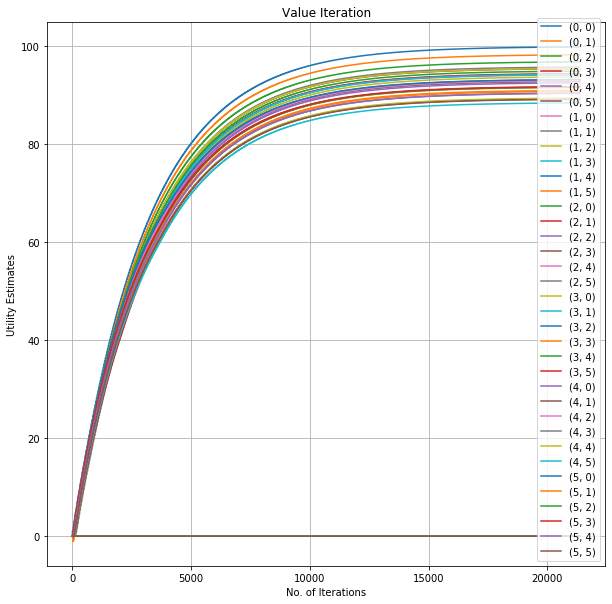

In [11]:
x = [i for i in range(num_iter)]

fig, ax = plt.subplots()
ax.plot(x, val_hist_0_0)
ax.plot(x, val_hist_0_1)
ax.plot(x, val_hist_0_2)
ax.plot(x, val_hist_0_3)
ax.plot(x, val_hist_0_4)
ax.plot(x, val_hist_0_5)

ax.plot(x, val_hist_1_0)
ax.plot(x, val_hist_1_1)
ax.plot(x, val_hist_1_2)
ax.plot(x, val_hist_1_3)
ax.plot(x, val_hist_1_4)
ax.plot(x, val_hist_1_5)

ax.plot(x, val_hist_2_0)
ax.plot(x, val_hist_2_1)
ax.plot(x, val_hist_2_2)
ax.plot(x, val_hist_2_3)
ax.plot(x, val_hist_2_4)
ax.plot(x, val_hist_2_5)

ax.plot(x, val_hist_3_0)
ax.plot(x, val_hist_3_1)
ax.plot(x, val_hist_3_2)
ax.plot(x, val_hist_3_3)
ax.plot(x, val_hist_3_4)
ax.plot(x, val_hist_3_5)

ax.plot(x, val_hist_4_0)
ax.plot(x, val_hist_4_1)
ax.plot(x, val_hist_4_2)
ax.plot(x, val_hist_4_3)
ax.plot(x, val_hist_4_4)
ax.plot(x, val_hist_4_5)

ax.plot(x, val_hist_5_0)
ax.plot(x, val_hist_5_1)
ax.plot(x, val_hist_5_2)
ax.plot(x, val_hist_5_3)
ax.plot(x, val_hist_5_4)
ax.plot(x, val_hist_5_5)

plt.legend(tuple_list, loc ="lower right")

ax.set(xlabel='No. of Iterations', ylabel='Utility Estimates', title='Policy Iteration')
ax.grid()

fig.savefig("p1-valueIter.png")
plt.show()